# Réseaux de neurones convolutionnels 

                                     Valentyn Gerushta, Léane Salais 

Deep Learning pour des données pluridimensionnelles, comme des images.

## Récupération des bibliothèques

In [4]:
!git clone https://github.com/cdancette/deep-learning-polytech-tp6-7.git

Cloning into 'deep-learning-polytech-tp6-7'...
remote: Enumerating objects: 11, done.
remote: Counting objects: 100% (11/11), done.
remote: Compressing objects: 100% (9/9), done.
remote: Total 19 (delta 2), reused 7 (delta 1), pack-reused 8
Unpacking objects: 100% (19/19), done.


In [1]:
cd deep-learning-polytech-tp6-7

/content/deep-learning-polytech-tp6-7


In [2]:
import argparse
import os
import time

import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim
import torch.utils.data
import torchvision.transforms as transforms
import torchvision.datasets as datasets
import matplotlib.pyplot as plt

from tme6 import *

PRINT_INTERVAL = 200
PATH="datasets"

## Récupération des données

On utilisera les données MNIST (reconnaissance de chiffres) pour de premiers essais, puis CIFAR (reconnaissance d'objets) pour les questions du TME. On redéfinira cette fonction get_dataset() plus loin, car c'est là qu'on ajoutera notamment de l'augmentation de données.

In [ ]:
def get_dataset(name, batch_size, cuda=False):
    """
    Cette fonction charge le dataset "name" et effectue des transformations sur chaque
    image (listées dans `transform = ...`).
    """
    train_dataset = name(PATH, train=True, download=True,
        transform = transforms.Compose([
            transforms.ToTensor()
        ]))
    
    val_dataset = name(PATH, train=False, download=True,
        transform = transforms.Compose([
            transforms.ToTensor()
        ]))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader

## Fonctions d'administration de la descente de gradient 

C'est ici que l'on gère le déroulement de l'apprentissage : calcul de la loss, backpropagation, epoch par epoch ; et après un certain nombre d'itérations, affichage des résultats pour analyse.  
On a légèrement modifié les paramètres pour pouvoir traiter des résultats sur plusieurs runs sans tout afficher (essentiellement pour la comparaison de paramètres).

La fonction main pourra elle aussi être recopiée et modifiée plus loin pour changer l'optimiseur de la descente de gradient.

In [3]:
def epoch(data, model, criterion, optimizer=None, cuda=False, print_results=True):
    """
    Fait une passe sur les données `data` avec le modèle `model`. 
    Evalue `criterion` comme loss.
    Si `optimizer` est fourni, effectue une epoch d'apprentissage en utilisant
    l'optimiseur donné, sinon, une epoch d'évaluation (pas de backward).
    """

    # indique si le modele est en mode eval ou train (certaines couches se
    # comportent différemment en train et en eval)
    model.eval() if optimizer is None else model.train()

    # objets pour stocker les moyennes des metriques
    avg_loss = AverageMeter()
    avg_top1_acc = AverageMeter()
    avg_top5_acc = AverageMeter()
    avg_batch_time = AverageMeter()
    global loss_plot

    # on itere sur les batchs du dataset
    tic = time.time()
    for i, (input, target) in enumerate(data):

        if cuda: # si on fait du GPU, passage en CUDA
            input = input.cuda()
            target = target.cuda()

        # forward
        output = model(input)
        loss = criterion(output, target)

        # backward si on est en "train"
        if optimizer:
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        # calcul des metriques
        prec1, prec5 = accuracy(output, target, topk=(1, 5))
        batch_time = time.time() - tic
        tic = time.time()

        # mise a jour des moyennes
        avg_loss.update(loss.item())
        avg_top1_acc.update(prec1.item())
        avg_top5_acc.update(prec5.item())
        avg_batch_time.update(batch_time)
        if optimizer:
            loss_plot.update(avg_loss.val)
        # affichage des infos
        if print_results and i % PRINT_INTERVAL == 0:
            print('[{0:s} Batch {1:03d}/{2:03d}]\t'
                  'Time {batch_time.val:.3f}s ({batch_time.avg:.3f}s)\t'
                  'Loss {loss.val:.4f} ({loss.avg:.4f})\t'
                  'Prec@1 {top1.val:5.1f} ({top1.avg:5.1f})\t'
                  'Prec@5 {top5.val:5.1f} ({top5.avg:5.1f})'.format(
                   "EVAL" if optimizer is None else "TRAIN", i, len(data), batch_time=avg_batch_time, loss=avg_loss,
                   top1=avg_top1_acc, top5=avg_top5_acc))
            if optimizer:
                loss_plot.plot()

    # Affichage des infos sur l'epoch
    if print_results:
        print('\n===============> Total time {batch_time:d}s\t'
              'Avg loss {loss.avg:.4f}\t'
              'Avg Prec@1 {top1.avg:5.2f} %\t'
              'Avg Prec@5 {top5.avg:5.2f} %\n'.format(
              batch_time=int(avg_batch_time.sum), loss=avg_loss,
              top1=avg_top1_acc, top5=avg_top5_acc))

    return avg_top1_acc, avg_top5_acc, avg_loss, avg_batch_time.sum

In [4]:
def main(batch_size=128, lr=0.1, epochs=15, cuda=False, namebase=datasets.CIFAR10, print_results=True):   
    """
    Charge la base (namebase), la divise en n batchs (batch_size), prépare le lieu du calcul (cuda). 
    Lance autant d'itérations que demandé (epoch) avec la classe ConvNet définie 
    et le pas d'apprentissage fourni (lr)
    Affiche ou non les résultats selon le paramétrage.
    """

    # define model, loss, optim
    model = ConvNet()
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr)

    if cuda: # si on fait du GPU, passage en CUDA
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # On récupère les données
    train, test = get_dataset(namebase, batch_size, cuda) 

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # On itère sur les epochs
    for i in range(epochs):
        if print_results:
            print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        # Phase de train
        top1_acc, top5_acc, loss, last_batch_time = epoch(train, model, criterion, optimizer, cuda, print_results)
        # Phase d'evaluation
        top1_acc_test, top5_acc_test, loss_test, last_batch_time_test = epoch(test, model, criterion, cuda=cuda, print_results=print_results)
        if print_results:
            # plot
            plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)
    
    if not print_results:
        return loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg, last_batch_time, last_batch_time_test

## Cas de base d'un réseau convolutionnel (premiers essais)

Ci-dessous, un réseau convolutionnel basique de type LeNet5.  
Sur MNIST, il suffit de 15 epochs pour qu'il converge avec une précision quasi-parfaite.  
On redéfinira cette classe pour complexifier le modèle tâche après tâche.

In [ ]:
class ConvNet(nn.Module):
    """
    Cette classe contient la structure du réseau de neurones.
    """
    def __init__(self):
        super(ConvNet, self).__init__()
        # On définit d'abord les couches de convolution et de pooling comme un
        # groupe de couches `self.features`.
        self.features = nn.Sequential(
            nn.Conv2d(1, 6, (5, 5), stride=1, padding=2), # w = 5*5*1*6, b = 6
            nn.Tanh(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(6, 16, (5, 5), stride=1, padding=0),
            nn.Tanh(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
        )
        # On définit les couches fully-connected comme un groupe de couches
        # `self.classifier`.
        self.classifier = nn.Sequential(
            nn.Linear(400, 120),
            nn.Tanh(),
            nn.Linear(120, 84),
            nn.Tanh(),
            nn.Linear(84, 10),
            # Rappel : Le softmax est inclus dans la loss, ne pas le mettre ici.
        )

    # Méthode appelée quand on applique le réseau à un batch d'input
    def forward(self, input):
        bsize = input.size(0) # taille du batch
        output = self.features(input)    # on calcule la sortie des couches cv
        output = output.view(bsize, -1)  # on aplatit les feature map 2D en un
                                         # vecteur 1D pour chaque input
        output = self.classifier(output) # on calcule la sortie des couches fc
        return output

=== EPOCH 1 =====

[TRAIN Batch 000/469]	Time 0.143s (0.143s)	Loss 2.3125 (2.3125)	Prec@1   7.8 (  7.8)	Prec@5  43.8 ( 43.8)


<Figure size 432x288 with 0 Axes>

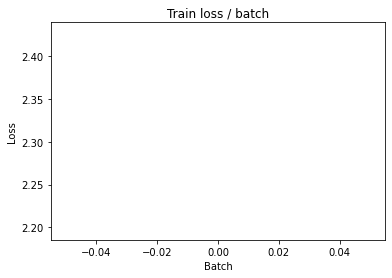

[TRAIN Batch 200/469]	Time 0.019s (0.013s)	Loss 0.3484 (1.0602)	Prec@1  88.3 ( 71.2)	Prec@5 100.0 ( 92.8)


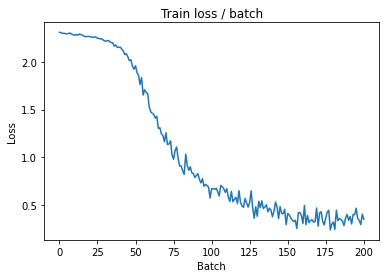

[TRAIN Batch 400/469]	Time 0.021s (0.013s)	Loss 0.1746 (0.6393)	Prec@1  96.1 ( 82.6)	Prec@5 100.0 ( 96.3)


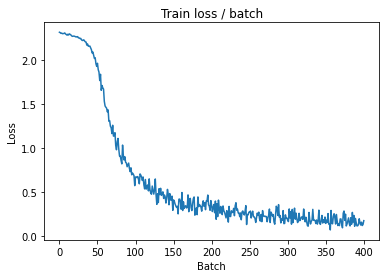


===============> Total time 6s	Avg loss 0.5699	Avg Prec@1 84.44 %	Avg Prec@5 96.78 %

[EVAL Batch 000/079]	Time 0.106s (0.106s)	Loss 0.0879 (0.0879)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)

===============> Total time 0s	Avg loss 0.1322	Avg Prec@1 96.03 %	Avg Prec@5 99.97 %



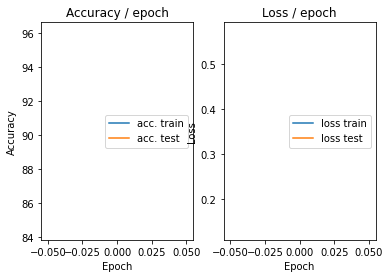

=== EPOCH 2 =====

[TRAIN Batch 000/469]	Time 0.113s (0.113s)	Loss 0.1859 (0.1859)	Prec@1  94.5 ( 94.5)	Prec@5  99.2 ( 99.2)


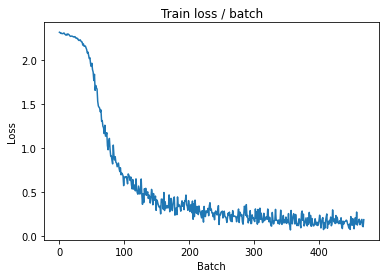

[TRAIN Batch 200/469]	Time 0.013s (0.014s)	Loss 0.1363 (0.1237)	Prec@1  95.3 ( 96.4)	Prec@5 100.0 ( 99.9)


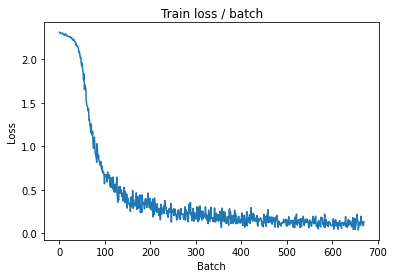

[TRAIN Batch 400/469]	Time 0.020s (0.014s)	Loss 0.0848 (0.1126)	Prec@1  97.7 ( 96.8)	Prec@5 100.0 ( 99.9)


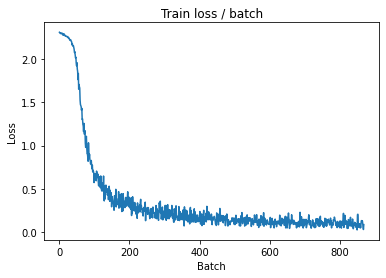


===============> Total time 6s	Avg loss 0.1103	Avg Prec@1 96.85 %	Avg Prec@5 99.92 %

[EVAL Batch 000/079]	Time 0.110s (0.110s)	Loss 0.0329 (0.0329)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 0s	Avg loss 0.0733	Avg Prec@1 97.69 %	Avg Prec@5 99.99 %



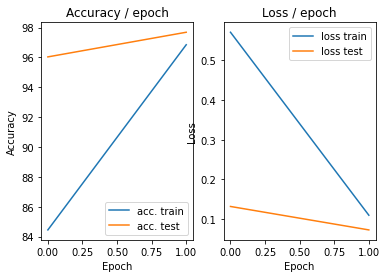

=== EPOCH 3 =====

[TRAIN Batch 000/469]	Time 0.119s (0.119s)	Loss 0.0719 (0.0719)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


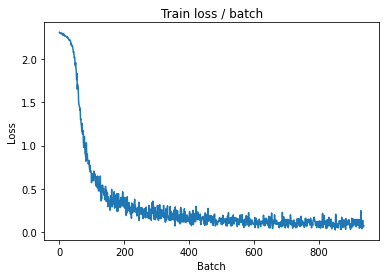

[TRAIN Batch 200/469]	Time 0.004s (0.014s)	Loss 0.1286 (0.0829)	Prec@1  96.1 ( 97.6)	Prec@5  99.2 ( 99.9)


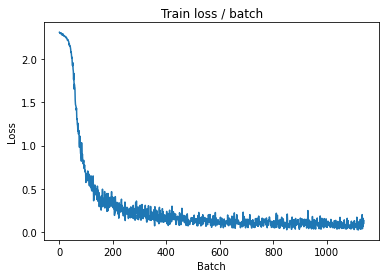

[TRAIN Batch 400/469]	Time 0.009s (0.013s)	Loss 0.0405 (0.0761)	Prec@1  98.4 ( 97.7)	Prec@5 100.0 (100.0)


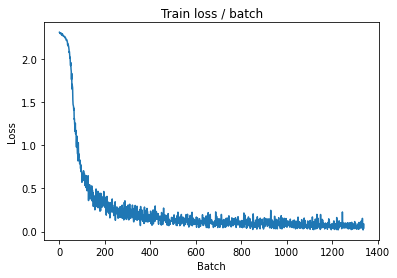


===============> Total time 6s	Avg loss 0.0765	Avg Prec@1 97.72 %	Avg Prec@5 99.95 %

[EVAL Batch 000/079]	Time 0.115s (0.115s)	Loss 0.0326 (0.0326)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 0s	Avg loss 0.0624	Avg Prec@1 97.85 %	Avg Prec@5 99.98 %



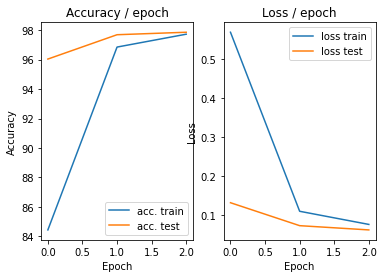

=== EPOCH 4 =====

[TRAIN Batch 000/469]	Time 0.116s (0.116s)	Loss 0.0457 (0.0457)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


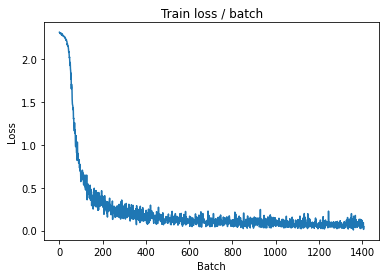

[TRAIN Batch 200/469]	Time 0.017s (0.014s)	Loss 0.1146 (0.0621)	Prec@1  97.7 ( 98.2)	Prec@5 100.0 (100.0)


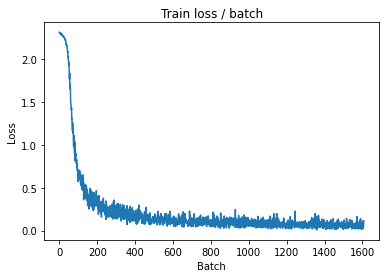

[TRAIN Batch 400/469]	Time 0.021s (0.013s)	Loss 0.1389 (0.0613)	Prec@1  96.9 ( 98.2)	Prec@5  99.2 (100.0)


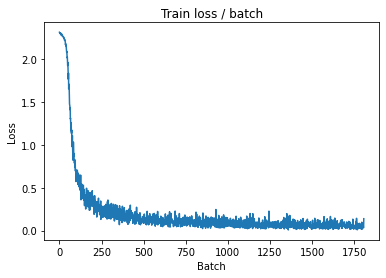


===============> Total time 6s	Avg loss 0.0609	Avg Prec@1 98.19 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.111s (0.111s)	Loss 0.0192 (0.0192)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 0s	Avg loss 0.0504	Avg Prec@1 98.32 %	Avg Prec@5 99.99 %



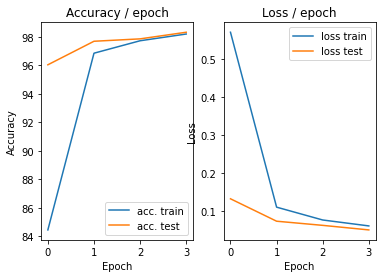

=== EPOCH 5 =====

[TRAIN Batch 000/469]	Time 0.133s (0.133s)	Loss 0.0192 (0.0192)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


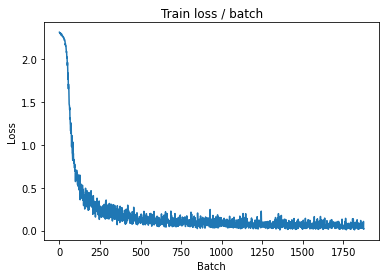

[TRAIN Batch 200/469]	Time 0.004s (0.015s)	Loss 0.0119 (0.0508)	Prec@1 100.0 ( 98.6)	Prec@5 100.0 (100.0)


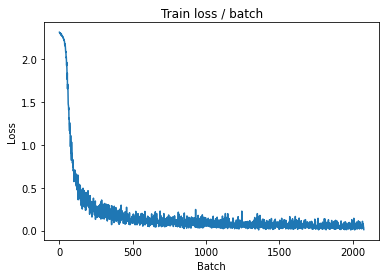

[TRAIN Batch 400/469]	Time 0.004s (0.014s)	Loss 0.0340 (0.0513)	Prec@1 100.0 ( 98.5)	Prec@5 100.0 (100.0)


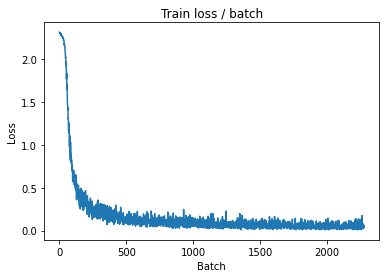


===============> Total time 6s	Avg loss 0.0515	Avg Prec@1 98.48 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.105s (0.105s)	Loss 0.0147 (0.0147)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 0s	Avg loss 0.0442	Avg Prec@1 98.51 %	Avg Prec@5 100.00 %



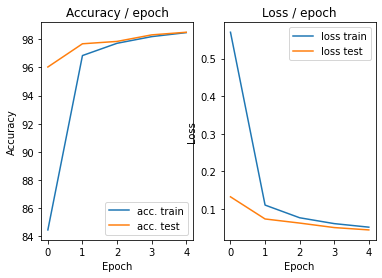

=== EPOCH 6 =====

[TRAIN Batch 000/469]	Time 0.121s (0.121s)	Loss 0.0681 (0.0681)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


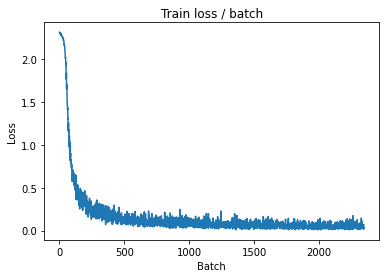

[TRAIN Batch 200/469]	Time 0.019s (0.014s)	Loss 0.0209 (0.0458)	Prec@1 100.0 ( 98.6)	Prec@5 100.0 (100.0)


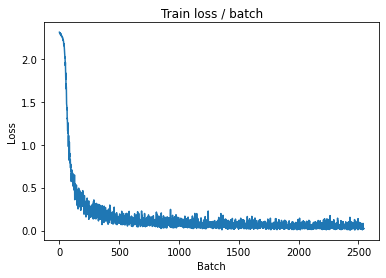

[TRAIN Batch 400/469]	Time 0.007s (0.013s)	Loss 0.0635 (0.0445)	Prec@1  97.7 ( 98.7)	Prec@5 100.0 (100.0)


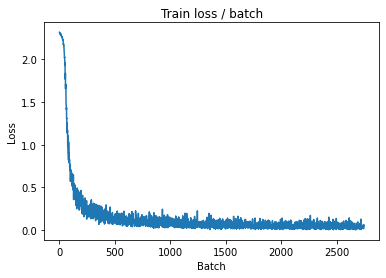


===============> Total time 6s	Avg loss 0.0446	Avg Prec@1 98.66 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.115s (0.115s)	Loss 0.0357 (0.0357)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)

===============> Total time 0s	Avg loss 0.0568	Avg Prec@1 98.06 %	Avg Prec@5 99.98 %



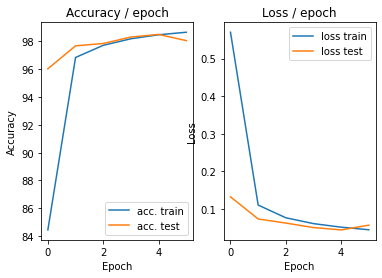

=== EPOCH 7 =====

[TRAIN Batch 000/469]	Time 0.122s (0.122s)	Loss 0.1322 (0.1322)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


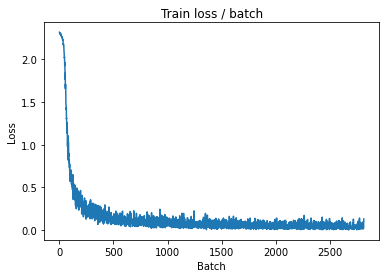

[TRAIN Batch 200/469]	Time 0.017s (0.014s)	Loss 0.0512 (0.0404)	Prec@1  97.7 ( 98.8)	Prec@5 100.0 (100.0)


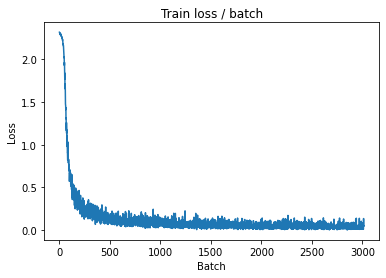

[TRAIN Batch 400/469]	Time 0.015s (0.013s)	Loss 0.0345 (0.0394)	Prec@1  98.4 ( 98.8)	Prec@5 100.0 (100.0)


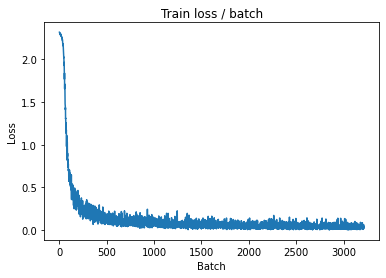


===============> Total time 6s	Avg loss 0.0388	Avg Prec@1 98.86 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.110s (0.110s)	Loss 0.0146 (0.0146)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 0s	Avg loss 0.0377	Avg Prec@1 98.72 %	Avg Prec@5 100.00 %



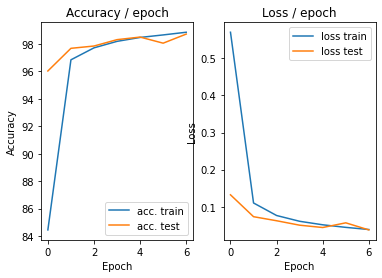

=== EPOCH 8 =====

[TRAIN Batch 000/469]	Time 0.111s (0.111s)	Loss 0.1238 (0.1238)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)


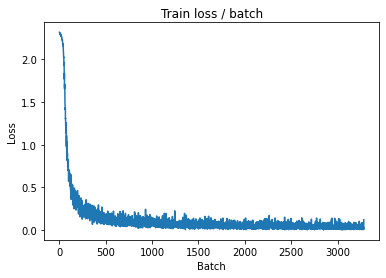

[TRAIN Batch 200/469]	Time 0.013s (0.014s)	Loss 0.0638 (0.0359)	Prec@1  97.7 ( 99.0)	Prec@5 100.0 (100.0)


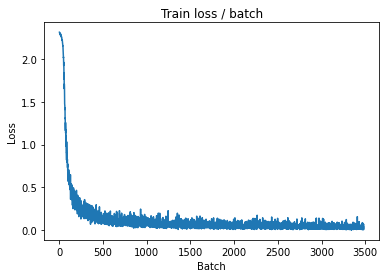

[TRAIN Batch 400/469]	Time 0.004s (0.014s)	Loss 0.0250 (0.0344)	Prec@1  99.2 ( 99.0)	Prec@5 100.0 (100.0)


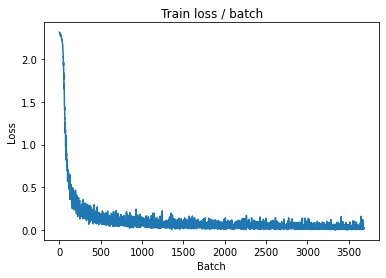


===============> Total time 6s	Avg loss 0.0344	Avg Prec@1 98.99 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.108s (0.108s)	Loss 0.0149 (0.0149)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 0s	Avg loss 0.0369	Avg Prec@1 98.77 %	Avg Prec@5 99.99 %



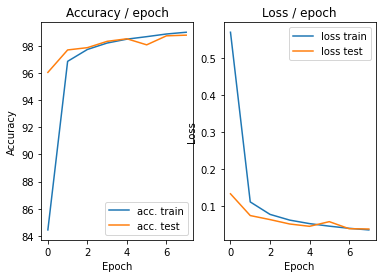

=== EPOCH 9 =====

[TRAIN Batch 000/469]	Time 0.113s (0.113s)	Loss 0.0470 (0.0470)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


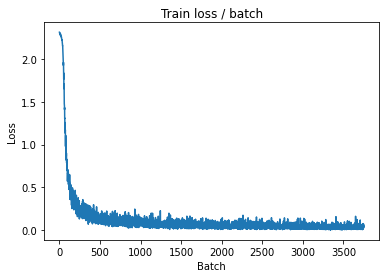

[TRAIN Batch 200/469]	Time 0.004s (0.014s)	Loss 0.0098 (0.0298)	Prec@1 100.0 ( 99.1)	Prec@5 100.0 (100.0)


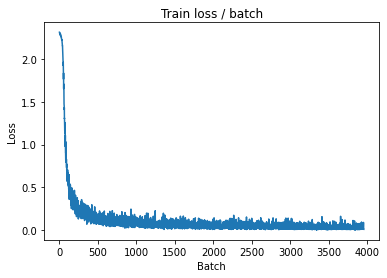

[TRAIN Batch 400/469]	Time 0.004s (0.013s)	Loss 0.0070 (0.0306)	Prec@1 100.0 ( 99.1)	Prec@5 100.0 (100.0)


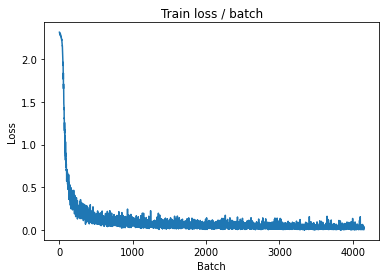


===============> Total time 6s	Avg loss 0.0303	Avg Prec@1 99.10 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.118s (0.118s)	Loss 0.0097 (0.0097)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 0s	Avg loss 0.0360	Avg Prec@1 98.75 %	Avg Prec@5 100.00 %



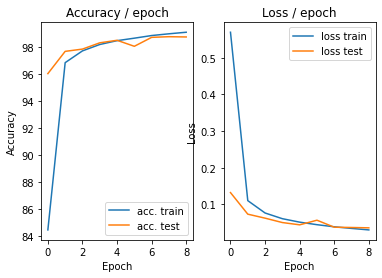

=== EPOCH 10 =====

[TRAIN Batch 000/469]	Time 0.134s (0.134s)	Loss 0.0130 (0.0130)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


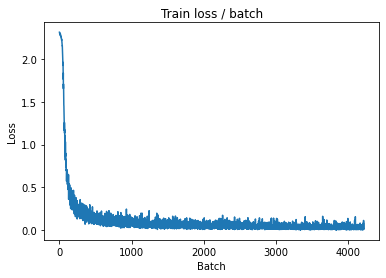

[TRAIN Batch 200/469]	Time 0.018s (0.014s)	Loss 0.0089 (0.0280)	Prec@1 100.0 ( 99.3)	Prec@5 100.0 (100.0)


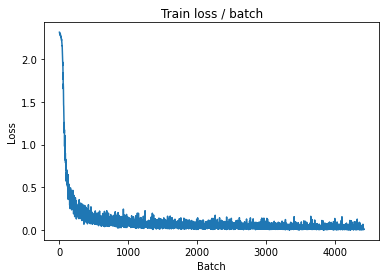

[TRAIN Batch 400/469]	Time 0.004s (0.014s)	Loss 0.0456 (0.0282)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


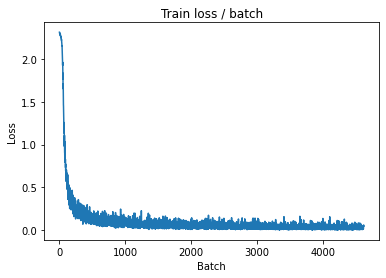


===============> Total time 6s	Avg loss 0.0280	Avg Prec@1 99.23 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.110s (0.110s)	Loss 0.0087 (0.0087)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 0s	Avg loss 0.0333	Avg Prec@1 98.91 %	Avg Prec@5 100.00 %



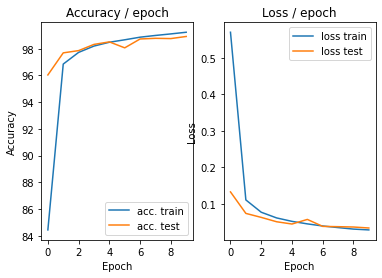

=== EPOCH 11 =====

[TRAIN Batch 000/469]	Time 0.109s (0.109s)	Loss 0.0060 (0.0060)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


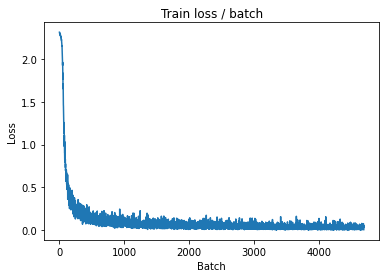

[TRAIN Batch 200/469]	Time 0.011s (0.015s)	Loss 0.0297 (0.0238)	Prec@1  99.2 ( 99.3)	Prec@5 100.0 (100.0)


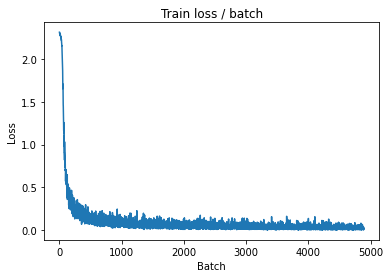

[TRAIN Batch 400/469]	Time 0.015s (0.014s)	Loss 0.0401 (0.0250)	Prec@1  99.2 ( 99.3)	Prec@5 100.0 (100.0)


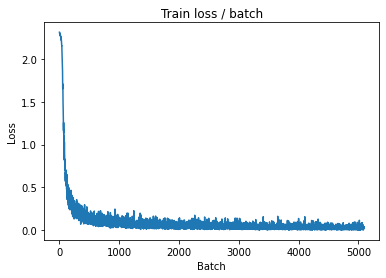


===============> Total time 6s	Avg loss 0.0252	Avg Prec@1 99.28 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.116s (0.116s)	Loss 0.0216 (0.0216)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 0s	Avg loss 0.0363	Avg Prec@1 98.75 %	Avg Prec@5 100.00 %



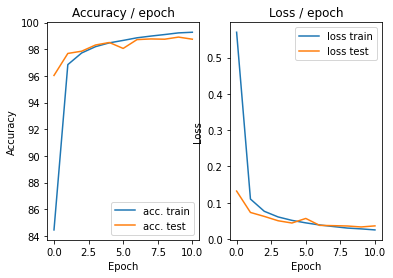

=== EPOCH 12 =====

[TRAIN Batch 000/469]	Time 0.125s (0.125s)	Loss 0.0595 (0.0595)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


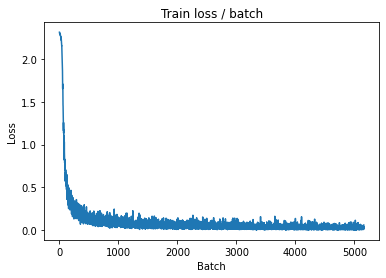

[TRAIN Batch 200/469]	Time 0.018s (0.014s)	Loss 0.0411 (0.0230)	Prec@1  99.2 ( 99.4)	Prec@5 100.0 (100.0)


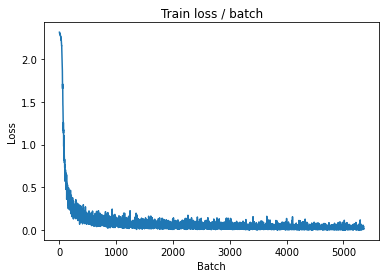

[TRAIN Batch 400/469]	Time 0.018s (0.013s)	Loss 0.0202 (0.0227)	Prec@1  99.2 ( 99.4)	Prec@5 100.0 (100.0)


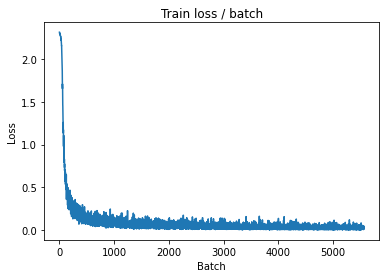


===============> Total time 6s	Avg loss 0.0230	Avg Prec@1 99.34 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.109s (0.109s)	Loss 0.0087 (0.0087)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 0s	Avg loss 0.0331	Avg Prec@1 98.88 %	Avg Prec@5 100.00 %



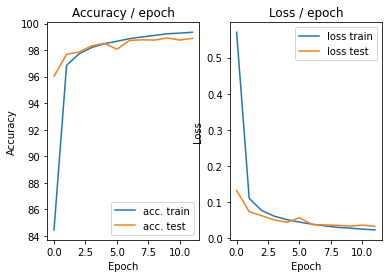

=== EPOCH 13 =====

[TRAIN Batch 000/469]	Time 0.128s (0.128s)	Loss 0.0098 (0.0098)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


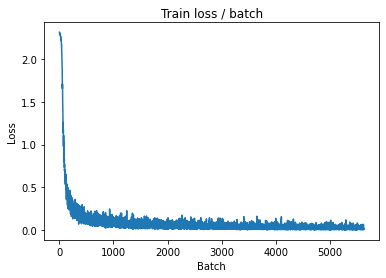

[TRAIN Batch 200/469]	Time 0.015s (0.014s)	Loss 0.0055 (0.0210)	Prec@1 100.0 ( 99.4)	Prec@5 100.0 (100.0)


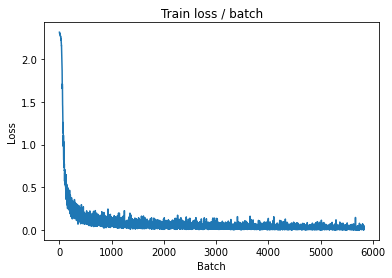

[TRAIN Batch 400/469]	Time 0.021s (0.014s)	Loss 0.0049 (0.0207)	Prec@1 100.0 ( 99.4)	Prec@5 100.0 (100.0)


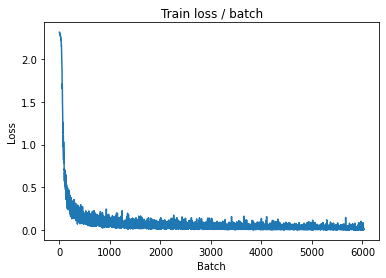


===============> Total time 6s	Avg loss 0.0208	Avg Prec@1 99.42 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.109s (0.109s)	Loss 0.0057 (0.0057)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 0s	Avg loss 0.0340	Avg Prec@1 98.99 %	Avg Prec@5 99.99 %



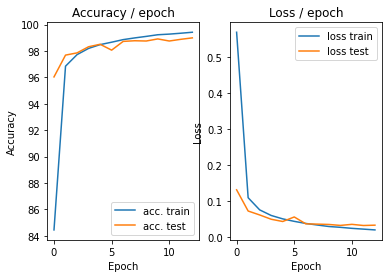

=== EPOCH 14 =====

[TRAIN Batch 000/469]	Time 0.128s (0.128s)	Loss 0.0206 (0.0206)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


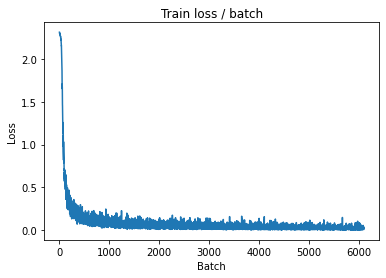

[TRAIN Batch 200/469]	Time 0.004s (0.015s)	Loss 0.0236 (0.0180)	Prec@1  98.4 ( 99.4)	Prec@5 100.0 (100.0)


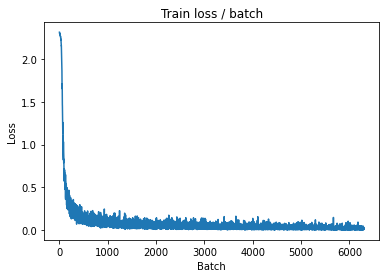

[TRAIN Batch 400/469]	Time 0.018s (0.014s)	Loss 0.0170 (0.0184)	Prec@1  99.2 ( 99.5)	Prec@5 100.0 (100.0)


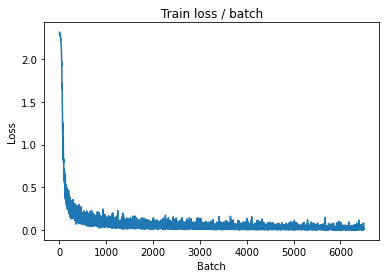


===============> Total time 6s	Avg loss 0.0190	Avg Prec@1 99.45 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.110s (0.110s)	Loss 0.0342 (0.0342)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 0s	Avg loss 0.0374	Avg Prec@1 98.87 %	Avg Prec@5 100.00 %



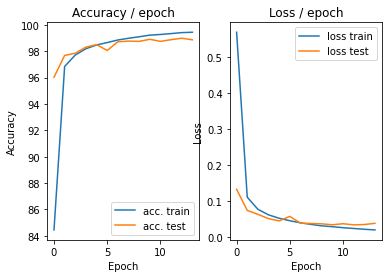

=== EPOCH 15 =====

[TRAIN Batch 000/469]	Time 0.122s (0.122s)	Loss 0.0432 (0.0432)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


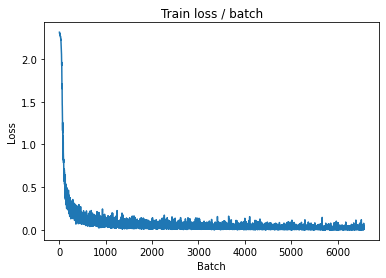

[TRAIN Batch 200/469]	Time 0.004s (0.014s)	Loss 0.0055 (0.0177)	Prec@1 100.0 ( 99.5)	Prec@5 100.0 (100.0)


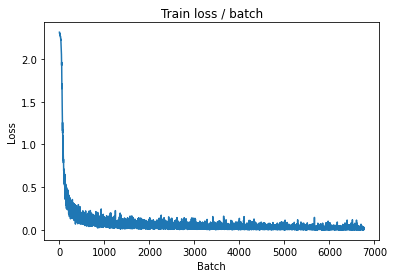

[TRAIN Batch 400/469]	Time 0.004s (0.014s)	Loss 0.0055 (0.0177)	Prec@1 100.0 ( 99.5)	Prec@5 100.0 (100.0)


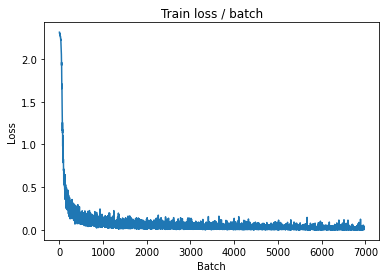


===============> Total time 6s	Avg loss 0.0175	Avg Prec@1 99.52 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.114s (0.114s)	Loss 0.0061 (0.0061)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 0s	Avg loss 0.0318	Avg Prec@1 99.05 %	Avg Prec@5 100.00 %



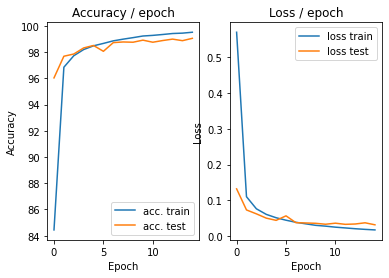

In [ ]:
main(batch_size=128, lr=0.1, epochs=15, cuda=True, namebase=datasets.MNIST)


On constate d'ailleurs un léger surapprentissage : sur le dernier graphique, la loss en test remonte légèrement alors que la loss en train continue à diminuer après 5 epochs.

###  Learning rate et taille des batchs 

On s'intéresse à l'impact de ces deux paramètres sur la justesse des résultats.

In [ ]:
results_batch = []
batch_sizes = [32,64,128,256,512,1024,2048]
for b in batch_sizes:
  res = main(batch_size=b, lr=0.1, epochs=15, cuda=True, namebase=datasets.MNIST, print_results=False)
  results_batch.append(res)

In [ ]:
results_lr = []
lr_list = [0.001,0.005,0.01,0.05,0.1,0.5,1]
for lr in lr_list:
    res = main(batch_size=128, lr=lr, epochs=15, cuda=True, namebase=datasets.MNIST, print_results=False)
    results_lr.append(res)

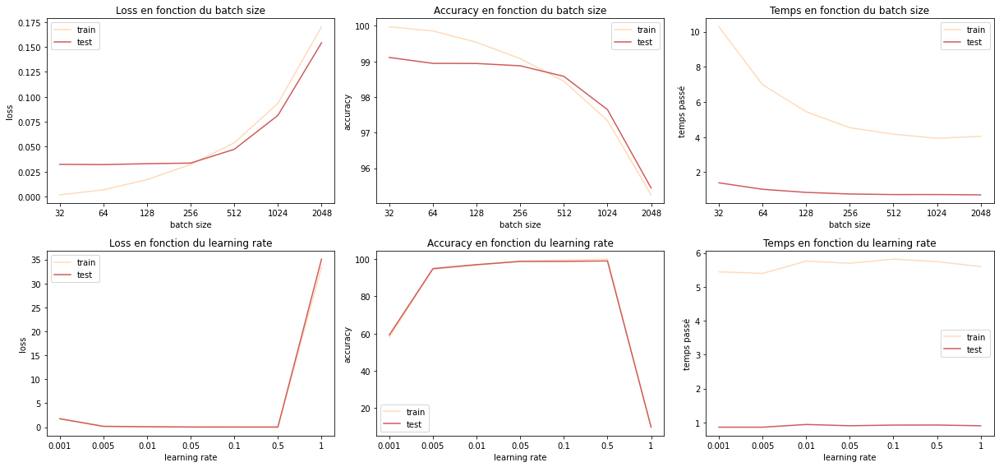

In [ ]:
etude = plt.figure(figsize=(17,8))
res_batch_arr = np.array(results_batch)
size_res = len(res_batch_arr)
# loss
ax1 = etude.add_subplot(231)
ax1.plot(np.arange(size_res),res_batch_arr[:,0],label = 'train',color='peachpuff')
ax1.plot(np.arange(size_res),res_batch_arr[:,1],label = 'test',color='indianred')
ax1.title.set_text('Loss en fonction du batch size')
ax1.set(xlabel='batch size',ylabel='loss')
ax1.set_xticks(np.arange(size_res))
ax1.set_xticklabels(batch_sizes)
ax1.legend()
# accuracy
ax2 = etude.add_subplot(232)
ax2.plot(np.arange(size_res),res_batch_arr[:,2],label = 'train',color='peachpuff')
ax2.plot(np.arange(size_res),res_batch_arr[:,3],label = 'test',color='indianred')
ax2.title.set_text('Accuracy en fonction du batch size')
ax2.set(xlabel='batch size',ylabel='accuracy')
ax2.set_xticks(np.arange(size_res))
ax2.set_xticklabels(batch_sizes)
ax2.legend()
# time
ax3 = etude.add_subplot(233)
ax3.plot(np.arange(size_res),res_batch_arr[:,4],label = 'train',color='peachpuff')
ax3.plot(np.arange(size_res),res_batch_arr[:,5],label = 'test',color='indianred')
ax3.title.set_text('Temps en fonction du batch size')
ax3.set(xlabel='batch size',ylabel='temps passé')
ax3.set_xticks(np.arange(size_res))
ax3.set_xticklabels(batch_sizes)
ax3.legend()

res_lr_arr = np.array(results_lr)
size_res_lr = len(res_lr_arr)
# loss
ax4 = etude.add_subplot(234)
ax4.plot(np.arange(size_res_lr),res_lr_arr[:,0],label = 'train',color='peachpuff')
ax4.plot(np.arange(size_res_lr),res_lr_arr[:,1],label = 'test',color='indianred')
ax4.title.set_text('Loss en fonction du learning rate')
ax4.set(xlabel='learning rate',ylabel='loss')
ax4.set_xticks(np.arange(size_res_lr))
ax4.set_xticklabels(lr_list)
ax4.legend()
# accuracy
ax5 = etude.add_subplot(235)
ax5.plot(np.arange(size_res_lr),res_lr_arr[:,2],label = 'train',color='peachpuff')
ax5.plot(np.arange(size_res_lr),res_lr_arr[:,3],label = 'test',color='indianred')
ax5.title.set_text('Accuracy en fonction du learning rate')
ax5.set(xlabel='learning rate',ylabel='accuracy')
ax5.set_xticks(np.arange(size_res_lr))
ax5.set_xticklabels(lr_list)
ax5.legend()
# time
ax6 = etude.add_subplot(236)
ax6.plot(np.arange(size_res_lr),res_lr_arr[:,4],label = 'train',color='peachpuff')
ax6.plot(np.arange(size_res_lr),res_lr_arr[:,5],label = 'test',color='indianred')
ax6.title.set_text('Temps en fonction du learning rate')
ax6.set(xlabel='learning rate',ylabel='temps passé')
ax6.set_xticks(np.arange(size_res_lr))
ax6.set_xticklabels(lr_list)
ax6.legend()

plt.tight_layout()
plt.show()

## Réseau utilisé pendant le TME

On recopiera la classe ConvNet à chaque redéfinition pour pouvoir garder une trace de toutes les expérimentations.  
Ci-dessous le réseau utilisé comme base pour le TME, de type AlexNet.

In [5]:
class ConvNet(nn.Module):
    """
    Cette classe contient la structure du réseau de neurones utilisé sur CIFAR.
    """
    def __init__(self):
        super(ConvNet, self).__init__()
        # On définit d'abord les couches de convolution et de pooling comme un
        # groupe de couches `self.features` 
        self.features = nn.Sequential(
            nn.Conv2d(3, 32, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(32, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(64, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
        )

        # On définit les couches fully connected comme un groupe de couches
        # `self.classifier`
        self.classifier = nn.Sequential(
            nn.Linear(1024, 1000),
            nn.ReLU(),
            nn.Linear(1000, 10)
            # Rappel : Le softmax est inclus dans la loss, ne pas le mettre ici
        )

    # Méthode appelée quand on applique le réseau à un batch d'input
    def forward(self, input):
        bsize = input.size(0) # taille du batch
        output = self.features(input)    # on calcule la sortie des couches cv
        output = output.view(bsize, -1)  # on aplatit les feature map 2D en un
                                         # vecteur 1D pour chaque input
        output = self.classifier(output) # on calcule la sortie des couches fc
        return output

Avec 42 epochs, on est certain que l'entraînement a convergé. La courbe est bien plate sur la fin (on aurait pu s'arrêter à 30).

Extracting datasets/cifar-10-python.tar.gz to datasets
Files already downloaded and verified
=== EPOCH 1 =====


[TRAIN Batch 000/391]	Time 0.193s (0.193s)	Loss 2.3066 (2.3066)	Prec@1   7.8 (  7.8)	Prec@5  42.2 ( 42.2)


<Figure size 432x288 with 0 Axes>

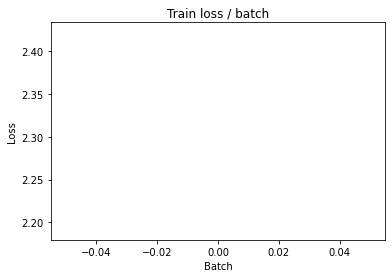

[TRAIN Batch 200/391]	Time 0.019s (0.019s)	Loss 2.0704 (2.2164)	Prec@1  28.1 ( 17.4)	Prec@5  78.9 ( 64.1)


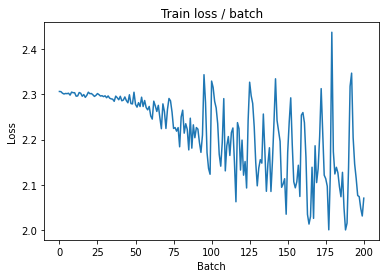


===============> Total time 7s	Avg loss 2.1241	Avg Prec@1 21.97 %	Avg Prec@5 70.30 %

[EVAL Batch 000/079]	Time 0.112s (0.112s)	Loss 1.7418 (1.7418)	Prec@1  43.8 ( 43.8)	Prec@5  85.2 ( 85.2)

===============> Total time 1s	Avg loss 1.7799	Avg Prec@1 36.24 %	Avg Prec@5 85.77 %



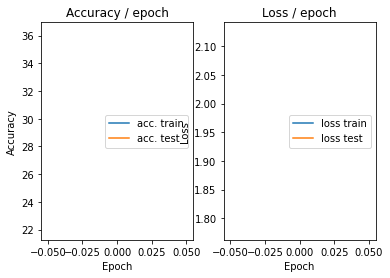

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.130s (0.130s)	Loss 1.8844 (1.8844)	Prec@1  30.5 ( 30.5)	Prec@5  83.6 ( 83.6)


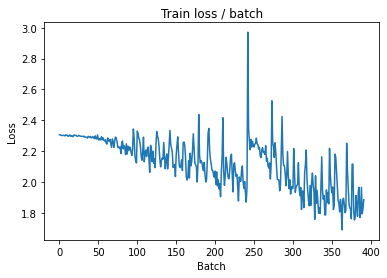

[TRAIN Batch 200/391]	Time 0.013s (0.019s)	Loss 1.6874 (1.7557)	Prec@1  39.8 ( 36.6)	Prec@5  89.1 ( 86.3)


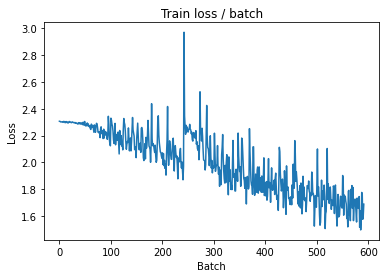


===============> Total time 7s	Avg loss 1.6752	Avg Prec@1 39.57 %	Avg Prec@5 87.98 %

[EVAL Batch 000/079]	Time 0.120s (0.120s)	Loss 1.3941 (1.3941)	Prec@1  53.1 ( 53.1)	Prec@5  91.4 ( 91.4)

===============> Total time 1s	Avg loss 1.4713	Avg Prec@1 46.26 %	Avg Prec@5 92.34 %



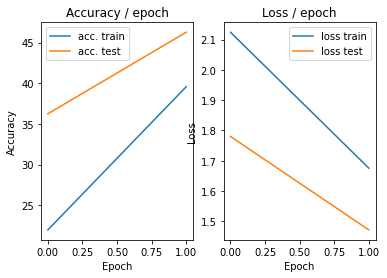

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.132s (0.132s)	Loss 1.6100 (1.6100)	Prec@1  46.1 ( 46.1)	Prec@5  87.5 ( 87.5)


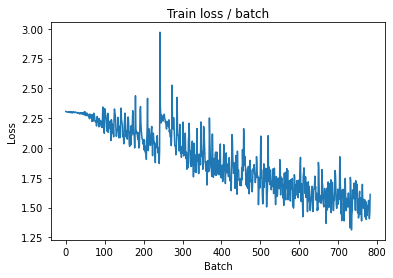

[TRAIN Batch 200/391]	Time 0.009s (0.019s)	Loss 1.3776 (1.4651)	Prec@1  50.8 ( 47.7)	Prec@5  97.7 ( 91.8)


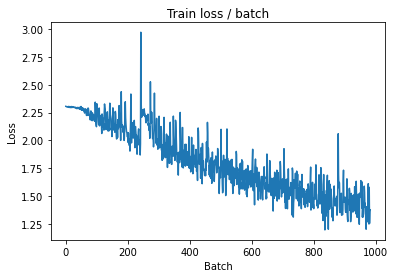


===============> Total time 7s	Avg loss 1.4227	Avg Prec@1 49.27 %	Avg Prec@5 92.39 %

[EVAL Batch 000/079]	Time 0.132s (0.132s)	Loss 1.1875 (1.1875)	Prec@1  63.3 ( 63.3)	Prec@5  94.5 ( 94.5)

===============> Total time 1s	Avg loss 1.3089	Avg Prec@1 53.46 %	Avg Prec@5 93.88 %



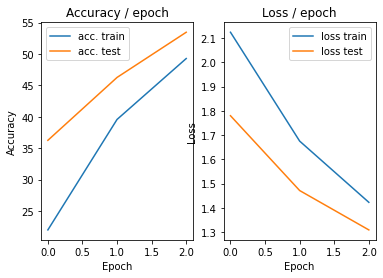

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.144s (0.144s)	Loss 1.3260 (1.3260)	Prec@1  55.5 ( 55.5)	Prec@5  89.8 ( 89.8)


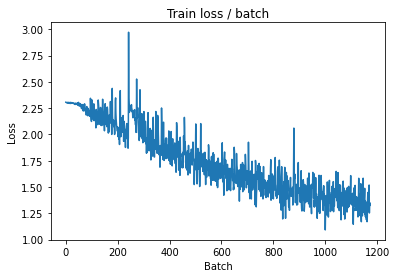

[TRAIN Batch 200/391]	Time 0.011s (0.019s)	Loss 1.3015 (1.2953)	Prec@1  52.3 ( 54.1)	Prec@5  93.0 ( 94.2)


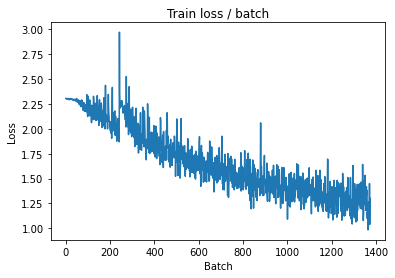


===============> Total time 7s	Avg loss 1.2616	Avg Prec@1 55.15 %	Avg Prec@5 94.58 %

[EVAL Batch 000/079]	Time 0.120s (0.120s)	Loss 1.1239 (1.1239)	Prec@1  62.5 ( 62.5)	Prec@5  95.3 ( 95.3)

===============> Total time 1s	Avg loss 1.2690	Avg Prec@1 54.95 %	Avg Prec@5 93.98 %



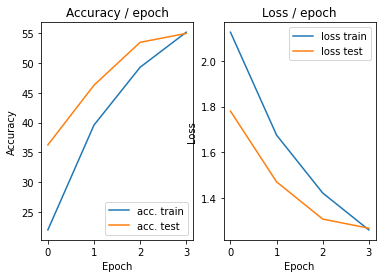

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.136s (0.136s)	Loss 1.2362 (1.2362)	Prec@1  55.5 ( 55.5)	Prec@5  93.8 ( 93.8)


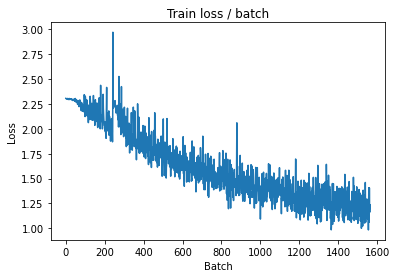

[TRAIN Batch 200/391]	Time 0.005s (0.019s)	Loss 1.0084 (1.1410)	Prec@1  64.1 ( 59.6)	Prec@5  96.9 ( 95.7)


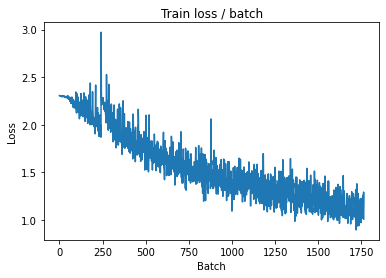


===============> Total time 7s	Avg loss 1.1255	Avg Prec@1 60.42 %	Avg Prec@5 95.74 %

[EVAL Batch 000/079]	Time 0.131s (0.131s)	Loss 1.0053 (1.0053)	Prec@1  64.1 ( 64.1)	Prec@5  95.3 ( 95.3)

===============> Total time 1s	Avg loss 1.1131	Avg Prec@1 60.88 %	Avg Prec@5 95.80 %



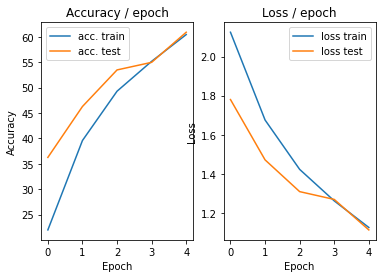

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.135s (0.135s)	Loss 1.1094 (1.1094)	Prec@1  65.6 ( 65.6)	Prec@5  96.1 ( 96.1)


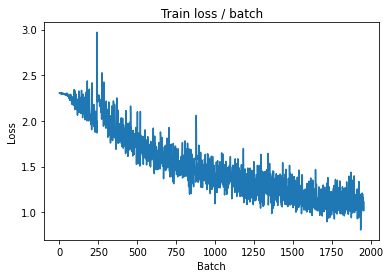

[TRAIN Batch 200/391]	Time 0.011s (0.019s)	Loss 0.9752 (1.0090)	Prec@1  66.4 ( 64.6)	Prec@5  96.9 ( 96.9)


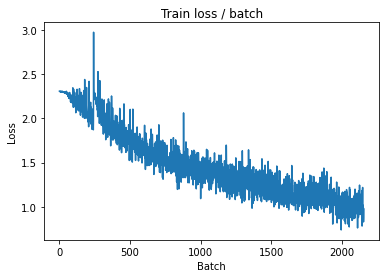


===============> Total time 7s	Avg loss 0.9999	Avg Prec@1 64.87 %	Avg Prec@5 96.96 %

[EVAL Batch 000/079]	Time 0.123s (0.123s)	Loss 1.0081 (1.0081)	Prec@1  64.1 ( 64.1)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.0955	Avg Prec@1 61.47 %	Avg Prec@5 95.98 %



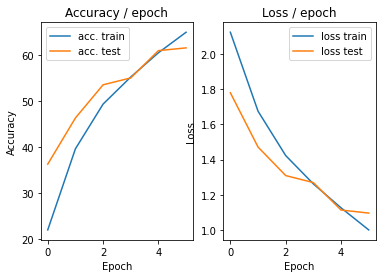

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.147s (0.147s)	Loss 0.9645 (0.9645)	Prec@1  68.8 ( 68.8)	Prec@5  96.9 ( 96.9)


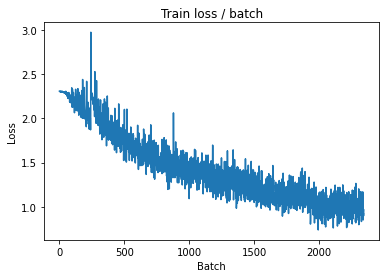

[TRAIN Batch 200/391]	Time 0.032s (0.018s)	Loss 0.9587 (0.8953)	Prec@1  64.8 ( 68.6)	Prec@5  97.7 ( 97.6)


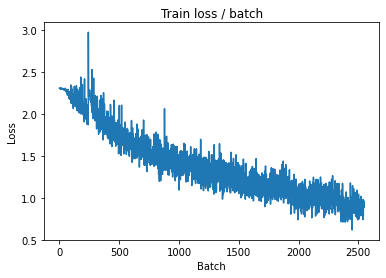


===============> Total time 7s	Avg loss 0.8859	Avg Prec@1 68.80 %	Avg Prec@5 97.62 %

[EVAL Batch 000/079]	Time 0.120s (0.120s)	Loss 0.8443 (0.8443)	Prec@1  68.8 ( 68.8)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 1.0142	Avg Prec@1 64.57 %	Avg Prec@5 96.77 %



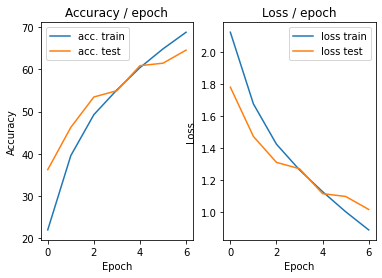

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.133s (0.133s)	Loss 0.8924 (0.8924)	Prec@1  65.6 ( 65.6)	Prec@5  98.4 ( 98.4)


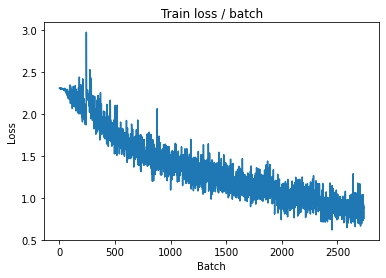

[TRAIN Batch 200/391]	Time 0.024s (0.018s)	Loss 0.6968 (0.7954)	Prec@1  76.6 ( 72.0)	Prec@5  98.4 ( 98.2)


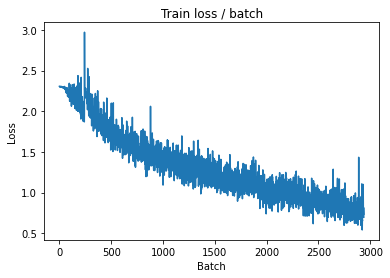


===============> Total time 7s	Avg loss 0.7855	Avg Prec@1 72.38 %	Avg Prec@5 98.30 %

[EVAL Batch 000/079]	Time 0.121s (0.121s)	Loss 0.8826 (0.8826)	Prec@1  72.7 ( 72.7)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 1.0114	Avg Prec@1 66.39 %	Avg Prec@5 97.00 %



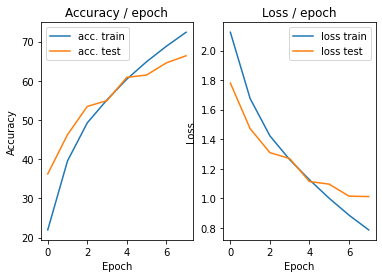

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.126s (0.126s)	Loss 0.8411 (0.8411)	Prec@1  70.3 ( 70.3)	Prec@5  98.4 ( 98.4)


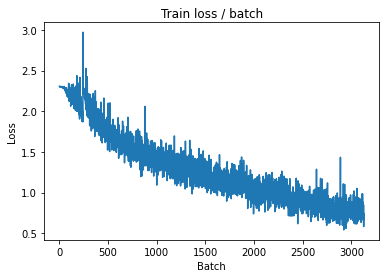

[TRAIN Batch 200/391]	Time 0.027s (0.018s)	Loss 0.6480 (0.6865)	Prec@1  78.9 ( 75.8)	Prec@5  97.7 ( 98.7)


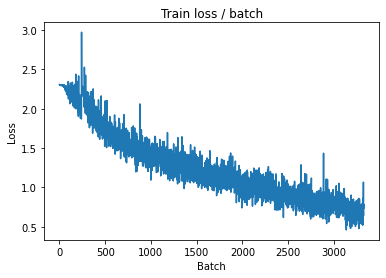


===============> Total time 6s	Avg loss 0.6879	Avg Prec@1 75.81 %	Avg Prec@5 98.71 %

[EVAL Batch 000/079]	Time 0.117s (0.117s)	Loss 0.8294 (0.8294)	Prec@1  72.7 ( 72.7)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.9067	Avg Prec@1 68.94 %	Avg Prec@5 97.35 %



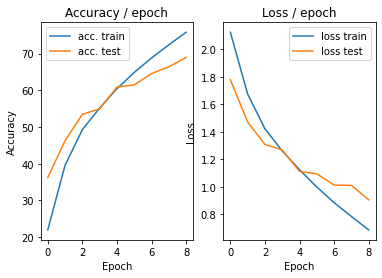

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.128s (0.128s)	Loss 0.5275 (0.5275)	Prec@1  82.0 ( 82.0)	Prec@5  99.2 ( 99.2)


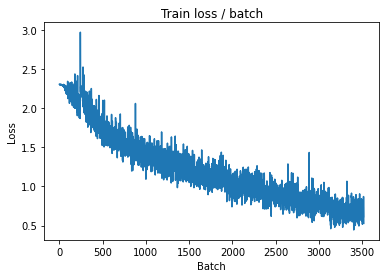

[TRAIN Batch 200/391]	Time 0.012s (0.018s)	Loss 0.5990 (0.5763)	Prec@1  80.5 ( 80.0)	Prec@5  97.7 ( 99.1)


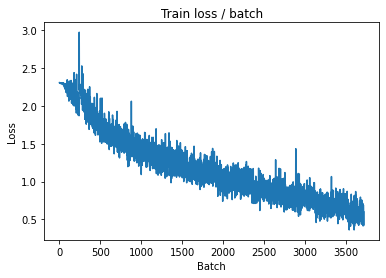


===============> Total time 7s	Avg loss 0.5937	Avg Prec@1 79.16 %	Avg Prec@5 99.11 %

[EVAL Batch 000/079]	Time 0.116s (0.116s)	Loss 0.8909 (0.8909)	Prec@1  71.9 ( 71.9)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.9401	Avg Prec@1 68.19 %	Avg Prec@5 97.18 %



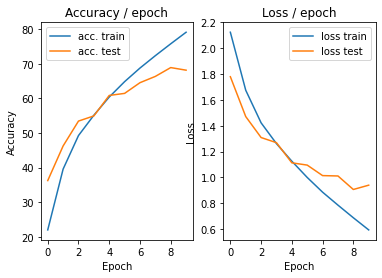

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.118s (0.118s)	Loss 0.3776 (0.3776)	Prec@1  87.5 ( 87.5)	Prec@5  99.2 ( 99.2)


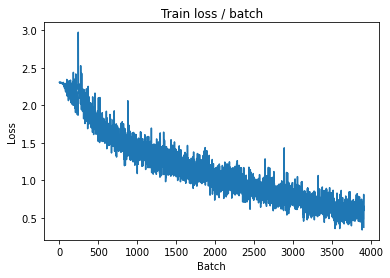

[TRAIN Batch 200/391]	Time 0.005s (0.018s)	Loss 0.4641 (0.4857)	Prec@1  80.5 ( 83.2)	Prec@5 100.0 ( 99.4)


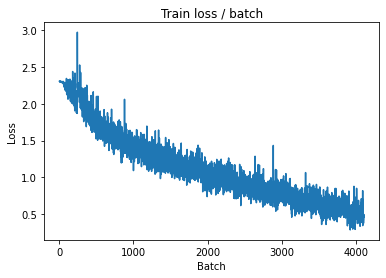


===============> Total time 6s	Avg loss 0.4969	Avg Prec@1 82.72 %	Avg Prec@5 99.40 %

[EVAL Batch 000/079]	Time 0.121s (0.121s)	Loss 0.9207 (0.9207)	Prec@1  71.9 ( 71.9)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.9806	Avg Prec@1 69.27 %	Avg Prec@5 96.96 %



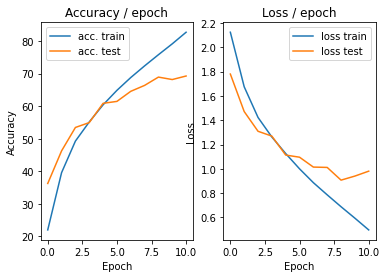

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.139s (0.139s)	Loss 0.4256 (0.4256)	Prec@1  85.2 ( 85.2)	Prec@5 100.0 (100.0)


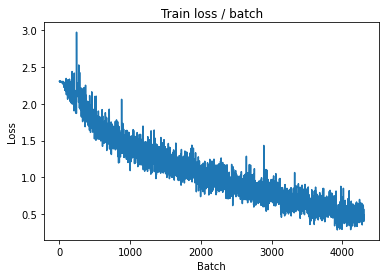

[TRAIN Batch 200/391]	Time 0.009s (0.018s)	Loss 0.3337 (0.3856)	Prec@1  88.3 ( 86.4)	Prec@5 100.0 ( 99.7)


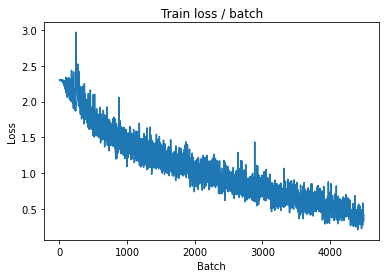


===============> Total time 6s	Avg loss 0.4064	Avg Prec@1 85.58 %	Avg Prec@5 99.66 %

[EVAL Batch 000/079]	Time 0.123s (0.123s)	Loss 0.9324 (0.9324)	Prec@1  74.2 ( 74.2)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.0582	Avg Prec@1 68.68 %	Avg Prec@5 96.75 %



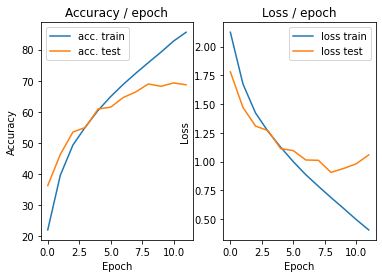

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.144s (0.144s)	Loss 0.2900 (0.2900)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


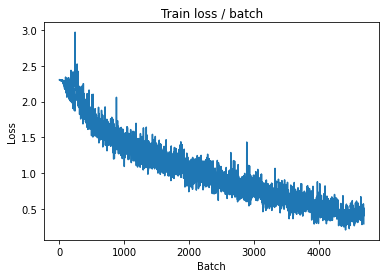

[TRAIN Batch 200/391]	Time 0.013s (0.018s)	Loss 0.2980 (0.2896)	Prec@1  89.1 ( 90.3)	Prec@5 100.0 ( 99.8)


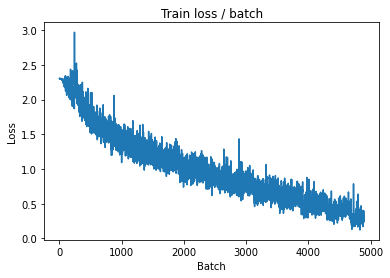


===============> Total time 6s	Avg loss 0.3129	Avg Prec@1 89.27 %	Avg Prec@5 99.83 %

[EVAL Batch 000/079]	Time 0.117s (0.117s)	Loss 1.1107 (1.1107)	Prec@1  71.1 ( 71.1)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 1.1732	Avg Prec@1 67.25 %	Avg Prec@5 97.10 %



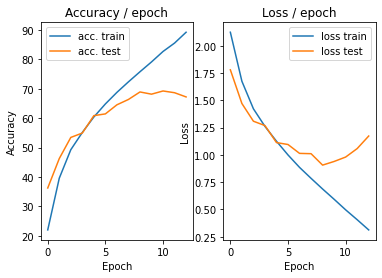

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.123s (0.123s)	Loss 0.3804 (0.3804)	Prec@1  85.2 ( 85.2)	Prec@5 100.0 (100.0)


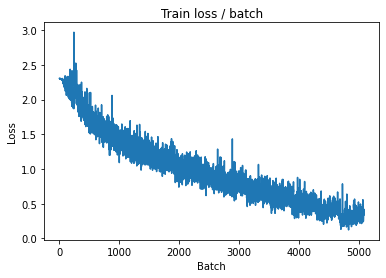

[TRAIN Batch 200/391]	Time 0.030s (0.019s)	Loss 0.3189 (0.2218)	Prec@1  89.1 ( 92.6)	Prec@5 100.0 ( 99.9)


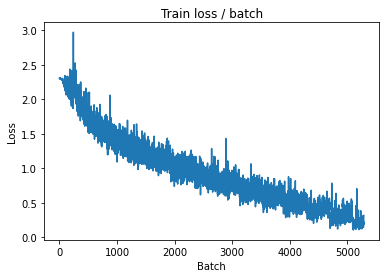


===============> Total time 7s	Avg loss 0.2429	Avg Prec@1 91.72 %	Avg Prec@5 99.92 %

[EVAL Batch 000/079]	Time 0.111s (0.111s)	Loss 1.0359 (1.0359)	Prec@1  72.7 ( 72.7)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.2417	Avg Prec@1 69.31 %	Avg Prec@5 96.71 %



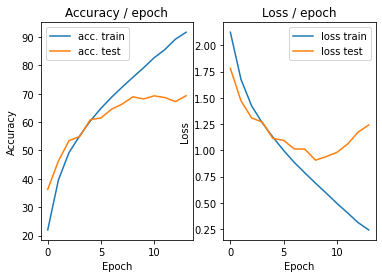

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.133s (0.133s)	Loss 0.1246 (0.1246)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


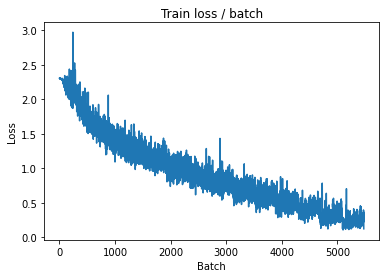

[TRAIN Batch 200/391]	Time 0.004s (0.018s)	Loss 0.1864 (0.1491)	Prec@1  91.4 ( 95.1)	Prec@5 100.0 (100.0)


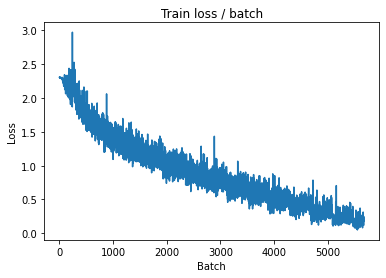


===============> Total time 7s	Avg loss 0.1715	Avg Prec@1 94.28 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.128s (0.128s)	Loss 1.2433 (1.2433)	Prec@1  71.9 ( 71.9)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 1.3494	Avg Prec@1 69.56 %	Avg Prec@5 97.04 %



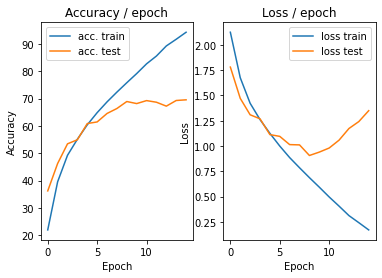

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.134s (0.134s)	Loss 0.0888 (0.0888)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


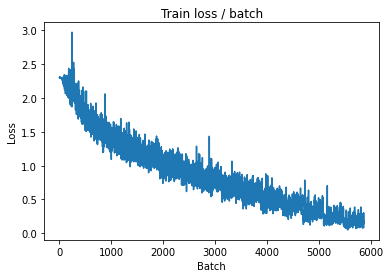

[TRAIN Batch 200/391]	Time 0.030s (0.018s)	Loss 0.2362 (0.1084)	Prec@1  91.4 ( 96.6)	Prec@5 100.0 (100.0)


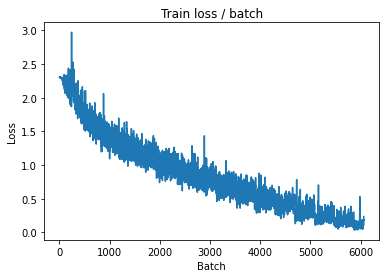


===============> Total time 6s	Avg loss 0.1269	Avg Prec@1 95.80 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.119s (0.119s)	Loss 1.4148 (1.4148)	Prec@1  72.7 ( 72.7)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 1.4621	Avg Prec@1 68.86 %	Avg Prec@5 97.14 %



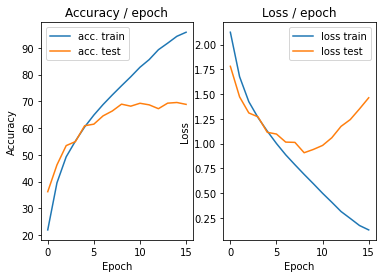

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.130s (0.130s)	Loss 0.1609 (0.1609)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


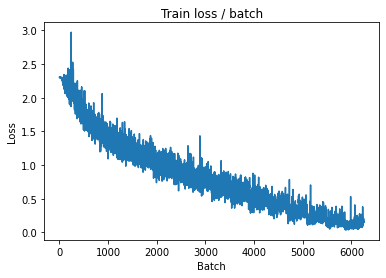

[TRAIN Batch 200/391]	Time 0.028s (0.018s)	Loss 0.0913 (0.0803)	Prec@1  96.9 ( 97.6)	Prec@5 100.0 (100.0)


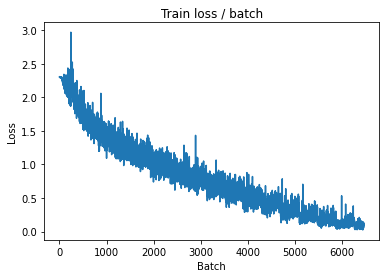


===============> Total time 6s	Avg loss 0.1046	Avg Prec@1 96.77 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.122s (0.122s)	Loss 1.4121 (1.4121)	Prec@1  71.9 ( 71.9)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 1.4061	Avg Prec@1 71.07 %	Avg Prec@5 97.06 %



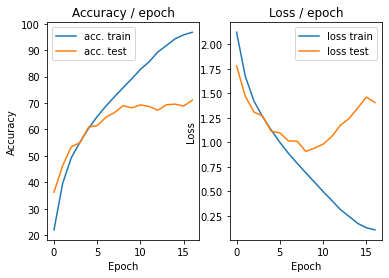

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.140s (0.140s)	Loss 0.0308 (0.0308)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


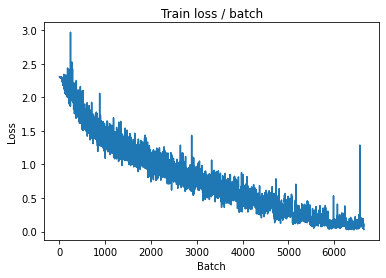

[TRAIN Batch 200/391]	Time 0.019s (0.018s)	Loss 0.0525 (0.0486)	Prec@1  97.7 ( 98.6)	Prec@5 100.0 (100.0)


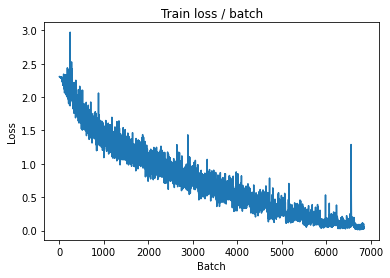


===============> Total time 6s	Avg loss 0.0597	Avg Prec@1 98.16 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.130s (0.130s)	Loss 1.3567 (1.3567)	Prec@1  75.0 ( 75.0)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 1.5859	Avg Prec@1 70.04 %	Avg Prec@5 96.85 %



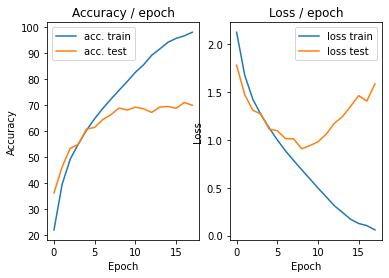

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.142s (0.142s)	Loss 0.0567 (0.0567)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


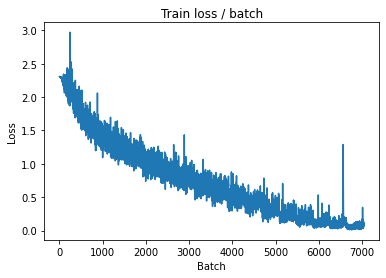

[TRAIN Batch 200/391]	Time 0.021s (0.018s)	Loss 0.1364 (0.0373)	Prec@1  96.1 ( 99.0)	Prec@5 100.0 (100.0)


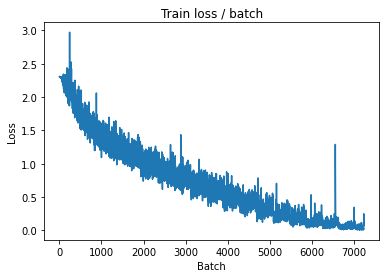


===============> Total time 6s	Avg loss 0.0726	Avg Prec@1 97.90 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.119s (0.119s)	Loss 1.4983 (1.4983)	Prec@1  76.6 ( 76.6)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 1.5448	Avg Prec@1 70.80 %	Avg Prec@5 97.09 %



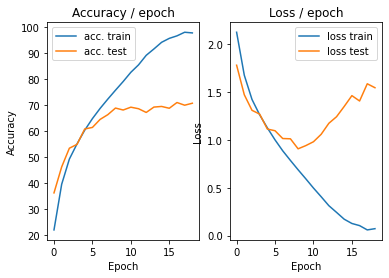

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.124s (0.124s)	Loss 0.0187 (0.0187)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


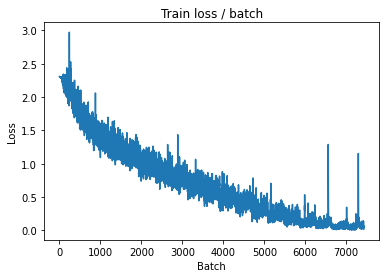

[TRAIN Batch 200/391]	Time 0.006s (0.018s)	Loss 0.0202 (0.0219)	Prec@1 100.0 ( 99.5)	Prec@5 100.0 (100.0)


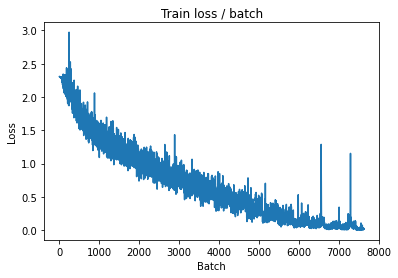


===============> Total time 6s	Avg loss 0.0357	Avg Prec@1 98.98 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.124s (0.124s)	Loss 1.9098 (1.9098)	Prec@1  71.9 ( 71.9)	Prec@5  95.3 ( 95.3)

===============> Total time 1s	Avg loss 1.8143	Avg Prec@1 68.56 %	Avg Prec@5 96.72 %



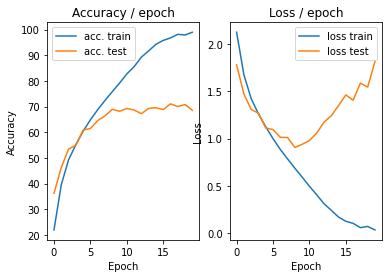

=== EPOCH 21 =====

[TRAIN Batch 000/391]	Time 0.124s (0.124s)	Loss 0.0584 (0.0584)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


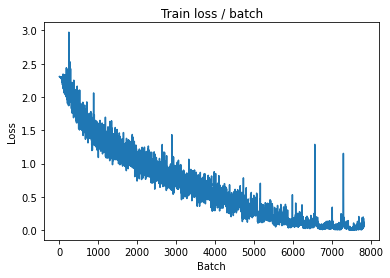

[TRAIN Batch 200/391]	Time 0.019s (0.018s)	Loss 0.0171 (0.0298)	Prec@1 100.0 ( 99.2)	Prec@5 100.0 (100.0)


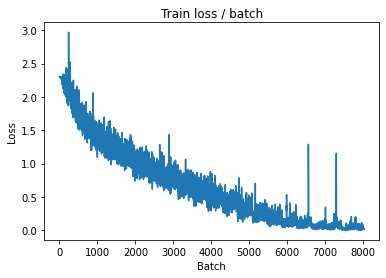


===============> Total time 6s	Avg loss 0.0484	Avg Prec@1 98.70 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.112s (0.112s)	Loss 1.7322 (1.7322)	Prec@1  77.3 ( 77.3)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.6919	Avg Prec@1 71.01 %	Avg Prec@5 97.03 %



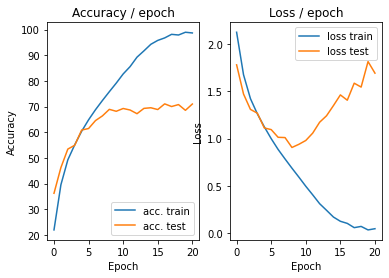

=== EPOCH 22 =====

[TRAIN Batch 000/391]	Time 0.134s (0.134s)	Loss 0.0090 (0.0090)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


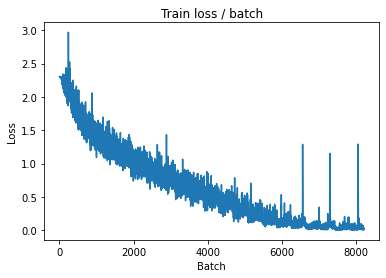

[TRAIN Batch 200/391]	Time 0.010s (0.018s)	Loss 0.0271 (0.0153)	Prec@1  99.2 ( 99.6)	Prec@5 100.0 (100.0)


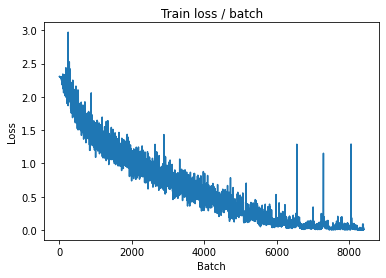


===============> Total time 6s	Avg loss 0.0192	Avg Prec@1 99.49 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.123s (0.123s)	Loss 1.8864 (1.8864)	Prec@1  75.8 ( 75.8)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 1.8316	Avg Prec@1 70.49 %	Avg Prec@5 96.76 %



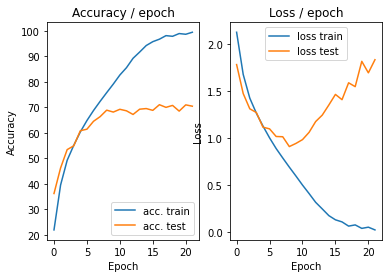

=== EPOCH 23 =====

[TRAIN Batch 000/391]	Time 0.115s (0.115s)	Loss 0.0141 (0.0141)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


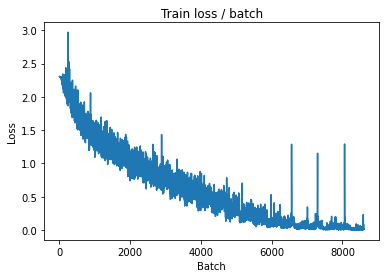

[TRAIN Batch 200/391]	Time 0.011s (0.018s)	Loss 0.0219 (0.0128)	Prec@1  99.2 ( 99.7)	Prec@5 100.0 (100.0)


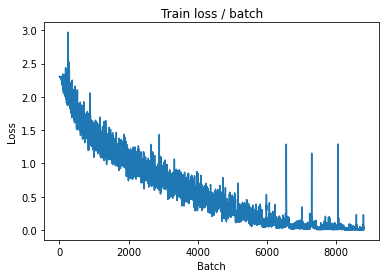


===============> Total time 6s	Avg loss 0.1071	Avg Prec@1 97.50 %	Avg Prec@5 99.81 %

[EVAL Batch 000/079]	Time 0.112s (0.112s)	Loss 1.4280 (1.4280)	Prec@1  75.0 ( 75.0)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 1.5136	Avg Prec@1 69.05 %	Avg Prec@5 96.64 %



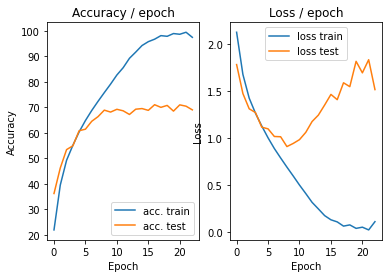

=== EPOCH 24 =====

[TRAIN Batch 000/391]	Time 0.111s (0.111s)	Loss 0.0621 (0.0621)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


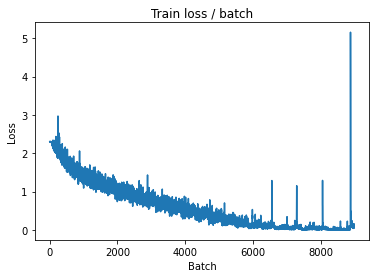

[TRAIN Batch 200/391]	Time 0.005s (0.017s)	Loss 0.0503 (0.0501)	Prec@1  97.7 ( 98.5)	Prec@5 100.0 (100.0)


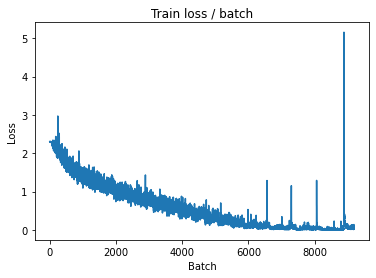


===============> Total time 6s	Avg loss 0.0542	Avg Prec@1 98.32 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.123s (0.123s)	Loss 1.8226 (1.8226)	Prec@1  70.3 ( 70.3)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 1.9989	Avg Prec@1 68.30 %	Avg Prec@5 96.53 %



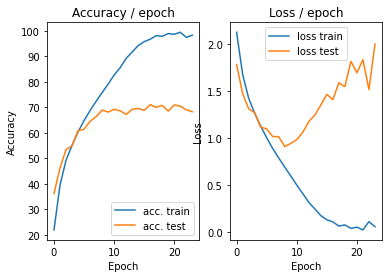

=== EPOCH 25 =====

[TRAIN Batch 000/391]	Time 0.138s (0.138s)	Loss 0.1541 (0.1541)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


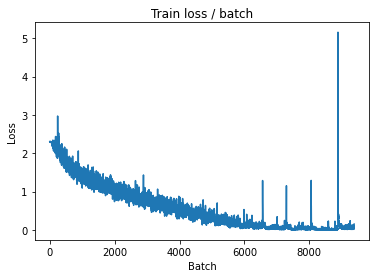

[TRAIN Batch 200/391]	Time 0.005s (0.019s)	Loss 0.0150 (0.0314)	Prec@1 100.0 ( 99.2)	Prec@5 100.0 (100.0)


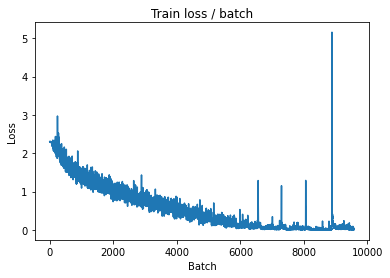


===============> Total time 7s	Avg loss 0.0285	Avg Prec@1 99.20 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.122s (0.122s)	Loss 1.7182 (1.7182)	Prec@1  74.2 ( 74.2)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 1.9716	Avg Prec@1 69.75 %	Avg Prec@5 96.74 %



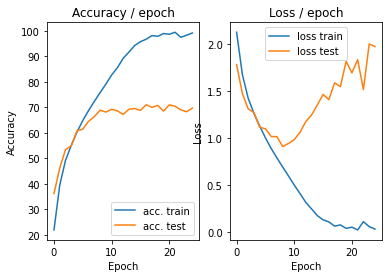

=== EPOCH 26 =====

[TRAIN Batch 000/391]	Time 0.139s (0.139s)	Loss 0.0588 (0.0588)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


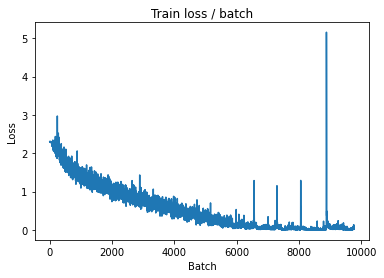

[TRAIN Batch 200/391]	Time 0.012s (0.018s)	Loss 0.0031 (0.0161)	Prec@1 100.0 ( 99.5)	Prec@5 100.0 (100.0)


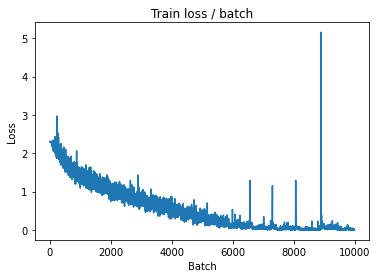


===============> Total time 6s	Avg loss 0.0151	Avg Prec@1 99.57 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.113s (0.113s)	Loss 2.0490 (2.0490)	Prec@1  72.7 ( 72.7)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 1.9964	Avg Prec@1 70.58 %	Avg Prec@5 96.83 %



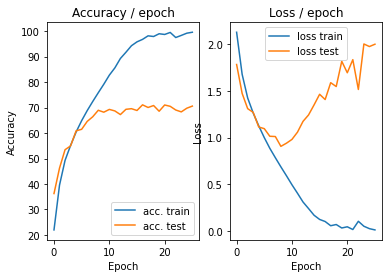

=== EPOCH 27 =====

[TRAIN Batch 000/391]	Time 0.129s (0.129s)	Loss 0.0050 (0.0050)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


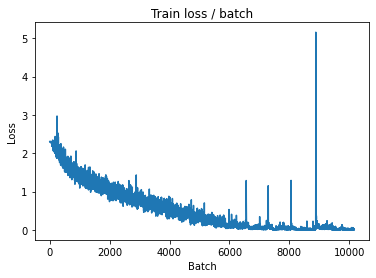

[TRAIN Batch 200/391]	Time 0.019s (0.018s)	Loss 0.0041 (0.0100)	Prec@1 100.0 ( 99.8)	Prec@5 100.0 (100.0)


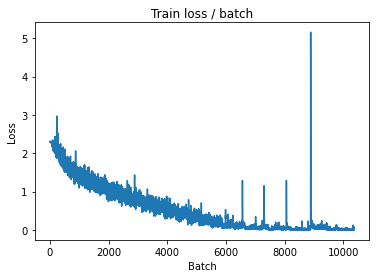


===============> Total time 6s	Avg loss 0.0112	Avg Prec@1 99.71 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.111s (0.111s)	Loss 2.0820 (2.0820)	Prec@1  75.0 ( 75.0)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 2.0290	Avg Prec@1 70.99 %	Avg Prec@5 97.25 %



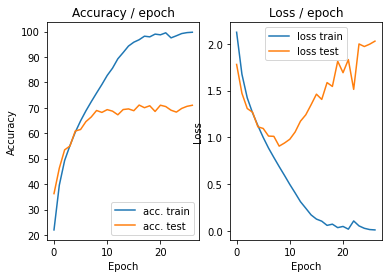

=== EPOCH 28 =====

[TRAIN Batch 000/391]	Time 0.116s (0.116s)	Loss 0.0465 (0.0465)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


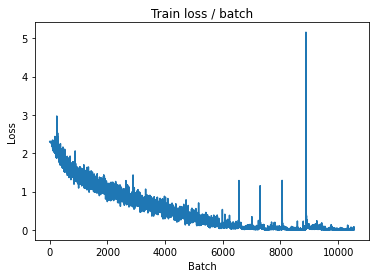

[TRAIN Batch 200/391]	Time 0.032s (0.017s)	Loss 0.0016 (0.0070)	Prec@1 100.0 ( 99.8)	Prec@5 100.0 (100.0)


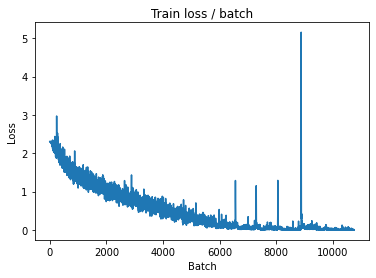


===============> Total time 6s	Avg loss 0.0055	Avg Prec@1 99.88 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.114s (0.114s)	Loss 2.1769 (2.1769)	Prec@1  77.3 ( 77.3)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 2.1328	Avg Prec@1 70.68 %	Avg Prec@5 96.98 %



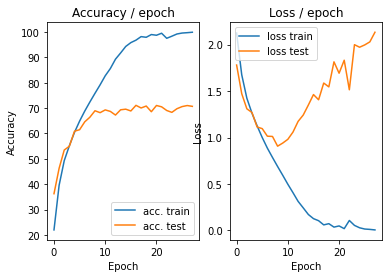

=== EPOCH 29 =====

[TRAIN Batch 000/391]	Time 0.133s (0.133s)	Loss 0.0041 (0.0041)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


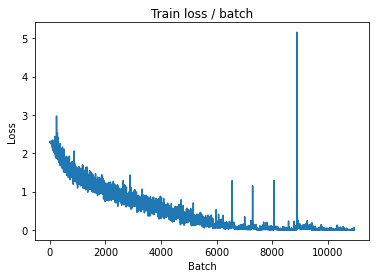

[TRAIN Batch 200/391]	Time 0.028s (0.017s)	Loss 0.0008 (0.0036)	Prec@1 100.0 ( 99.9)	Prec@5 100.0 (100.0)


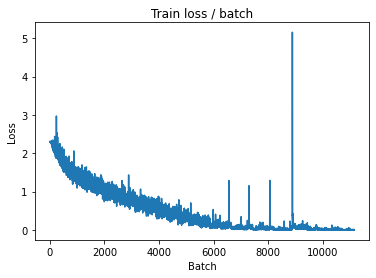


===============> Total time 6s	Avg loss 0.0025	Avg Prec@1 99.94 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.113s (0.113s)	Loss 2.2382 (2.2382)	Prec@1  78.1 ( 78.1)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 2.1278	Avg Prec@1 72.01 %	Avg Prec@5 97.17 %



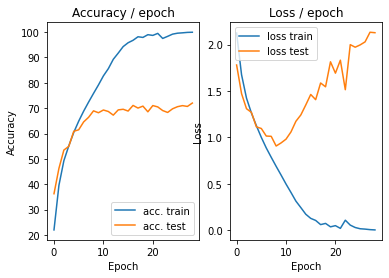

=== EPOCH 30 =====

[TRAIN Batch 000/391]	Time 0.123s (0.123s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


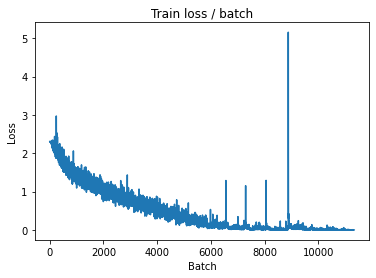

[TRAIN Batch 200/391]	Time 0.005s (0.017s)	Loss 0.0003 (0.0005)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


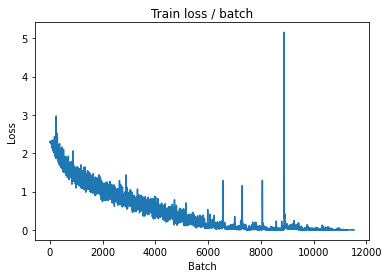


===============> Total time 6s	Avg loss 0.0005	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.115s (0.115s)	Loss 2.2558 (2.2558)	Prec@1  76.6 ( 76.6)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 2.1778	Avg Prec@1 72.12 %	Avg Prec@5 97.21 %



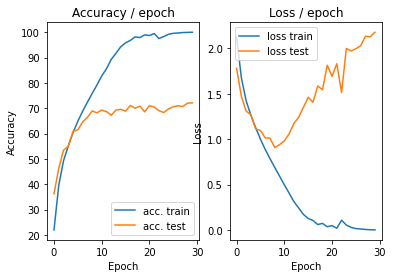

=== EPOCH 31 =====

[TRAIN Batch 000/391]	Time 0.127s (0.127s)	Loss 0.0003 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


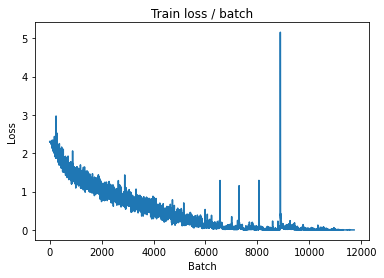

[TRAIN Batch 200/391]	Time 0.023s (0.017s)	Loss 0.0002 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


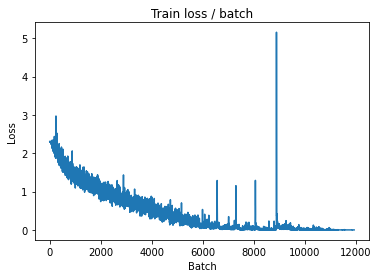


===============> Total time 6s	Avg loss 0.0003	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.113s (0.113s)	Loss 2.2837 (2.2837)	Prec@1  77.3 ( 77.3)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 2.2107	Avg Prec@1 72.14 %	Avg Prec@5 97.23 %



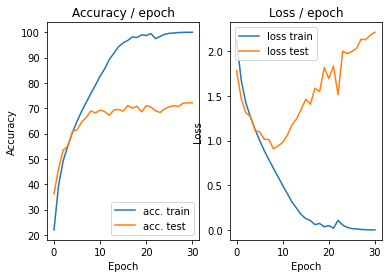

=== EPOCH 32 =====

[TRAIN Batch 000/391]	Time 0.137s (0.137s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


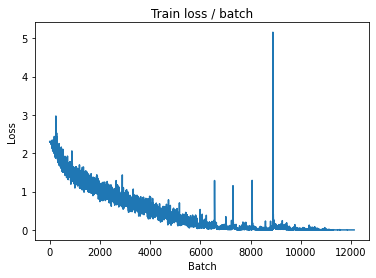

[TRAIN Batch 200/391]	Time 0.023s (0.017s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


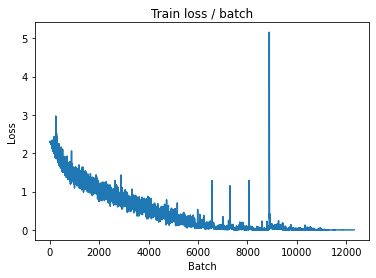


===============> Total time 6s	Avg loss 0.0002	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.115s (0.115s)	Loss 2.3049 (2.3049)	Prec@1  76.6 ( 76.6)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 2.2408	Avg Prec@1 72.20 %	Avg Prec@5 97.25 %



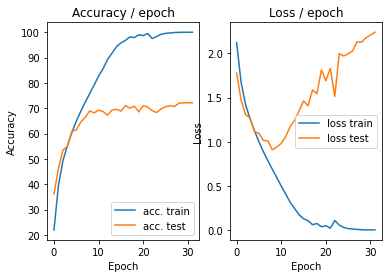

=== EPOCH 33 =====

[TRAIN Batch 000/391]	Time 0.123s (0.123s)	Loss 0.0003 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


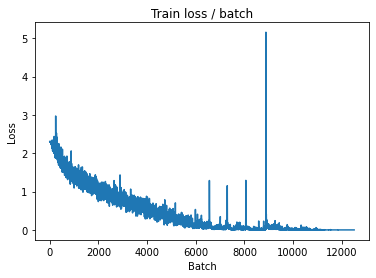

[TRAIN Batch 200/391]	Time 0.011s (0.017s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


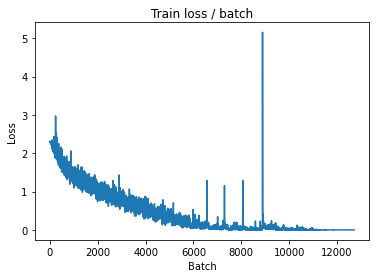


===============> Total time 6s	Avg loss 0.0002	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.112s (0.112s)	Loss 2.3315 (2.3315)	Prec@1  77.3 ( 77.3)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 2.2627	Avg Prec@1 72.26 %	Avg Prec@5 97.23 %



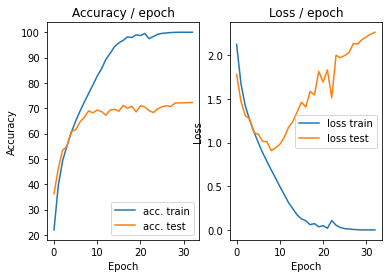

=== EPOCH 34 =====

[TRAIN Batch 000/391]	Time 0.124s (0.124s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


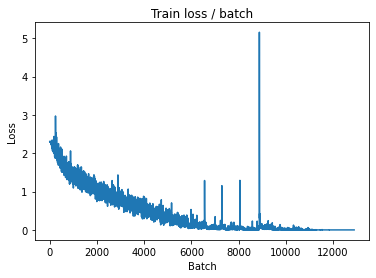

[TRAIN Batch 200/391]	Time 0.027s (0.017s)	Loss 0.0001 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


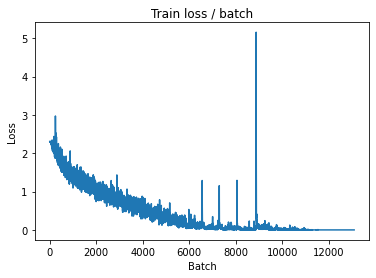


===============> Total time 6s	Avg loss 0.0002	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.114s (0.114s)	Loss 2.3480 (2.3480)	Prec@1  77.3 ( 77.3)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 2.2848	Avg Prec@1 72.21 %	Avg Prec@5 97.25 %



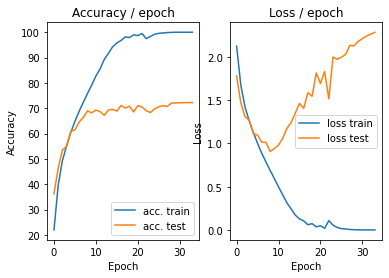

=== EPOCH 35 =====

[TRAIN Batch 000/391]	Time 0.134s (0.134s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


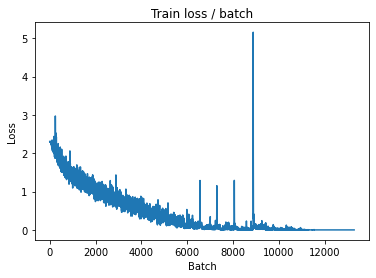

[TRAIN Batch 200/391]	Time 0.028s (0.017s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


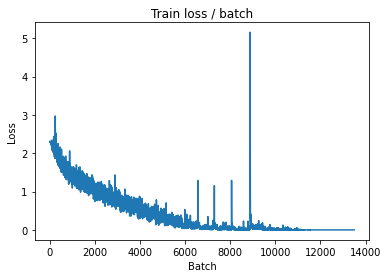


===============> Total time 6s	Avg loss 0.0002	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.119s (0.119s)	Loss 2.3639 (2.3639)	Prec@1  77.3 ( 77.3)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 2.3048	Avg Prec@1 72.21 %	Avg Prec@5 97.25 %



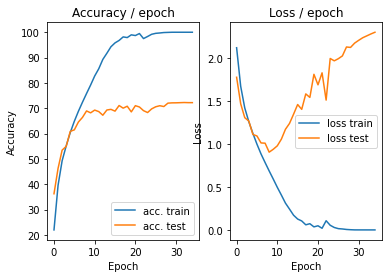

=== EPOCH 36 =====

[TRAIN Batch 000/391]	Time 0.132s (0.132s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


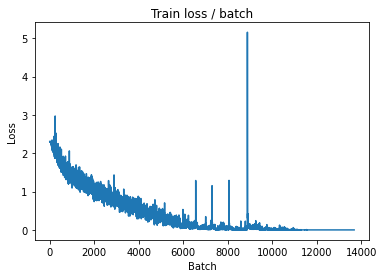

[TRAIN Batch 200/391]	Time 0.013s (0.018s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


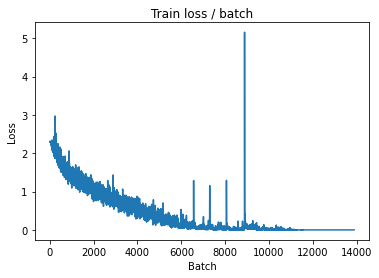


===============> Total time 6s	Avg loss 0.0001	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.120s (0.120s)	Loss 2.3843 (2.3843)	Prec@1  77.3 ( 77.3)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 2.3209	Avg Prec@1 72.21 %	Avg Prec@5 97.24 %



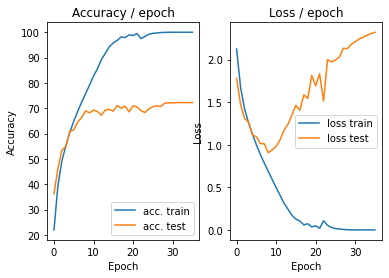

=== EPOCH 37 =====

[TRAIN Batch 000/391]	Time 0.126s (0.126s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


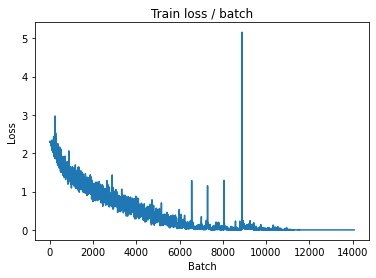

[TRAIN Batch 200/391]	Time 0.023s (0.017s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


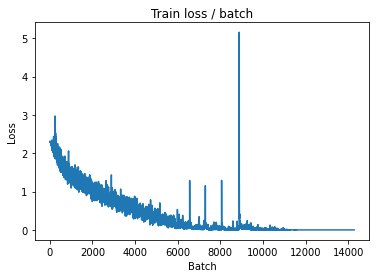


===============> Total time 6s	Avg loss 0.0001	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.116s (0.116s)	Loss 2.3977 (2.3977)	Prec@1  77.3 ( 77.3)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 2.3375	Avg Prec@1 72.26 %	Avg Prec@5 97.25 %



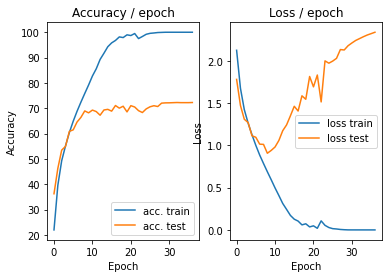

=== EPOCH 38 =====

[TRAIN Batch 000/391]	Time 0.122s (0.122s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


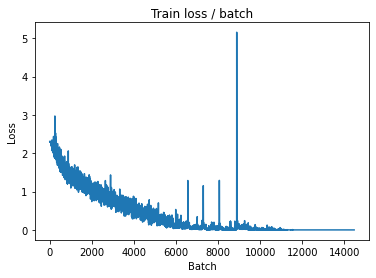

[TRAIN Batch 200/391]	Time 0.005s (0.017s)	Loss 0.0003 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


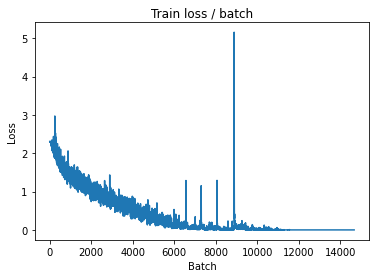


===============> Total time 6s	Avg loss 0.0001	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.112s (0.112s)	Loss 2.4084 (2.4084)	Prec@1  77.3 ( 77.3)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 2.3524	Avg Prec@1 72.26 %	Avg Prec@5 97.23 %



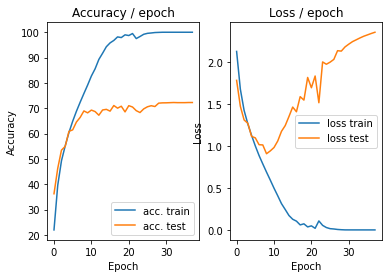

=== EPOCH 39 =====

[TRAIN Batch 000/391]	Time 0.120s (0.120s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


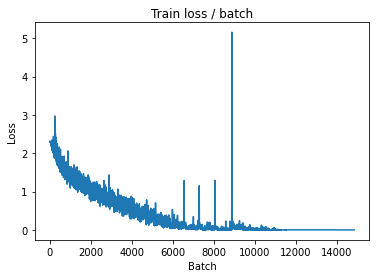

[TRAIN Batch 200/391]	Time 0.009s (0.017s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


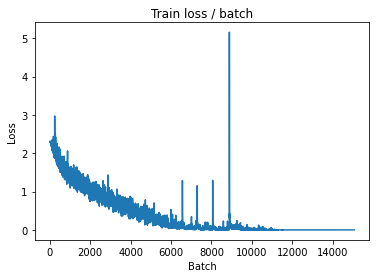


===============> Total time 6s	Avg loss 0.0001	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.118s (0.118s)	Loss 2.4228 (2.4228)	Prec@1  77.3 ( 77.3)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 2.3660	Avg Prec@1 72.29 %	Avg Prec@5 97.24 %



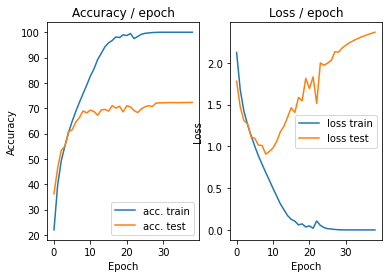

=== EPOCH 40 =====

[TRAIN Batch 000/391]	Time 0.121s (0.121s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


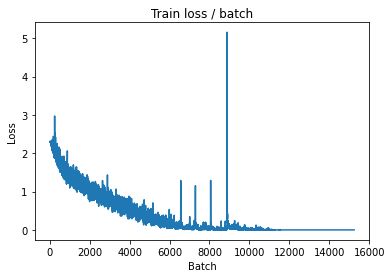

[TRAIN Batch 200/391]	Time 0.008s (0.017s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


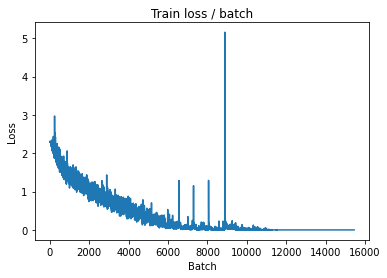


===============> Total time 6s	Avg loss 0.0001	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.115s (0.115s)	Loss 2.4340 (2.4340)	Prec@1  77.3 ( 77.3)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 2.3780	Avg Prec@1 72.26 %	Avg Prec@5 97.24 %



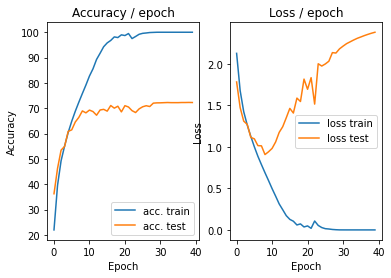

=== EPOCH 41 =====

[TRAIN Batch 000/391]	Time 0.139s (0.139s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


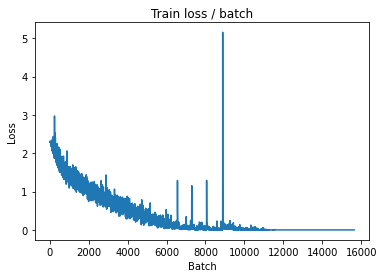

[TRAIN Batch 200/391]	Time 0.005s (0.018s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


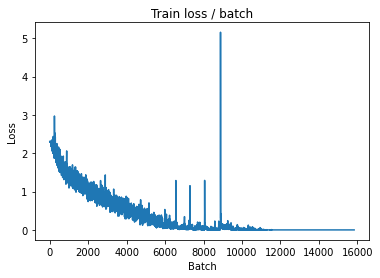


===============> Total time 6s	Avg loss 0.0001	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.118s (0.118s)	Loss 2.4412 (2.4412)	Prec@1  78.1 ( 78.1)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 2.3909	Avg Prec@1 72.30 %	Avg Prec@5 97.27 %



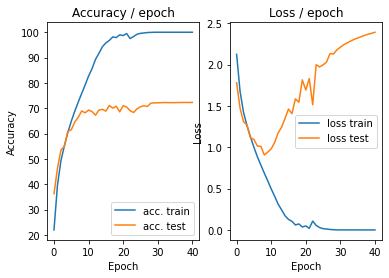

=== EPOCH 42 =====

[TRAIN Batch 000/391]	Time 0.136s (0.136s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


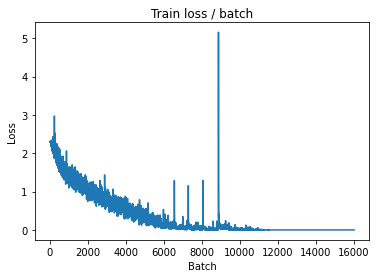

[TRAIN Batch 200/391]	Time 0.010s (0.017s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


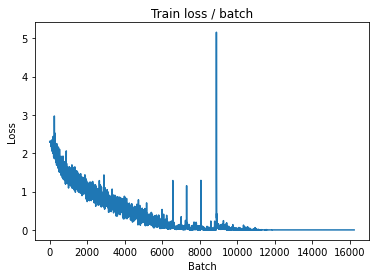


===============> Total time 6s	Avg loss 0.0001	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.109s (0.109s)	Loss 2.4512 (2.4512)	Prec@1  78.1 ( 78.1)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 2.4014	Avg Prec@1 72.32 %	Avg Prec@5 97.23 %



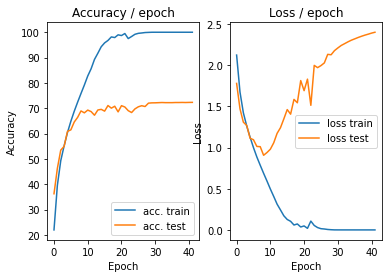

In [ ]:
main(batch_size=128,lr=0.1,epochs=42,cuda=True)

### Learning rate et taille des batchs

On conduit la même analyse que précédemment.

In [ ]:
results_batch_cifar = []
batch_sizes = [32,64,128,256,512,1024,2048]
for b in batch_sizes:
  res = main(batch_size=b, lr=0.1, epochs=15, cuda=True, namebase=datasets.CIFAR10, print_results=False)
  results_batch_cifar.append(res)

results_lr_cifar = []
lr_list = [0.001,0.005,0.01,0.05,0.1,0.5,1]
for lr in lr_list:
    res = main(batch_size=128, lr=lr, epochs=15, cuda=True, namebase=datasets.CIFAR10, print_results=False)
    results_lr_cifar.append(res)

7


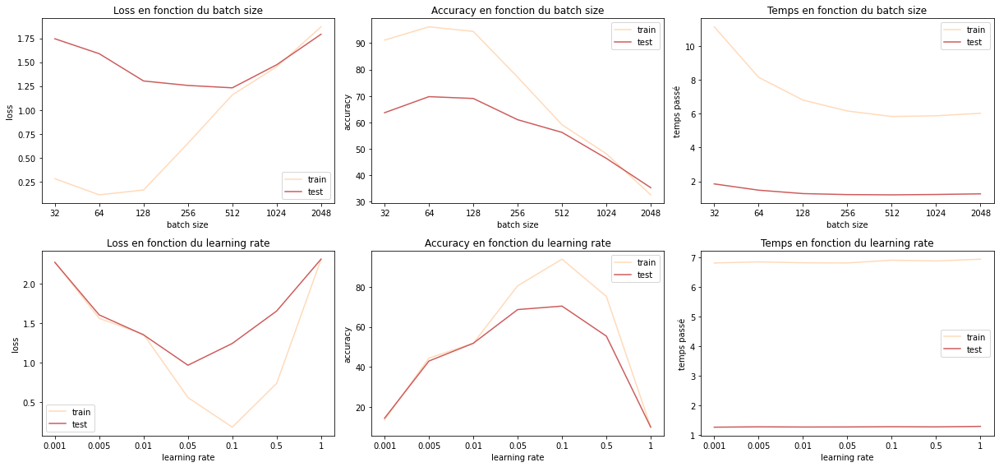

In [ ]:
etude = plt.figure(figsize=(17,8))
res_batch_arr_cifar = np.array(results_batch_cifar)
size_res = len(results_batch_cifar)
print(size_res)
# loss
ax1 = etude.add_subplot(231)
ax1.plot(np.arange(size_res),res_batch_arr_cifar[:,0],label = 'train',color='peachpuff')
ax1.plot(np.arange(size_res),res_batch_arr_cifar[:,1],label = 'test',color='indianred')
ax1.title.set_text('Loss en fonction du batch size')
ax1.set(xlabel='batch size',ylabel='loss')
ax1.set_xticks(np.arange(size_res))
ax1.set_xticklabels(batch_sizes)
ax1.legend()
# accuracy
ax2 = etude.add_subplot(232)
ax2.plot(np.arange(size_res),res_batch_arr_cifar[:,2],label = 'train',color='peachpuff')
ax2.plot(np.arange(size_res),res_batch_arr_cifar[:,3],label = 'test',color='indianred')
ax2.title.set_text('Accuracy en fonction du batch size')
ax2.set(xlabel='batch size',ylabel='accuracy')
ax2.set_xticks(np.arange(size_res))
ax2.set_xticklabels(batch_sizes)
ax2.legend()
# time
ax3 = etude.add_subplot(233)
ax3.plot(np.arange(size_res),res_batch_arr_cifar[:,4],label = 'train',color='peachpuff')
ax3.plot(np.arange(size_res),res_batch_arr_cifar[:,5],label = 'test',color='indianred')
ax3.title.set_text('Temps en fonction du batch size')
ax3.set(xlabel='batch size',ylabel='temps passé')
ax3.set_xticks(np.arange(size_res))
ax3.set_xticklabels(batch_sizes)
ax3.legend()

res_lr_arr = np.array(results_lr_cifar)
size_res_lr = len(results_lr_cifar)
# loss
ax4 = etude.add_subplot(234)
ax4.plot(np.arange(size_res_lr),res_lr_arr[:,0],label = 'train',color='peachpuff')
ax4.plot(np.arange(size_res_lr),res_lr_arr[:,1],label = 'test',color='indianred')
ax4.title.set_text('Loss en fonction du learning rate')
ax4.set(xlabel='learning rate',ylabel='loss')
ax4.set_xticks(np.arange(size_res_lr))
ax4.set_xticklabels(lr_list)
ax4.legend()
# accuracy
ax5 = etude.add_subplot(235)
ax5.plot(np.arange(size_res_lr),res_lr_arr[:,2],label = 'train',color='peachpuff')
ax5.plot(np.arange(size_res_lr),res_lr_arr[:,3],label = 'test',color='indianred')
ax5.title.set_text('Accuracy en fonction du learning rate')
ax5.set(xlabel='learning rate',ylabel='accuracy')
ax5.set_xticks(np.arange(size_res_lr))
ax5.set_xticklabels(lr_list)
ax5.legend()
# time
ax6 = etude.add_subplot(236)
ax6.plot(np.arange(size_res_lr),res_lr_arr[:,4],label = 'train',color='peachpuff')
ax6.plot(np.arange(size_res_lr),res_lr_arr[:,5],label = 'test',color='indianred')
ax6.title.set_text('Temps en fonction du learning rate')
ax6.set(xlabel='learning rate',ylabel='temps passé')
ax6.set_xticks(np.arange(size_res_lr))
ax6.set_xticklabels(lr_list)
ax6.legend()

plt.tight_layout()
plt.show()

## Normalisation des exemples

Normaliser les exemples en train permet de mieux conditionner l’apprentissage. On normalise chaque image en soustrayant à chaque pixel la valeur moyenne correspondant à son channel et en le divisant par l’écart type correspondant.  

Pour cela, on redéfinit get_dataset : il s'agit de transformer les données. Les valeurs de moyenne et d'écart-type pour CIFAR-10 sont μ = [0.491, 0.482, 0.447] et σ = [0.202, 0.199, 0.201].

La classe ConvNet ne bouge pas.

### Normalisation standard



In [6]:
def get_dataset(name, batch_size, cuda=False):
    """
    Cette fonction charge le dataset et effectue des transformations sur chaque
    image (listées dans `transform = ...`).
    """
    train_dataset = name(PATH, train=True, download=True,
        transform = transforms.Compose([
            transforms.ToTensor(),
            # -- Normalisation standard (avec la moyenne et l'écart type) --
            transforms.Normalize(mean=[0.491,0.482,0.447],std=[0.202,0.199,0.201])
        ]))
    
    val_dataset = name(PATH, train=False, download=True,
        transform = transforms.Compose([
            transforms.ToTensor(),
            # -- Normalisation standard (avec la moyenne et l'écart type) --
            transforms.Normalize(mean=[0.491,0.482,0.447],std=[0.202,0.199,0.201])
        ]))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader

Files already downloaded and verified
Files already downloaded and verified
=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.353s (0.353s)	Loss 2.3010 (2.3010)	Prec@1   9.4 (  9.4)	Prec@5  54.7 ( 54.7)


<Figure size 432x288 with 0 Axes>

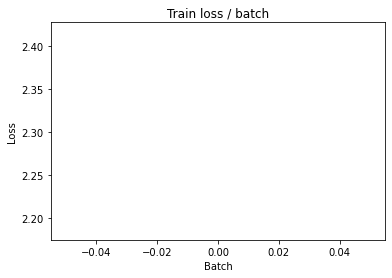

[TRAIN Batch 200/391]	Time 0.061s (0.039s)	Loss 1.7161 (1.9181)	Prec@1  36.7 ( 29.9)	Prec@5  86.7 ( 80.8)


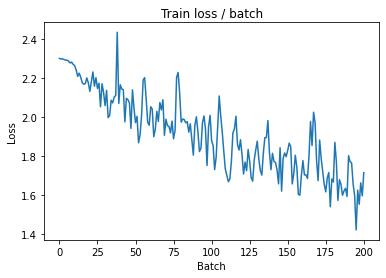


===============> Total time 15s	Avg loss 1.7262	Avg Prec@1 37.39 %	Avg Prec@5 85.89 %

[EVAL Batch 000/079]	Time 0.148s (0.148s)	Loss 1.3286 (1.3286)	Prec@1  57.0 ( 57.0)	Prec@5  90.6 ( 90.6)

===============> Total time 2s	Avg loss 1.3836	Avg Prec@1 49.56 %	Avg Prec@5 93.23 %



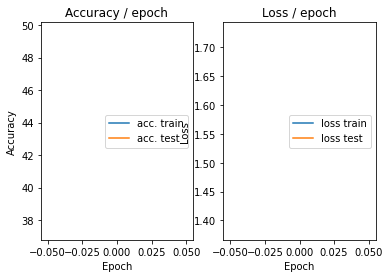

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.162s (0.162s)	Loss 1.2033 (1.2033)	Prec@1  53.1 ( 53.1)	Prec@5  97.7 ( 97.7)


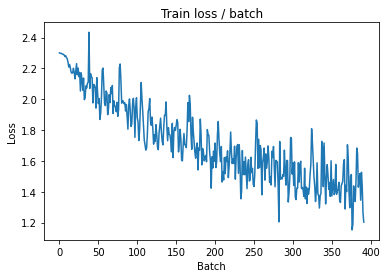

[TRAIN Batch 200/391]	Time 0.056s (0.039s)	Loss 1.2867 (1.3319)	Prec@1  49.2 ( 52.4)	Prec@5  94.5 ( 93.8)


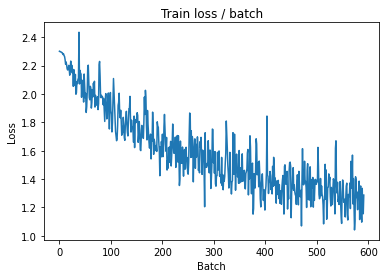


===============> Total time 15s	Avg loss 1.2740	Avg Prec@1 54.78 %	Avg Prec@5 94.47 %

[EVAL Batch 000/079]	Time 0.146s (0.146s)	Loss 1.3169 (1.3169)	Prec@1  57.8 ( 57.8)	Prec@5  93.0 ( 93.0)

===============> Total time 2s	Avg loss 1.3183	Avg Prec@1 52.11 %	Avg Prec@5 95.71 %



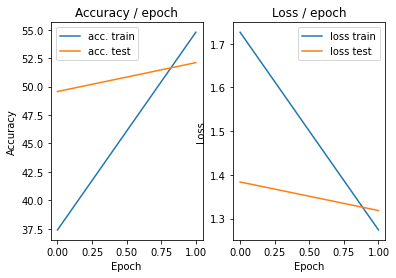

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.170s (0.170s)	Loss 1.2262 (1.2262)	Prec@1  60.9 ( 60.9)	Prec@5  95.3 ( 95.3)


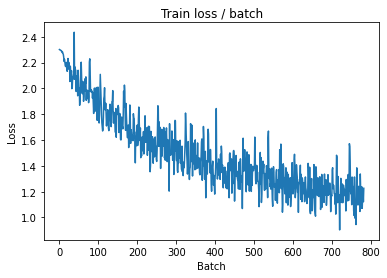

[TRAIN Batch 200/391]	Time 0.061s (0.039s)	Loss 1.1263 (1.0776)	Prec@1  59.4 ( 62.2)	Prec@5  93.8 ( 96.5)


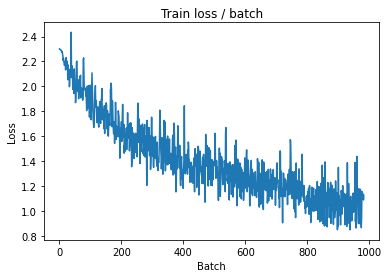


===============> Total time 14s	Avg loss 1.0412	Avg Prec@1 63.58 %	Avg Prec@5 96.58 %

[EVAL Batch 000/079]	Time 0.156s (0.156s)	Loss 1.1460 (1.1460)	Prec@1  57.8 ( 57.8)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.0853	Avg Prec@1 62.35 %	Avg Prec@5 95.98 %



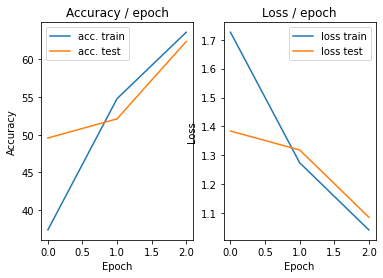

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.170s (0.170s)	Loss 1.0279 (1.0279)	Prec@1  66.4 ( 66.4)	Prec@5  97.7 ( 97.7)


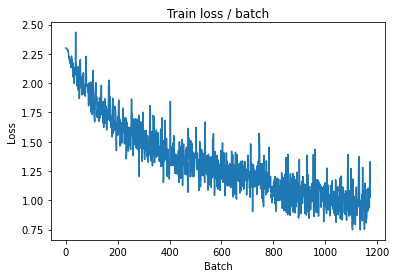

[TRAIN Batch 200/391]	Time 0.026s (0.038s)	Loss 0.7445 (0.8817)	Prec@1  74.2 ( 69.4)	Prec@5  98.4 ( 97.7)


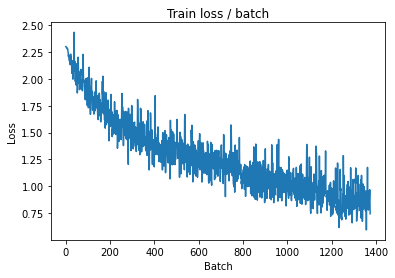


===============> Total time 14s	Avg loss 0.8678	Avg Prec@1 69.79 %	Avg Prec@5 97.79 %

[EVAL Batch 000/079]	Time 0.148s (0.148s)	Loss 0.8748 (0.8748)	Prec@1  71.9 ( 71.9)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.9247	Avg Prec@1 67.88 %	Avg Prec@5 97.21 %



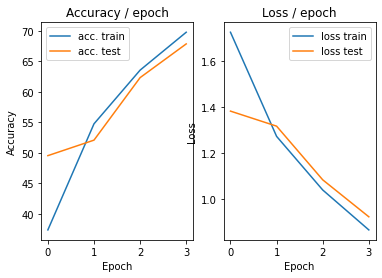

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.153s (0.153s)	Loss 0.6140 (0.6140)	Prec@1  78.1 ( 78.1)	Prec@5  98.4 ( 98.4)


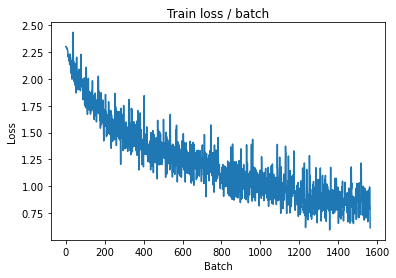

[TRAIN Batch 200/391]	Time 0.061s (0.039s)	Loss 0.7248 (0.7327)	Prec@1  75.0 ( 74.6)	Prec@5  97.7 ( 98.5)


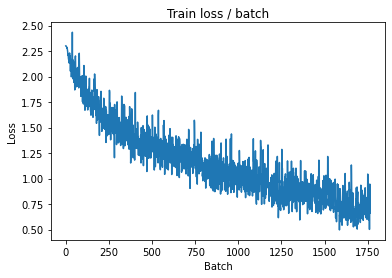


===============> Total time 14s	Avg loss 0.7258	Avg Prec@1 74.86 %	Avg Prec@5 98.49 %

[EVAL Batch 000/079]	Time 0.151s (0.151s)	Loss 0.8575 (0.8575)	Prec@1  71.9 ( 71.9)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.9072	Avg Prec@1 69.77 %	Avg Prec@5 97.16 %



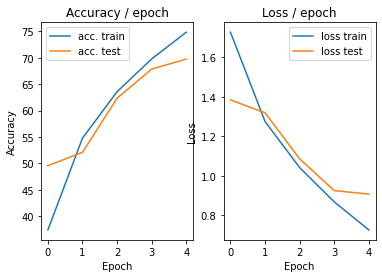

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.155s (0.155s)	Loss 0.4942 (0.4942)	Prec@1  82.8 ( 82.8)	Prec@5 100.0 (100.0)


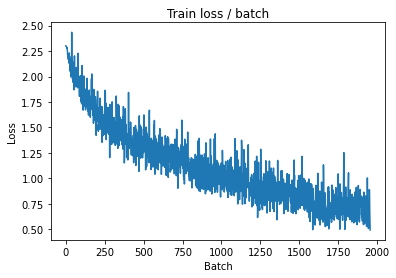

[TRAIN Batch 200/391]	Time 0.022s (0.040s)	Loss 0.6137 (0.5895)	Prec@1  76.6 ( 79.6)	Prec@5  98.4 ( 99.1)


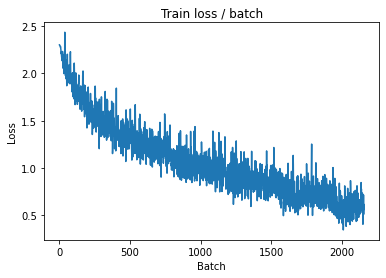


===============> Total time 15s	Avg loss 0.6015	Avg Prec@1 79.11 %	Avg Prec@5 98.98 %

[EVAL Batch 000/079]	Time 0.147s (0.147s)	Loss 0.7886 (0.7886)	Prec@1  75.0 ( 75.0)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.9472	Avg Prec@1 69.18 %	Avg Prec@5 96.91 %



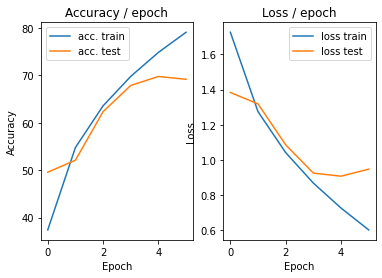

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.164s (0.164s)	Loss 0.4595 (0.4595)	Prec@1  85.2 ( 85.2)	Prec@5  98.4 ( 98.4)


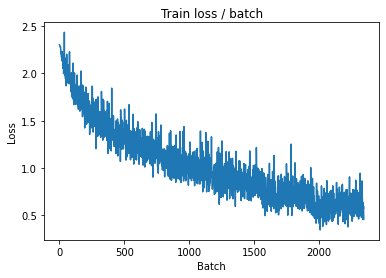

[TRAIN Batch 200/391]	Time 0.021s (0.038s)	Loss 0.4092 (0.4746)	Prec@1  87.5 ( 83.7)	Prec@5 100.0 ( 99.4)


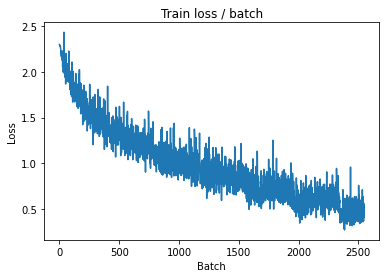


===============> Total time 14s	Avg loss 0.4864	Avg Prec@1 83.04 %	Avg Prec@5 99.39 %

[EVAL Batch 000/079]	Time 0.152s (0.152s)	Loss 0.8508 (0.8508)	Prec@1  71.1 ( 71.1)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.8883	Avg Prec@1 71.51 %	Avg Prec@5 97.64 %



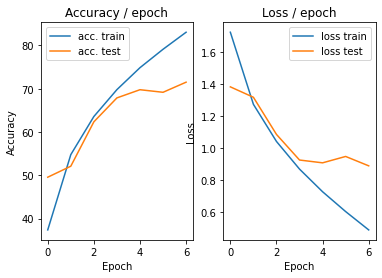

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.165s (0.165s)	Loss 0.2582 (0.2582)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


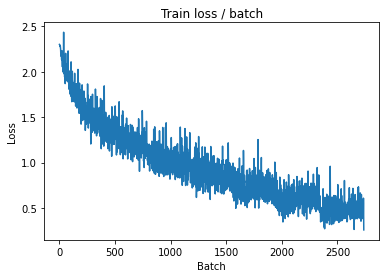

[TRAIN Batch 200/391]	Time 0.055s (0.039s)	Loss 0.4792 (0.3543)	Prec@1  78.9 ( 87.7)	Prec@5 100.0 ( 99.7)


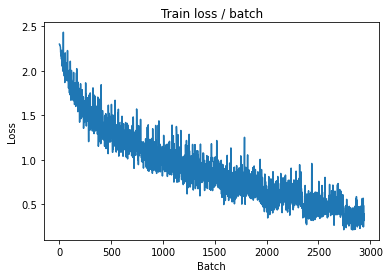


===============> Total time 15s	Avg loss 0.3777	Avg Prec@1 86.75 %	Avg Prec@5 99.70 %

[EVAL Batch 000/079]	Time 0.153s (0.153s)	Loss 0.8724 (0.8724)	Prec@1  78.1 ( 78.1)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.8999	Avg Prec@1 73.29 %	Avg Prec@5 97.77 %



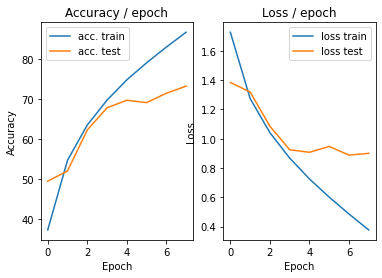

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.159s (0.159s)	Loss 0.3091 (0.3091)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)


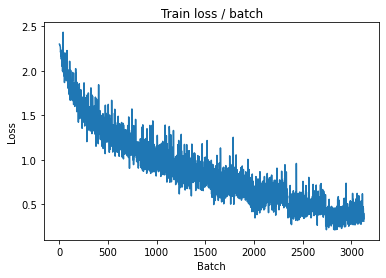

[TRAIN Batch 200/391]	Time 0.020s (0.039s)	Loss 0.2576 (0.2574)	Prec@1  91.4 ( 91.3)	Prec@5 100.0 ( 99.9)


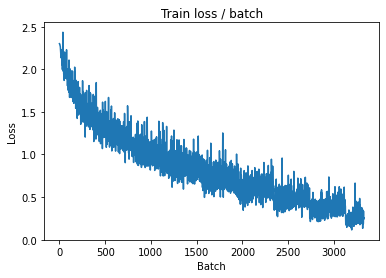


===============> Total time 15s	Avg loss 0.2843	Avg Prec@1 90.26 %	Avg Prec@5 99.82 %

[EVAL Batch 000/079]	Time 0.159s (0.159s)	Loss 0.8894 (0.8894)	Prec@1  71.9 ( 71.9)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.9242	Avg Prec@1 72.00 %	Avg Prec@5 97.55 %



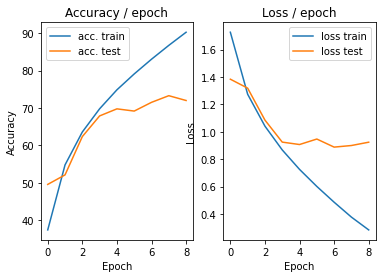

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.167s (0.167s)	Loss 0.1779 (0.1779)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


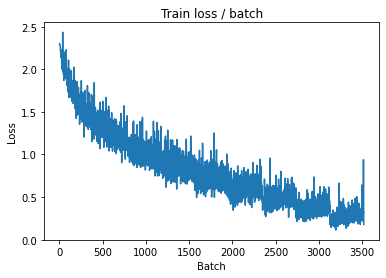

[TRAIN Batch 200/391]	Time 0.023s (0.039s)	Loss 0.2166 (0.1704)	Prec@1  93.0 ( 94.3)	Prec@5  99.2 ( 99.9)


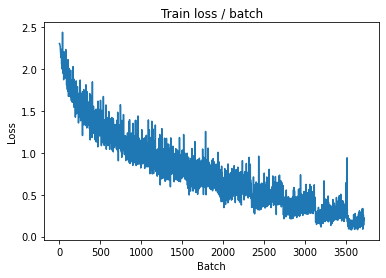


===============> Total time 15s	Avg loss 0.1993	Avg Prec@1 93.17 %	Avg Prec@5 99.94 %

[EVAL Batch 000/079]	Time 0.151s (0.151s)	Loss 1.7705 (1.7705)	Prec@1  66.4 ( 66.4)	Prec@5  95.3 ( 95.3)

===============> Total time 2s	Avg loss 1.5509	Avg Prec@1 66.73 %	Avg Prec@5 97.01 %



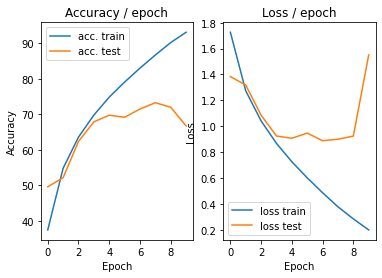

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.163s (0.163s)	Loss 0.4068 (0.4068)	Prec@1  86.7 ( 86.7)	Prec@5 100.0 (100.0)


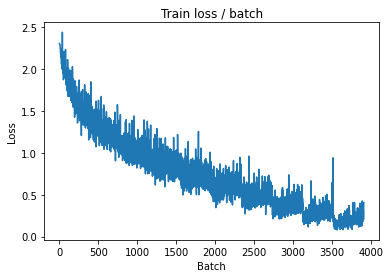

[TRAIN Batch 200/391]	Time 0.030s (0.040s)	Loss 0.3241 (0.1261)	Prec@1  91.4 ( 95.9)	Prec@5 100.0 (100.0)


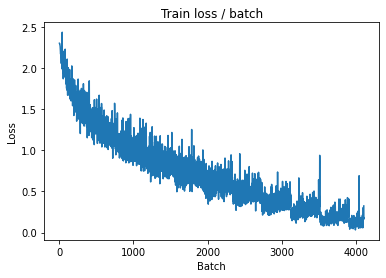


===============> Total time 15s	Avg loss 0.1502	Avg Prec@1 95.03 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.153s (0.153s)	Loss 1.1494 (1.1494)	Prec@1  74.2 ( 74.2)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.2680	Avg Prec@1 71.97 %	Avg Prec@5 97.22 %



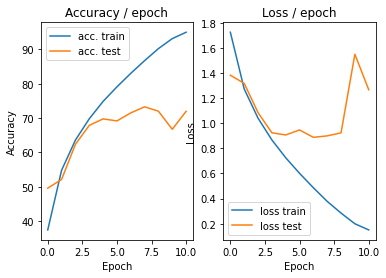

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.169s (0.169s)	Loss 0.1748 (0.1748)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)


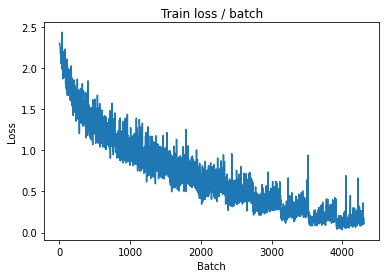

[TRAIN Batch 200/391]	Time 0.066s (0.040s)	Loss 0.1436 (0.1125)	Prec@1  96.1 ( 96.9)	Prec@5 100.0 ( 99.9)


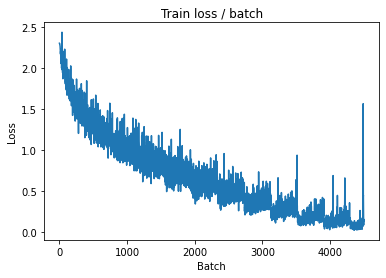


===============> Total time 15s	Avg loss 0.1162	Avg Prec@1 96.46 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.151s (0.151s)	Loss 1.5042 (1.5042)	Prec@1  72.7 ( 72.7)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 1.2748	Avg Prec@1 73.10 %	Avg Prec@5 97.51 %



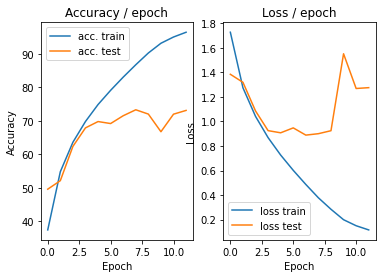

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.166s (0.166s)	Loss 0.1318 (0.1318)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)


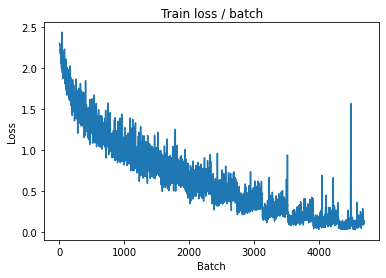

[TRAIN Batch 200/391]	Time 0.019s (0.039s)	Loss 0.0182 (0.0678)	Prec@1 100.0 ( 97.8)	Prec@5 100.0 (100.0)


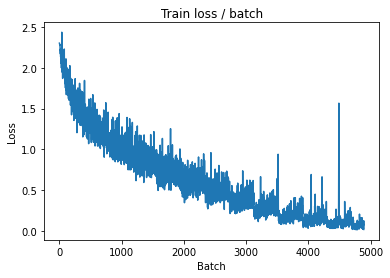


===============> Total time 15s	Avg loss 0.0858	Avg Prec@1 97.20 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.134s (0.134s)	Loss 1.7523 (1.7523)	Prec@1  69.5 ( 69.5)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 1.6022	Avg Prec@1 70.34 %	Avg Prec@5 97.01 %



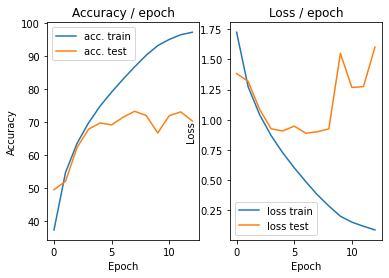

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.165s (0.165s)	Loss 0.1707 (0.1707)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


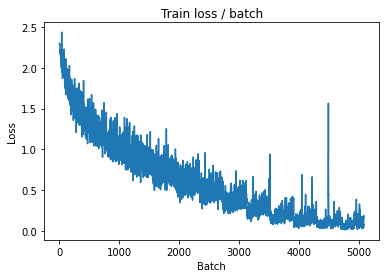

[TRAIN Batch 200/391]	Time 0.024s (0.039s)	Loss 0.0517 (0.0475)	Prec@1  98.4 ( 98.5)	Prec@5 100.0 (100.0)


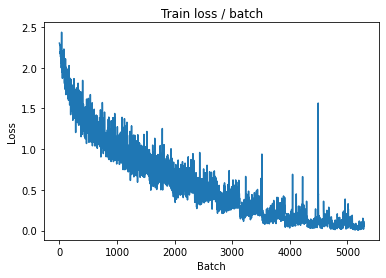


===============> Total time 14s	Avg loss 0.0705	Avg Prec@1 97.75 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.147s (0.147s)	Loss 1.4135 (1.4135)	Prec@1  74.2 ( 74.2)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 1.5181	Avg Prec@1 72.15 %	Avg Prec@5 97.33 %



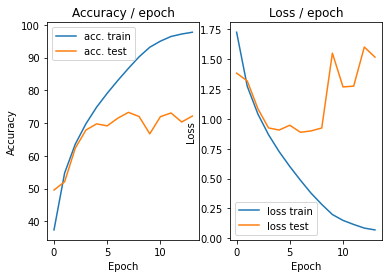

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.174s (0.174s)	Loss 0.1040 (0.1040)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)


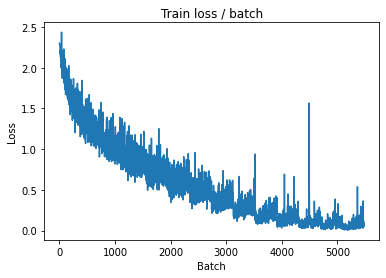

[TRAIN Batch 200/391]	Time 0.025s (0.038s)	Loss 0.0295 (0.0516)	Prec@1  99.2 ( 98.5)	Prec@5 100.0 (100.0)


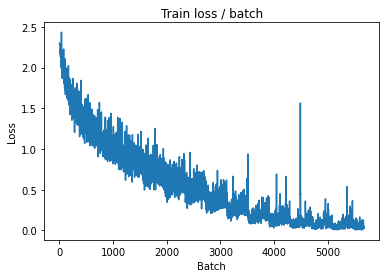


===============> Total time 14s	Avg loss 0.0688	Avg Prec@1 97.80 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.154s (0.154s)	Loss 1.6674 (1.6674)	Prec@1  74.2 ( 74.2)	Prec@5  95.3 ( 95.3)

===============> Total time 2s	Avg loss 1.4114	Avg Prec@1 73.32 %	Avg Prec@5 97.37 %



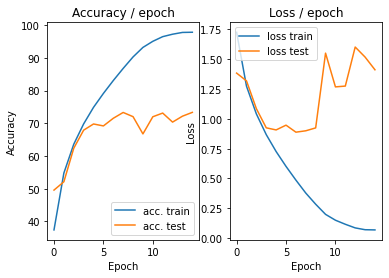

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.159s (0.159s)	Loss 0.0753 (0.0753)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


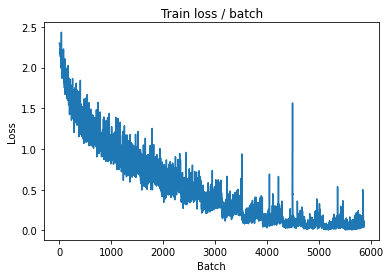

[TRAIN Batch 200/391]	Time 0.057s (0.038s)	Loss 0.0381 (0.0469)	Prec@1  99.2 ( 98.6)	Prec@5 100.0 (100.0)


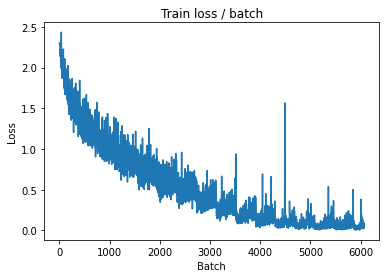


===============> Total time 14s	Avg loss 0.0551	Avg Prec@1 98.21 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.156s (0.156s)	Loss 1.7821 (1.7821)	Prec@1  69.5 ( 69.5)	Prec@5  95.3 ( 95.3)

===============> Total time 2s	Avg loss 1.6213	Avg Prec@1 72.49 %	Avg Prec@5 97.48 %



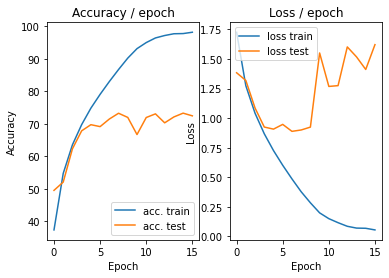

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.172s (0.172s)	Loss 0.0303 (0.0303)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


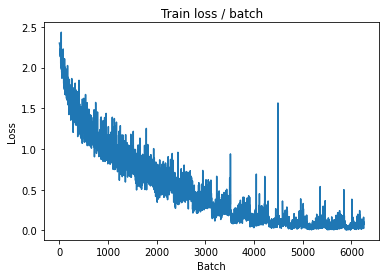

[TRAIN Batch 200/391]	Time 0.022s (0.040s)	Loss 0.0335 (0.0272)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


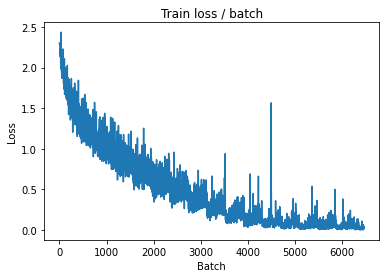


===============> Total time 15s	Avg loss 0.0494	Avg Prec@1 98.57 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.165s (0.165s)	Loss 1.9568 (1.9568)	Prec@1  71.9 ( 71.9)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.5903	Avg Prec@1 73.14 %	Avg Prec@5 97.56 %



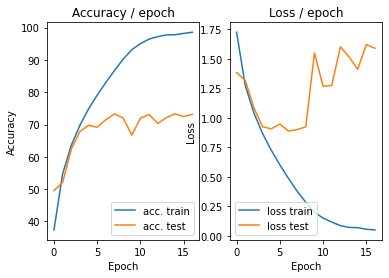

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.174s (0.174s)	Loss 0.0329 (0.0329)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


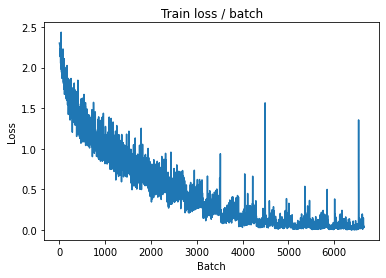

[TRAIN Batch 200/391]	Time 0.048s (0.038s)	Loss 0.0134 (0.0356)	Prec@1 100.0 ( 98.8)	Prec@5 100.0 (100.0)


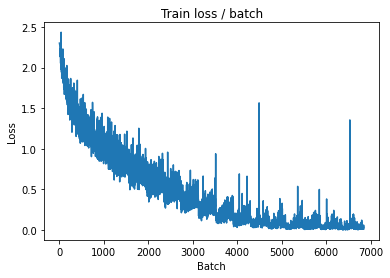


===============> Total time 14s	Avg loss 0.0475	Avg Prec@1 98.42 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.155s (0.155s)	Loss 1.7068 (1.7068)	Prec@1  71.9 ( 71.9)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 1.6982	Avg Prec@1 72.64 %	Avg Prec@5 97.40 %



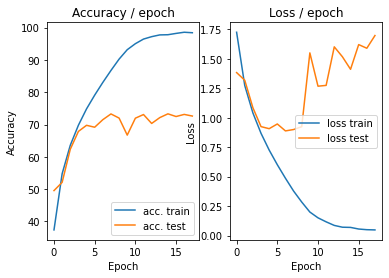

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.162s (0.162s)	Loss 0.0272 (0.0272)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


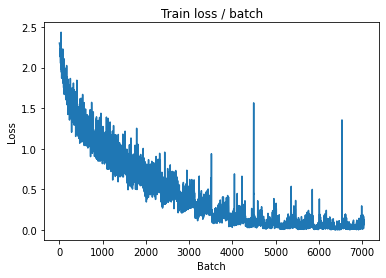

[TRAIN Batch 200/391]	Time 0.023s (0.038s)	Loss 0.0074 (0.0431)	Prec@1 100.0 ( 98.7)	Prec@5 100.0 (100.0)


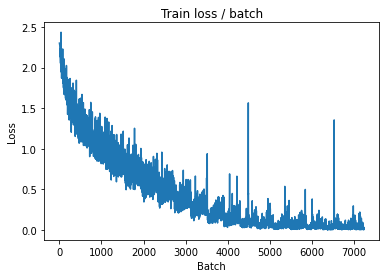


===============> Total time 14s	Avg loss 0.0422	Avg Prec@1 98.61 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.146s (0.146s)	Loss 1.8459 (1.8459)	Prec@1  75.8 ( 75.8)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.9261	Avg Prec@1 73.10 %	Avg Prec@5 97.42 %



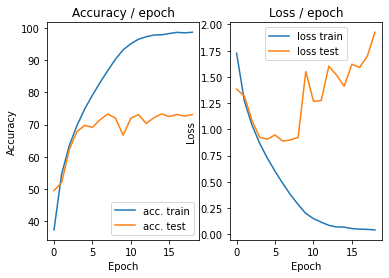

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.167s (0.167s)	Loss 0.0551 (0.0551)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


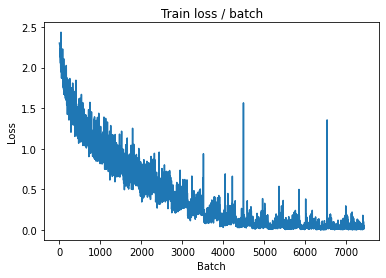

[TRAIN Batch 200/391]	Time 0.046s (0.039s)	Loss 0.0133 (0.0368)	Prec@1  99.2 ( 98.8)	Prec@5 100.0 (100.0)


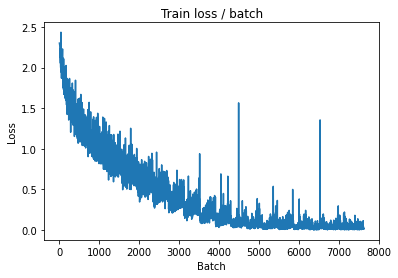


===============> Total time 15s	Avg loss 0.0412	Avg Prec@1 98.71 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.182s (0.182s)	Loss 2.3572 (2.3572)	Prec@1  68.8 ( 68.8)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 1.9895	Avg Prec@1 71.79 %	Avg Prec@5 97.09 %



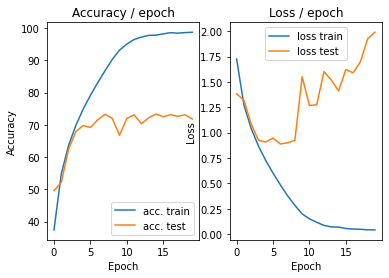

=== EPOCH 21 =====

[TRAIN Batch 000/391]	Time 0.175s (0.175s)	Loss 0.0071 (0.0071)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


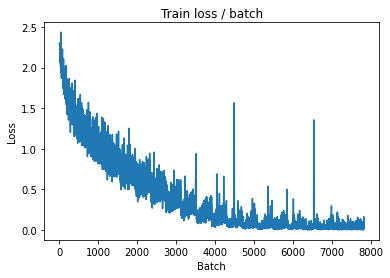

[TRAIN Batch 200/391]	Time 0.019s (0.038s)	Loss 0.0138 (0.0288)	Prec@1 100.0 ( 99.2)	Prec@5 100.0 (100.0)


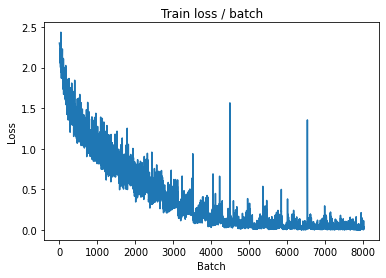


===============> Total time 14s	Avg loss 0.0258	Avg Prec@1 99.22 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.153s (0.153s)	Loss 1.4640 (1.4640)	Prec@1  76.6 ( 76.6)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 1.9243	Avg Prec@1 72.68 %	Avg Prec@5 97.36 %



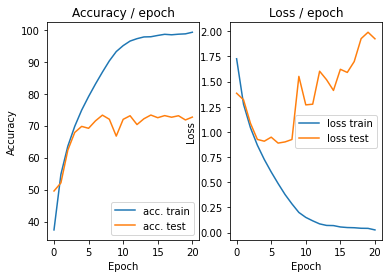

=== EPOCH 22 =====

[TRAIN Batch 000/391]	Time 0.167s (0.167s)	Loss 0.0697 (0.0697)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


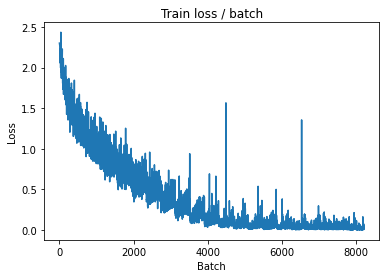

[TRAIN Batch 200/391]	Time 0.018s (0.039s)	Loss 0.1005 (0.0387)	Prec@1  96.9 ( 98.8)	Prec@5 100.0 (100.0)


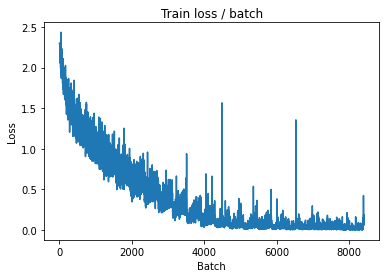


===============> Total time 14s	Avg loss 0.0382	Avg Prec@1 98.79 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.143s (0.143s)	Loss 1.8214 (1.8214)	Prec@1  75.0 ( 75.0)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.8443	Avg Prec@1 72.56 %	Avg Prec@5 97.53 %



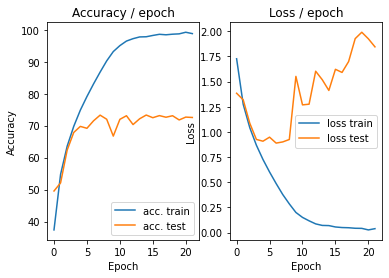

=== EPOCH 23 =====

[TRAIN Batch 000/391]	Time 0.169s (0.169s)	Loss 0.0662 (0.0662)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


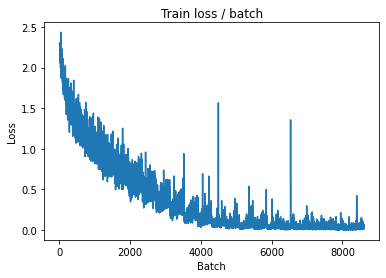

[TRAIN Batch 200/391]	Time 0.028s (0.038s)	Loss 0.0503 (0.0125)	Prec@1  98.4 ( 99.6)	Prec@5 100.0 (100.0)


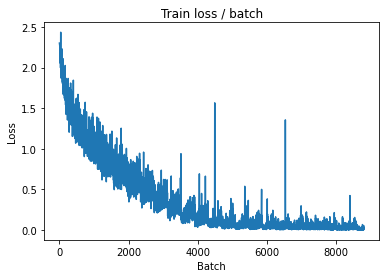


===============> Total time 14s	Avg loss 0.0180	Avg Prec@1 99.45 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.153s (0.153s)	Loss 2.4332 (2.4332)	Prec@1  68.8 ( 68.8)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 1.9665	Avg Prec@1 73.28 %	Avg Prec@5 97.22 %



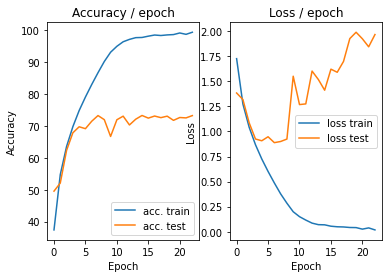

=== EPOCH 24 =====

[TRAIN Batch 000/391]	Time 0.163s (0.163s)	Loss 0.0038 (0.0038)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


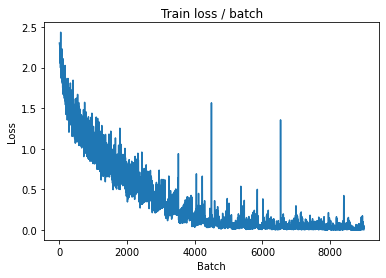

[TRAIN Batch 200/391]	Time 0.061s (0.039s)	Loss 0.0777 (0.0384)	Prec@1  97.7 ( 98.8)	Prec@5 100.0 (100.0)


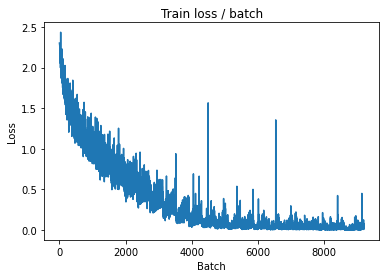


===============> Total time 14s	Avg loss 0.0451	Avg Prec@1 98.61 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.148s (0.148s)	Loss 2.0438 (2.0438)	Prec@1  77.3 ( 77.3)	Prec@5  95.3 ( 95.3)

===============> Total time 2s	Avg loss 1.8595	Avg Prec@1 73.84 %	Avg Prec@5 97.16 %



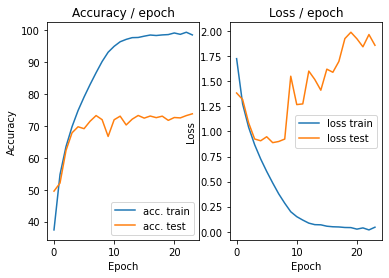

=== EPOCH 25 =====

[TRAIN Batch 000/391]	Time 0.164s (0.164s)	Loss 0.0126 (0.0126)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


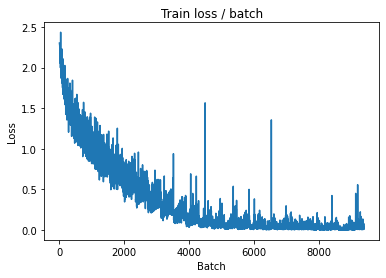

[TRAIN Batch 200/391]	Time 0.054s (0.039s)	Loss 0.0302 (0.0280)	Prec@1  98.4 ( 99.2)	Prec@5 100.0 (100.0)


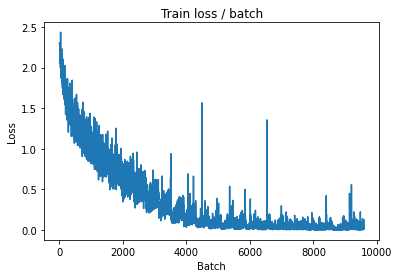


===============> Total time 14s	Avg loss 0.0380	Avg Prec@1 98.84 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.156s (0.156s)	Loss 2.2210 (2.2210)	Prec@1  70.3 ( 70.3)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 1.8394	Avg Prec@1 73.57 %	Avg Prec@5 97.56 %



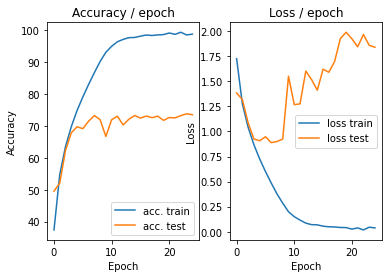

=== EPOCH 26 =====

[TRAIN Batch 000/391]	Time 0.167s (0.167s)	Loss 0.0298 (0.0298)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


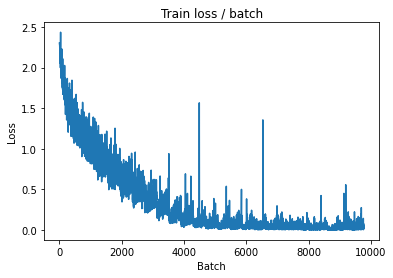

[TRAIN Batch 200/391]	Time 0.056s (0.039s)	Loss 0.0069 (0.0224)	Prec@1 100.0 ( 99.3)	Prec@5 100.0 (100.0)


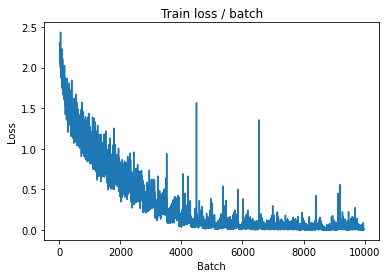


===============> Total time 15s	Avg loss 0.0283	Avg Prec@1 99.11 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.144s (0.144s)	Loss 2.0611 (2.0611)	Prec@1  72.7 ( 72.7)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.0289	Avg Prec@1 72.33 %	Avg Prec@5 96.88 %



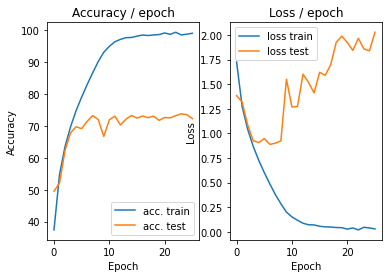

=== EPOCH 27 =====

[TRAIN Batch 000/391]	Time 0.171s (0.171s)	Loss 0.0324 (0.0324)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


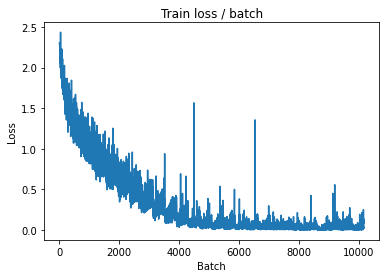

[TRAIN Batch 200/391]	Time 0.045s (0.039s)	Loss 0.1685 (0.0290)	Prec@1  97.7 ( 99.1)	Prec@5 100.0 (100.0)


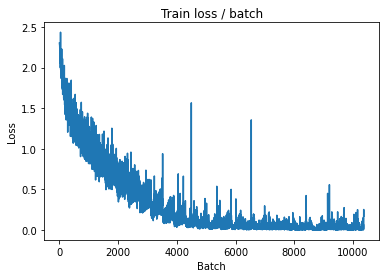


===============> Total time 14s	Avg loss 0.0384	Avg Prec@1 98.81 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.154s (0.154s)	Loss 2.4002 (2.4002)	Prec@1  74.2 ( 74.2)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 1.9299	Avg Prec@1 73.71 %	Avg Prec@5 97.49 %



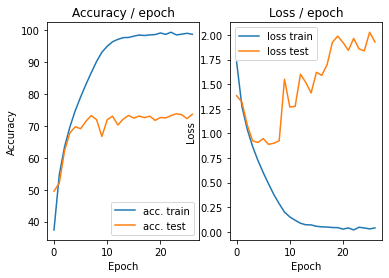

=== EPOCH 28 =====

[TRAIN Batch 000/391]	Time 0.153s (0.153s)	Loss 0.0270 (0.0270)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


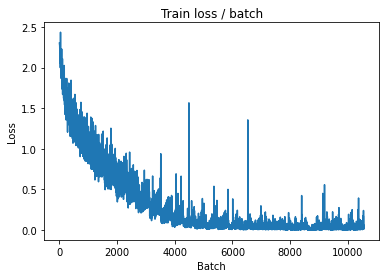

[TRAIN Batch 200/391]	Time 0.046s (0.039s)	Loss 0.1193 (0.0241)	Prec@1  97.7 ( 99.3)	Prec@5 100.0 (100.0)


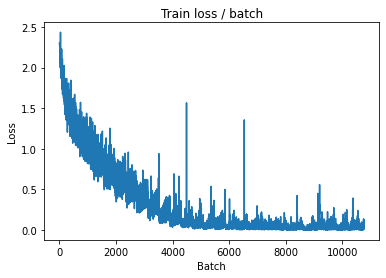


===============> Total time 14s	Avg loss 0.0305	Avg Prec@1 99.05 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.152s (0.152s)	Loss 2.2680 (2.2680)	Prec@1  75.0 ( 75.0)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 2.0753	Avg Prec@1 73.38 %	Avg Prec@5 96.99 %



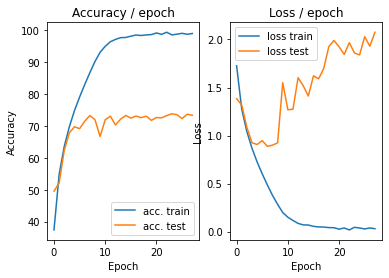

=== EPOCH 29 =====

[TRAIN Batch 000/391]	Time 0.173s (0.173s)	Loss 0.2579 (0.2579)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


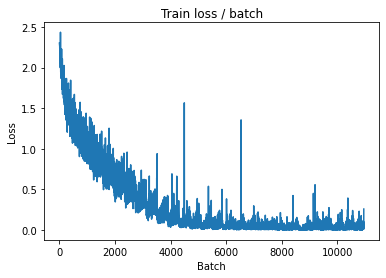

[TRAIN Batch 200/391]	Time 0.052s (0.038s)	Loss 0.0130 (0.0248)	Prec@1 100.0 ( 99.2)	Prec@5 100.0 (100.0)


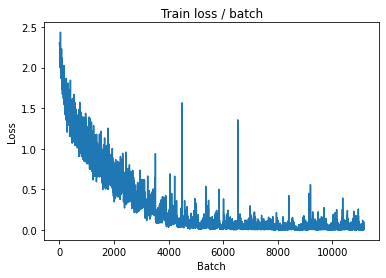


===============> Total time 14s	Avg loss 0.0236	Avg Prec@1 99.26 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.152s (0.152s)	Loss 2.2829 (2.2829)	Prec@1  71.9 ( 71.9)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 1.9336	Avg Prec@1 74.50 %	Avg Prec@5 97.60 %



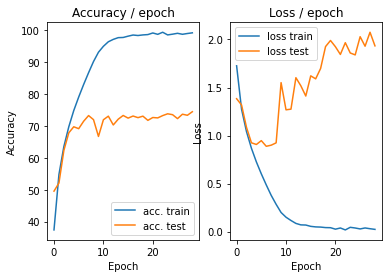

=== EPOCH 30 =====

[TRAIN Batch 000/391]	Time 0.174s (0.174s)	Loss 0.0410 (0.0410)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


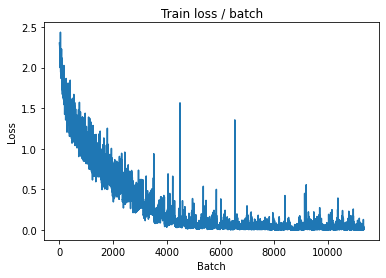

[TRAIN Batch 200/391]	Time 0.021s (0.038s)	Loss 0.0108 (0.0205)	Prec@1  99.2 ( 99.3)	Prec@5 100.0 (100.0)


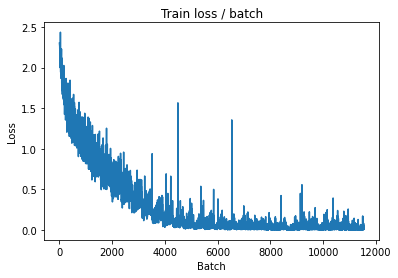


===============> Total time 15s	Avg loss 0.0217	Avg Prec@1 99.31 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.160s (0.160s)	Loss 2.4286 (2.4286)	Prec@1  72.7 ( 72.7)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.2612	Avg Prec@1 72.96 %	Avg Prec@5 97.21 %



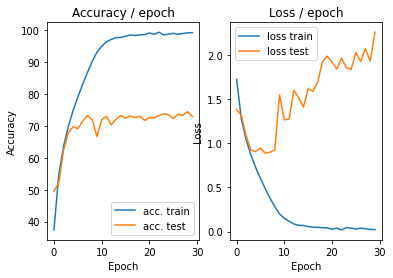

=== EPOCH 31 =====

[TRAIN Batch 000/391]	Time 0.186s (0.186s)	Loss 0.0361 (0.0361)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


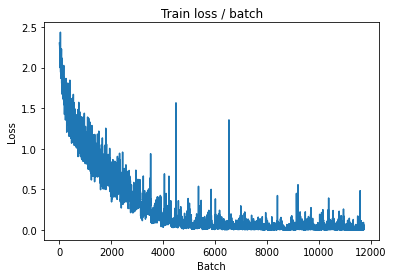

[TRAIN Batch 200/391]	Time 0.054s (0.039s)	Loss 0.0091 (0.0233)	Prec@1 100.0 ( 99.2)	Prec@5 100.0 (100.0)


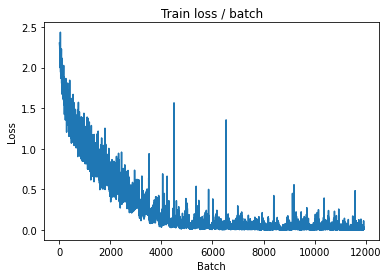


===============> Total time 15s	Avg loss 0.0256	Avg Prec@1 99.18 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.156s (0.156s)	Loss 2.1319 (2.1319)	Prec@1  71.1 ( 71.1)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.0916	Avg Prec@1 73.59 %	Avg Prec@5 97.36 %



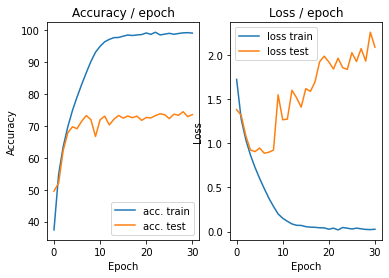

=== EPOCH 32 =====

[TRAIN Batch 000/391]	Time 0.165s (0.165s)	Loss 0.0261 (0.0261)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


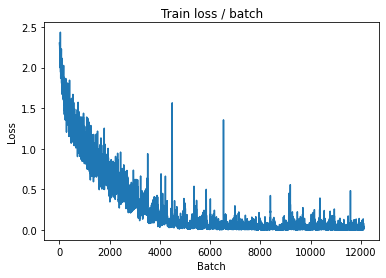

[TRAIN Batch 200/391]	Time 0.060s (0.039s)	Loss 0.0028 (0.0194)	Prec@1 100.0 ( 99.4)	Prec@5 100.0 (100.0)


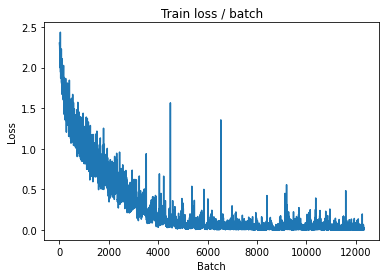


===============> Total time 14s	Avg loss 0.0231	Avg Prec@1 99.24 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.149s (0.149s)	Loss 2.6880 (2.6880)	Prec@1  74.2 ( 74.2)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.2949	Avg Prec@1 73.72 %	Avg Prec@5 97.20 %



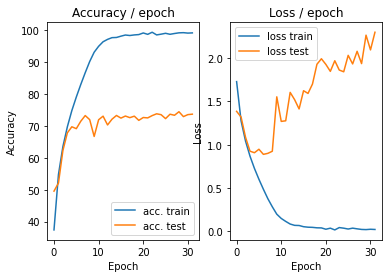

=== EPOCH 33 =====

[TRAIN Batch 000/391]	Time 0.174s (0.174s)	Loss 0.0136 (0.0136)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


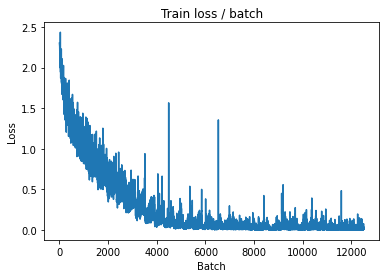

[TRAIN Batch 200/391]	Time 0.060s (0.038s)	Loss 0.0063 (0.0232)	Prec@1 100.0 ( 99.3)	Prec@5 100.0 (100.0)


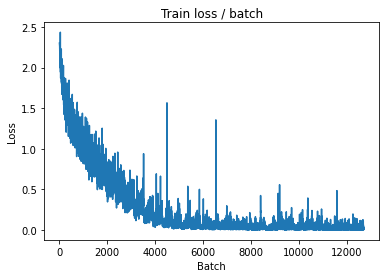


===============> Total time 14s	Avg loss 0.0322	Avg Prec@1 98.98 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.145s (0.145s)	Loss 2.1808 (2.1808)	Prec@1  75.8 ( 75.8)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.0909	Avg Prec@1 72.96 %	Avg Prec@5 97.20 %



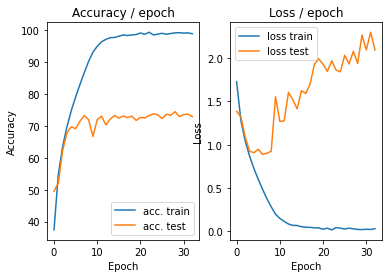

=== EPOCH 34 =====

[TRAIN Batch 000/391]	Time 0.181s (0.181s)	Loss 0.0271 (0.0271)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


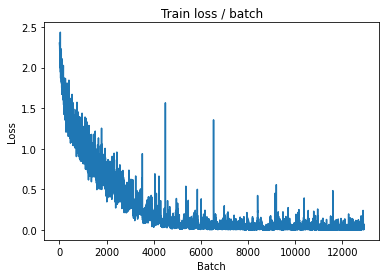

[TRAIN Batch 200/391]	Time 0.033s (0.039s)	Loss 0.0045 (0.0198)	Prec@1 100.0 ( 99.4)	Prec@5 100.0 (100.0)


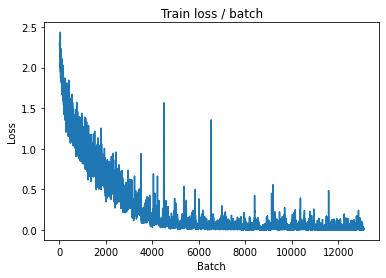


===============> Total time 15s	Avg loss 0.0243	Avg Prec@1 99.24 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.151s (0.151s)	Loss 2.0745 (2.0745)	Prec@1  72.7 ( 72.7)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 2.2604	Avg Prec@1 72.66 %	Avg Prec@5 97.46 %



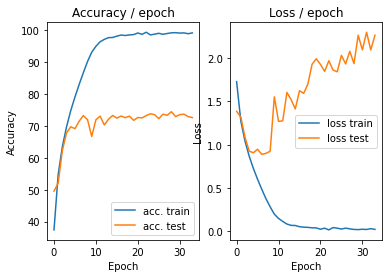

=== EPOCH 35 =====

[TRAIN Batch 000/391]	Time 0.164s (0.164s)	Loss 0.0241 (0.0241)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


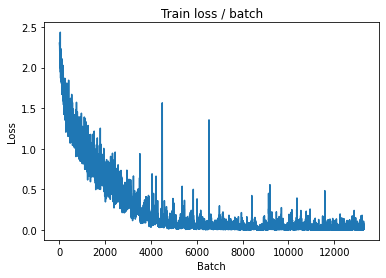

[TRAIN Batch 200/391]	Time 0.061s (0.039s)	Loss 0.0064 (0.0211)	Prec@1 100.0 ( 99.4)	Prec@5 100.0 (100.0)


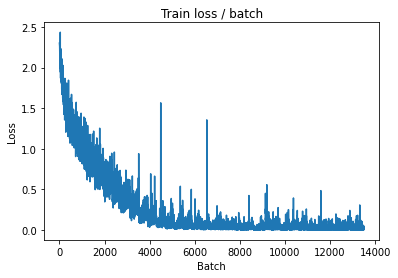


===============> Total time 14s	Avg loss 0.0249	Avg Prec@1 99.22 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.144s (0.144s)	Loss 2.2883 (2.2883)	Prec@1  69.5 ( 69.5)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 2.2084	Avg Prec@1 73.79 %	Avg Prec@5 97.36 %



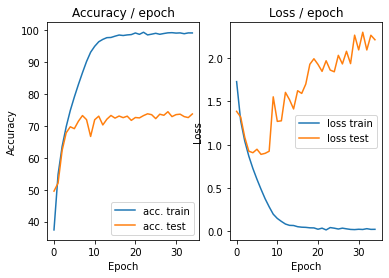

=== EPOCH 36 =====

[TRAIN Batch 000/391]	Time 0.156s (0.156s)	Loss 0.0060 (0.0060)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


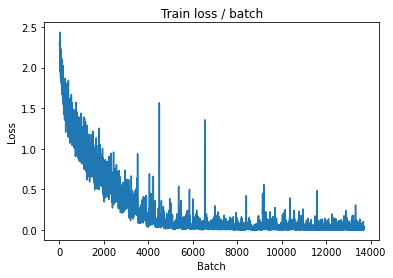

[TRAIN Batch 200/391]	Time 0.042s (0.038s)	Loss 0.0027 (0.0461)	Prec@1 100.0 ( 98.7)	Prec@5 100.0 (100.0)


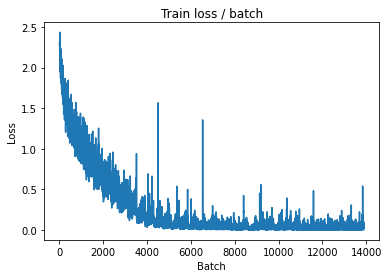


===============> Total time 14s	Avg loss 0.0410	Avg Prec@1 98.75 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.158s (0.158s)	Loss 2.4543 (2.4543)	Prec@1  70.3 ( 70.3)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.1347	Avg Prec@1 73.21 %	Avg Prec@5 97.48 %



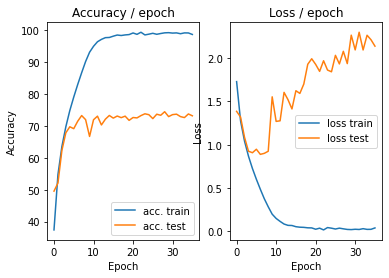

=== EPOCH 37 =====

[TRAIN Batch 000/391]	Time 0.180s (0.180s)	Loss 0.0327 (0.0327)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


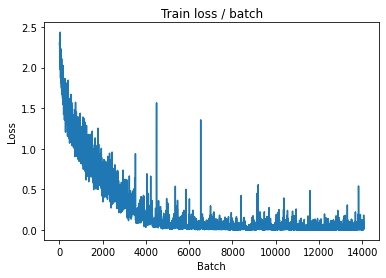

[TRAIN Batch 200/391]	Time 0.057s (0.039s)	Loss 0.0404 (0.0263)	Prec@1  98.4 ( 99.2)	Prec@5 100.0 (100.0)


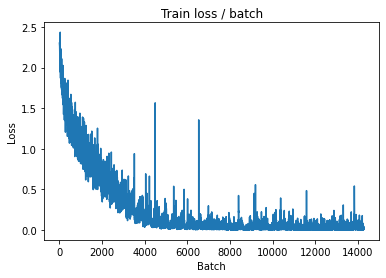


===============> Total time 14s	Avg loss 0.0229	Avg Prec@1 99.27 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.134s (0.134s)	Loss 2.7496 (2.7496)	Prec@1  75.0 ( 75.0)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 2.1094	Avg Prec@1 73.84 %	Avg Prec@5 97.56 %



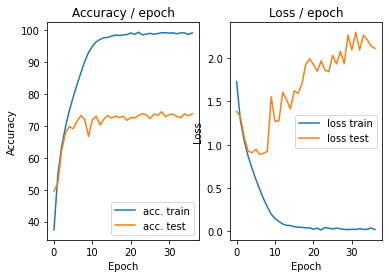

=== EPOCH 38 =====

[TRAIN Batch 000/391]	Time 0.171s (0.171s)	Loss 0.0251 (0.0251)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


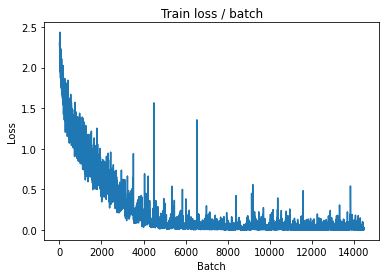

[TRAIN Batch 200/391]	Time 0.026s (0.038s)	Loss 0.0017 (0.0064)	Prec@1 100.0 ( 99.8)	Prec@5 100.0 (100.0)


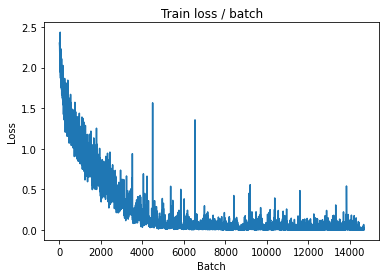


===============> Total time 14s	Avg loss 0.0107	Avg Prec@1 99.67 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.166s (0.166s)	Loss 2.5431 (2.5431)	Prec@1  73.4 ( 73.4)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 2.2414	Avg Prec@1 74.25 %	Avg Prec@5 97.26 %



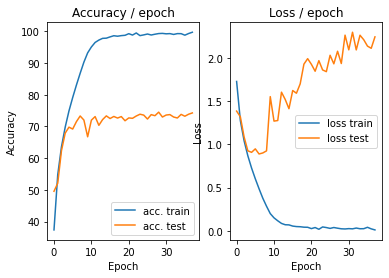

=== EPOCH 39 =====

[TRAIN Batch 000/391]	Time 0.155s (0.155s)	Loss 0.0030 (0.0030)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


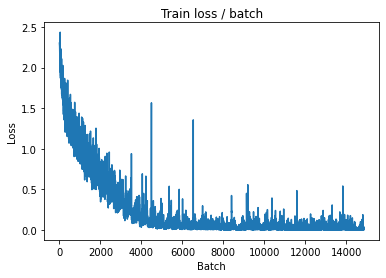

[TRAIN Batch 200/391]	Time 0.033s (0.037s)	Loss 0.0021 (0.0067)	Prec@1 100.0 ( 99.8)	Prec@5 100.0 (100.0)


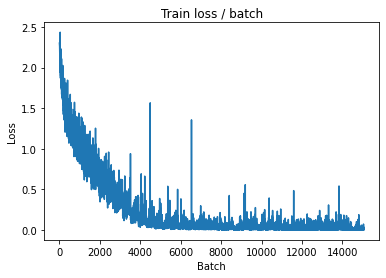


===============> Total time 14s	Avg loss 0.0117	Avg Prec@1 99.68 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.153s (0.153s)	Loss 2.7999 (2.7999)	Prec@1  73.4 ( 73.4)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 2.2493	Avg Prec@1 73.84 %	Avg Prec@5 97.23 %



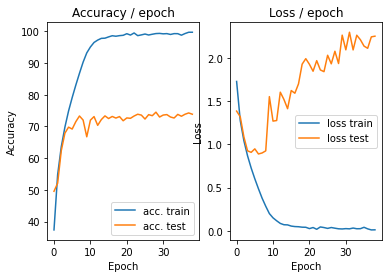

=== EPOCH 40 =====

[TRAIN Batch 000/391]	Time 0.169s (0.169s)	Loss 0.0531 (0.0531)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


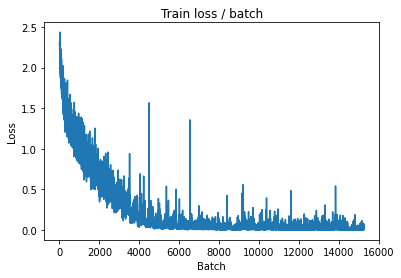

[TRAIN Batch 200/391]	Time 0.054s (0.038s)	Loss 0.0034 (0.0366)	Prec@1 100.0 ( 99.0)	Prec@5 100.0 (100.0)


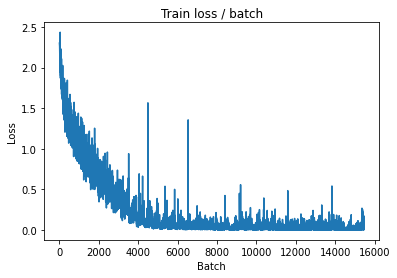


===============> Total time 14s	Avg loss 0.0407	Avg Prec@1 98.80 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.149s (0.149s)	Loss 2.5744 (2.5744)	Prec@1  76.6 ( 76.6)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 2.3311	Avg Prec@1 72.26 %	Avg Prec@5 97.21 %



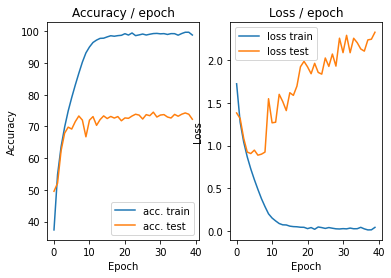

=== EPOCH 41 =====

[TRAIN Batch 000/391]	Time 0.164s (0.164s)	Loss 0.0663 (0.0663)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


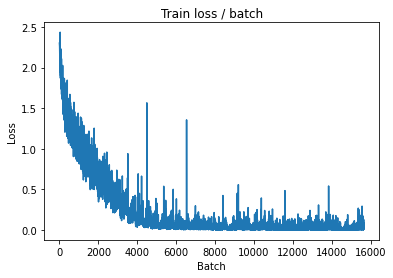

[TRAIN Batch 200/391]	Time 0.025s (0.038s)	Loss 0.0586 (0.0305)	Prec@1  98.4 ( 99.0)	Prec@5 100.0 (100.0)


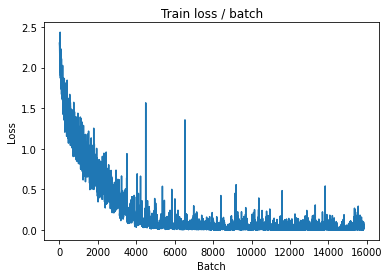


===============> Total time 14s	Avg loss 0.0323	Avg Prec@1 98.98 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.151s (0.151s)	Loss 2.6840 (2.6840)	Prec@1  76.6 ( 76.6)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 2.2919	Avg Prec@1 73.04 %	Avg Prec@5 97.07 %



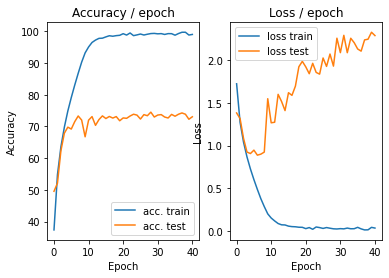

=== EPOCH 42 =====

[TRAIN Batch 000/391]	Time 0.171s (0.171s)	Loss 0.0235 (0.0235)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


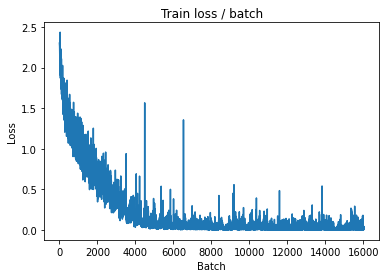

[TRAIN Batch 200/391]	Time 0.054s (0.038s)	Loss 0.0027 (0.0174)	Prec@1 100.0 ( 99.4)	Prec@5 100.0 (100.0)


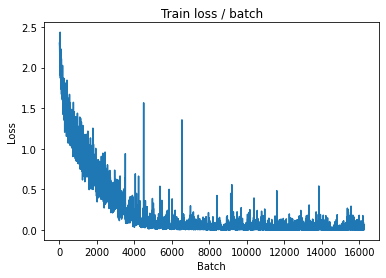


===============> Total time 14s	Avg loss 0.0189	Avg Prec@1 99.39 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.146s (0.146s)	Loss 3.0045 (3.0045)	Prec@1  72.7 ( 72.7)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 2.4626	Avg Prec@1 73.35 %	Avg Prec@5 97.05 %



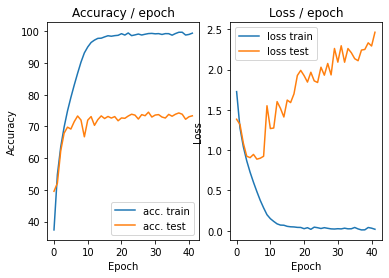

In [7]:
main(batch_size=128,lr=0.1,epochs=42,cuda=True)

### Normalisation entre -1 et 1

In [ ]:
def get_dataset(name, batch_size, cuda=False):
    """
    Cette fonction charge le dataset et effectue des transformations sur chaque
    image (listées dans `transform = ...`).
    """

    train_dataset = name(PATH, train=True, download=True,
        transform = transforms.Compose([
            transforms.ToTensor(),

            # -- Normalisation "entre -1 et 1" --
            transforms.Normalize(mean=[0.5,0.5,0.5],std=[0.5,0.5,0.5])
        ]))
    
    val_dataset = name(PATH, train=False, download=True,
        transform = transforms.Compose([
            transforms.ToTensor(),
            
            # -- Normalisation "entre -1 et 1" --
            transforms.Normalize(mean=[0.5,0.5,0.5],std=[0.5,0.5,0.5])
        ]))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader

In [ ]:
main(batch_size=128,lr=0.1,epochs=42,cuda=True)

### Normalisation ZCA

In [ ]:
# sphereing pre-processing functionality 
def PCA(x,**kwargs):
    # regularization parameter for numerical stability
    lam = 10**(-7)
    if 'lam' in kwargs:
        lam = kwargs['lam']

    # create the correlation matrix
    P = float(x.shape[1])
    Cov = 1/P*np.dot(x,x.T) + lam*np.eye(x.shape[0])

    # use numpy function to compute eigenvalues / vectors of correlation matrix
    d,V = np.linalg.eigh(Cov)
    return d,V

# ZCA spherer 
def ZCA_spherer(x,**kwargs):
    # Step 1: mean-center the data
    x_means = np.mean(x,axis = 1)[:,np.newaxis]
    x_centered = x - x_means
    # Step 2: compute pca transform on mean-centered data
    d,V = PCA(x_centered,**kwargs)
    # Step 3: divide off standard deviation of each (transformed) input, 
    # which are equal to the returned eigenvalues in 'd'.  
    stds = (d[:,np.newaxis])**(0.5)
    # check to make sure that x_stds > small threshold, for those not
    # divide by 1 instead of original standard deviation
    ind = np.argwhere(stds < 10**(-5))
    if len(ind) > 0:
        ind = [v[0] for v in ind]
        adjust = np.zeros((stds.shape))
        adjust[ind] = 1.0
        stds += adjust
    # create normalizer / inverse-normalizer
    # return np.dot(V,np.dot(V.T,x_centered)/stds) # données normalisées
    return np.dot(V,V.T/stds), x_means # matrice ZCA et vecteur moyen

# calculer ZCA
def computeZCA():
  # extraire tout les données de train
  train_all_dataset = datasets.CIFAR10(PATH, train=False, download=True, 
                 transform = transforms.Compose([transforms.ToTensor()]))
  train_all = torch.utils.data.DataLoader(train_all_dataset, batch_size=len(train_all_dataset), 
                             shuffle=False, pin_memory=True, num_workers=2)
  # convertir le dataset en numpy array
  train_all_arr = next(iter(train_all))[0].numpy() # matrice (10k,3,32,32)
  # aplatir
  train_all_arr_flat = train_all_arr.reshape(-1,1).reshape(train_all_arr.shape[0],-1) # matrice (10k,3072)
  # calculer la matrice ZCA (3072,3072) et le vecteur moy (3072,1)
  zca_mat, moy = ZCA_spherer(train_all_arr_flat.T)
  # convertir en tensor
  zca_mat_tensor = torch.Tensor(zca_mat)
  moy_tensor = torch.Tensor(moy)
  return zca_mat, mean_vect

In [ ]:
# une image avant normalisation
plt.imshow(train_all_arr[0].T) 
plt.show()

# normalisation ZCA 
mat,v_moy = ZCA_spherer(train_all_arr_flat.T)
centered = train_all_arr_flat.T - v_moy
whitened_train = np.dot(mat,centered)

# image après la normalisation
plt.imshow(whitened_train.T[0].reshape(3,32,32).T,interpolation='nearest')
plt.show()

In [ ]:
def get_dataset(name, batch_size, cuda=False):
    """
    Cette fonction charge le dataset et effectue des transformations sur chaque
    image (listées dans `transform = ...`).
    """
    train_dataset = name(PATH, train=True, download=True,
        transform = transforms.Compose([
            transforms.ToTensor(),
            # -- Normalisation ZCA --
            transforms.LinearTransformation(transformation_matrix=zca_mat_tensor, 
                                            mean_vector=moy_tensor)
        ]))
    
    val_dataset = name(PATH, train=False, download=True,
        transform = transforms.Compose([
            transforms.ToTensor(),
            # -- Normalisation ZCA --
            transforms.LinearTransformation(transformation_matrix=zca_mat_tensor, 
                                            mean_vector=moy_tensor)
        ]))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader

Nous n'avons pas réussi à faire fonctionner ZCA.

## Data augmentation 

On cherche à multiplier le nombre d’exemples disponibles, car CIFAR-10 est un ensemble d’images relativement petit par rapport au nombre de paramètres du modèle. C'est la raison du surapprentissage constaté.  
Le principe est de générer à chaque epoch une "variante" de chaque image en lui appliquant des transformations aléatoires.


### Crop aléatoire et symétrie horizontale aléatoire

In [4]:
class ConvNet(nn.Module):
    """
    Cette classe contient la structure du réseau de neurones
    """

    def __init__(self):
        super(ConvNet, self).__init__()
        # On définit d'abord les couches de convolution et de pooling comme un
        # groupe de couches `self.features` 
        self.features = nn.Sequential(
            nn.Conv2d(3, 32, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(32, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(64, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0, ceil_mode=True), # ceil_mode ajouté !
        )

        # On définit les couches fully connected comme un groupe de couches
        # `self.classifier`
        self.classifier = nn.Sequential(
            nn.Linear(1024, 1000),
            nn.ReLU(),
            nn.Linear(1000, 10)
            # Rappel : Le softmax est inclus dans la loss, ne pas le mettre ici
        )

    # méthode appelée quand on applique le réseau à un batch d'input
    def forward(self, input):
        bsize = input.size(0) # taille du batch
        output = self.features(input) # on calcule la sortie des conv
        output = output.view(bsize, -1) # on aplatit les feature map 2D en un
                                        # vecteur 1D pour chaque input
        output = self.classifier(output) # on calcule la sortie des fc
        return output

def get_dataset(name, batch_size, cuda=False):
    """
    Cette fonction charge le dataset et effectue des transformations sur chaque
    image (listées dans `transform = ...`).
    """
    train_dataset = name(PATH, train=True, download=True,
        transform = transforms.Compose([
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.491,0.482,0.447],std=[0.202,0.199,0.201]),
            transforms.RandomCrop(size=28), # crop de taille 28×28 pixels
            transforms.RandomHorizontalFlip() # symétrie horizontale aléatoire (avec prob. = 1/2)
        ]))
    
    val_dataset = name(PATH, train=False, download=True,
        transform = transforms.Compose([
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.491,0.482,0.447],std=[0.202,0.199,0.201]),
            transforms.CenterCrop(size=28) # crop centré 28×28 pixels
        ]))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader

Files already downloaded and verified
Files already downloaded and verified
=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.395s (0.395s)	Loss 2.3016 (2.3016)	Prec@1  13.3 ( 13.3)	Prec@5  56.2 ( 56.2)


<Figure size 432x288 with 0 Axes>

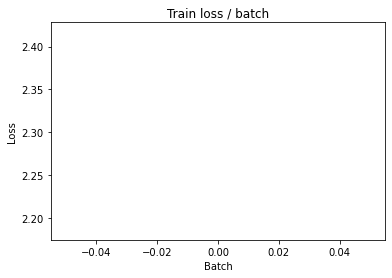

[TRAIN Batch 200/391]	Time 0.067s (0.057s)	Loss 1.6165 (1.9957)	Prec@1  46.9 ( 26.4)	Prec@5  92.2 ( 77.8)


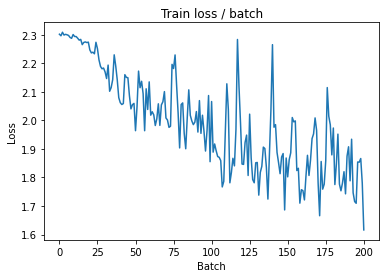


===============> Total time 22s	Avg loss 1.8181	Avg Prec@1 33.32 %	Avg Prec@5 83.58 %

[EVAL Batch 000/079]	Time 0.160s (0.160s)	Loss 1.5981 (1.5981)	Prec@1  45.3 ( 45.3)	Prec@5  91.4 ( 91.4)

===============> Total time 2s	Avg loss 1.5590	Avg Prec@1 44.63 %	Avg Prec@5 91.85 %



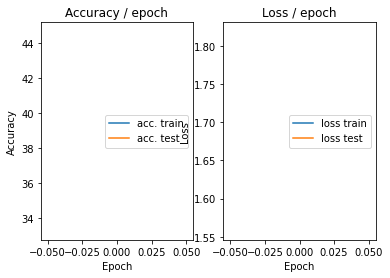

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.188s (0.188s)	Loss 1.5580 (1.5580)	Prec@1  46.9 ( 46.9)	Prec@5  92.2 ( 92.2)


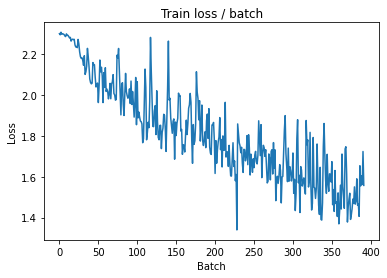

[TRAIN Batch 200/391]	Time 0.099s (0.057s)	Loss 1.2738 (1.4562)	Prec@1  51.6 ( 47.4)	Prec@5  95.3 ( 92.3)


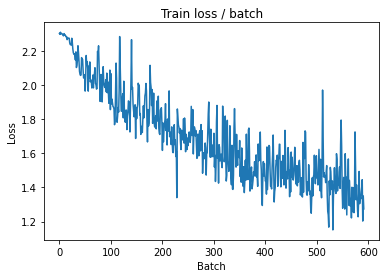


===============> Total time 22s	Avg loss 1.4017	Avg Prec@1 49.69 %	Avg Prec@5 93.07 %

[EVAL Batch 000/079]	Time 0.164s (0.164s)	Loss 1.1766 (1.1766)	Prec@1  64.1 ( 64.1)	Prec@5  93.8 ( 93.8)

===============> Total time 2s	Avg loss 1.2235	Avg Prec@1 56.30 %	Avg Prec@5 94.72 %



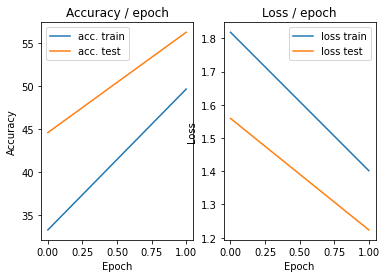

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.229s (0.229s)	Loss 1.1436 (1.1436)	Prec@1  55.5 ( 55.5)	Prec@5  96.1 ( 96.1)


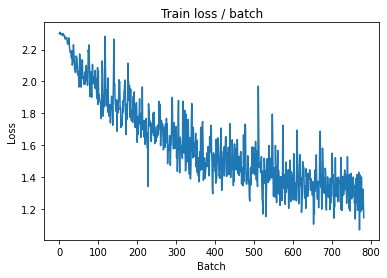

[TRAIN Batch 200/391]	Time 0.089s (0.057s)	Loss 1.0862 (1.2274)	Prec@1  64.1 ( 56.5)	Prec@5  97.7 ( 95.0)


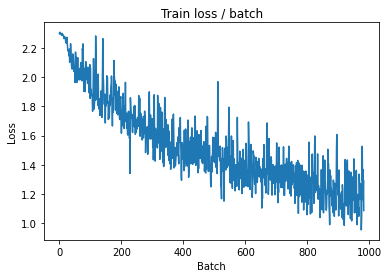


===============> Total time 22s	Avg loss 1.1841	Avg Prec@1 58.16 %	Avg Prec@5 95.34 %

[EVAL Batch 000/079]	Time 0.155s (0.155s)	Loss 1.2834 (1.2834)	Prec@1  55.5 ( 55.5)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.2063	Avg Prec@1 58.18 %	Avg Prec@5 95.59 %



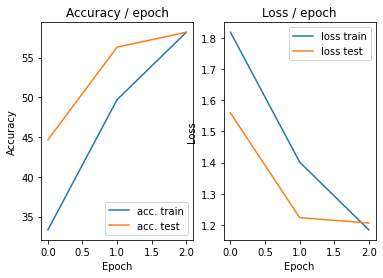

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.203s (0.203s)	Loss 1.0277 (1.0277)	Prec@1  65.6 ( 65.6)	Prec@5  97.7 ( 97.7)


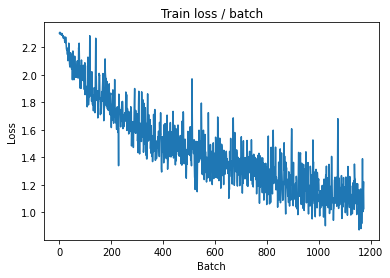

[TRAIN Batch 200/391]	Time 0.086s (0.058s)	Loss 1.0481 (1.0519)	Prec@1  63.3 ( 63.1)	Prec@5  99.2 ( 96.5)


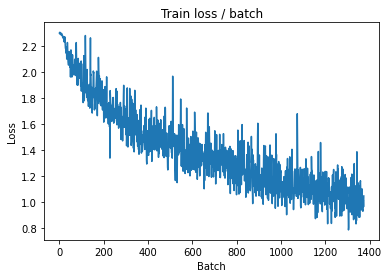


===============> Total time 22s	Avg loss 1.0280	Avg Prec@1 63.99 %	Avg Prec@5 96.55 %

[EVAL Batch 000/079]	Time 0.172s (0.172s)	Loss 0.8572 (0.8572)	Prec@1  68.8 ( 68.8)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.9325	Avg Prec@1 67.31 %	Avg Prec@5 96.95 %



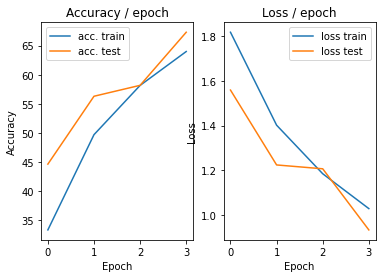

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.202s (0.202s)	Loss 0.7864 (0.7864)	Prec@1  76.6 ( 76.6)	Prec@5  98.4 ( 98.4)


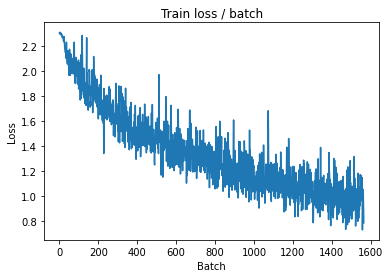

[TRAIN Batch 200/391]	Time 0.096s (0.058s)	Loss 0.8417 (0.9347)	Prec@1  68.8 ( 67.4)	Prec@5  97.7 ( 97.2)


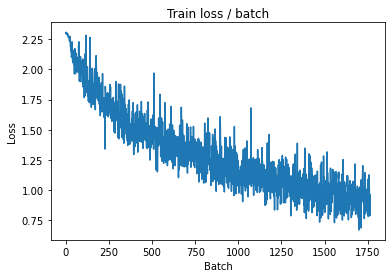


===============> Total time 22s	Avg loss 0.9134	Avg Prec@1 67.96 %	Avg Prec@5 97.35 %

[EVAL Batch 000/079]	Time 0.158s (0.158s)	Loss 0.9193 (0.9193)	Prec@1  65.6 ( 65.6)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.9296	Avg Prec@1 67.16 %	Avg Prec@5 97.31 %



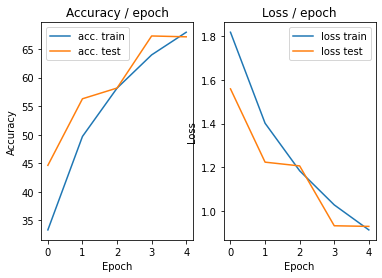

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.197s (0.197s)	Loss 0.9821 (0.9821)	Prec@1  67.2 ( 67.2)	Prec@5  97.7 ( 97.7)


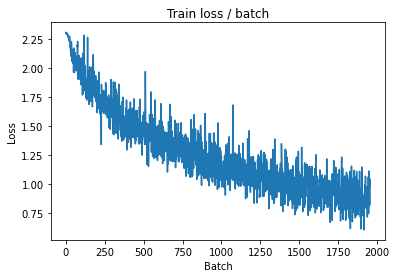

[TRAIN Batch 200/391]	Time 0.095s (0.059s)	Loss 0.9166 (0.8501)	Prec@1  69.5 ( 70.2)	Prec@5  97.7 ( 97.8)


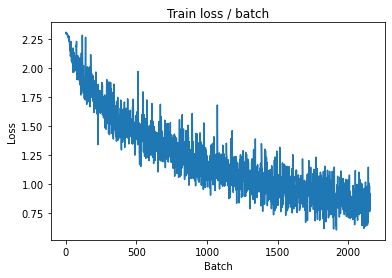


===============> Total time 22s	Avg loss 0.8360	Avg Prec@1 70.83 %	Avg Prec@5 97.77 %

[EVAL Batch 000/079]	Time 0.147s (0.147s)	Loss 0.7461 (0.7461)	Prec@1  73.4 ( 73.4)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.7875	Avg Prec@1 72.41 %	Avg Prec@5 97.79 %



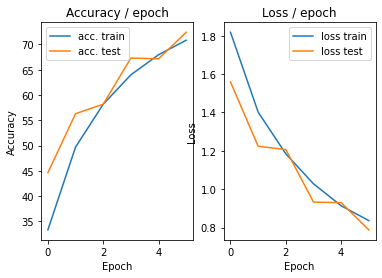

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.217s (0.217s)	Loss 0.6415 (0.6415)	Prec@1  80.5 ( 80.5)	Prec@5  99.2 ( 99.2)


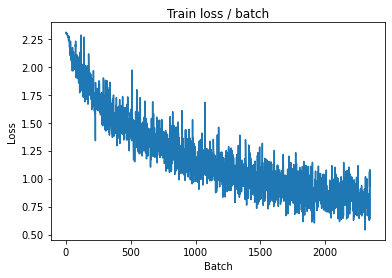

[TRAIN Batch 200/391]	Time 0.100s (0.057s)	Loss 0.7341 (0.7711)	Prec@1  75.0 ( 73.0)	Prec@5  98.4 ( 98.2)


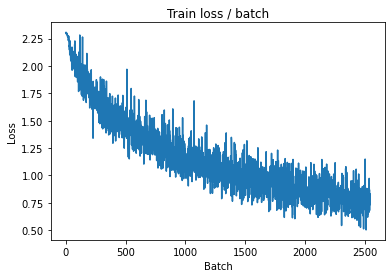


===============> Total time 22s	Avg loss 0.7661	Avg Prec@1 73.37 %	Avg Prec@5 98.16 %

[EVAL Batch 000/079]	Time 0.154s (0.154s)	Loss 0.7176 (0.7176)	Prec@1  78.1 ( 78.1)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.7783	Avg Prec@1 73.22 %	Avg Prec@5 97.72 %



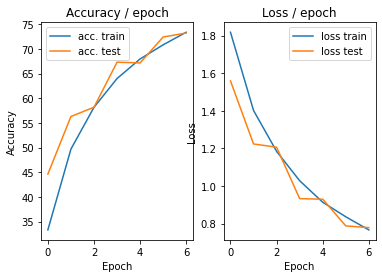

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.211s (0.211s)	Loss 0.7370 (0.7370)	Prec@1  75.8 ( 75.8)	Prec@5  99.2 ( 99.2)


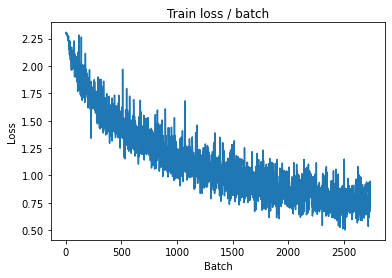

[TRAIN Batch 200/391]	Time 0.020s (0.058s)	Loss 0.6751 (0.7157)	Prec@1  78.1 ( 75.5)	Prec@5  99.2 ( 98.3)


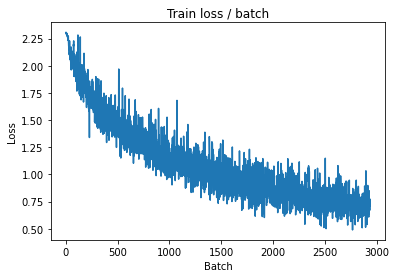


===============> Total time 22s	Avg loss 0.7175	Avg Prec@1 75.05 %	Avg Prec@5 98.36 %

[EVAL Batch 000/079]	Time 0.172s (0.172s)	Loss 0.7134 (0.7134)	Prec@1  74.2 ( 74.2)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.7851	Avg Prec@1 73.30 %	Avg Prec@5 97.92 %



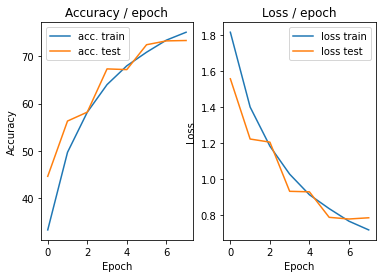

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.206s (0.206s)	Loss 0.7513 (0.7513)	Prec@1  74.2 ( 74.2)	Prec@5  99.2 ( 99.2)


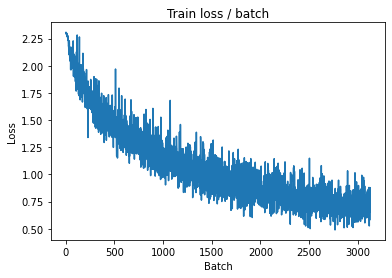

[TRAIN Batch 200/391]	Time 0.104s (0.058s)	Loss 0.7269 (0.6636)	Prec@1  75.0 ( 76.9)	Prec@5  98.4 ( 98.6)


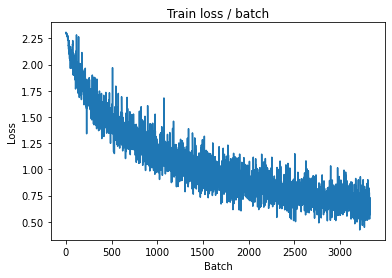


===============> Total time 22s	Avg loss 0.6620	Avg Prec@1 76.83 %	Avg Prec@5 98.66 %

[EVAL Batch 000/079]	Time 0.162s (0.162s)	Loss 0.6871 (0.6871)	Prec@1  78.1 ( 78.1)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.7115	Avg Prec@1 75.44 %	Avg Prec@5 98.18 %



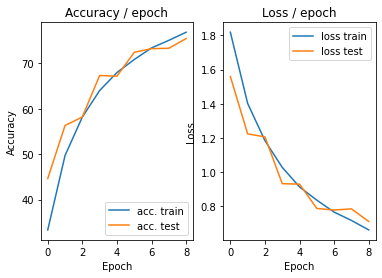

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.220s (0.220s)	Loss 0.6342 (0.6342)	Prec@1  77.3 ( 77.3)	Prec@5  99.2 ( 99.2)


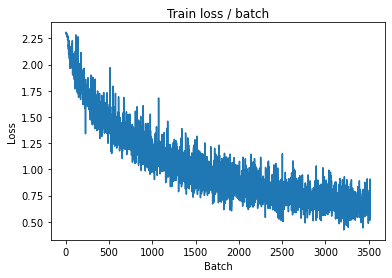

[TRAIN Batch 200/391]	Time 0.023s (0.058s)	Loss 0.7594 (0.6294)	Prec@1  74.2 ( 78.2)	Prec@5  98.4 ( 98.7)


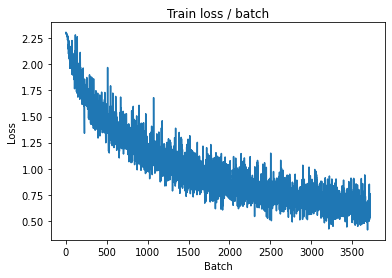


===============> Total time 22s	Avg loss 0.6257	Avg Prec@1 78.24 %	Avg Prec@5 98.77 %

[EVAL Batch 000/079]	Time 0.152s (0.152s)	Loss 0.6091 (0.6091)	Prec@1  78.1 ( 78.1)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6872	Avg Prec@1 76.85 %	Avg Prec@5 98.49 %



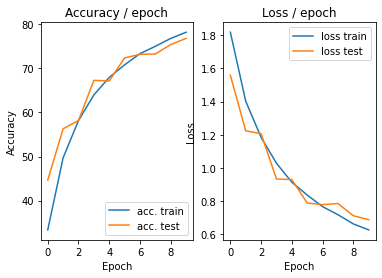

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.209s (0.209s)	Loss 0.4611 (0.4611)	Prec@1  83.6 ( 83.6)	Prec@5 100.0 (100.0)


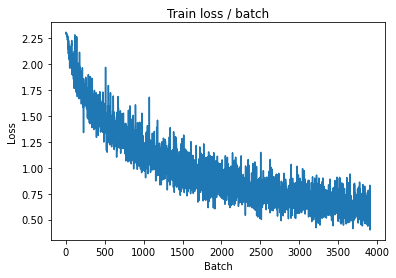

[TRAIN Batch 200/391]	Time 0.042s (0.058s)	Loss 0.5348 (0.5950)	Prec@1  78.9 ( 79.2)	Prec@5  98.4 ( 99.0)


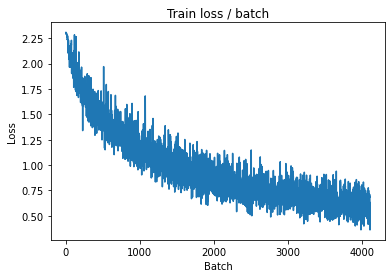


===============> Total time 22s	Avg loss 0.5894	Avg Prec@1 79.36 %	Avg Prec@5 98.94 %

[EVAL Batch 000/079]	Time 0.160s (0.160s)	Loss 0.6144 (0.6144)	Prec@1  81.2 ( 81.2)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.8952	Avg Prec@1 73.25 %	Avg Prec@5 97.33 %



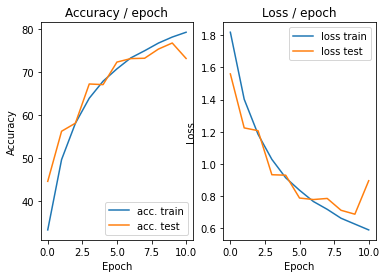

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.212s (0.212s)	Loss 0.6733 (0.6733)	Prec@1  78.1 ( 78.1)	Prec@5  97.7 ( 97.7)


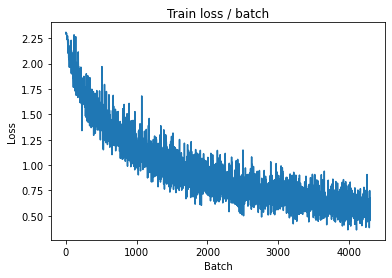

[TRAIN Batch 200/391]	Time 0.100s (0.058s)	Loss 0.6490 (0.5528)	Prec@1  78.1 ( 80.9)	Prec@5  97.7 ( 98.9)


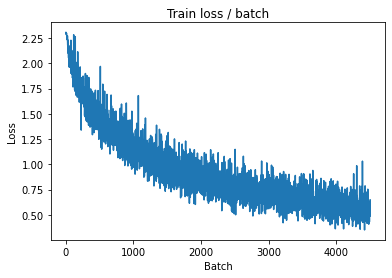


===============> Total time 22s	Avg loss 0.5593	Avg Prec@1 80.62 %	Avg Prec@5 99.00 %

[EVAL Batch 000/079]	Time 0.156s (0.156s)	Loss 0.6239 (0.6239)	Prec@1  76.6 ( 76.6)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.7294	Avg Prec@1 74.98 %	Avg Prec@5 98.24 %



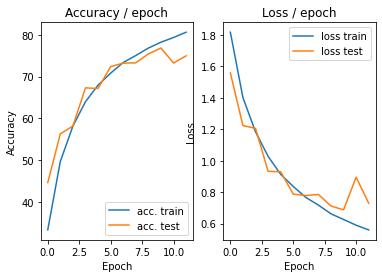

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.223s (0.223s)	Loss 0.6044 (0.6044)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)


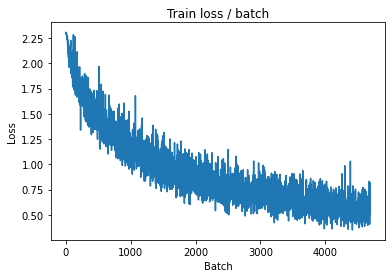

[TRAIN Batch 200/391]	Time 0.097s (0.058s)	Loss 0.5615 (0.5276)	Prec@1  81.2 ( 81.6)	Prec@5  99.2 ( 99.2)


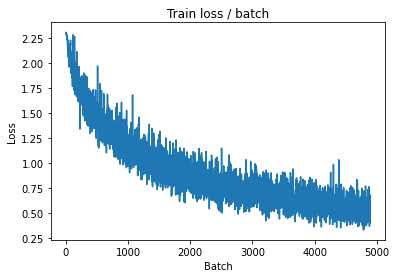


===============> Total time 22s	Avg loss 0.5307	Avg Prec@1 81.35 %	Avg Prec@5 99.16 %

[EVAL Batch 000/079]	Time 0.167s (0.167s)	Loss 0.6481 (0.6481)	Prec@1  80.5 ( 80.5)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.7082	Avg Prec@1 76.87 %	Avg Prec@5 98.38 %



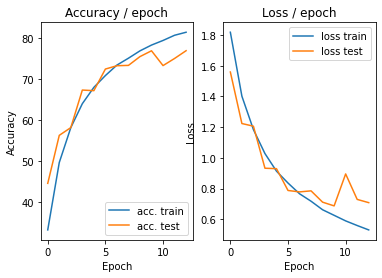

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.209s (0.209s)	Loss 0.5902 (0.5902)	Prec@1  81.2 ( 81.2)	Prec@5  99.2 ( 99.2)


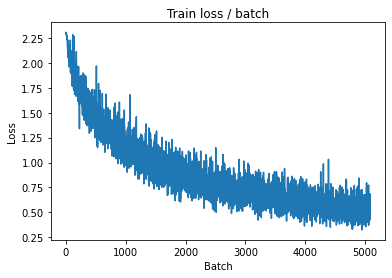

[TRAIN Batch 200/391]	Time 0.083s (0.058s)	Loss 0.6143 (0.5038)	Prec@1  78.9 ( 82.5)	Prec@5  99.2 ( 99.3)


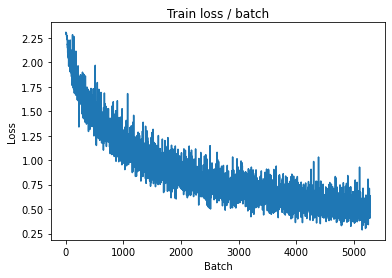


===============> Total time 22s	Avg loss 0.5078	Avg Prec@1 82.18 %	Avg Prec@5 99.26 %

[EVAL Batch 000/079]	Time 0.167s (0.167s)	Loss 0.4853 (0.4853)	Prec@1  81.2 ( 81.2)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.6053	Avg Prec@1 79.76 %	Avg Prec@5 98.72 %



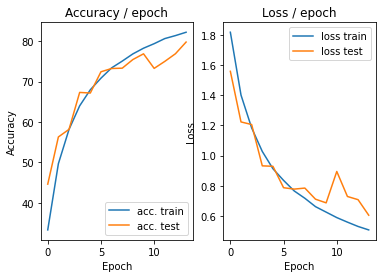

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.198s (0.198s)	Loss 0.4875 (0.4875)	Prec@1  85.2 ( 85.2)	Prec@5  99.2 ( 99.2)


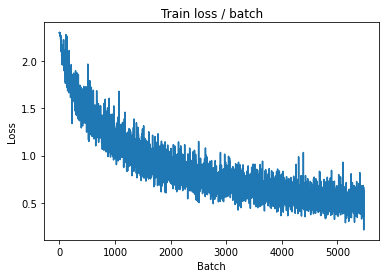

[TRAIN Batch 200/391]	Time 0.028s (0.058s)	Loss 0.4802 (0.4792)	Prec@1  78.9 ( 83.3)	Prec@5 100.0 ( 99.3)


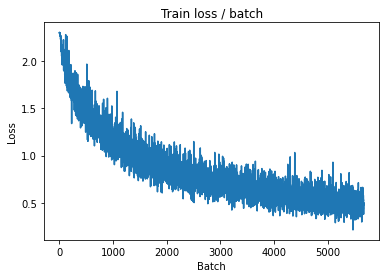


===============> Total time 22s	Avg loss 0.4853	Avg Prec@1 83.10 %	Avg Prec@5 99.36 %

[EVAL Batch 000/079]	Time 0.163s (0.163s)	Loss 0.5558 (0.5558)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6714	Avg Prec@1 78.08 %	Avg Prec@5 98.59 %



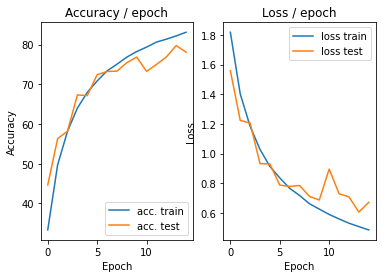

In [ ]:
main(batch_size=128,lr=0.1,epochs=42,cuda=True)

### Floutage, changement de perspective, (bruit)

In [ ]:
class AddGaussianNoise(object):
    def __init__(self, mean=0., std=1.):
        self.std = std
        self.mean = mean
    def __call__(self, tensor):
        return tensor + torch.randn(tensor.size()) * self.std + self.mean
    def __repr__(self):
        return self.__class__.__name__ + '(mean={0}, std={1})'.format(self.mean, self.std)

class ConvNet(nn.Module):
    """
    Cette classe contient la structure du réseau de neurones
    """

    def __init__(self):
        super(ConvNet, self).__init__()
        # On définit d'abord les couches de convolution et de pooling comme un
        # groupe de couches `self.features` 
        self.features = nn.Sequential(
            nn.Conv2d(3, 32, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(32, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(64, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0, ceil_mode=True), # ceil_mode ajouté !
        )

        # On définit les couches fully connected comme un groupe de couches
        # `self.classifier`
        self.classifier = nn.Sequential(
            nn.Linear(1024, 1000),
            nn.ReLU(),
            nn.Linear(1000, 10)
            # Rappel : Le softmax est inclus dans la loss, ne pas le mettre ici
        )

    # méthode appelée quand on applique le réseau à un batch d'input
    def forward(self, input):
        bsize = input.size(0) # taille du batch
        output = self.features(input) # on calcule la sortie des conv
        output = output.view(bsize, -1) # on aplatit les feature map 2D en un
                                        # vecteur 1D pour chaque input
        output = self.classifier(output) # on calcule la sortie des fc
        return output

def get_dataset(name, batch_size, cuda=False):
    """
    Cette fonction charge le dataset et effectue des transformations sur chaque
    image (listées dans `transform = ...`).
    """
    train_dataset = name(PATH, train=True, download=True,
        transform = transforms.Compose([
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.491,0.482,0.447],std=[0.202,0.199,0.201]),
            # AddGaussianNoise(mean_const,std_const),
            transforms.GaussianBlur(3, sigma=(0.1, 2.0)),
            transforms.RandomPerspective(fill=None)
          ]))
    
    val_dataset = name(PATH, train=False, download=True,
        transform = transforms.Compose([
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.491,0.482,0.447],std=[0.202,0.199,0.201])
          ]))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader

Files already downloaded and verified
Files already downloaded and verified
=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.370s (0.370s)	Loss 2.3035 (2.3035)	Prec@1   7.8 (  7.8)	Prec@5  50.8 ( 50.8)


<Figure size 432x288 with 0 Axes>

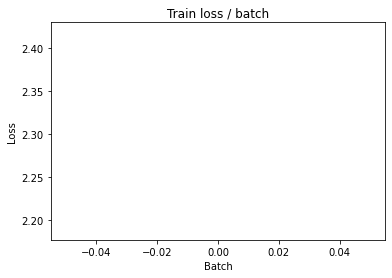

[TRAIN Batch 200/391]	Time 0.025s (0.134s)	Loss 1.7779 (2.0026)	Prec@1  34.4 ( 26.2)	Prec@5  85.2 ( 77.8)


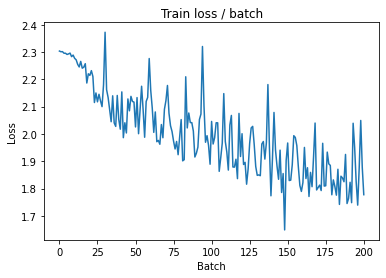


===============> Total time 52s	Avg loss 1.8599	Avg Prec@1 32.00 %	Avg Prec@5 82.65 %

[EVAL Batch 000/079]	Time 0.168s (0.168s)	Loss 1.7582 (1.7582)	Prec@1  36.7 ( 36.7)	Prec@5  87.5 ( 87.5)

===============> Total time 2s	Avg loss 1.6732	Avg Prec@1 38.57 %	Avg Prec@5 90.04 %



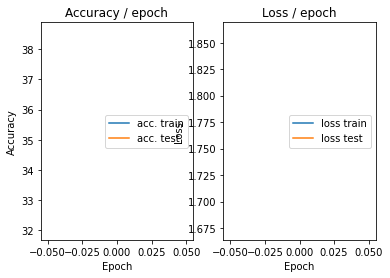

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.391s (0.391s)	Loss 1.6249 (1.6249)	Prec@1  39.8 ( 39.8)	Prec@5  96.1 ( 96.1)


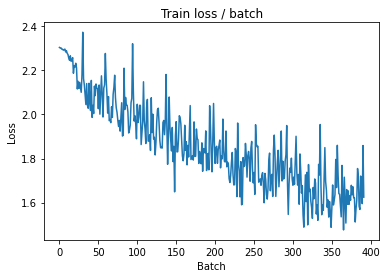

Exception ignored in: <bound method _MultiProcessingDataLoaderIter.__del__ of <torch.utils.data.dataloader._MultiProcessingDataLoaderIter object at 0x7f5ea0323160>>
Traceback (most recent call last):
  File "/usr/local/lib/python3.6/dist-packages/torch/utils/data/dataloader.py", line 1203, in __del__
    self._shutdown_workers()
  File "/usr/local/lib/python3.6/dist-packages/torch/utils/data/dataloader.py", line 1177, in _shutdown_workers
    w.join(timeout=_utils.MP_STATUS_CHECK_INTERVAL)
  File "/usr/lib/python3.6/multiprocessing/process.py", line 122, in join
    assert self._parent_pid == os.getpid(), 'can only join a child process'
AssertionError: can only join a child process
Exception ignored in: <bound method _MultiProcessingDataLoaderIter.__del__ of <torch.utils.data.dataloader._MultiProcessingDataLoaderIter object at 0x7f5ea45e8550>>
Traceback (most recent call last):
  File "/usr/local/lib/python3.6/dist-packages/torch/utils/data/dataloader.py", line 1203, in __del__
    sel

[TRAIN Batch 200/391]	Time 0.026s (0.136s)	Loss 1.6120 (1.5598)	Prec@1  43.8 ( 44.0)	Prec@5  92.2 ( 90.7)


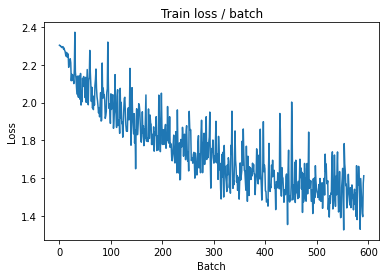


===============> Total time 52s	Avg loss 1.5118	Avg Prec@1 45.72 %	Avg Prec@5 91.35 %

[EVAL Batch 000/079]	Time 0.169s (0.169s)	Loss 1.2445 (1.2445)	Prec@1  56.2 ( 56.2)	Prec@5  92.2 ( 92.2)

===============> Total time 2s	Avg loss 1.3458	Avg Prec@1 50.84 %	Avg Prec@5 94.29 %



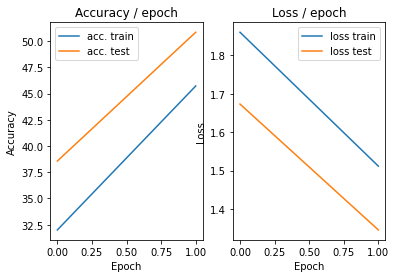

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.387s (0.387s)	Loss 1.5230 (1.5230)	Prec@1  42.2 ( 42.2)	Prec@5  93.8 ( 93.8)


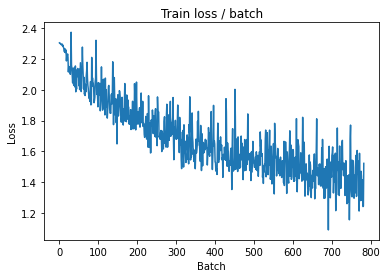

[TRAIN Batch 200/391]	Time 0.020s (0.135s)	Loss 1.4134 (1.3792)	Prec@1  53.9 ( 50.8)	Prec@5  95.3 ( 93.2)


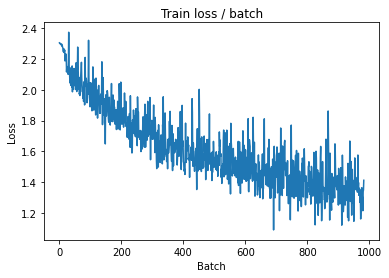


===============> Total time 52s	Avg loss 1.3439	Avg Prec@1 52.12 %	Avg Prec@5 93.60 %

[EVAL Batch 000/079]	Time 0.168s (0.168s)	Loss 1.3046 (1.3046)	Prec@1  54.7 ( 54.7)	Prec@5  94.5 ( 94.5)

===============> Total time 2s	Avg loss 1.3434	Avg Prec@1 53.57 %	Avg Prec@5 92.29 %



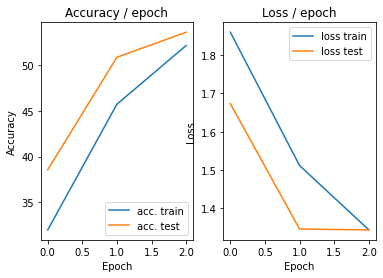

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.366s (0.366s)	Loss 1.3009 (1.3009)	Prec@1  57.0 ( 57.0)	Prec@5  93.8 ( 93.8)


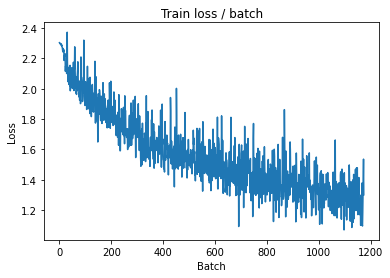

[TRAIN Batch 200/391]	Time 0.254s (0.135s)	Loss 1.0714 (1.2338)	Prec@1  62.5 ( 55.9)	Prec@5  95.3 ( 94.7)


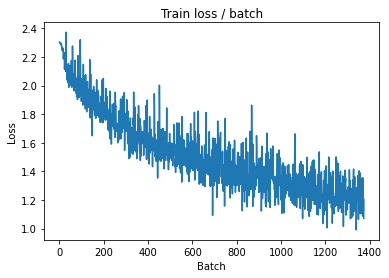


===============> Total time 52s	Avg loss 1.2265	Avg Prec@1 56.59 %	Avg Prec@5 94.72 %

[EVAL Batch 000/079]	Time 0.174s (0.174s)	Loss 1.0270 (1.0270)	Prec@1  66.4 ( 66.4)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 1.0593	Avg Prec@1 62.59 %	Avg Prec@5 96.54 %



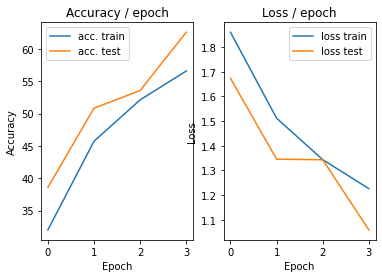

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.373s (0.373s)	Loss 1.1302 (1.1302)	Prec@1  60.9 ( 60.9)	Prec@5  94.5 ( 94.5)


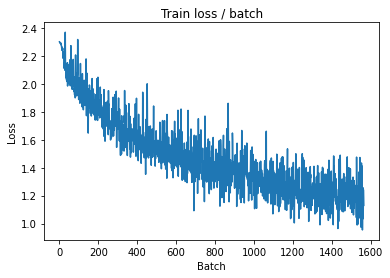

[TRAIN Batch 200/391]	Time 0.020s (0.135s)	Loss 1.0323 (1.1390)	Prec@1  68.8 ( 59.8)	Prec@5  96.1 ( 95.8)


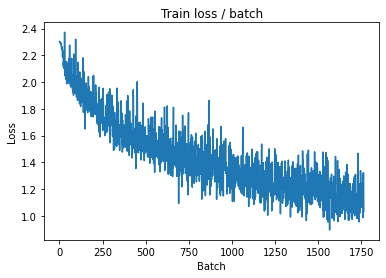


===============> Total time 52s	Avg loss 1.1307	Avg Prec@1 59.94 %	Avg Prec@5 95.82 %

[EVAL Batch 000/079]	Time 0.167s (0.167s)	Loss 1.1350 (1.1350)	Prec@1  60.2 ( 60.2)	Prec@5  94.5 ( 94.5)

===============> Total time 2s	Avg loss 1.0048	Avg Prec@1 64.67 %	Avg Prec@5 96.48 %



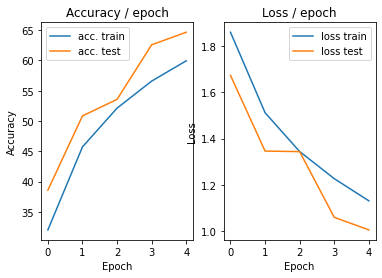

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.360s (0.360s)	Loss 0.9584 (0.9584)	Prec@1  67.2 ( 67.2)	Prec@5  96.9 ( 96.9)


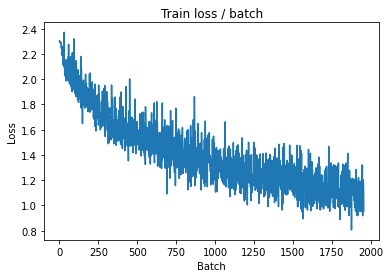

[TRAIN Batch 200/391]	Time 0.151s (0.134s)	Loss 1.0348 (1.0663)	Prec@1  63.3 ( 62.6)	Prec@5  97.7 ( 96.0)


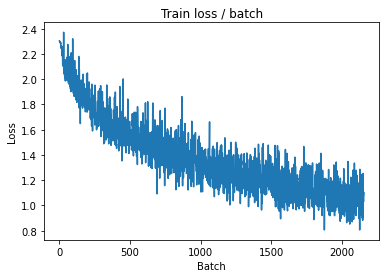


===============> Total time 52s	Avg loss 1.0514	Avg Prec@1 62.98 %	Avg Prec@5 96.24 %

[EVAL Batch 000/079]	Time 0.156s (0.156s)	Loss 1.0732 (1.0732)	Prec@1  63.3 ( 63.3)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 1.0445	Avg Prec@1 65.01 %	Avg Prec@5 96.24 %



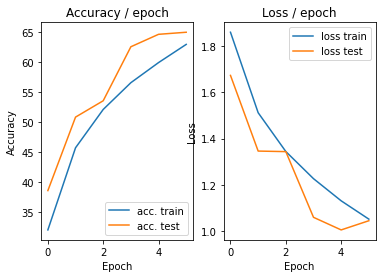

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.401s (0.401s)	Loss 1.2504 (1.2504)	Prec@1  56.2 ( 56.2)	Prec@5  94.5 ( 94.5)


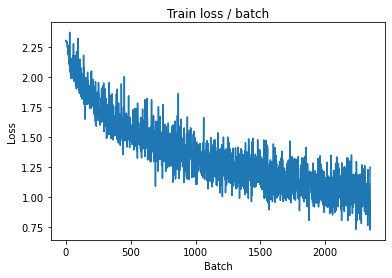

[TRAIN Batch 200/391]	Time 0.114s (0.135s)	Loss 1.1420 (0.9898)	Prec@1  57.0 ( 65.2)	Prec@5  98.4 ( 96.8)


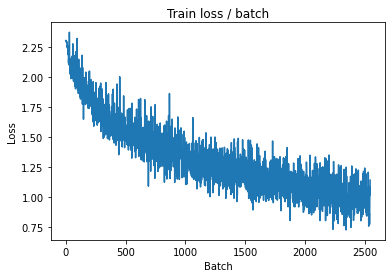


===============> Total time 52s	Avg loss 0.9794	Avg Prec@1 65.62 %	Avg Prec@5 96.87 %

[EVAL Batch 000/079]	Time 0.169s (0.169s)	Loss 1.0280 (1.0280)	Prec@1  70.3 ( 70.3)	Prec@5  95.3 ( 95.3)

===============> Total time 2s	Avg loss 0.9475	Avg Prec@1 67.47 %	Avg Prec@5 96.93 %



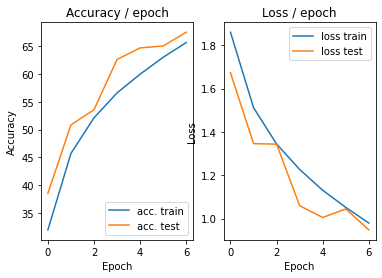

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.369s (0.369s)	Loss 0.7703 (0.7703)	Prec@1  75.8 ( 75.8)	Prec@5  96.9 ( 96.9)


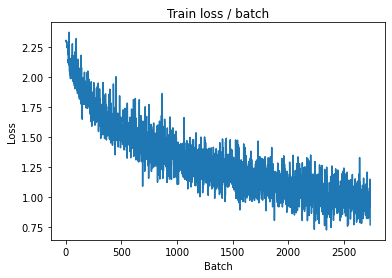

[TRAIN Batch 200/391]	Time 0.025s (0.134s)	Loss 0.9001 (0.9216)	Prec@1  68.8 ( 67.5)	Prec@5  98.4 ( 97.3)


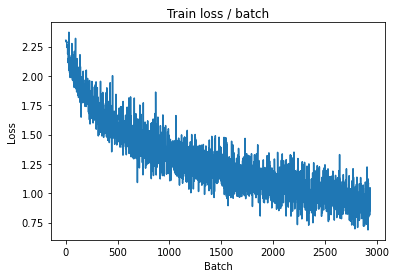


===============> Total time 52s	Avg loss 0.9277	Avg Prec@1 67.34 %	Avg Prec@5 97.23 %

[EVAL Batch 000/079]	Time 0.158s (0.158s)	Loss 0.9113 (0.9113)	Prec@1  72.7 ( 72.7)	Prec@5  95.3 ( 95.3)

===============> Total time 2s	Avg loss 0.8938	Avg Prec@1 69.66 %	Avg Prec@5 97.36 %



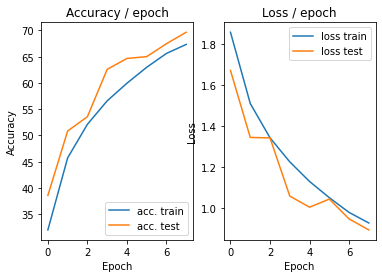

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.385s (0.385s)	Loss 0.7883 (0.7883)	Prec@1  74.2 ( 74.2)	Prec@5 100.0 (100.0)


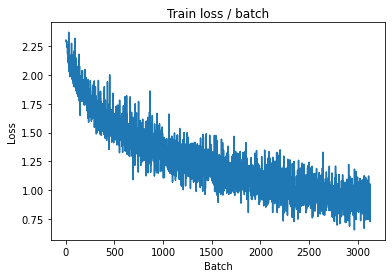

[TRAIN Batch 200/391]	Time 0.183s (0.134s)	Loss 0.9439 (0.8630)	Prec@1  66.4 ( 69.5)	Prec@5  96.9 ( 97.5)


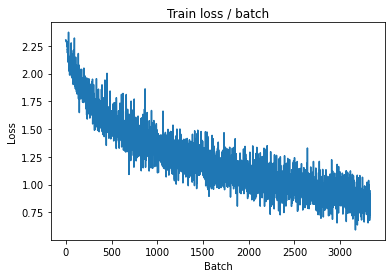


===============> Total time 52s	Avg loss 0.8679	Avg Prec@1 69.54 %	Avg Prec@5 97.56 %

[EVAL Batch 000/079]	Time 0.163s (0.163s)	Loss 0.9310 (0.9310)	Prec@1  72.7 ( 72.7)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.8598	Avg Prec@1 71.57 %	Avg Prec@5 97.60 %



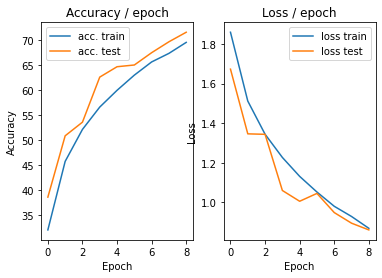

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.384s (0.384s)	Loss 0.7011 (0.7011)	Prec@1  75.0 ( 75.0)	Prec@5  96.9 ( 96.9)


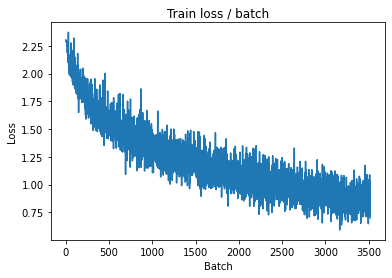

[TRAIN Batch 200/391]	Time 0.234s (0.135s)	Loss 0.7939 (0.8094)	Prec@1  70.3 ( 72.0)	Prec@5  99.2 ( 98.1)


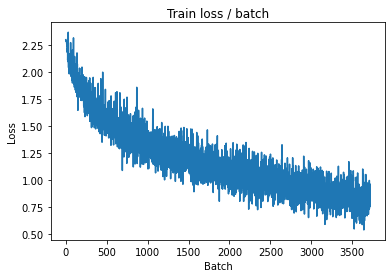


===============> Total time 52s	Avg loss 0.8194	Avg Prec@1 71.53 %	Avg Prec@5 97.98 %

[EVAL Batch 000/079]	Time 0.190s (0.190s)	Loss 0.9252 (0.9252)	Prec@1  70.3 ( 70.3)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.8433	Avg Prec@1 71.72 %	Avg Prec@5 97.46 %



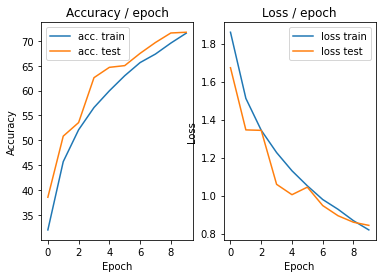

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.387s (0.387s)	Loss 0.7866 (0.7866)	Prec@1  71.1 ( 71.1)	Prec@5  96.1 ( 96.1)


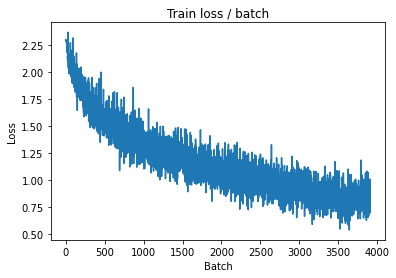

[TRAIN Batch 200/391]	Time 0.022s (0.134s)	Loss 0.9831 (0.7700)	Prec@1  63.3 ( 73.3)	Prec@5  97.7 ( 98.2)


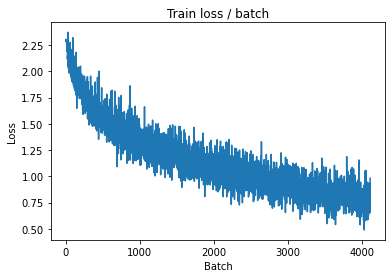


===============> Total time 52s	Avg loss 0.7762	Avg Prec@1 73.06 %	Avg Prec@5 98.13 %

[EVAL Batch 000/079]	Time 0.178s (0.178s)	Loss 1.1830 (1.1830)	Prec@1  62.5 ( 62.5)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 1.0005	Avg Prec@1 67.48 %	Avg Prec@5 97.15 %



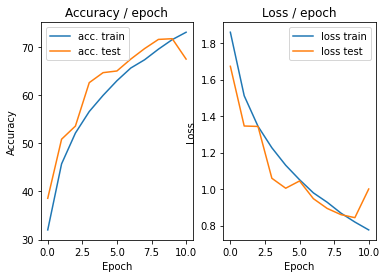

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.407s (0.407s)	Loss 0.7392 (0.7392)	Prec@1  72.7 ( 72.7)	Prec@5  98.4 ( 98.4)


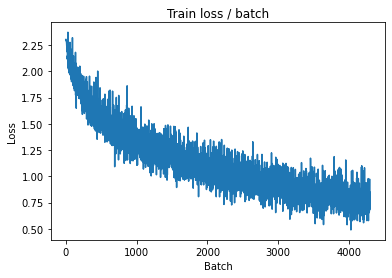

[TRAIN Batch 200/391]	Time 0.245s (0.136s)	Loss 0.7005 (0.7303)	Prec@1  78.1 ( 74.4)	Prec@5  96.9 ( 98.4)


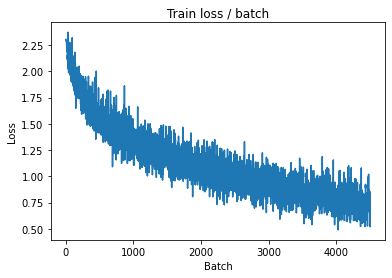


===============> Total time 52s	Avg loss 0.7382	Avg Prec@1 74.19 %	Avg Prec@5 98.39 %

[EVAL Batch 000/079]	Time 0.168s (0.168s)	Loss 0.9650 (0.9650)	Prec@1  68.8 ( 68.8)	Prec@5  94.5 ( 94.5)

===============> Total time 2s	Avg loss 0.9292	Avg Prec@1 69.91 %	Avg Prec@5 97.09 %



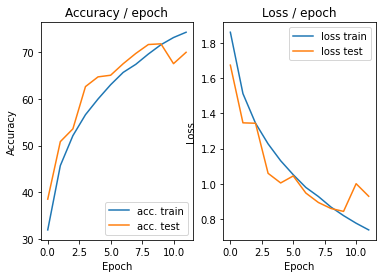

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.392s (0.392s)	Loss 0.6962 (0.6962)	Prec@1  77.3 ( 77.3)	Prec@5  97.7 ( 97.7)


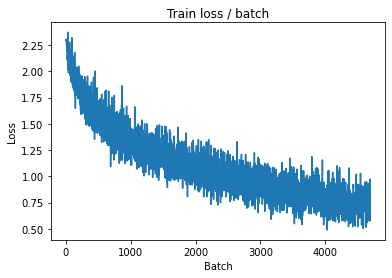

[TRAIN Batch 200/391]	Time 0.023s (0.135s)	Loss 0.6032 (0.6997)	Prec@1  78.9 ( 75.4)	Prec@5  99.2 ( 98.4)


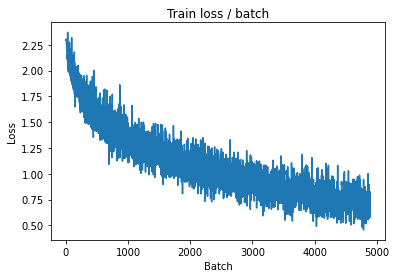


===============> Total time 52s	Avg loss 0.6995	Avg Prec@1 75.43 %	Avg Prec@5 98.41 %

[EVAL Batch 000/079]	Time 0.180s (0.180s)	Loss 1.0037 (1.0037)	Prec@1  65.6 ( 65.6)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.9052	Avg Prec@1 70.63 %	Avg Prec@5 97.39 %



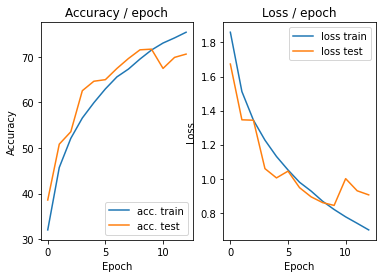

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.402s (0.402s)	Loss 0.8161 (0.8161)	Prec@1  71.9 ( 71.9)	Prec@5  98.4 ( 98.4)


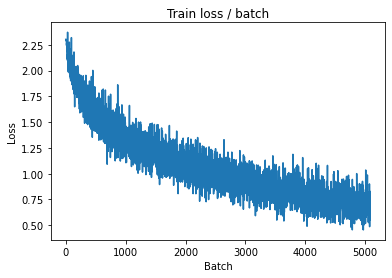

[TRAIN Batch 200/391]	Time 0.024s (0.136s)	Loss 0.8108 (0.6562)	Prec@1  69.5 ( 77.1)	Prec@5  97.7 ( 98.7)


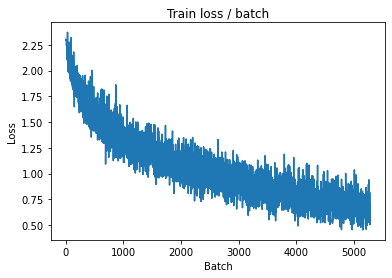


===============> Total time 52s	Avg loss 0.6633	Avg Prec@1 76.87 %	Avg Prec@5 98.68 %

[EVAL Batch 000/079]	Time 0.185s (0.185s)	Loss 1.1472 (1.1472)	Prec@1  71.9 ( 71.9)	Prec@5  95.3 ( 95.3)

===============> Total time 2s	Avg loss 0.9492	Avg Prec@1 72.43 %	Avg Prec@5 97.45 %



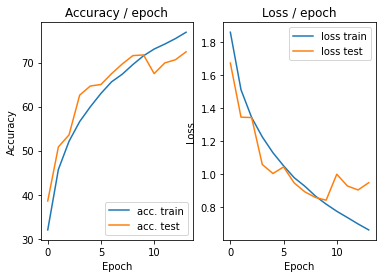

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.397s (0.397s)	Loss 0.7081 (0.7081)	Prec@1  78.1 ( 78.1)	Prec@5  97.7 ( 97.7)


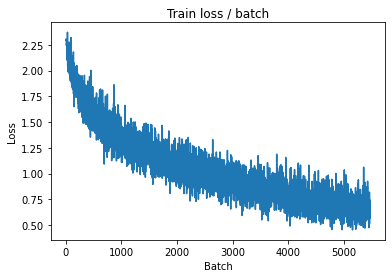

[TRAIN Batch 200/391]	Time 0.221s (0.135s)	Loss 0.6269 (0.6264)	Prec@1  78.9 ( 78.1)	Prec@5  96.9 ( 98.9)


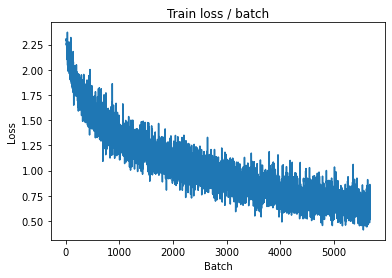


===============> Total time 52s	Avg loss 0.6358	Avg Prec@1 77.83 %	Avg Prec@5 98.79 %

[EVAL Batch 000/079]	Time 0.169s (0.169s)	Loss 1.0334 (1.0334)	Prec@1  71.1 ( 71.1)	Prec@5  95.3 ( 95.3)

===============> Total time 2s	Avg loss 0.8632	Avg Prec@1 73.45 %	Avg Prec@5 97.70 %



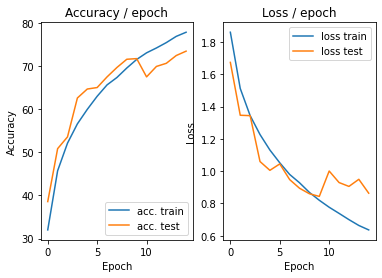

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.412s (0.412s)	Loss 0.5685 (0.5685)	Prec@1  78.9 ( 78.9)	Prec@5  98.4 ( 98.4)


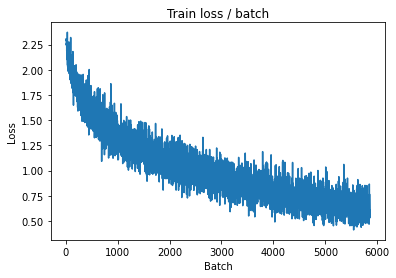

[TRAIN Batch 200/391]	Time 0.026s (0.136s)	Loss 0.5241 (0.5893)	Prec@1  81.2 ( 79.4)	Prec@5  99.2 ( 98.9)


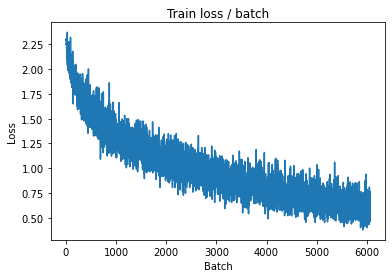


===============> Total time 52s	Avg loss 0.5983	Avg Prec@1 79.06 %	Avg Prec@5 98.91 %

[EVAL Batch 000/079]	Time 0.172s (0.172s)	Loss 1.0942 (1.0942)	Prec@1  70.3 ( 70.3)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.8616	Avg Prec@1 73.12 %	Avg Prec@5 97.86 %



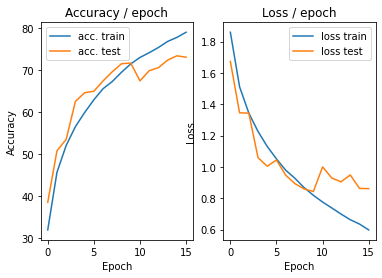

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.387s (0.387s)	Loss 0.5996 (0.5996)	Prec@1  78.9 ( 78.9)	Prec@5  97.7 ( 97.7)


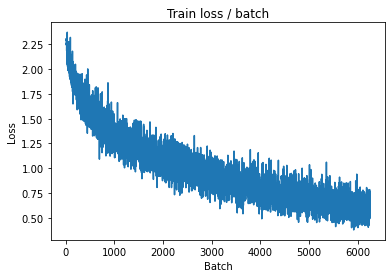

[TRAIN Batch 200/391]	Time 0.257s (0.136s)	Loss 0.6141 (0.5676)	Prec@1  78.1 ( 80.1)	Prec@5  99.2 ( 99.0)


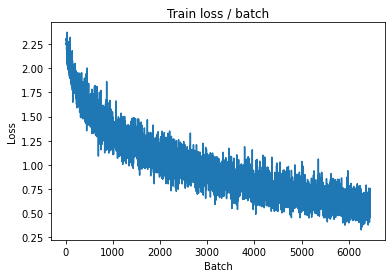


===============> Total time 52s	Avg loss 0.5784	Avg Prec@1 79.74 %	Avg Prec@5 98.99 %

[EVAL Batch 000/079]	Time 0.178s (0.178s)	Loss 1.1009 (1.1009)	Prec@1  74.2 ( 74.2)	Prec@5  95.3 ( 95.3)

===============> Total time 2s	Avg loss 0.8937	Avg Prec@1 73.64 %	Avg Prec@5 97.85 %



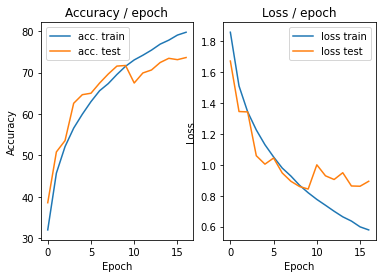

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.395s (0.395s)	Loss 0.6116 (0.6116)	Prec@1  75.8 ( 75.8)	Prec@5  98.4 ( 98.4)


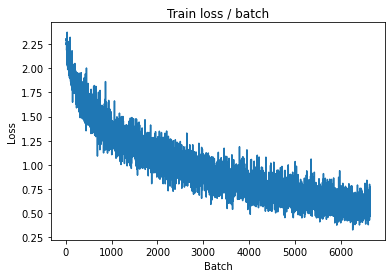

[TRAIN Batch 200/391]	Time 0.027s (0.134s)	Loss 0.6346 (0.5432)	Prec@1  78.1 ( 81.0)	Prec@5  98.4 ( 99.1)


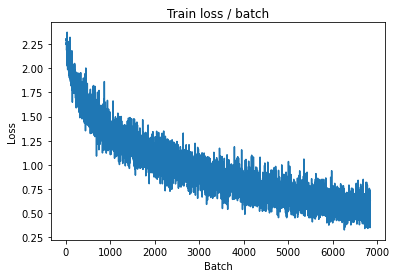


===============> Total time 52s	Avg loss 0.5494	Avg Prec@1 80.74 %	Avg Prec@5 99.08 %

[EVAL Batch 000/079]	Time 0.165s (0.165s)	Loss 1.0200 (1.0200)	Prec@1  71.1 ( 71.1)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 0.8948	Avg Prec@1 73.99 %	Avg Prec@5 97.69 %



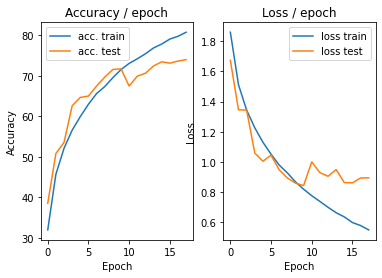

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.408s (0.408s)	Loss 0.4720 (0.4720)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)


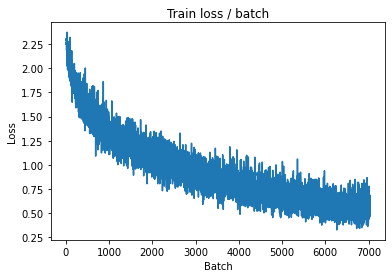

[TRAIN Batch 200/391]	Time 0.189s (0.134s)	Loss 0.4769 (0.5186)	Prec@1  79.7 ( 82.0)	Prec@5  99.2 ( 99.2)


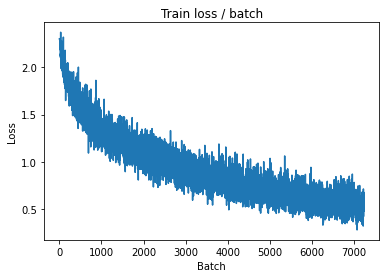


===============> Total time 51s	Avg loss 0.5308	Avg Prec@1 81.60 %	Avg Prec@5 99.13 %

[EVAL Batch 000/079]	Time 0.181s (0.181s)	Loss 1.1607 (1.1607)	Prec@1  75.0 ( 75.0)	Prec@5  95.3 ( 95.3)

===============> Total time 2s	Avg loss 0.9226	Avg Prec@1 73.87 %	Avg Prec@5 97.84 %



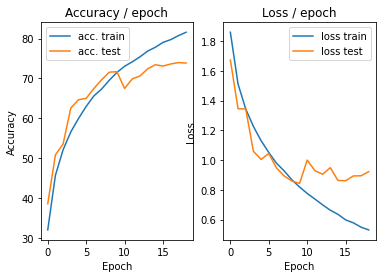

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.405s (0.405s)	Loss 0.5423 (0.5423)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)


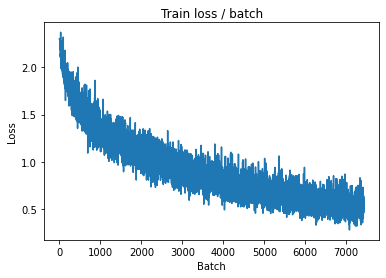

[TRAIN Batch 200/391]	Time 0.028s (0.134s)	Loss 0.5851 (0.4976)	Prec@1  78.1 ( 82.8)	Prec@5  98.4 ( 99.2)


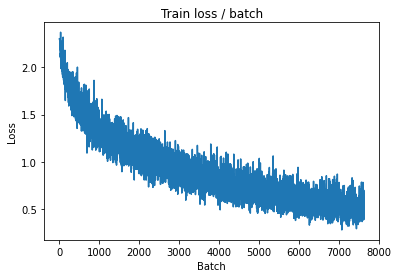


===============> Total time 52s	Avg loss 0.5085	Avg Prec@1 82.33 %	Avg Prec@5 99.22 %

[EVAL Batch 000/079]	Time 0.158s (0.158s)	Loss 1.2014 (1.2014)	Prec@1  70.3 ( 70.3)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.9648	Avg Prec@1 73.27 %	Avg Prec@5 97.86 %



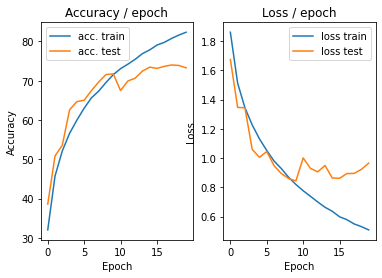

=== EPOCH 21 =====

[TRAIN Batch 000/391]	Time 0.420s (0.420s)	Loss 0.5682 (0.5682)	Prec@1  78.1 ( 78.1)	Prec@5  99.2 ( 99.2)


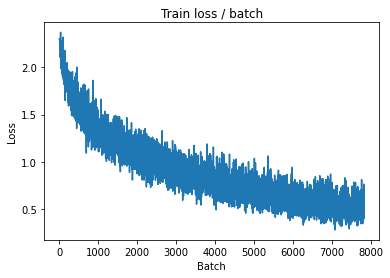

[TRAIN Batch 200/391]	Time 0.106s (0.134s)	Loss 0.4397 (0.4749)	Prec@1  86.7 ( 83.6)	Prec@5  98.4 ( 99.3)


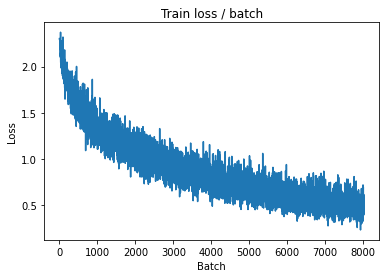


===============> Total time 52s	Avg loss 0.4894	Avg Prec@1 83.17 %	Avg Prec@5 99.26 %

[EVAL Batch 000/079]	Time 0.187s (0.187s)	Loss 1.0728 (1.0728)	Prec@1  76.6 ( 76.6)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 0.9512	Avg Prec@1 75.00 %	Avg Prec@5 97.69 %



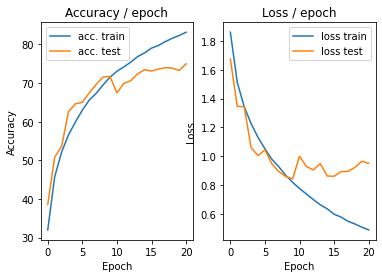

=== EPOCH 22 =====

[TRAIN Batch 000/391]	Time 0.387s (0.387s)	Loss 0.4351 (0.4351)	Prec@1  87.5 ( 87.5)	Prec@5  99.2 ( 99.2)


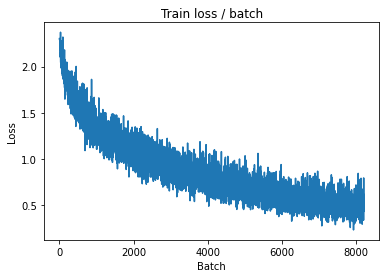

[TRAIN Batch 200/391]	Time 0.067s (0.135s)	Loss 0.5749 (0.4669)	Prec@1  80.5 ( 83.7)	Prec@5  97.7 ( 99.3)


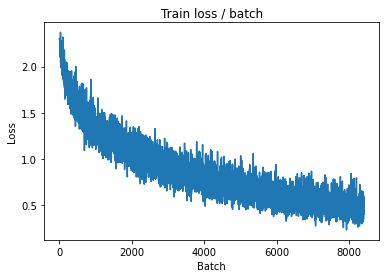


===============> Total time 52s	Avg loss 0.4767	Avg Prec@1 83.47 %	Avg Prec@5 99.29 %

[EVAL Batch 000/079]	Time 0.171s (0.171s)	Loss 1.1565 (1.1565)	Prec@1  78.9 ( 78.9)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 0.9625	Avg Prec@1 73.38 %	Avg Prec@5 97.89 %



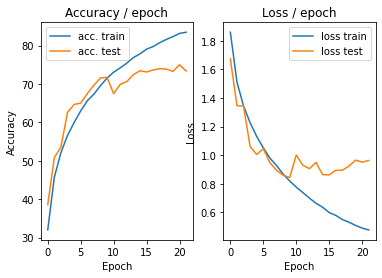

=== EPOCH 23 =====

[TRAIN Batch 000/391]	Time 0.375s (0.375s)	Loss 0.5286 (0.5286)	Prec@1  81.2 ( 81.2)	Prec@5  99.2 ( 99.2)


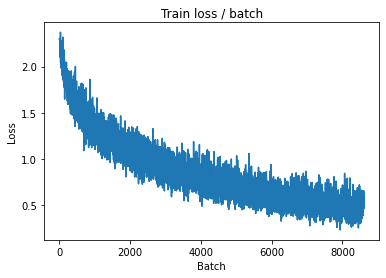

[TRAIN Batch 200/391]	Time 0.229s (0.134s)	Loss 0.5229 (0.4326)	Prec@1  84.4 ( 85.1)	Prec@5  99.2 ( 99.3)


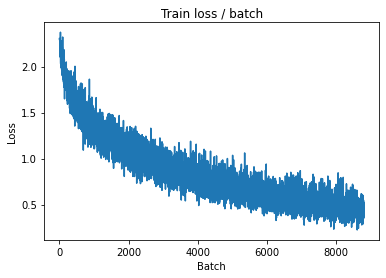


===============> Total time 52s	Avg loss 0.4468	Avg Prec@1 84.60 %	Avg Prec@5 99.39 %

[EVAL Batch 000/079]	Time 0.180s (0.180s)	Loss 1.2595 (1.2595)	Prec@1  73.4 ( 73.4)	Prec@5  94.5 ( 94.5)

===============> Total time 2s	Avg loss 0.9528	Avg Prec@1 74.46 %	Avg Prec@5 97.81 %



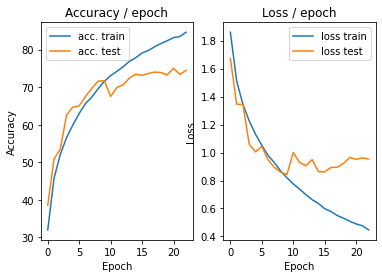

=== EPOCH 24 =====

[TRAIN Batch 000/391]	Time 0.385s (0.385s)	Loss 0.3193 (0.3193)	Prec@1  89.8 ( 89.8)	Prec@5 100.0 (100.0)


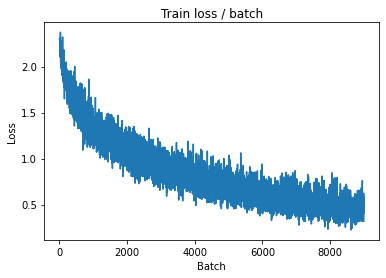

[TRAIN Batch 200/391]	Time 0.182s (0.135s)	Loss 0.5257 (0.4402)	Prec@1  79.7 ( 84.7)	Prec@5 100.0 ( 99.4)


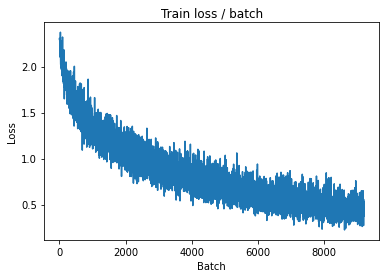


===============> Total time 52s	Avg loss 0.4441	Avg Prec@1 84.63 %	Avg Prec@5 99.33 %

[EVAL Batch 000/079]	Time 0.172s (0.172s)	Loss 1.2208 (1.2208)	Prec@1  74.2 ( 74.2)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 1.1592	Avg Prec@1 72.75 %	Avg Prec@5 97.70 %



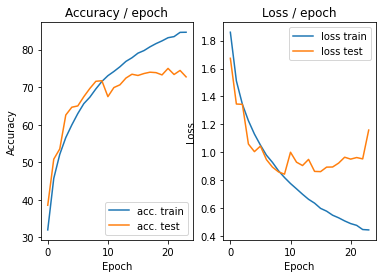

=== EPOCH 25 =====

[TRAIN Batch 000/391]	Time 0.428s (0.428s)	Loss 0.4789 (0.4789)	Prec@1  81.2 ( 81.2)	Prec@5  97.7 ( 97.7)


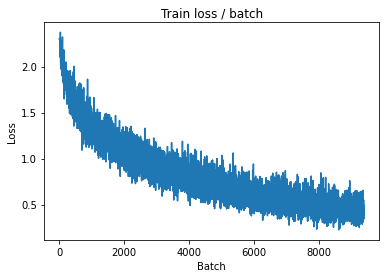

[TRAIN Batch 200/391]	Time 0.180s (0.133s)	Loss 0.3546 (0.4086)	Prec@1  86.7 ( 85.9)	Prec@5  99.2 ( 99.4)


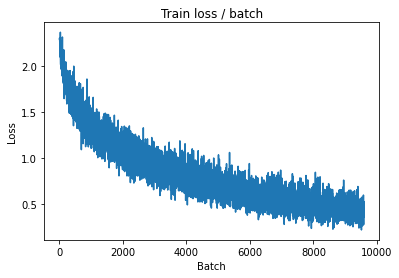


===============> Total time 51s	Avg loss 0.4257	Avg Prec@1 85.30 %	Avg Prec@5 99.38 %

[EVAL Batch 000/079]	Time 0.170s (0.170s)	Loss 1.0369 (1.0369)	Prec@1  82.0 ( 82.0)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 0.9866	Avg Prec@1 75.15 %	Avg Prec@5 98.02 %



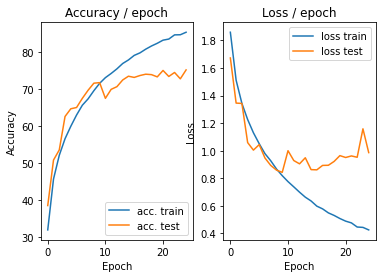

=== EPOCH 26 =====

[TRAIN Batch 000/391]	Time 0.394s (0.394s)	Loss 0.2759 (0.2759)	Prec@1  88.3 ( 88.3)	Prec@5 100.0 (100.0)


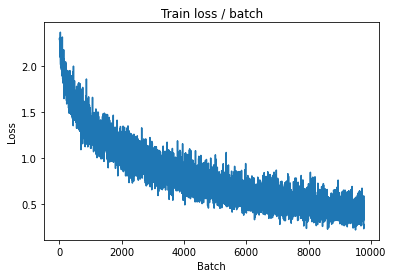

[TRAIN Batch 200/391]	Time 0.214s (0.134s)	Loss 0.5327 (0.3929)	Prec@1  83.6 ( 86.6)	Prec@5 100.0 ( 99.4)


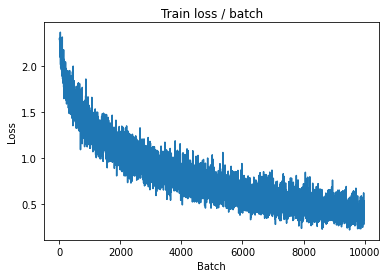


===============> Total time 52s	Avg loss 0.4153	Avg Prec@1 85.72 %	Avg Prec@5 99.40 %

[EVAL Batch 000/079]	Time 0.171s (0.171s)	Loss 1.2877 (1.2877)	Prec@1  73.4 ( 73.4)	Prec@5  94.5 ( 94.5)

===============> Total time 2s	Avg loss 1.0270	Avg Prec@1 74.55 %	Avg Prec@5 97.83 %



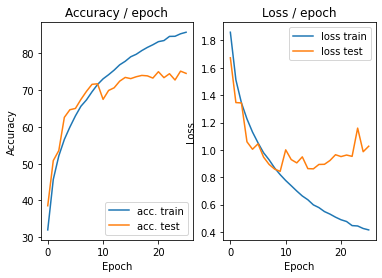

=== EPOCH 27 =====

[TRAIN Batch 000/391]	Time 0.408s (0.408s)	Loss 0.3445 (0.3445)	Prec@1  87.5 ( 87.5)	Prec@5  99.2 ( 99.2)


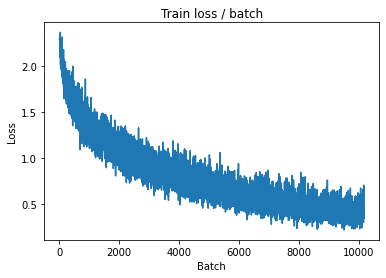

[TRAIN Batch 200/391]	Time 0.027s (0.134s)	Loss 0.4014 (0.3961)	Prec@1  85.9 ( 86.4)	Prec@5 100.0 ( 99.5)


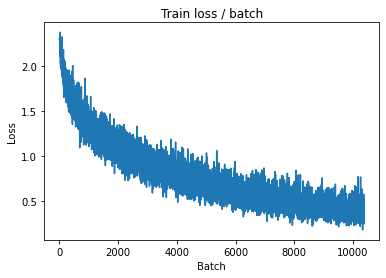


===============> Total time 51s	Avg loss 0.4001	Avg Prec@1 86.26 %	Avg Prec@5 99.48 %

[EVAL Batch 000/079]	Time 0.173s (0.173s)	Loss 1.2783 (1.2783)	Prec@1  76.6 ( 76.6)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 1.1118	Avg Prec@1 72.82 %	Avg Prec@5 97.47 %



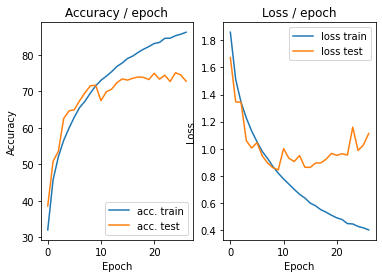

=== EPOCH 28 =====

[TRAIN Batch 000/391]	Time 0.399s (0.399s)	Loss 0.5788 (0.5788)	Prec@1  78.9 ( 78.9)	Prec@5  98.4 ( 98.4)


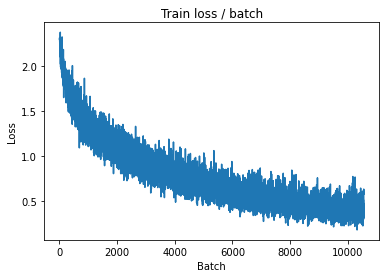

[TRAIN Batch 200/391]	Time 0.245s (0.134s)	Loss 0.4054 (0.3749)	Prec@1  85.9 ( 87.0)	Prec@5 100.0 ( 99.5)


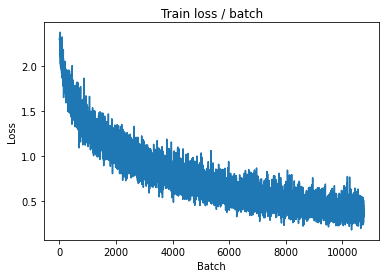


===============> Total time 51s	Avg loss 0.3903	Avg Prec@1 86.42 %	Avg Prec@5 99.47 %

[EVAL Batch 000/079]	Time 0.161s (0.161s)	Loss 1.2408 (1.2408)	Prec@1  73.4 ( 73.4)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 1.0289	Avg Prec@1 74.68 %	Avg Prec@5 97.99 %



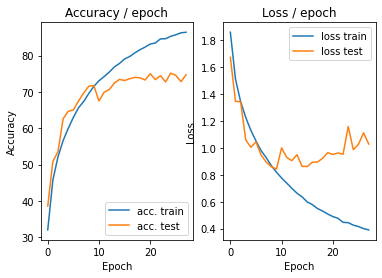

=== EPOCH 29 =====

[TRAIN Batch 000/391]	Time 0.383s (0.383s)	Loss 0.2834 (0.2834)	Prec@1  91.4 ( 91.4)	Prec@5  99.2 ( 99.2)


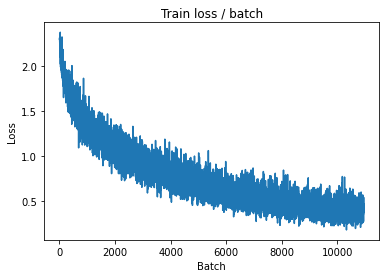

[TRAIN Batch 200/391]	Time 0.022s (0.133s)	Loss 0.3279 (0.3676)	Prec@1  86.7 ( 87.2)	Prec@5 100.0 ( 99.5)


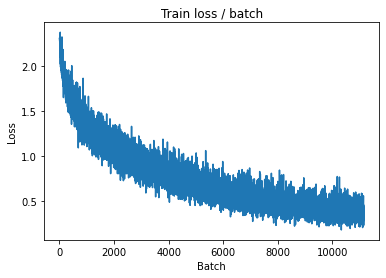


===============> Total time 51s	Avg loss 0.3794	Avg Prec@1 86.85 %	Avg Prec@5 99.49 %

[EVAL Batch 000/079]	Time 0.176s (0.176s)	Loss 1.3080 (1.3080)	Prec@1  75.8 ( 75.8)	Prec@5  95.3 ( 95.3)

===============> Total time 2s	Avg loss 1.0609	Avg Prec@1 73.29 %	Avg Prec@5 97.58 %



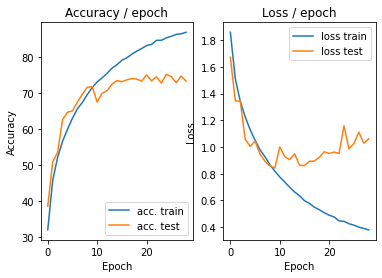

=== EPOCH 30 =====

[TRAIN Batch 000/391]	Time 0.405s (0.405s)	Loss 0.3753 (0.3753)	Prec@1  85.2 ( 85.2)	Prec@5  99.2 ( 99.2)


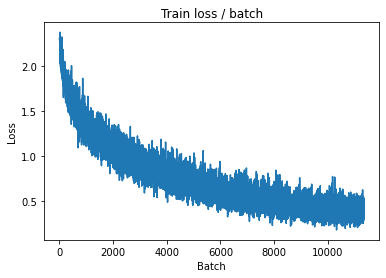

[TRAIN Batch 200/391]	Time 0.183s (0.133s)	Loss 0.3482 (0.3536)	Prec@1  89.8 ( 87.9)	Prec@5 100.0 ( 99.6)


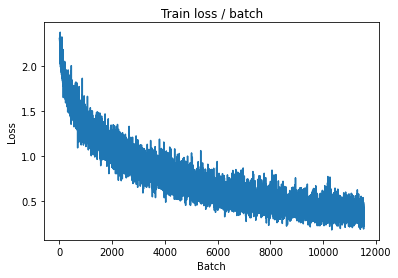


===============> Total time 51s	Avg loss 0.3676	Avg Prec@1 87.45 %	Avg Prec@5 99.56 %

[EVAL Batch 000/079]	Time 0.174s (0.174s)	Loss 1.2374 (1.2374)	Prec@1  75.8 ( 75.8)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 1.0154	Avg Prec@1 73.80 %	Avg Prec@5 97.55 %



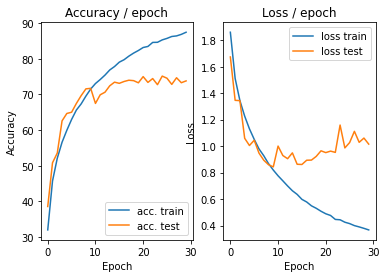

=== EPOCH 31 =====

[TRAIN Batch 000/391]	Time 0.388s (0.388s)	Loss 0.2984 (0.2984)	Prec@1  89.8 ( 89.8)	Prec@5 100.0 (100.0)


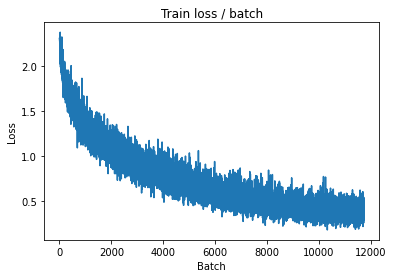

[TRAIN Batch 200/391]	Time 0.241s (0.133s)	Loss 0.2823 (0.3466)	Prec@1  89.1 ( 88.0)	Prec@5 100.0 ( 99.6)


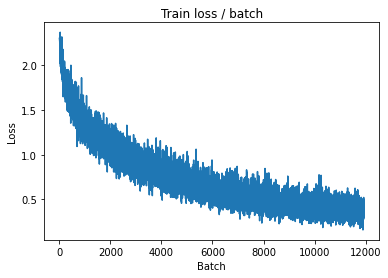


===============> Total time 51s	Avg loss 0.3620	Avg Prec@1 87.50 %	Avg Prec@5 99.55 %

[EVAL Batch 000/079]	Time 0.164s (0.164s)	Loss 1.5147 (1.5147)	Prec@1  73.4 ( 73.4)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 1.0758	Avg Prec@1 74.54 %	Avg Prec@5 97.61 %



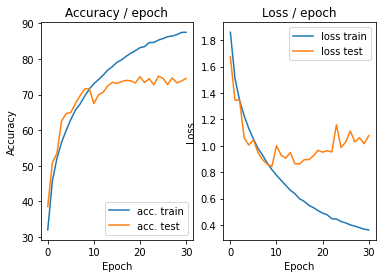

=== EPOCH 32 =====

[TRAIN Batch 000/391]	Time 0.399s (0.399s)	Loss 0.4386 (0.4386)	Prec@1  85.9 ( 85.9)	Prec@5  99.2 ( 99.2)


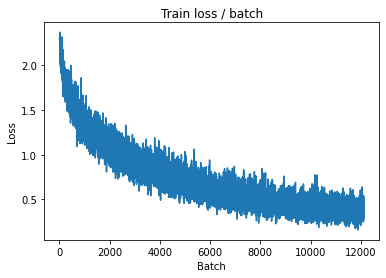

[TRAIN Batch 200/391]	Time 0.045s (0.134s)	Loss 0.3184 (0.3535)	Prec@1  89.8 ( 87.6)	Prec@5  99.2 ( 99.6)


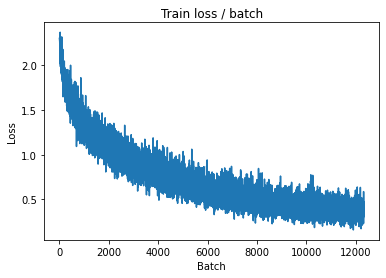


===============> Total time 51s	Avg loss 0.3635	Avg Prec@1 87.30 %	Avg Prec@5 99.56 %

[EVAL Batch 000/079]	Time 0.164s (0.164s)	Loss 1.4544 (1.4544)	Prec@1  78.1 ( 78.1)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 1.0369	Avg Prec@1 75.13 %	Avg Prec@5 97.68 %



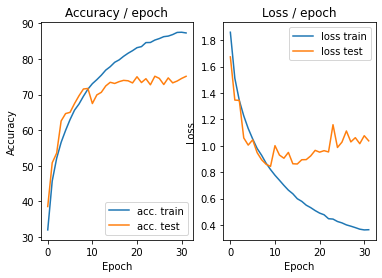

=== EPOCH 33 =====

[TRAIN Batch 000/391]	Time 0.377s (0.377s)	Loss 0.3983 (0.3983)	Prec@1  83.6 ( 83.6)	Prec@5 100.0 (100.0)


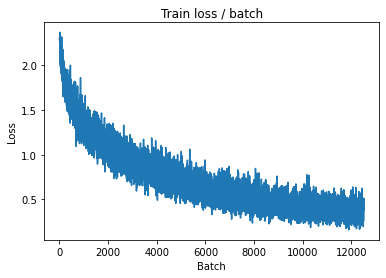

[TRAIN Batch 200/391]	Time 0.222s (0.133s)	Loss 0.3383 (0.3354)	Prec@1  88.3 ( 88.5)	Prec@5 100.0 ( 99.6)


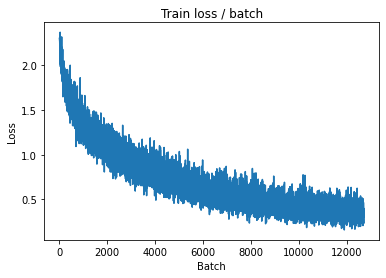


===============> Total time 51s	Avg loss 0.3447	Avg Prec@1 88.26 %	Avg Prec@5 99.58 %

[EVAL Batch 000/079]	Time 0.170s (0.170s)	Loss 1.5261 (1.5261)	Prec@1  74.2 ( 74.2)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 1.1705	Avg Prec@1 74.73 %	Avg Prec@5 97.79 %



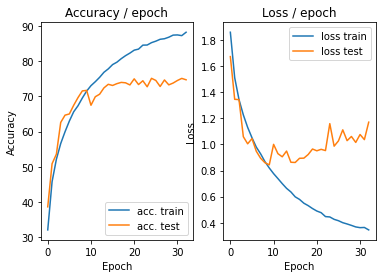

=== EPOCH 34 =====

[TRAIN Batch 000/391]	Time 0.371s (0.371s)	Loss 0.2029 (0.2029)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


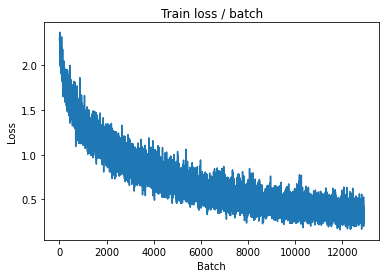

[TRAIN Batch 200/391]	Time 0.243s (0.134s)	Loss 0.3202 (0.3343)	Prec@1  87.5 ( 88.6)	Prec@5 100.0 ( 99.6)


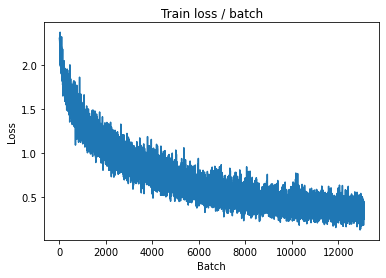


===============> Total time 51s	Avg loss 0.3435	Avg Prec@1 88.26 %	Avg Prec@5 99.58 %

[EVAL Batch 000/079]	Time 0.177s (0.177s)	Loss 1.4835 (1.4835)	Prec@1  75.8 ( 75.8)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 1.1323	Avg Prec@1 74.40 %	Avg Prec@5 97.82 %



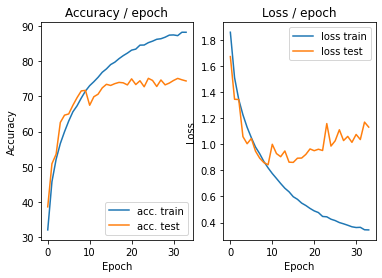

=== EPOCH 35 =====

[TRAIN Batch 000/391]	Time 0.403s (0.403s)	Loss 0.3218 (0.3218)	Prec@1  85.9 ( 85.9)	Prec@5 100.0 (100.0)


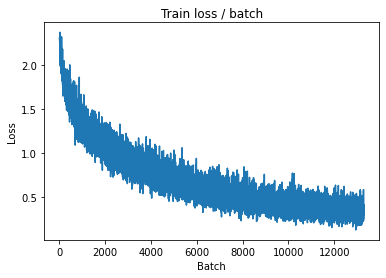

[TRAIN Batch 200/391]	Time 0.238s (0.133s)	Loss 0.3600 (0.3303)	Prec@1  92.2 ( 88.4)	Prec@5  99.2 ( 99.7)


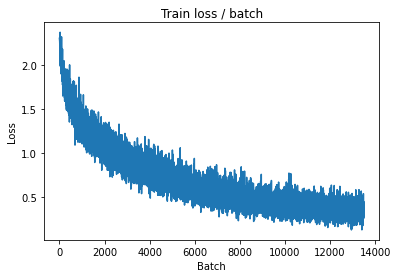


===============> Total time 51s	Avg loss 0.3315	Avg Prec@1 88.50 %	Avg Prec@5 99.65 %

[EVAL Batch 000/079]	Time 0.173s (0.173s)	Loss 1.2229 (1.2229)	Prec@1  75.8 ( 75.8)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 1.0387	Avg Prec@1 74.99 %	Avg Prec@5 98.01 %



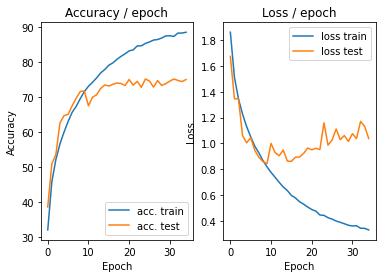

=== EPOCH 36 =====

[TRAIN Batch 000/391]	Time 0.390s (0.390s)	Loss 0.2890 (0.2890)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


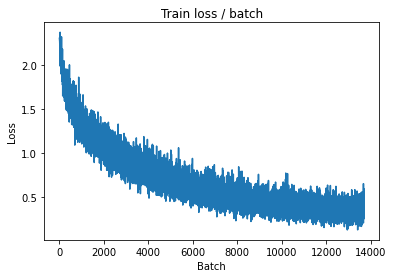

[TRAIN Batch 200/391]	Time 0.157s (0.133s)	Loss 0.4296 (0.3112)	Prec@1  82.8 ( 89.1)	Prec@5 100.0 ( 99.6)


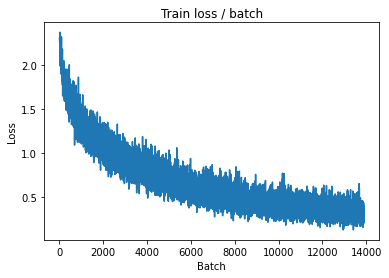


===============> Total time 51s	Avg loss 0.3244	Avg Prec@1 88.66 %	Avg Prec@5 99.61 %

[EVAL Batch 000/079]	Time 0.164s (0.164s)	Loss 1.4345 (1.4345)	Prec@1  75.8 ( 75.8)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.1465	Avg Prec@1 74.74 %	Avg Prec@5 97.71 %



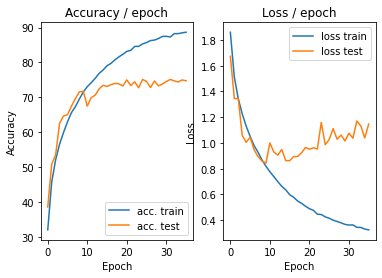

=== EPOCH 37 =====

[TRAIN Batch 000/391]	Time 0.409s (0.409s)	Loss 0.2871 (0.2871)	Prec@1  89.8 ( 89.8)	Prec@5 100.0 (100.0)


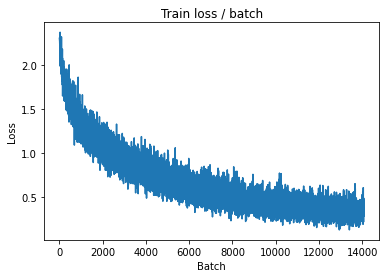

[TRAIN Batch 200/391]	Time 0.140s (0.133s)	Loss 0.3467 (0.3137)	Prec@1  89.1 ( 89.4)	Prec@5  99.2 ( 99.7)


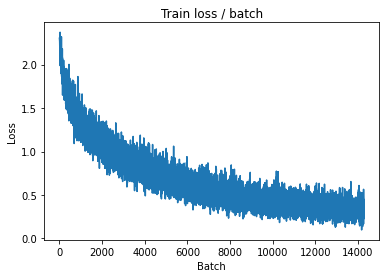


===============> Total time 51s	Avg loss 0.3248	Avg Prec@1 88.94 %	Avg Prec@5 99.65 %

[EVAL Batch 000/079]	Time 0.160s (0.160s)	Loss 1.4857 (1.4857)	Prec@1  75.0 ( 75.0)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.1819	Avg Prec@1 75.04 %	Avg Prec@5 98.10 %



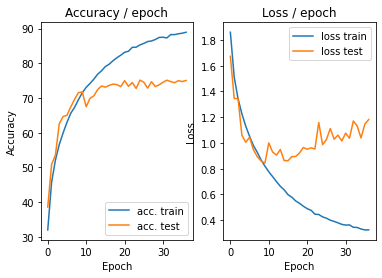

=== EPOCH 38 =====

[TRAIN Batch 000/391]	Time 0.390s (0.390s)	Loss 0.4274 (0.4274)	Prec@1  87.5 ( 87.5)	Prec@5  98.4 ( 98.4)


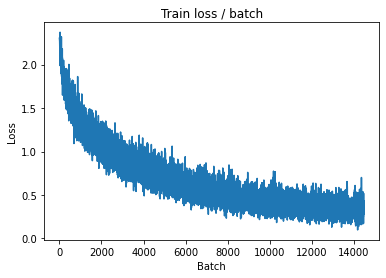

[TRAIN Batch 200/391]	Time 0.104s (0.134s)	Loss 0.2885 (0.3134)	Prec@1  90.6 ( 89.2)	Prec@5 100.0 ( 99.7)


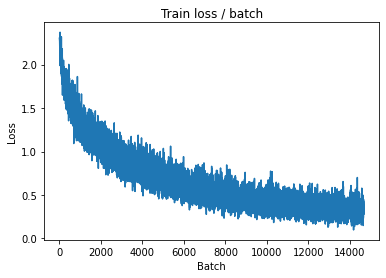


===============> Total time 52s	Avg loss 0.3225	Avg Prec@1 88.96 %	Avg Prec@5 99.66 %

[EVAL Batch 000/079]	Time 0.174s (0.174s)	Loss 1.5304 (1.5304)	Prec@1  71.9 ( 71.9)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.1380	Avg Prec@1 75.30 %	Avg Prec@5 97.88 %



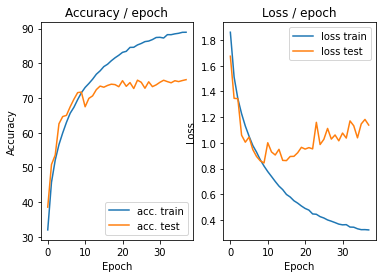

=== EPOCH 39 =====

[TRAIN Batch 000/391]	Time 0.392s (0.392s)	Loss 0.2893 (0.2893)	Prec@1  90.6 ( 90.6)	Prec@5  99.2 ( 99.2)


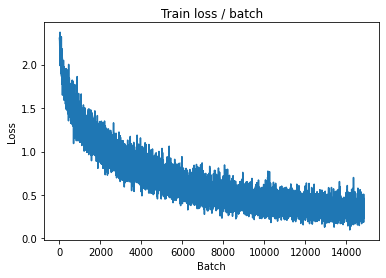

[TRAIN Batch 200/391]	Time 0.219s (0.135s)	Loss 0.2705 (0.3026)	Prec@1  91.4 ( 89.7)	Prec@5  99.2 ( 99.7)


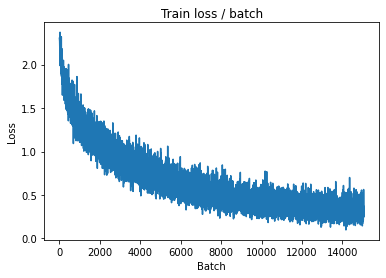


===============> Total time 51s	Avg loss 0.3065	Avg Prec@1 89.48 %	Avg Prec@5 99.71 %

[EVAL Batch 000/079]	Time 0.171s (0.171s)	Loss 1.3701 (1.3701)	Prec@1  75.8 ( 75.8)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 1.1852	Avg Prec@1 75.19 %	Avg Prec@5 97.84 %



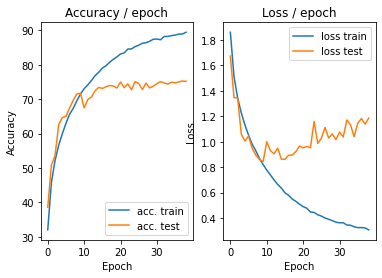

=== EPOCH 40 =====

[TRAIN Batch 000/391]	Time 0.383s (0.383s)	Loss 0.3355 (0.3355)	Prec@1  85.2 ( 85.2)	Prec@5 100.0 (100.0)


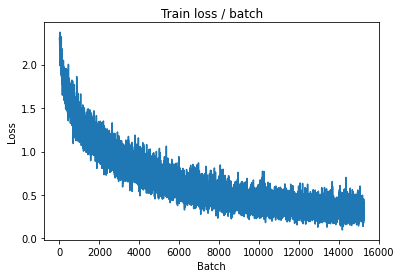

[TRAIN Batch 200/391]	Time 0.254s (0.135s)	Loss 0.2748 (0.3106)	Prec@1  89.8 ( 89.4)	Prec@5 100.0 ( 99.7)


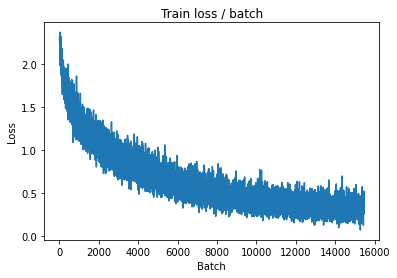


===============> Total time 52s	Avg loss 0.3109	Avg Prec@1 89.51 %	Avg Prec@5 99.68 %

[EVAL Batch 000/079]	Time 0.175s (0.175s)	Loss 1.3522 (1.3522)	Prec@1  72.7 ( 72.7)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.0968	Avg Prec@1 74.75 %	Avg Prec@5 97.52 %



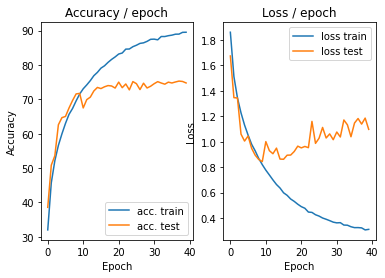

=== EPOCH 41 =====

[TRAIN Batch 000/391]	Time 0.372s (0.372s)	Loss 0.2776 (0.2776)	Prec@1  89.8 ( 89.8)	Prec@5  99.2 ( 99.2)


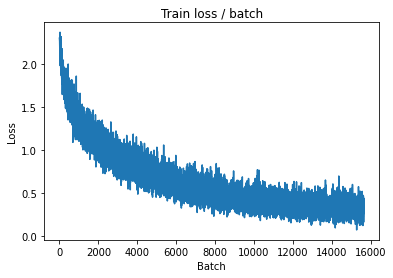

[TRAIN Batch 200/391]	Time 0.219s (0.134s)	Loss 0.3092 (0.2959)	Prec@1  90.6 ( 89.8)	Prec@5 100.0 ( 99.7)


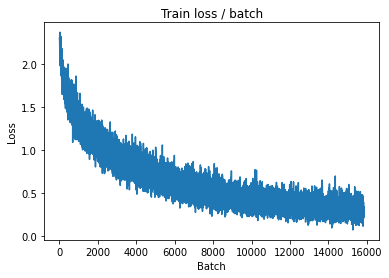


===============> Total time 51s	Avg loss 0.3025	Avg Prec@1 89.63 %	Avg Prec@5 99.70 %

[EVAL Batch 000/079]	Time 0.173s (0.173s)	Loss 1.4951 (1.4951)	Prec@1  77.3 ( 77.3)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 1.2293	Avg Prec@1 75.64 %	Avg Prec@5 97.86 %



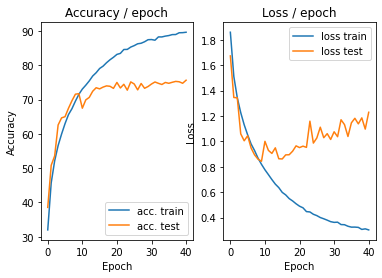

=== EPOCH 42 =====

[TRAIN Batch 000/391]	Time 0.392s (0.392s)	Loss 0.2344 (0.2344)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)


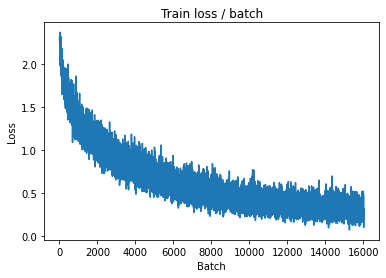

[TRAIN Batch 200/391]	Time 0.237s (0.134s)	Loss 0.2719 (0.2924)	Prec@1  87.5 ( 90.0)	Prec@5 100.0 ( 99.7)


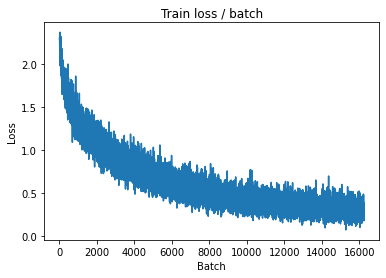


===============> Total time 51s	Avg loss 0.2986	Avg Prec@1 89.79 %	Avg Prec@5 99.70 %

[EVAL Batch 000/079]	Time 0.162s (0.162s)	Loss 1.5671 (1.5671)	Prec@1  67.2 ( 67.2)	Prec@5  95.3 ( 95.3)

===============> Total time 2s	Avg loss 1.2059	Avg Prec@1 74.00 %	Avg Prec@5 97.65 %



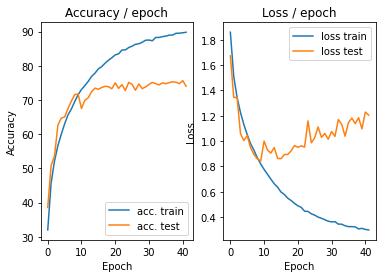

In [ ]:
main(batch_size=128,lr=0.1,epochs=42,cuda=True)

## Variantes sur l’optimisation

Amélioration du système d'apprentissage, indépendamment des données fournies au modèle.

### Momentum seul (valeur classique à 0.9)

In [ ]:
def main(batch_size=128, lr=0.1, epochs=15, cuda=False, namebase=datasets.CIFAR10, print_results=True):

    # define model, loss, optim
    model = ConvNet()
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr, momentum=0.9)

    if cuda: # si on fait du GPU, passage en CUDA
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # On récupère les données
    train, test = get_dataset(namebase, batch_size, cuda)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # On itère sur les epochs
    for i in range(epochs):
        if print_results:
            print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        # Phase de train
        top1_acc, top5_acc, loss, last_batch_time = epoch(train, model, criterion, optimizer, cuda, print_results)
        # Phase d'evaluation
        top1_acc_test, top5_acc_test, loss_test, last_batch_time_test = epoch(test, model, criterion, cuda=cuda, print_results=print_results)
        if print_results:
            # plot
            plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)
    
    if not print_results:
        return loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg, last_batch_time, last_batch_time_test

In [ ]:
main(batch_size=128,lr=0.1,epochs=42,cuda=True)

### Ajout du learning rate scheduling

In [5]:
def main(batch_size=128, lr=0.1, epochs=15, cuda=False, namebase=datasets.CIFAR10, print_results=True):

    # define model, loss, optim
    model = ConvNet()
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr, momentum=0.75)

    # Créer le scheduler
    lr_sched = torch.optim.lr_scheduler.ExponentialLR(optimizer, gamma=0.95)

    if cuda: # si on fait du GPU, passage en CUDA
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # On récupère les données
    train, test = get_dataset(namebase, batch_size, cuda)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # On itère sur les epochs
    for i in range(epochs):
        if print_results:
            print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        # Phase de train
        top1_acc, top5_acc, loss, last_batch_time = epoch(train, model, criterion, optimizer, cuda, print_results)
        # Phase d'evaluation
        top1_acc_test, top5_acc_test, loss_test, last_batch_time_test = epoch(test, model, criterion, cuda=cuda, print_results=print_results)
        if print_results:
            # plot
            plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)
        
        # Modifier le learning rate après chaque epoch
        lr_sched.step()

    if not print_results:
        return loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg, last_batch_time, last_batch_time_test

Files already downloaded and verified
Files already downloaded and verified
=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.216s (0.216s)	Loss 2.3013 (2.3013)	Prec@1   7.8 (  7.8)	Prec@5  49.2 ( 49.2)


<Figure size 432x288 with 0 Axes>

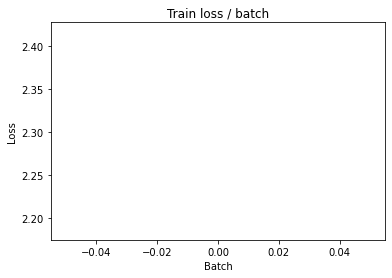

[TRAIN Batch 200/391]	Time 0.080s (0.045s)	Loss 1.8437 (1.8688)	Prec@1  36.7 ( 31.7)	Prec@5  83.6 ( 82.2)


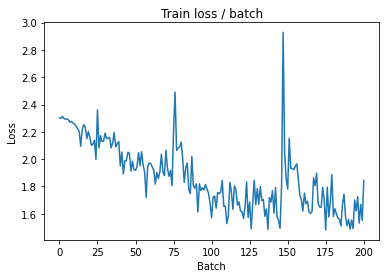


===============> Total time 17s	Avg loss 1.6812	Avg Prec@1 38.99 %	Avg Prec@5 86.95 %

[EVAL Batch 000/079]	Time 0.166s (0.166s)	Loss 1.3008 (1.3008)	Prec@1  52.3 ( 52.3)	Prec@5  94.5 ( 94.5)

===============> Total time 2s	Avg loss 1.3566	Avg Prec@1 50.62 %	Avg Prec@5 93.78 %



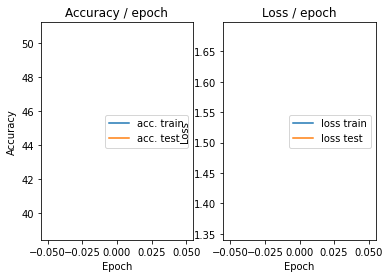

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.205s (0.205s)	Loss 1.1588 (1.1588)	Prec@1  64.8 ( 64.8)	Prec@5  94.5 ( 94.5)


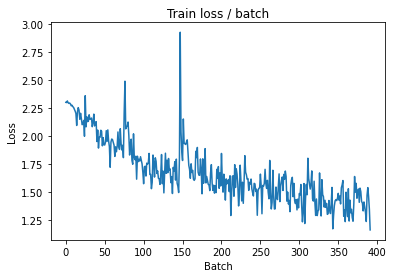

[TRAIN Batch 200/391]	Time 0.065s (0.045s)	Loss 1.2036 (1.2489)	Prec@1  56.2 ( 56.0)	Prec@5  94.5 ( 94.6)


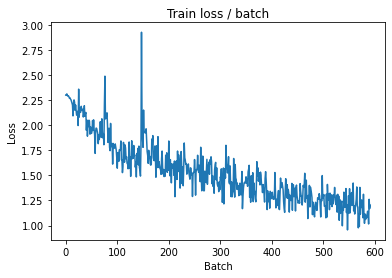


===============> Total time 17s	Avg loss 1.2037	Avg Prec@1 57.55 %	Avg Prec@5 95.01 %

[EVAL Batch 000/079]	Time 0.168s (0.168s)	Loss 0.9588 (0.9588)	Prec@1  65.6 ( 65.6)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 1.0123	Avg Prec@1 65.02 %	Avg Prec@5 96.51 %



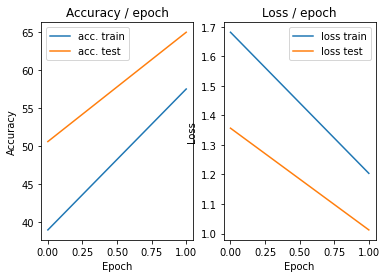

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.205s (0.205s)	Loss 1.0802 (1.0802)	Prec@1  60.2 ( 60.2)	Prec@5  96.9 ( 96.9)


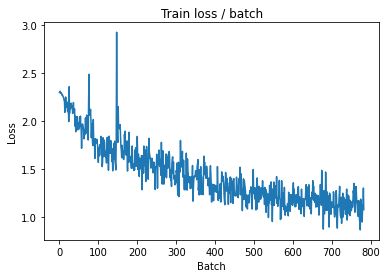

[TRAIN Batch 200/391]	Time 0.012s (0.045s)	Loss 1.0758 (1.0368)	Prec@1  64.1 ( 64.2)	Prec@5  95.3 ( 96.3)


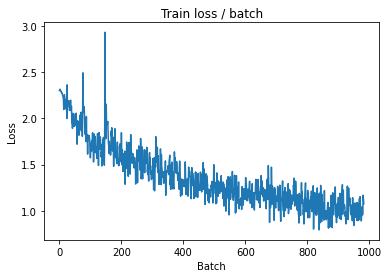


===============> Total time 17s	Avg loss 1.0079	Avg Prec@1 65.04 %	Avg Prec@5 96.47 %

[EVAL Batch 000/079]	Time 0.173s (0.173s)	Loss 0.7840 (0.7840)	Prec@1  75.0 ( 75.0)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.8989	Avg Prec@1 69.43 %	Avg Prec@5 97.43 %



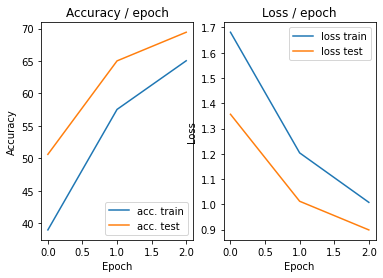

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.203s (0.203s)	Loss 0.7860 (0.7860)	Prec@1  68.8 ( 68.8)	Prec@5 100.0 (100.0)


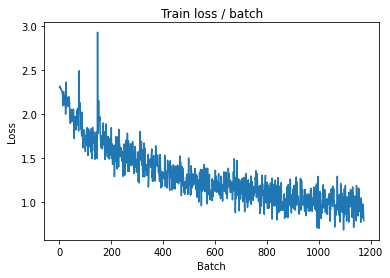

[TRAIN Batch 200/391]	Time 0.086s (0.045s)	Loss 0.8169 (0.9128)	Prec@1  68.8 ( 68.5)	Prec@5  98.4 ( 97.3)


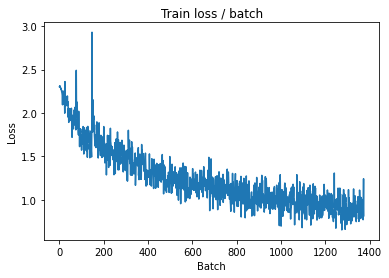


===============> Total time 17s	Avg loss 0.9068	Avg Prec@1 68.75 %	Avg Prec@5 97.20 %

[EVAL Batch 000/079]	Time 0.165s (0.165s)	Loss 0.6863 (0.6863)	Prec@1  75.8 ( 75.8)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.8344	Avg Prec@1 71.45 %	Avg Prec@5 97.54 %



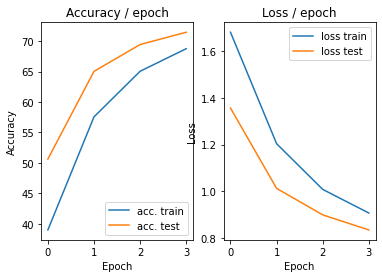

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.203s (0.203s)	Loss 0.7923 (0.7923)	Prec@1  71.9 ( 71.9)	Prec@5  99.2 ( 99.2)


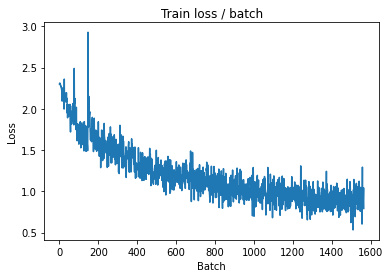

[TRAIN Batch 200/391]	Time 0.014s (0.045s)	Loss 0.7816 (0.8180)	Prec@1  78.1 ( 71.6)	Prec@5  96.9 ( 97.9)


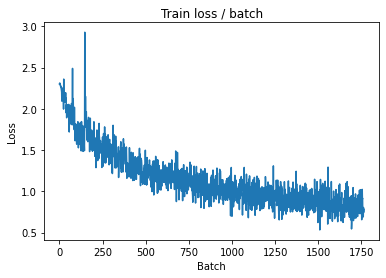


===============> Total time 17s	Avg loss 0.8224	Avg Prec@1 71.32 %	Avg Prec@5 97.71 %

[EVAL Batch 000/079]	Time 0.171s (0.171s)	Loss 0.7650 (0.7650)	Prec@1  79.7 ( 79.7)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 0.8393	Avg Prec@1 71.61 %	Avg Prec@5 97.43 %



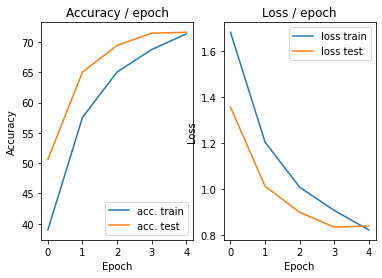

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.197s (0.197s)	Loss 0.8660 (0.8660)	Prec@1  68.0 ( 68.0)	Prec@5  96.9 ( 96.9)


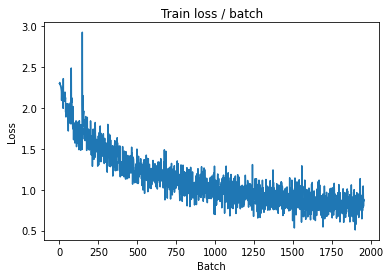

[TRAIN Batch 200/391]	Time 0.006s (0.045s)	Loss 0.7323 (0.7637)	Prec@1  75.0 ( 73.6)	Prec@5  98.4 ( 97.9)


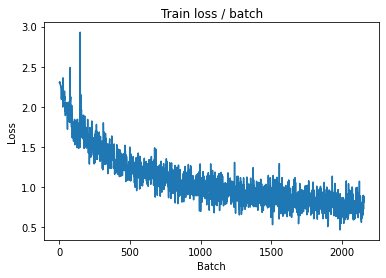


===============> Total time 17s	Avg loss 0.7647	Avg Prec@1 73.76 %	Avg Prec@5 98.00 %

[EVAL Batch 000/079]	Time 0.163s (0.163s)	Loss 0.6777 (0.6777)	Prec@1  81.2 ( 81.2)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.7992	Avg Prec@1 72.81 %	Avg Prec@5 97.80 %



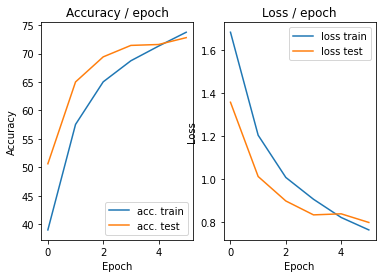

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.205s (0.205s)	Loss 0.6814 (0.6814)	Prec@1  75.0 ( 75.0)	Prec@5  96.1 ( 96.1)


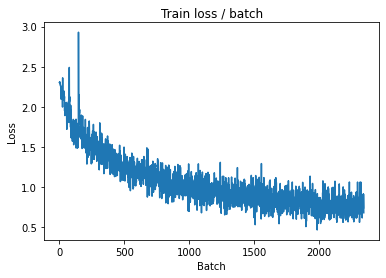

[TRAIN Batch 200/391]	Time 0.034s (0.045s)	Loss 0.8024 (0.7187)	Prec@1  68.8 ( 75.1)	Prec@5  96.9 ( 98.3)


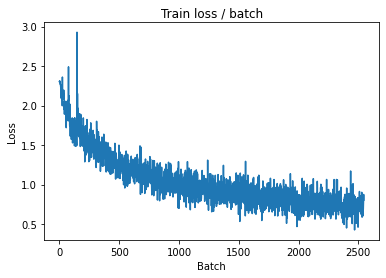


===============> Total time 17s	Avg loss 0.7250	Avg Prec@1 75.01 %	Avg Prec@5 98.17 %

[EVAL Batch 000/079]	Time 0.166s (0.166s)	Loss 0.5969 (0.5969)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.7349	Avg Prec@1 75.75 %	Avg Prec@5 98.13 %



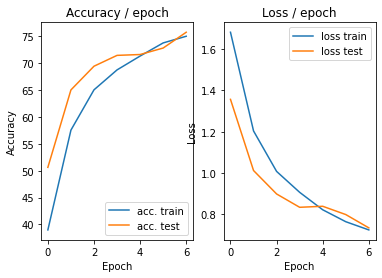

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.198s (0.198s)	Loss 0.7261 (0.7261)	Prec@1  72.7 ( 72.7)	Prec@5  99.2 ( 99.2)


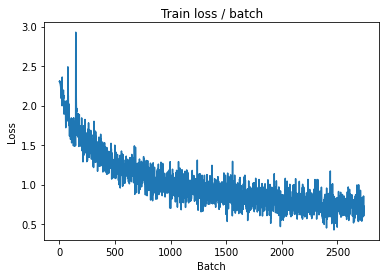

[TRAIN Batch 200/391]	Time 0.063s (0.045s)	Loss 0.5462 (0.6785)	Prec@1  82.0 ( 76.5)	Prec@5  98.4 ( 98.5)


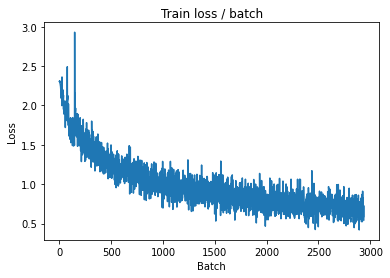


===============> Total time 17s	Avg loss 0.6822	Avg Prec@1 76.44 %	Avg Prec@5 98.48 %

[EVAL Batch 000/079]	Time 0.168s (0.168s)	Loss 0.6122 (0.6122)	Prec@1  78.9 ( 78.9)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.7401	Avg Prec@1 75.86 %	Avg Prec@5 98.23 %



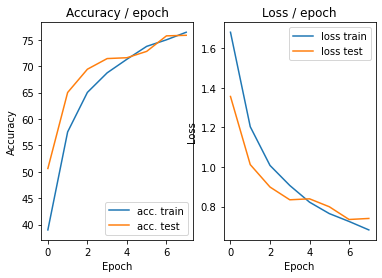

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.194s (0.194s)	Loss 0.6359 (0.6359)	Prec@1  81.2 ( 81.2)	Prec@5  98.4 ( 98.4)


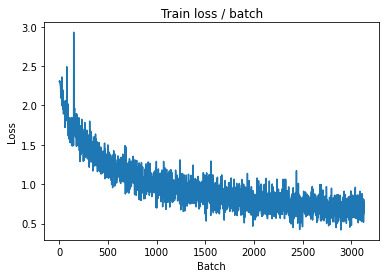

[TRAIN Batch 200/391]	Time 0.030s (0.046s)	Loss 0.6358 (0.6367)	Prec@1  73.4 ( 77.9)	Prec@5  97.7 ( 98.6)


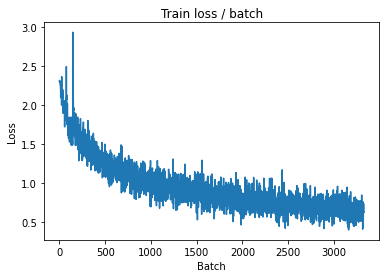


===============> Total time 17s	Avg loss 0.6434	Avg Prec@1 77.74 %	Avg Prec@5 98.56 %

[EVAL Batch 000/079]	Time 0.157s (0.157s)	Loss 0.5521 (0.5521)	Prec@1  83.6 ( 83.6)	Prec@5 100.0 (100.0)

===============> Total time 2s	Avg loss 0.6963	Avg Prec@1 76.66 %	Avg Prec@5 98.50 %



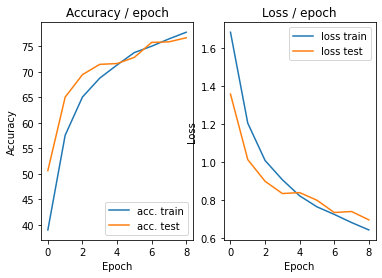

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.205s (0.205s)	Loss 0.5235 (0.5235)	Prec@1  81.2 ( 81.2)	Prec@5  99.2 ( 99.2)


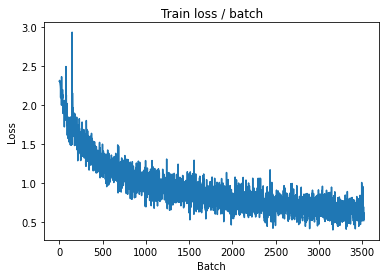

[TRAIN Batch 200/391]	Time 0.059s (0.045s)	Loss 0.7763 (0.6080)	Prec@1  71.9 ( 79.2)	Prec@5  96.1 ( 98.7)


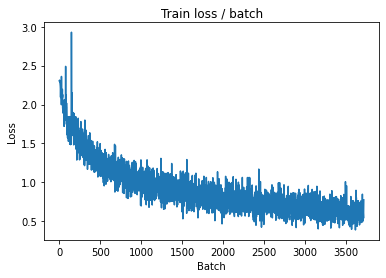


===============> Total time 17s	Avg loss 0.6070	Avg Prec@1 78.99 %	Avg Prec@5 98.77 %

[EVAL Batch 000/079]	Time 0.167s (0.167s)	Loss 0.6930 (0.6930)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.7160	Avg Prec@1 77.05 %	Avg Prec@5 98.30 %



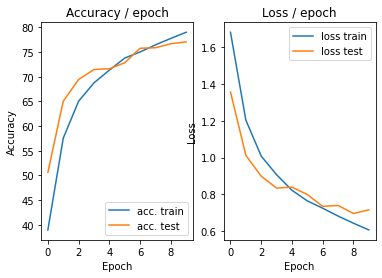

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.199s (0.199s)	Loss 0.5678 (0.5678)	Prec@1  81.2 ( 81.2)	Prec@5  99.2 ( 99.2)


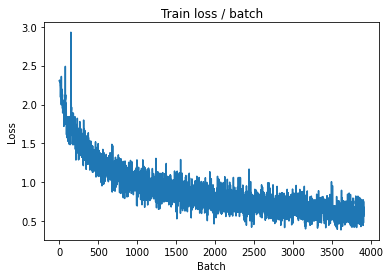

[TRAIN Batch 200/391]	Time 0.006s (0.045s)	Loss 0.5643 (0.5820)	Prec@1  78.9 ( 79.9)	Prec@5  97.7 ( 98.9)


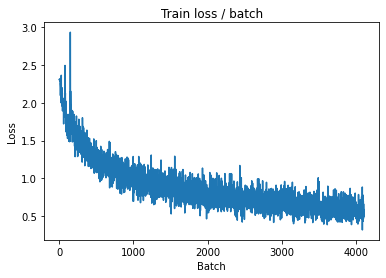


===============> Total time 17s	Avg loss 0.5814	Avg Prec@1 80.02 %	Avg Prec@5 98.88 %

[EVAL Batch 000/079]	Time 0.182s (0.182s)	Loss 0.5142 (0.5142)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6756	Avg Prec@1 77.49 %	Avg Prec@5 98.60 %



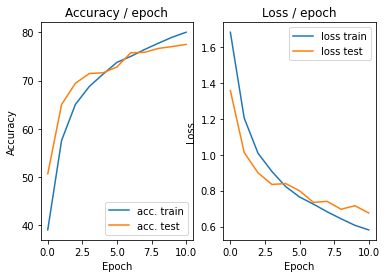

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.200s (0.200s)	Loss 0.4641 (0.4641)	Prec@1  82.0 ( 82.0)	Prec@5 100.0 (100.0)


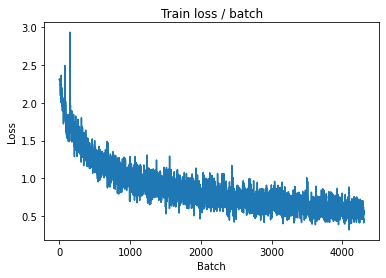

[TRAIN Batch 200/391]	Time 0.047s (0.046s)	Loss 0.6184 (0.5336)	Prec@1  78.9 ( 81.6)	Prec@5  96.9 ( 99.1)


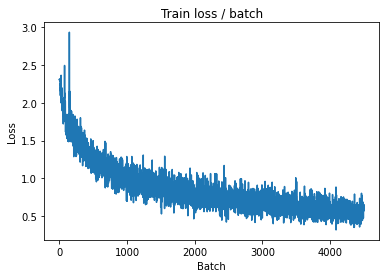


===============> Total time 17s	Avg loss 0.5462	Avg Prec@1 81.13 %	Avg Prec@5 99.04 %

[EVAL Batch 000/079]	Time 0.167s (0.167s)	Loss 0.5769 (0.5769)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.7030	Avg Prec@1 77.13 %	Avg Prec@5 97.95 %



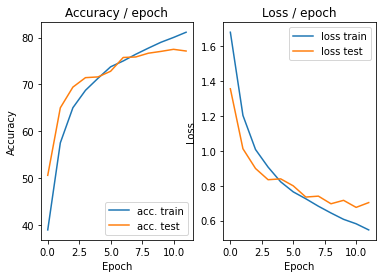

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.204s (0.204s)	Loss 0.5325 (0.5325)	Prec@1  78.9 ( 78.9)	Prec@5  99.2 ( 99.2)


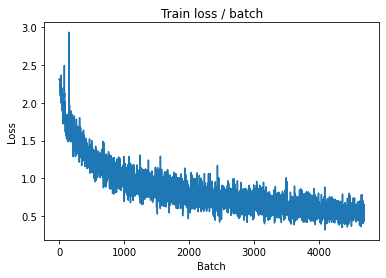

[TRAIN Batch 200/391]	Time 0.009s (0.046s)	Loss 0.4976 (0.5042)	Prec@1  81.2 ( 82.6)	Prec@5 100.0 ( 99.2)


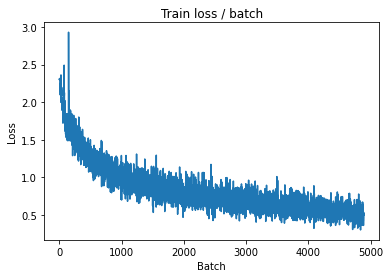


===============> Total time 17s	Avg loss 0.5199	Avg Prec@1 82.07 %	Avg Prec@5 99.18 %

[EVAL Batch 000/079]	Time 0.164s (0.164s)	Loss 0.5893 (0.5893)	Prec@1  84.4 ( 84.4)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6513	Avg Prec@1 78.39 %	Avg Prec@5 98.50 %



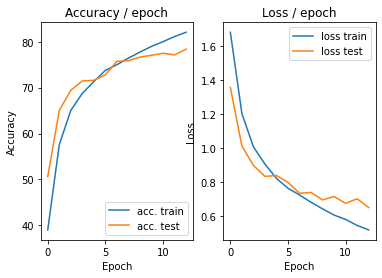

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.197s (0.197s)	Loss 0.4442 (0.4442)	Prec@1  82.8 ( 82.8)	Prec@5 100.0 (100.0)


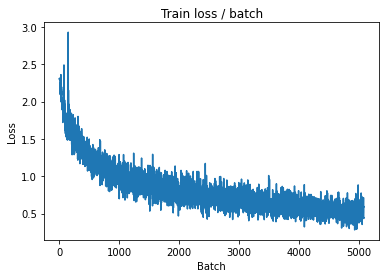

[TRAIN Batch 200/391]	Time 0.006s (0.045s)	Loss 0.4208 (0.4856)	Prec@1  85.2 ( 83.2)	Prec@5  99.2 ( 99.3)


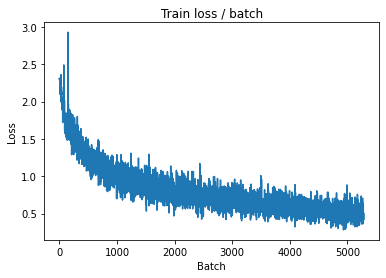


===============> Total time 17s	Avg loss 0.4902	Avg Prec@1 83.15 %	Avg Prec@5 99.27 %

[EVAL Batch 000/079]	Time 0.160s (0.160s)	Loss 0.4903 (0.4903)	Prec@1  84.4 ( 84.4)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6775	Avg Prec@1 78.81 %	Avg Prec@5 98.60 %



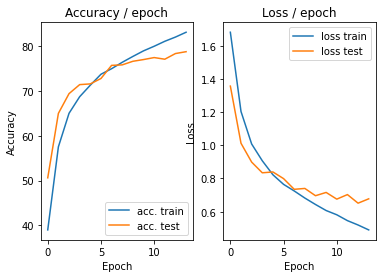

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.196s (0.196s)	Loss 0.3258 (0.3258)	Prec@1  88.3 ( 88.3)	Prec@5  98.4 ( 98.4)


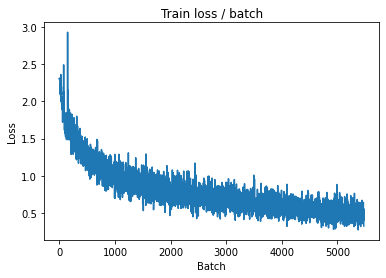

[TRAIN Batch 200/391]	Time 0.031s (0.045s)	Loss 0.4764 (0.4570)	Prec@1  83.6 ( 84.2)	Prec@5  99.2 ( 99.4)


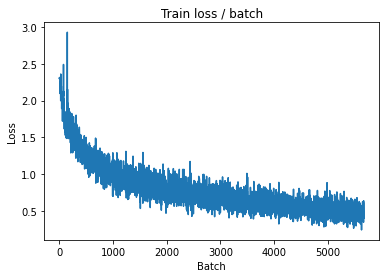


===============> Total time 17s	Avg loss 0.4741	Avg Prec@1 83.50 %	Avg Prec@5 99.31 %

[EVAL Batch 000/079]	Time 0.168s (0.168s)	Loss 0.5227 (0.5227)	Prec@1  83.6 ( 83.6)	Prec@5 100.0 (100.0)

===============> Total time 2s	Avg loss 0.6801	Avg Prec@1 78.60 %	Avg Prec@5 98.48 %



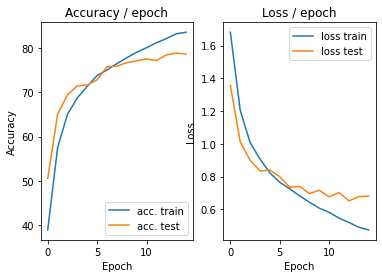

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.205s (0.205s)	Loss 0.4335 (0.4335)	Prec@1  85.2 ( 85.2)	Prec@5 100.0 (100.0)


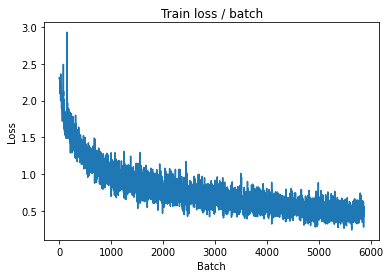

[TRAIN Batch 200/391]	Time 0.016s (0.045s)	Loss 0.5053 (0.4391)	Prec@1  82.8 ( 84.7)	Prec@5  99.2 ( 99.4)


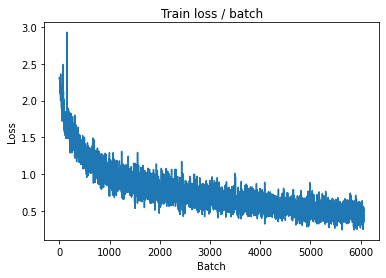


===============> Total time 17s	Avg loss 0.4503	Avg Prec@1 84.50 %	Avg Prec@5 99.41 %

[EVAL Batch 000/079]	Time 0.164s (0.164s)	Loss 0.5557 (0.5557)	Prec@1  87.5 ( 87.5)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.6655	Avg Prec@1 78.47 %	Avg Prec@5 98.46 %



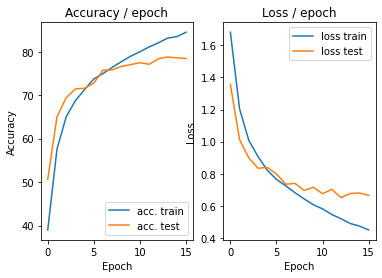

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.211s (0.211s)	Loss 0.3697 (0.3697)	Prec@1  88.3 ( 88.3)	Prec@5  99.2 ( 99.2)


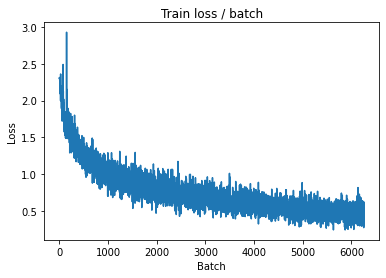

[TRAIN Batch 200/391]	Time 0.082s (0.046s)	Loss 0.4893 (0.4113)	Prec@1  84.4 ( 85.9)	Prec@5  99.2 ( 99.6)


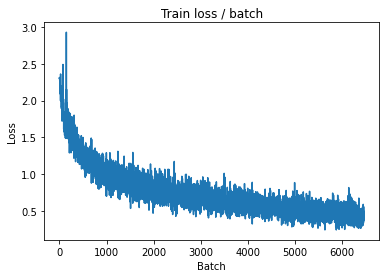


===============> Total time 18s	Avg loss 0.4162	Avg Prec@1 85.67 %	Avg Prec@5 99.52 %

[EVAL Batch 000/079]	Time 0.193s (0.193s)	Loss 0.5228 (0.5228)	Prec@1  85.2 ( 85.2)	Prec@5 100.0 (100.0)

===============> Total time 2s	Avg loss 0.6628	Avg Prec@1 78.87 %	Avg Prec@5 98.58 %



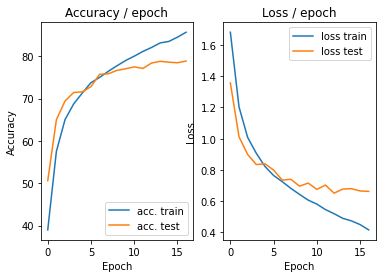

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.237s (0.237s)	Loss 0.4228 (0.4228)	Prec@1  85.9 ( 85.9)	Prec@5 100.0 (100.0)


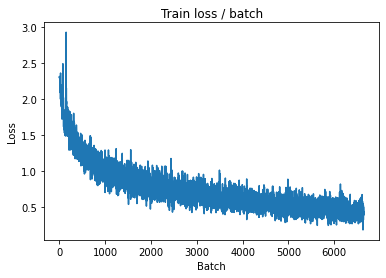

[TRAIN Batch 200/391]	Time 0.080s (0.048s)	Loss 0.4594 (0.3908)	Prec@1  82.8 ( 86.6)	Prec@5  99.2 ( 99.5)


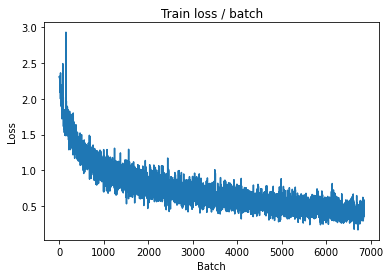


===============> Total time 18s	Avg loss 0.4014	Avg Prec@1 86.17 %	Avg Prec@5 99.53 %

[EVAL Batch 000/079]	Time 0.164s (0.164s)	Loss 0.5516 (0.5516)	Prec@1  84.4 ( 84.4)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6851	Avg Prec@1 78.98 %	Avg Prec@5 98.61 %



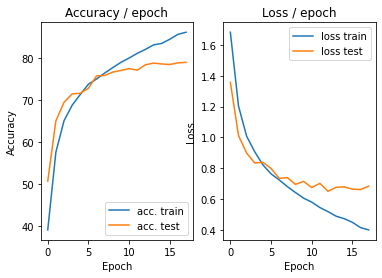

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.217s (0.217s)	Loss 0.3634 (0.3634)	Prec@1  86.7 ( 86.7)	Prec@5 100.0 (100.0)


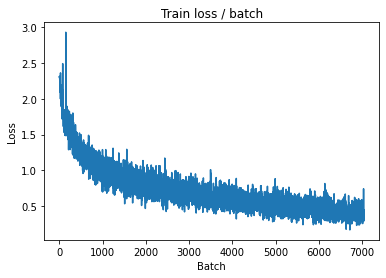

[TRAIN Batch 200/391]	Time 0.044s (0.045s)	Loss 0.3107 (0.3747)	Prec@1  88.3 ( 87.1)	Prec@5 100.0 ( 99.5)


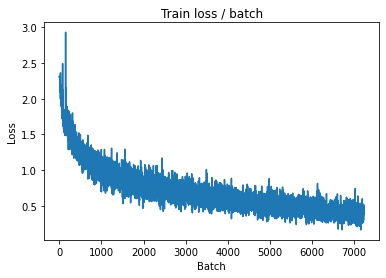


===============> Total time 17s	Avg loss 0.3774	Avg Prec@1 87.02 %	Avg Prec@5 99.56 %

[EVAL Batch 000/079]	Time 0.170s (0.170s)	Loss 0.4802 (0.4802)	Prec@1  89.1 ( 89.1)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.6949	Avg Prec@1 79.02 %	Avg Prec@5 98.53 %



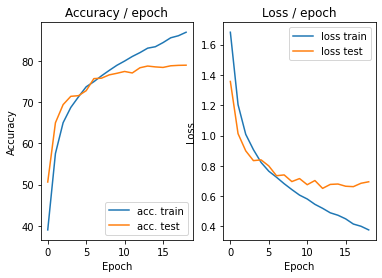

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.203s (0.203s)	Loss 0.3535 (0.3535)	Prec@1  85.9 ( 85.9)	Prec@5 100.0 (100.0)


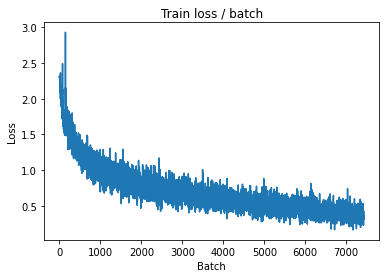

[TRAIN Batch 200/391]	Time 0.074s (0.045s)	Loss 0.4518 (0.3541)	Prec@1  85.9 ( 87.6)	Prec@5 100.0 ( 99.6)


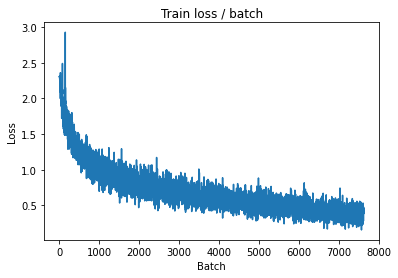


===============> Total time 17s	Avg loss 0.3582	Avg Prec@1 87.55 %	Avg Prec@5 99.63 %

[EVAL Batch 000/079]	Time 0.157s (0.157s)	Loss 0.4531 (0.4531)	Prec@1  86.7 ( 86.7)	Prec@5 100.0 (100.0)

===============> Total time 2s	Avg loss 0.6761	Avg Prec@1 80.24 %	Avg Prec@5 98.66 %



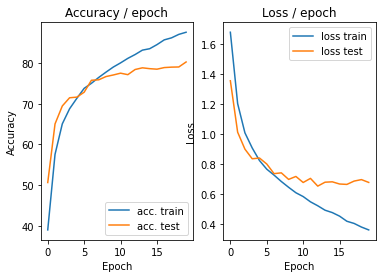

=== EPOCH 21 =====

[TRAIN Batch 000/391]	Time 0.206s (0.206s)	Loss 0.3340 (0.3340)	Prec@1  89.8 ( 89.8)	Prec@5  99.2 ( 99.2)


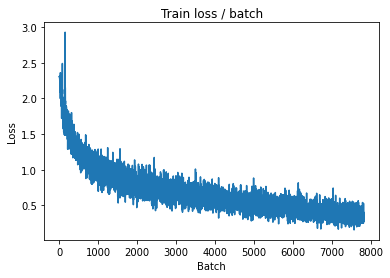

[TRAIN Batch 200/391]	Time 0.021s (0.046s)	Loss 0.3656 (0.3337)	Prec@1  89.1 ( 88.5)	Prec@5 100.0 ( 99.6)


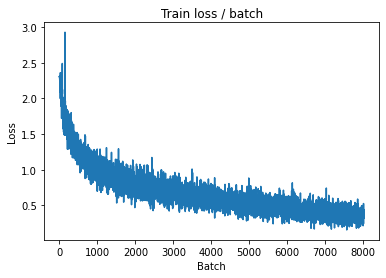


===============> Total time 17s	Avg loss 0.3422	Avg Prec@1 88.28 %	Avg Prec@5 99.63 %

[EVAL Batch 000/079]	Time 0.161s (0.161s)	Loss 0.5467 (0.5467)	Prec@1  85.9 ( 85.9)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.6608	Avg Prec@1 80.32 %	Avg Prec@5 98.66 %



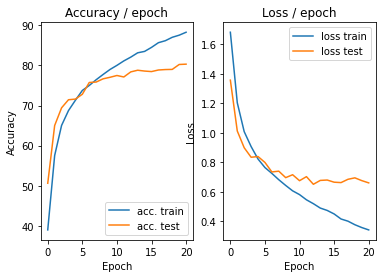

=== EPOCH 22 =====

[TRAIN Batch 000/391]	Time 0.205s (0.205s)	Loss 0.3582 (0.3582)	Prec@1  85.9 ( 85.9)	Prec@5 100.0 (100.0)


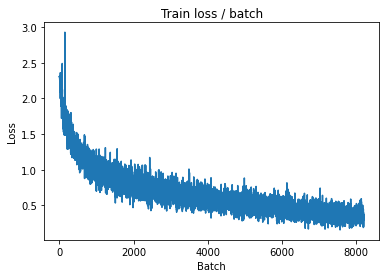

[TRAIN Batch 200/391]	Time 0.075s (0.045s)	Loss 0.2362 (0.3207)	Prec@1  91.4 ( 88.7)	Prec@5 100.0 ( 99.7)


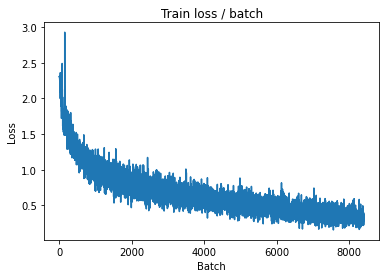


===============> Total time 17s	Avg loss 0.3233	Avg Prec@1 88.66 %	Avg Prec@5 99.72 %

[EVAL Batch 000/079]	Time 0.161s (0.161s)	Loss 0.4885 (0.4885)	Prec@1  85.2 ( 85.2)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.6653	Avg Prec@1 80.59 %	Avg Prec@5 98.72 %



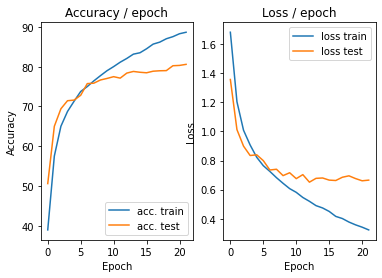

=== EPOCH 23 =====

[TRAIN Batch 000/391]	Time 0.211s (0.211s)	Loss 0.3029 (0.3029)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 (100.0)


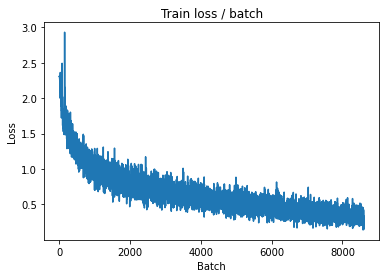

[TRAIN Batch 200/391]	Time 0.011s (0.045s)	Loss 0.2264 (0.3016)	Prec@1  95.3 ( 89.7)	Prec@5 100.0 ( 99.8)


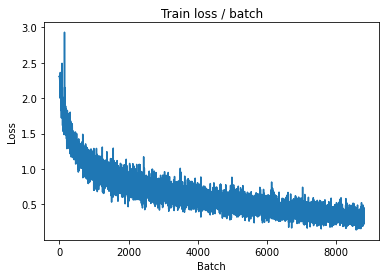


===============> Total time 17s	Avg loss 0.3052	Avg Prec@1 89.52 %	Avg Prec@5 99.75 %

[EVAL Batch 000/079]	Time 0.167s (0.167s)	Loss 0.5091 (0.5091)	Prec@1  85.9 ( 85.9)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6801	Avg Prec@1 80.76 %	Avg Prec@5 98.70 %



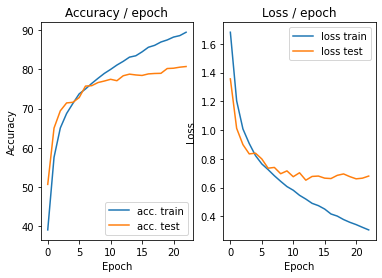

=== EPOCH 24 =====

[TRAIN Batch 000/391]	Time 0.199s (0.199s)	Loss 0.2031 (0.2031)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


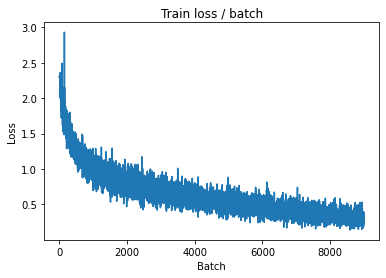

[TRAIN Batch 200/391]	Time 0.018s (0.045s)	Loss 0.2561 (0.2821)	Prec@1  90.6 ( 90.4)	Prec@5 100.0 ( 99.7)


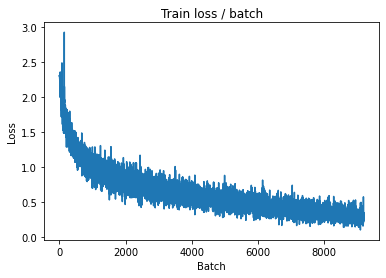


===============> Total time 17s	Avg loss 0.2869	Avg Prec@1 90.17 %	Avg Prec@5 99.76 %

[EVAL Batch 000/079]	Time 0.166s (0.166s)	Loss 0.3526 (0.3526)	Prec@1  88.3 ( 88.3)	Prec@5 100.0 (100.0)

===============> Total time 2s	Avg loss 0.6831	Avg Prec@1 80.12 %	Avg Prec@5 98.65 %



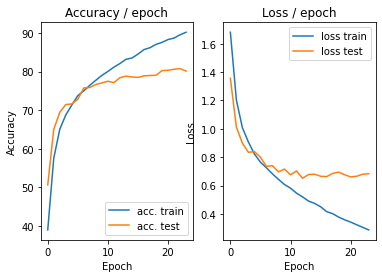

=== EPOCH 25 =====

[TRAIN Batch 000/391]	Time 0.211s (0.211s)	Loss 0.1992 (0.1992)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


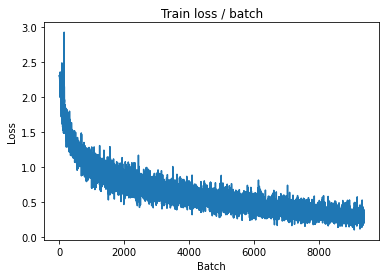

[TRAIN Batch 200/391]	Time 0.095s (0.046s)	Loss 0.2510 (0.2562)	Prec@1  92.2 ( 90.9)	Prec@5 100.0 ( 99.9)


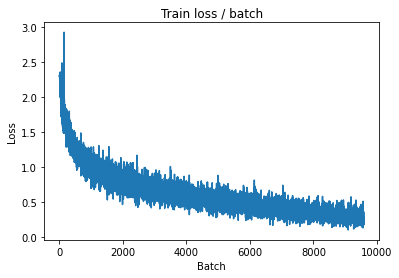


===============> Total time 17s	Avg loss 0.2595	Avg Prec@1 90.91 %	Avg Prec@5 99.82 %

[EVAL Batch 000/079]	Time 0.163s (0.163s)	Loss 0.3960 (0.3960)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 (100.0)

===============> Total time 2s	Avg loss 0.7000	Avg Prec@1 80.84 %	Avg Prec@5 98.76 %



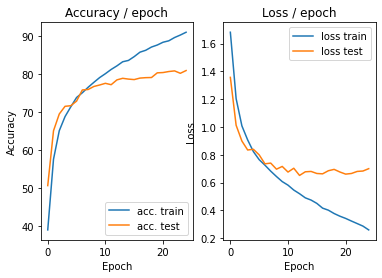

=== EPOCH 26 =====

[TRAIN Batch 000/391]	Time 0.207s (0.207s)	Loss 0.3335 (0.3335)	Prec@1  89.8 ( 89.8)	Prec@5 100.0 (100.0)


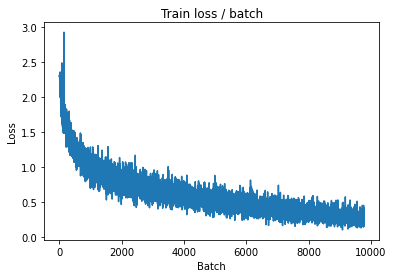

[TRAIN Batch 200/391]	Time 0.031s (0.045s)	Loss 0.2126 (0.2397)	Prec@1  94.5 ( 91.7)	Prec@5 100.0 ( 99.9)


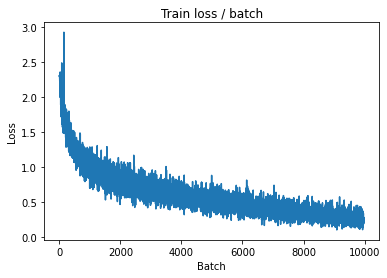


===============> Total time 17s	Avg loss 0.2508	Avg Prec@1 91.32 %	Avg Prec@5 99.86 %

[EVAL Batch 000/079]	Time 0.169s (0.169s)	Loss 0.4082 (0.4082)	Prec@1  89.1 ( 89.1)	Prec@5 100.0 (100.0)

===============> Total time 2s	Avg loss 0.6866	Avg Prec@1 80.98 %	Avg Prec@5 98.62 %



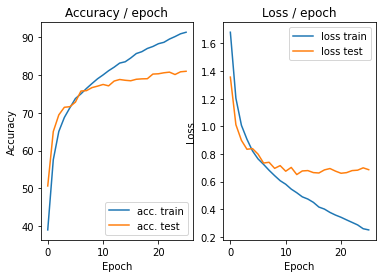

=== EPOCH 27 =====

[TRAIN Batch 000/391]	Time 0.216s (0.216s)	Loss 0.2594 (0.2594)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 (100.0)


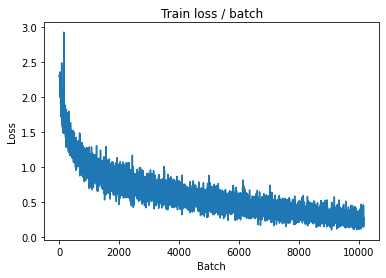

[TRAIN Batch 200/391]	Time 0.012s (0.047s)	Loss 0.2262 (0.2327)	Prec@1  89.8 ( 91.7)	Prec@5 100.0 ( 99.9)


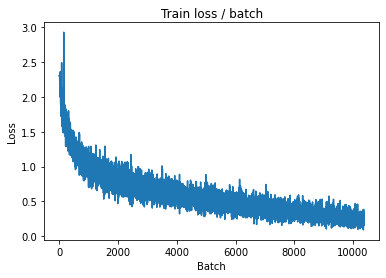


===============> Total time 17s	Avg loss 0.2392	Avg Prec@1 91.60 %	Avg Prec@5 99.85 %

[EVAL Batch 000/079]	Time 0.166s (0.166s)	Loss 0.4248 (0.4248)	Prec@1  87.5 ( 87.5)	Prec@5 100.0 (100.0)

===============> Total time 2s	Avg loss 0.7061	Avg Prec@1 80.89 %	Avg Prec@5 98.66 %



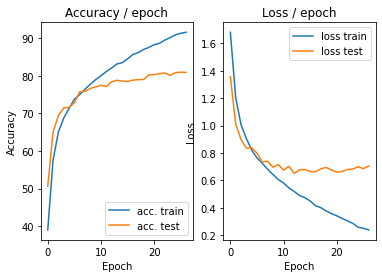

=== EPOCH 28 =====

[TRAIN Batch 000/391]	Time 0.208s (0.208s)	Loss 0.1582 (0.1582)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 (100.0)


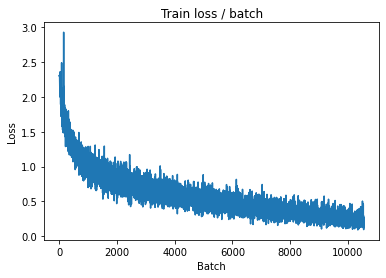

[TRAIN Batch 200/391]	Time 0.066s (0.045s)	Loss 0.1335 (0.2196)	Prec@1  94.5 ( 92.4)	Prec@5 100.0 ( 99.9)


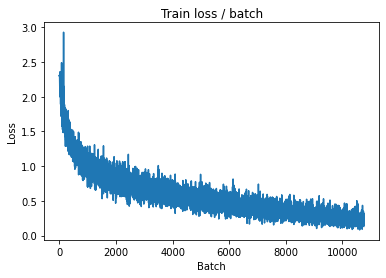


===============> Total time 17s	Avg loss 0.2295	Avg Prec@1 92.01 %	Avg Prec@5 99.87 %

[EVAL Batch 000/079]	Time 0.164s (0.164s)	Loss 0.4070 (0.4070)	Prec@1  86.7 ( 86.7)	Prec@5 100.0 (100.0)

===============> Total time 2s	Avg loss 0.7203	Avg Prec@1 81.07 %	Avg Prec@5 98.77 %



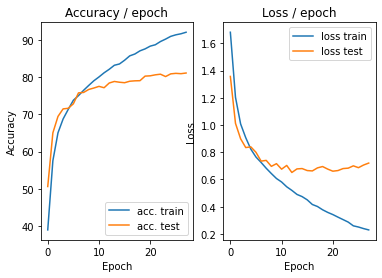

=== EPOCH 29 =====

[TRAIN Batch 000/391]	Time 0.201s (0.201s)	Loss 0.1598 (0.1598)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


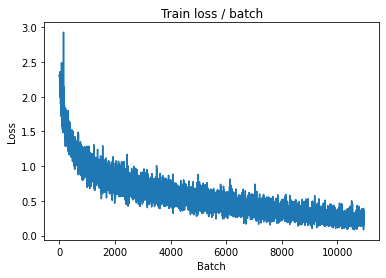

[TRAIN Batch 200/391]	Time 0.012s (0.046s)	Loss 0.2021 (0.2082)	Prec@1  91.4 ( 92.8)	Prec@5 100.0 ( 99.9)


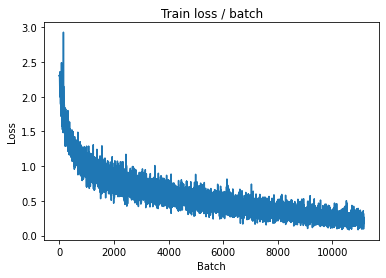


===============> Total time 17s	Avg loss 0.2084	Avg Prec@1 92.80 %	Avg Prec@5 99.91 %

[EVAL Batch 000/079]	Time 0.175s (0.175s)	Loss 0.4032 (0.4032)	Prec@1  85.9 ( 85.9)	Prec@5 100.0 (100.0)

===============> Total time 2s	Avg loss 0.7099	Avg Prec@1 81.05 %	Avg Prec@5 98.66 %



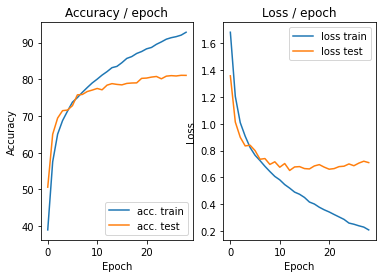

=== EPOCH 30 =====

[TRAIN Batch 000/391]	Time 0.195s (0.195s)	Loss 0.1664 (0.1664)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


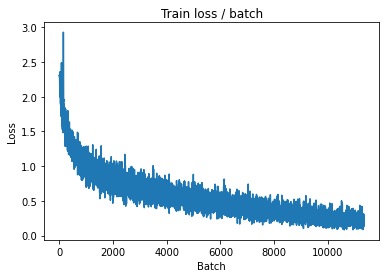

[TRAIN Batch 200/391]	Time 0.026s (0.045s)	Loss 0.1498 (0.1937)	Prec@1  94.5 ( 93.3)	Prec@5 100.0 ( 99.9)


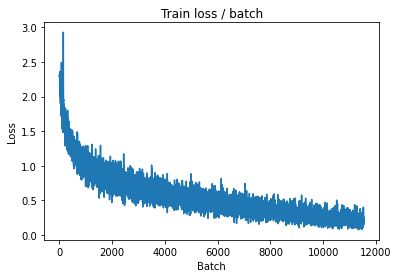


===============> Total time 17s	Avg loss 0.1990	Avg Prec@1 93.06 %	Avg Prec@5 99.91 %

[EVAL Batch 000/079]	Time 0.174s (0.174s)	Loss 0.5076 (0.5076)	Prec@1  85.2 ( 85.2)	Prec@5 100.0 (100.0)

===============> Total time 2s	Avg loss 0.7188	Avg Prec@1 80.86 %	Avg Prec@5 98.84 %



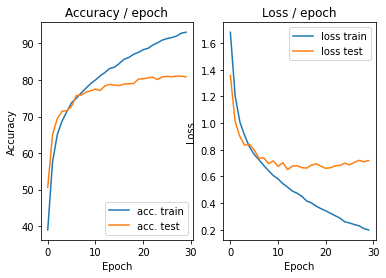

=== EPOCH 31 =====

[TRAIN Batch 000/391]	Time 0.203s (0.203s)	Loss 0.2688 (0.2688)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)


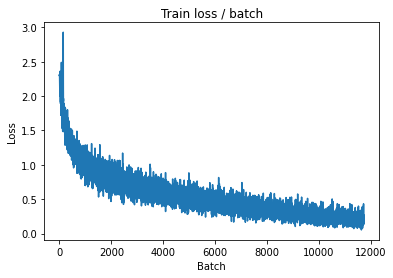

[TRAIN Batch 200/391]	Time 0.060s (0.046s)	Loss 0.1468 (0.1794)	Prec@1  96.1 ( 93.8)	Prec@5  99.2 ( 99.9)


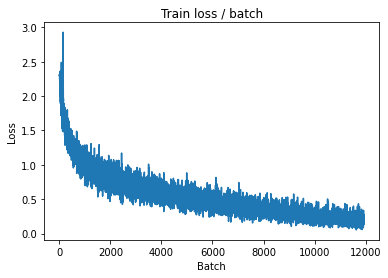


===============> Total time 17s	Avg loss 0.1833	Avg Prec@1 93.68 %	Avg Prec@5 99.92 %

[EVAL Batch 000/079]	Time 0.165s (0.165s)	Loss 0.5560 (0.5560)	Prec@1  85.2 ( 85.2)	Prec@5 100.0 (100.0)

===============> Total time 2s	Avg loss 0.7438	Avg Prec@1 81.37 %	Avg Prec@5 98.69 %



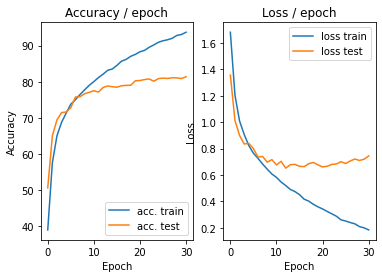

=== EPOCH 32 =====

[TRAIN Batch 000/391]	Time 0.197s (0.197s)	Loss 0.1145 (0.1145)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


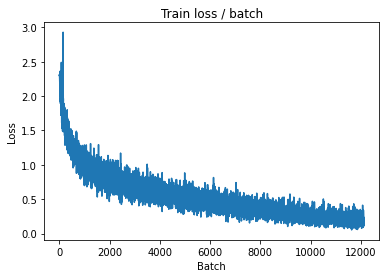

[TRAIN Batch 200/391]	Time 0.074s (0.045s)	Loss 0.1461 (0.1770)	Prec@1  96.1 ( 94.1)	Prec@5 100.0 ( 99.9)


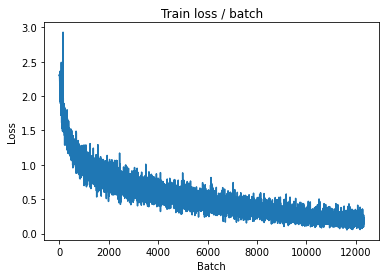


===============> Total time 17s	Avg loss 0.1774	Avg Prec@1 93.96 %	Avg Prec@5 99.93 %

[EVAL Batch 000/079]	Time 0.168s (0.168s)	Loss 0.5472 (0.5472)	Prec@1  89.1 ( 89.1)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.7538	Avg Prec@1 81.32 %	Avg Prec@5 98.54 %



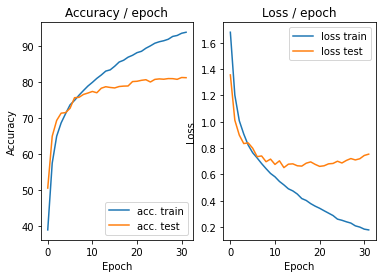

=== EPOCH 33 =====

[TRAIN Batch 000/391]	Time 0.207s (0.207s)	Loss 0.1487 (0.1487)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)


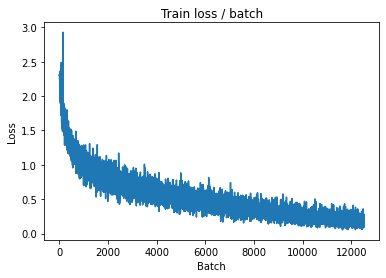

[TRAIN Batch 200/391]	Time 0.069s (0.046s)	Loss 0.1933 (0.1611)	Prec@1  94.5 ( 94.4)	Prec@5 100.0 (100.0)


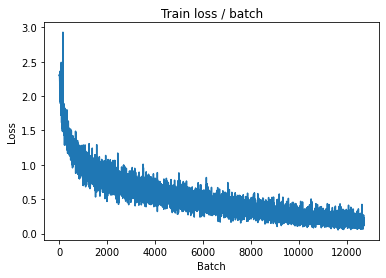


===============> Total time 17s	Avg loss 0.1656	Avg Prec@1 94.25 %	Avg Prec@5 99.95 %

[EVAL Batch 000/079]	Time 0.170s (0.170s)	Loss 0.5556 (0.5556)	Prec@1  86.7 ( 86.7)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.7514	Avg Prec@1 81.62 %	Avg Prec@5 98.83 %



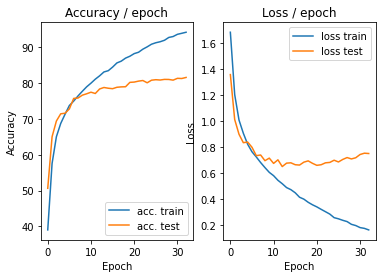

=== EPOCH 34 =====

[TRAIN Batch 000/391]	Time 0.194s (0.194s)	Loss 0.0863 (0.0863)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


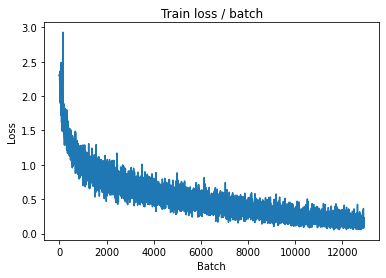

[TRAIN Batch 200/391]	Time 0.006s (0.045s)	Loss 0.2680 (0.1485)	Prec@1  93.8 ( 94.8)	Prec@5 100.0 (100.0)


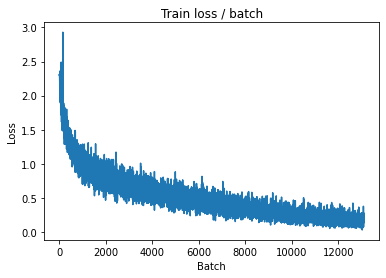


===============> Total time 17s	Avg loss 0.1552	Avg Prec@1 94.58 %	Avg Prec@5 99.95 %

[EVAL Batch 000/079]	Time 0.158s (0.158s)	Loss 0.5685 (0.5685)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.7548	Avg Prec@1 81.61 %	Avg Prec@5 98.84 %



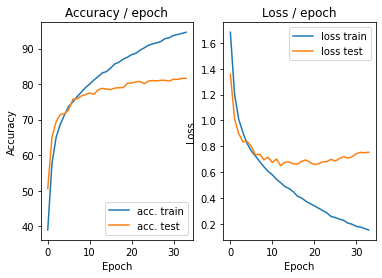

=== EPOCH 35 =====

[TRAIN Batch 000/391]	Time 0.195s (0.195s)	Loss 0.2014 (0.2014)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)


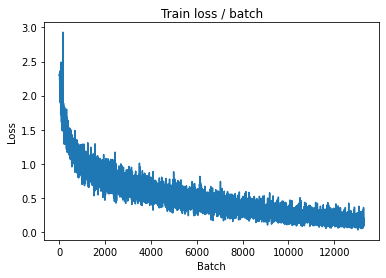

[TRAIN Batch 200/391]	Time 0.084s (0.046s)	Loss 0.1315 (0.1424)	Prec@1  96.1 ( 95.0)	Prec@5  99.2 ( 99.9)


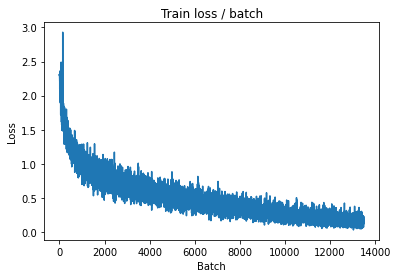


===============> Total time 17s	Avg loss 0.1448	Avg Prec@1 94.91 %	Avg Prec@5 99.95 %

[EVAL Batch 000/079]	Time 0.172s (0.172s)	Loss 0.5826 (0.5826)	Prec@1  86.7 ( 86.7)	Prec@5 100.0 (100.0)

===============> Total time 2s	Avg loss 0.7573	Avg Prec@1 81.60 %	Avg Prec@5 98.69 %



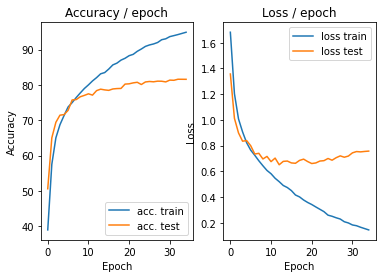

=== EPOCH 36 =====

[TRAIN Batch 000/391]	Time 0.202s (0.202s)	Loss 0.0641 (0.0641)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


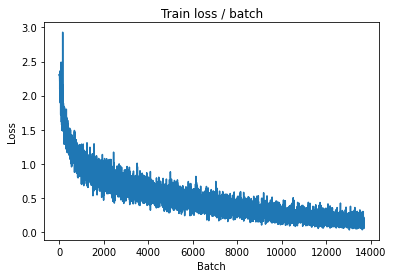

[TRAIN Batch 200/391]	Time 0.006s (0.046s)	Loss 0.1158 (0.1319)	Prec@1  96.1 ( 95.7)	Prec@5 100.0 ( 99.9)


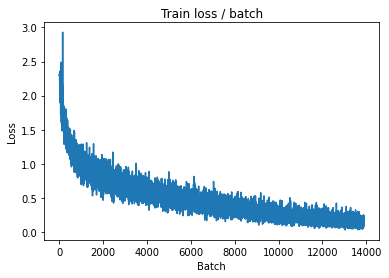


===============> Total time 17s	Avg loss 0.1387	Avg Prec@1 95.37 %	Avg Prec@5 99.95 %

[EVAL Batch 000/079]	Time 0.160s (0.160s)	Loss 0.5255 (0.5255)	Prec@1  86.7 ( 86.7)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.7562	Avg Prec@1 81.50 %	Avg Prec@5 98.73 %



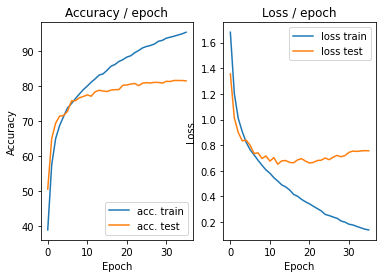

=== EPOCH 37 =====

[TRAIN Batch 000/391]	Time 0.209s (0.209s)	Loss 0.1442 (0.1442)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


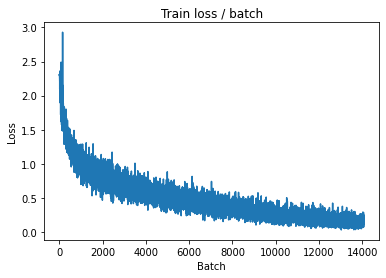

[TRAIN Batch 200/391]	Time 0.051s (0.047s)	Loss 0.1959 (0.1236)	Prec@1  96.9 ( 95.7)	Prec@5 100.0 (100.0)


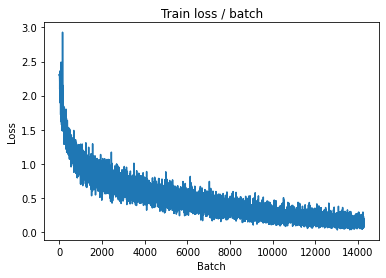


===============> Total time 17s	Avg loss 0.1274	Avg Prec@1 95.57 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.163s (0.163s)	Loss 0.4901 (0.4901)	Prec@1  89.1 ( 89.1)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.7777	Avg Prec@1 81.61 %	Avg Prec@5 98.76 %



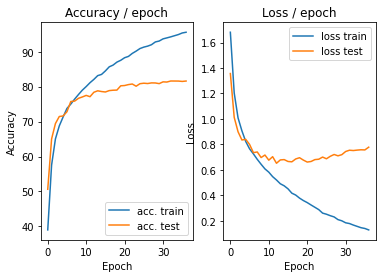

=== EPOCH 38 =====

[TRAIN Batch 000/391]	Time 0.221s (0.221s)	Loss 0.1184 (0.1184)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


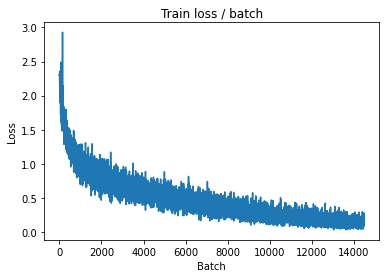

[TRAIN Batch 200/391]	Time 0.080s (0.045s)	Loss 0.0603 (0.1180)	Prec@1  97.7 ( 96.0)	Prec@5 100.0 (100.0)


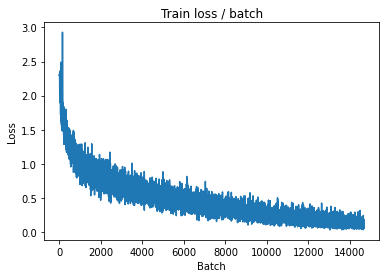


===============> Total time 17s	Avg loss 0.1208	Avg Prec@1 95.89 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.164s (0.164s)	Loss 0.5952 (0.5952)	Prec@1  88.3 ( 88.3)	Prec@5 100.0 (100.0)

===============> Total time 2s	Avg loss 0.8023	Avg Prec@1 82.01 %	Avg Prec@5 98.80 %



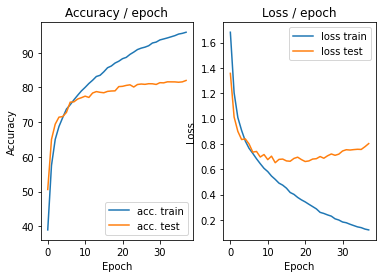

=== EPOCH 39 =====

[TRAIN Batch 000/391]	Time 0.212s (0.212s)	Loss 0.2124 (0.2124)	Prec@1  96.1 ( 96.1)	Prec@5  99.2 ( 99.2)


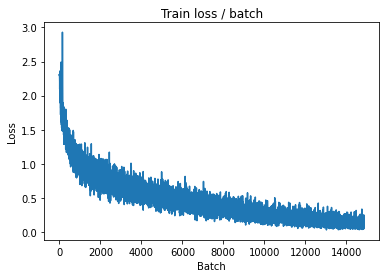

[TRAIN Batch 200/391]	Time 0.023s (0.046s)	Loss 0.0768 (0.1190)	Prec@1  96.9 ( 96.0)	Prec@5 100.0 (100.0)


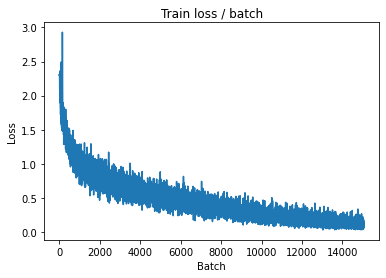


===============> Total time 17s	Avg loss 0.1150	Avg Prec@1 96.10 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.171s (0.171s)	Loss 0.5157 (0.5157)	Prec@1  87.5 ( 87.5)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.7784	Avg Prec@1 82.09 %	Avg Prec@5 98.89 %



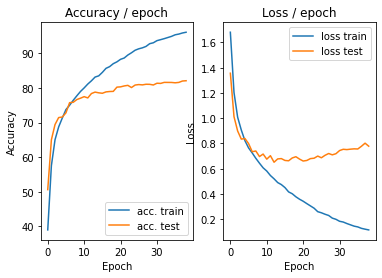

=== EPOCH 40 =====

[TRAIN Batch 000/391]	Time 0.211s (0.211s)	Loss 0.1284 (0.1284)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


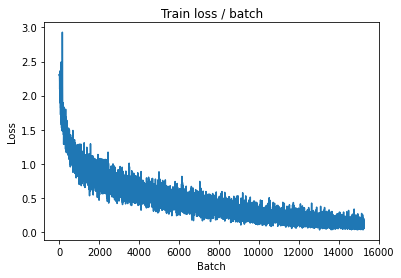

[TRAIN Batch 200/391]	Time 0.065s (0.046s)	Loss 0.1607 (0.0980)	Prec@1  96.1 ( 96.5)	Prec@5 100.0 (100.0)


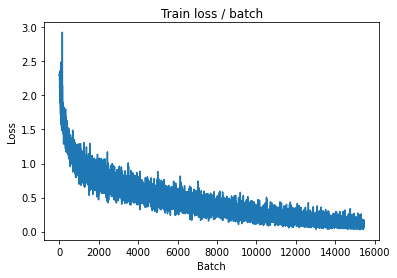


===============> Total time 17s	Avg loss 0.1017	Avg Prec@1 96.48 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.173s (0.173s)	Loss 0.5809 (0.5809)	Prec@1  87.5 ( 87.5)	Prec@5 100.0 (100.0)

===============> Total time 2s	Avg loss 0.8325	Avg Prec@1 82.26 %	Avg Prec@5 98.86 %



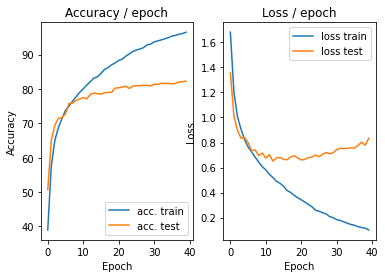

=== EPOCH 41 =====

[TRAIN Batch 000/391]	Time 0.195s (0.195s)	Loss 0.0802 (0.0802)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)


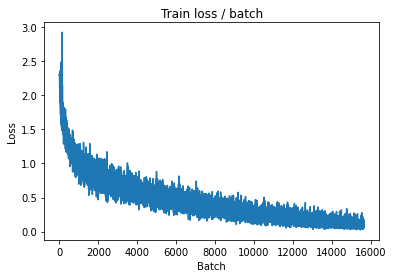

[TRAIN Batch 200/391]	Time 0.087s (0.046s)	Loss 0.0519 (0.0956)	Prec@1  98.4 ( 96.8)	Prec@5 100.0 (100.0)


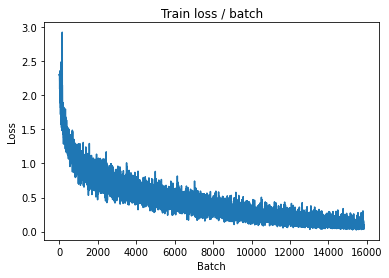


===============> Total time 17s	Avg loss 0.1004	Avg Prec@1 96.61 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.163s (0.163s)	Loss 0.4629 (0.4629)	Prec@1  89.1 ( 89.1)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.8125	Avg Prec@1 82.38 %	Avg Prec@5 98.90 %



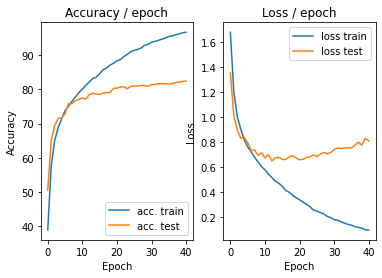

=== EPOCH 42 =====

[TRAIN Batch 000/391]	Time 0.200s (0.200s)	Loss 0.1328 (0.1328)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)


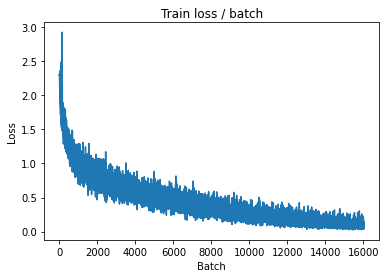

[TRAIN Batch 200/391]	Time 0.006s (0.046s)	Loss 0.1661 (0.0959)	Prec@1  94.5 ( 96.7)	Prec@5 100.0 (100.0)


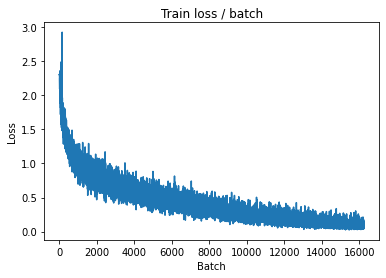


===============> Total time 17s	Avg loss 0.0964	Avg Prec@1 96.75 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.172s (0.172s)	Loss 0.5873 (0.5873)	Prec@1  88.3 ( 88.3)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.8182	Avg Prec@1 82.51 %	Avg Prec@5 98.83 %



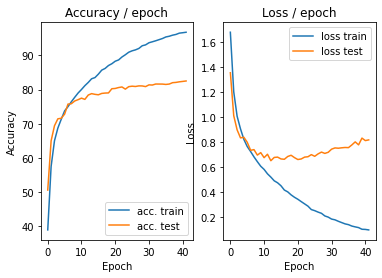

In [ ]:
main(batch_size=128,lr=0.1,epochs=42,cuda=True)

### Optimiseur ADAM

In [ ]:
def main(batch_size=128, lr=0.1, epochs=15, cuda=False, namebase=datasets.CIFAR10, print_results=True):

    # define model, loss, optim
    model = ConvNet()
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.Adam(model.parameters(), lr,amsgrad=True)

    # # Créer le scheduler
    # lr_sched = torch.optim.lr_scheduler.ExponentialLR(optimizer, gamma=0.95)

    if cuda: # si on fait du GPU, passage en CUDA
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # On récupère les données
    train, test = get_dataset(namebase, batch_size, cuda)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # On itère sur les epochs
    for i in range(epochs):
        if print_results:
            print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        # Phase de train
        top1_acc, top5_acc, loss, last_batch_time = epoch(train, model, criterion, optimizer, cuda, print_results)
        # Phase d'evaluation
        top1_acc_test, top5_acc_test, loss_test, last_batch_time_test = epoch(test, model, criterion, cuda=cuda, print_results=print_results)
        if print_results:
            # plot
            plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)
        
        # Modifier le learning rate après chaque epoch
        # lr_sched.step()

    if not print_results:
        return loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg, last_batch_time, last_batch_time_test

Files already downloaded and verified
Files already downloaded and verified
=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.282s (0.282s)	Loss 2.3012 (2.3012)	Prec@1   9.4 (  9.4)	Prec@5  51.6 ( 51.6)


<Figure size 432x288 with 0 Axes>

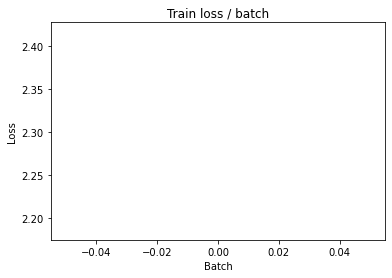

[TRAIN Batch 200/391]	Time 0.019s (0.043s)	Loss 1.4319 (1.6901)	Prec@1  48.4 ( 37.8)	Prec@5  91.4 ( 86.3)


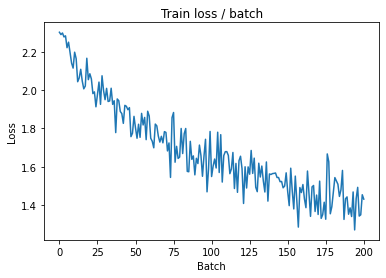


===============> Total time 16s	Avg loss 1.5167	Avg Prec@1 44.61 %	Avg Prec@5 90.02 %

[EVAL Batch 000/079]	Time 0.157s (0.157s)	Loss 1.1662 (1.1662)	Prec@1  61.7 ( 61.7)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.2117	Avg Prec@1 57.23 %	Avg Prec@5 94.93 %



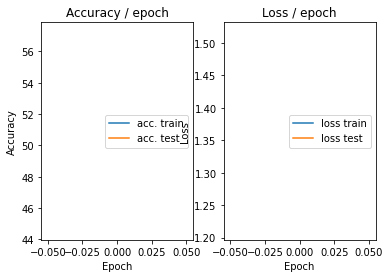

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.185s (0.185s)	Loss 1.3231 (1.3231)	Prec@1  51.6 ( 51.6)	Prec@5  94.5 ( 94.5)


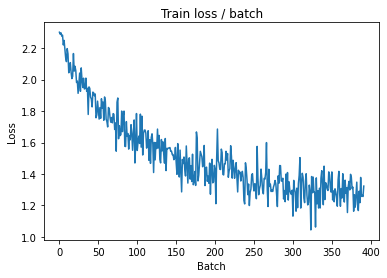

[TRAIN Batch 200/391]	Time 0.074s (0.042s)	Loss 1.0991 (1.1559)	Prec@1  60.9 ( 59.1)	Prec@5  96.9 ( 95.6)


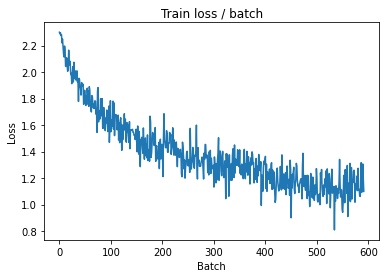


===============> Total time 16s	Avg loss 1.1220	Avg Prec@1 60.15 %	Avg Prec@5 95.99 %

[EVAL Batch 000/079]	Time 0.167s (0.167s)	Loss 0.9261 (0.9261)	Prec@1  68.8 ( 68.8)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.0059	Avg Prec@1 64.28 %	Avg Prec@5 97.05 %



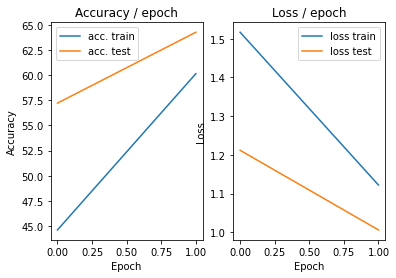

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.184s (0.184s)	Loss 1.0085 (1.0085)	Prec@1  66.4 ( 66.4)	Prec@5  96.1 ( 96.1)


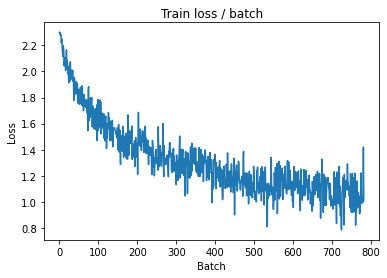

[TRAIN Batch 200/391]	Time 0.016s (0.042s)	Loss 0.9155 (0.9844)	Prec@1  68.8 ( 65.3)	Prec@5  96.9 ( 96.9)


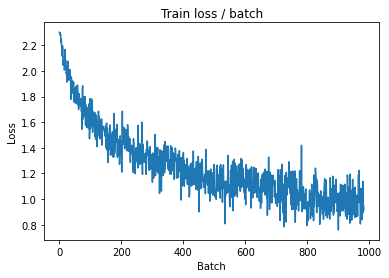


===============> Total time 16s	Avg loss 0.9599	Avg Prec@1 66.15 %	Avg Prec@5 97.07 %

[EVAL Batch 000/079]	Time 0.158s (0.158s)	Loss 0.7775 (0.7775)	Prec@1  72.7 ( 72.7)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.9180	Avg Prec@1 67.70 %	Avg Prec@5 97.64 %



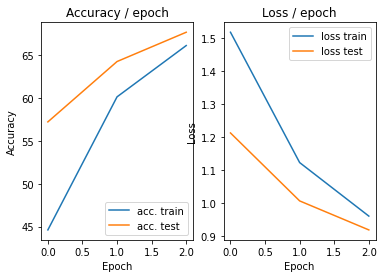

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.197s (0.197s)	Loss 0.9890 (0.9890)	Prec@1  65.6 ( 65.6)	Prec@5  97.7 ( 97.7)


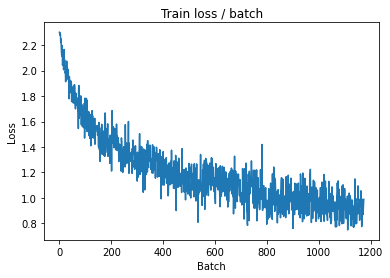

[TRAIN Batch 200/391]	Time 0.019s (0.042s)	Loss 0.9160 (0.8816)	Prec@1  71.9 ( 69.3)	Prec@5  94.5 ( 97.6)


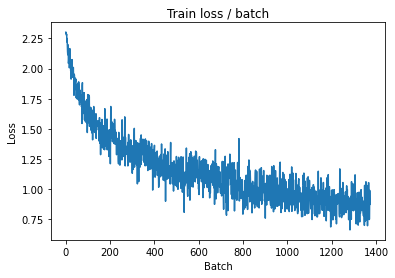


===============> Total time 16s	Avg loss 0.8548	Avg Prec@1 70.15 %	Avg Prec@5 97.74 %

[EVAL Batch 000/079]	Time 0.155s (0.155s)	Loss 0.7501 (0.7501)	Prec@1  78.1 ( 78.1)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.8248	Avg Prec@1 71.25 %	Avg Prec@5 97.90 %



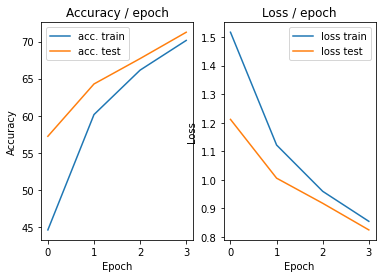

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.205s (0.205s)	Loss 0.6453 (0.6453)	Prec@1  78.1 ( 78.1)	Prec@5  99.2 ( 99.2)


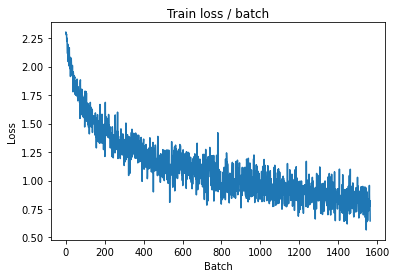

[TRAIN Batch 200/391]	Time 0.014s (0.042s)	Loss 0.9979 (0.7925)	Prec@1  64.1 ( 72.1)	Prec@5  96.1 ( 98.0)


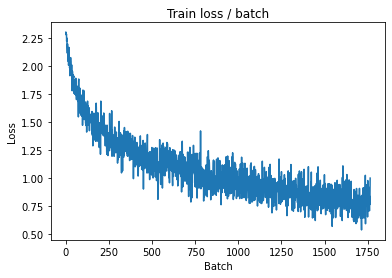


===============> Total time 16s	Avg loss 0.7869	Avg Prec@1 72.52 %	Avg Prec@5 98.07 %

[EVAL Batch 000/079]	Time 0.160s (0.160s)	Loss 0.6327 (0.6327)	Prec@1  78.1 ( 78.1)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.7526	Avg Prec@1 73.88 %	Avg Prec@5 98.36 %



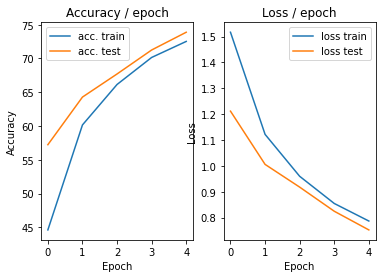

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.181s (0.181s)	Loss 0.7787 (0.7787)	Prec@1  75.8 ( 75.8)	Prec@5  98.4 ( 98.4)


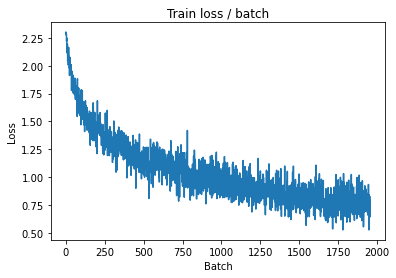

[TRAIN Batch 200/391]	Time 0.015s (0.042s)	Loss 0.6490 (0.7317)	Prec@1  77.3 ( 74.5)	Prec@5  98.4 ( 98.3)


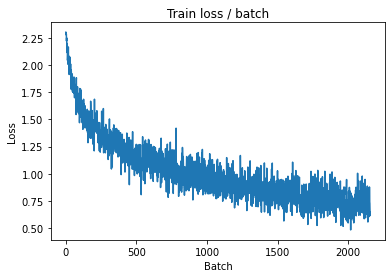


===============> Total time 16s	Avg loss 0.7248	Avg Prec@1 74.71 %	Avg Prec@5 98.40 %

[EVAL Batch 000/079]	Time 0.155s (0.155s)	Loss 0.6491 (0.6491)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.7054	Avg Prec@1 75.37 %	Avg Prec@5 98.49 %



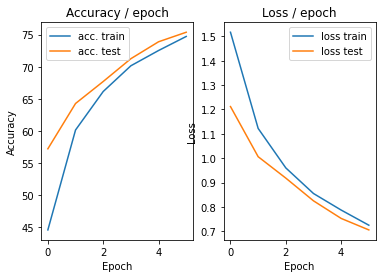

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.181s (0.181s)	Loss 0.6121 (0.6121)	Prec@1  77.3 ( 77.3)	Prec@5  98.4 ( 98.4)


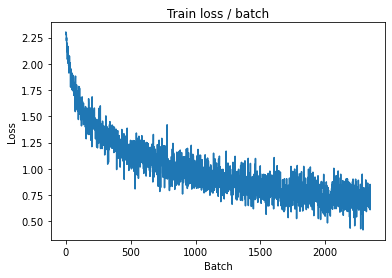

[TRAIN Batch 200/391]	Time 0.036s (0.041s)	Loss 0.7303 (0.6680)	Prec@1  71.9 ( 76.8)	Prec@5  99.2 ( 98.5)


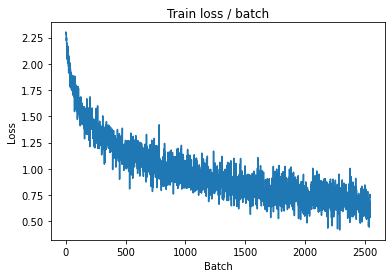


===============> Total time 16s	Avg loss 0.6671	Avg Prec@1 76.74 %	Avg Prec@5 98.61 %

[EVAL Batch 000/079]	Time 0.153s (0.153s)	Loss 0.5947 (0.5947)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.7022	Avg Prec@1 75.56 %	Avg Prec@5 98.40 %



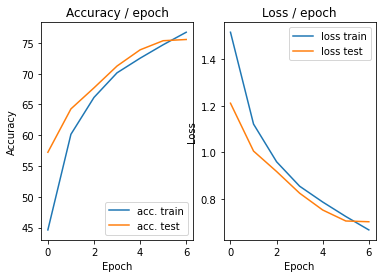

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.190s (0.190s)	Loss 0.6254 (0.6254)	Prec@1  79.7 ( 79.7)	Prec@5  97.7 ( 97.7)


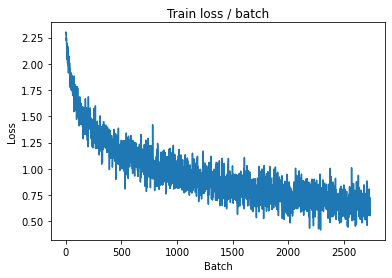

[TRAIN Batch 200/391]	Time 0.058s (0.041s)	Loss 0.6984 (0.6299)	Prec@1  71.9 ( 77.9)	Prec@5  99.2 ( 98.7)


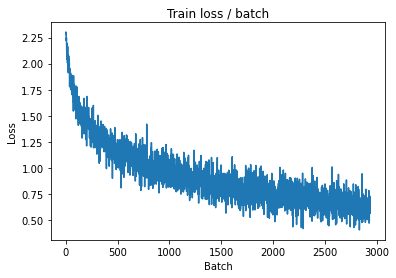


===============> Total time 16s	Avg loss 0.6304	Avg Prec@1 77.97 %	Avg Prec@5 98.74 %

[EVAL Batch 000/079]	Time 0.154s (0.154s)	Loss 0.5821 (0.5821)	Prec@1  83.6 ( 83.6)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.6601	Avg Prec@1 77.02 %	Avg Prec@5 98.61 %



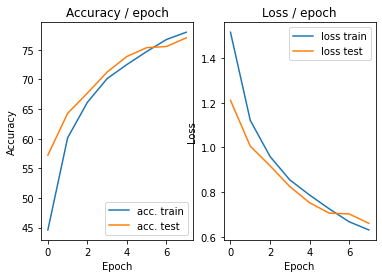

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.195s (0.195s)	Loss 0.5750 (0.5750)	Prec@1  81.2 ( 81.2)	Prec@5  99.2 ( 99.2)


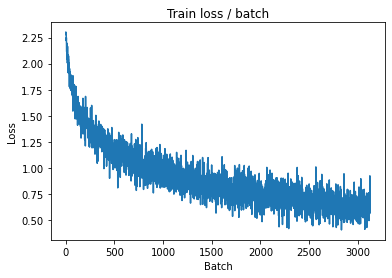

[TRAIN Batch 200/391]	Time 0.017s (0.041s)	Loss 0.6753 (0.5908)	Prec@1  75.8 ( 79.5)	Prec@5  98.4 ( 99.0)


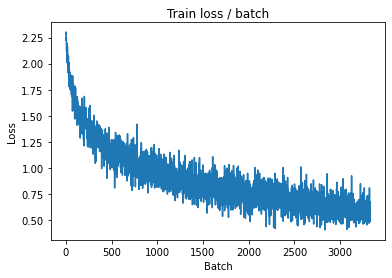


===============> Total time 16s	Avg loss 0.5921	Avg Prec@1 79.44 %	Avg Prec@5 98.93 %

[EVAL Batch 000/079]	Time 0.161s (0.161s)	Loss 0.6316 (0.6316)	Prec@1  82.0 ( 82.0)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.6370	Avg Prec@1 78.03 %	Avg Prec@5 98.76 %



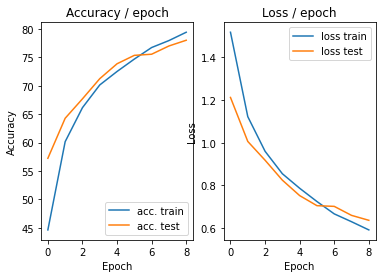

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.181s (0.181s)	Loss 0.7451 (0.7451)	Prec@1  76.6 ( 76.6)	Prec@5  96.1 ( 96.1)


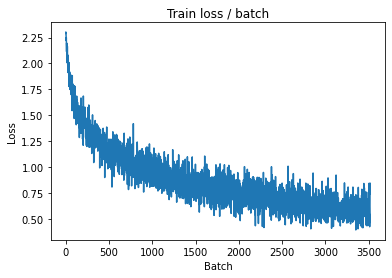

[TRAIN Batch 200/391]	Time 0.017s (0.041s)	Loss 0.6228 (0.5523)	Prec@1  78.9 ( 80.8)	Prec@5  99.2 ( 99.2)


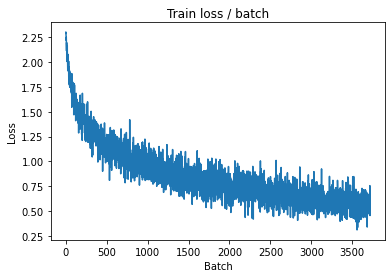


===============> Total time 15s	Avg loss 0.5578	Avg Prec@1 80.61 %	Avg Prec@5 99.10 %

[EVAL Batch 000/079]	Time 0.157s (0.157s)	Loss 0.5653 (0.5653)	Prec@1  85.2 ( 85.2)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.6307	Avg Prec@1 78.69 %	Avg Prec@5 98.60 %



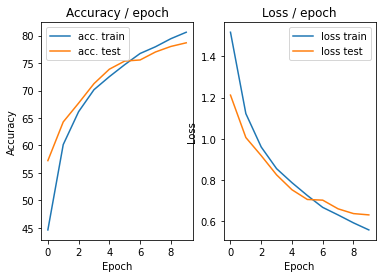

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.180s (0.180s)	Loss 0.5338 (0.5338)	Prec@1  78.9 ( 78.9)	Prec@5 100.0 (100.0)


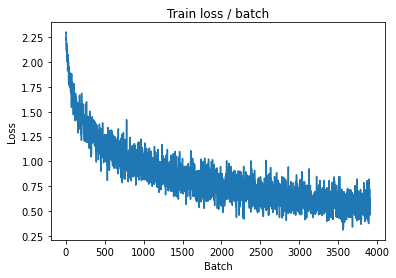

[TRAIN Batch 200/391]	Time 0.016s (0.042s)	Loss 0.6638 (0.5221)	Prec@1  75.8 ( 81.7)	Prec@5  97.7 ( 99.1)


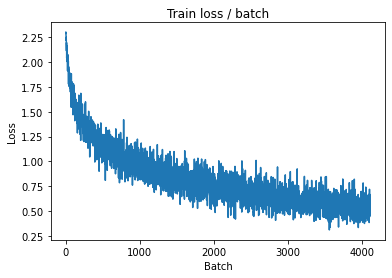


===============> Total time 16s	Avg loss 0.5266	Avg Prec@1 81.59 %	Avg Prec@5 99.19 %

[EVAL Batch 000/079]	Time 0.156s (0.156s)	Loss 0.5477 (0.5477)	Prec@1  85.2 ( 85.2)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.6028	Avg Prec@1 79.22 %	Avg Prec@5 98.81 %



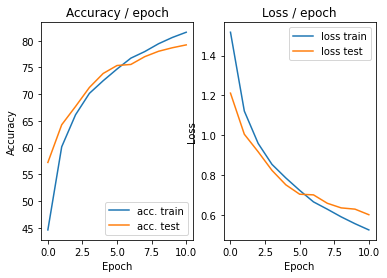

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.174s (0.174s)	Loss 0.3984 (0.3984)	Prec@1  84.4 ( 84.4)	Prec@5 100.0 (100.0)


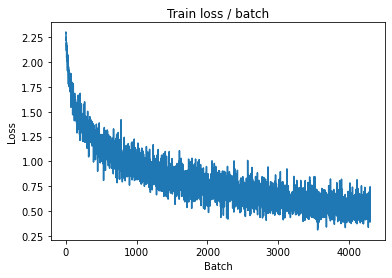

[TRAIN Batch 200/391]	Time 0.035s (0.042s)	Loss 0.6783 (0.4934)	Prec@1  75.0 ( 82.8)	Prec@5 100.0 ( 99.2)


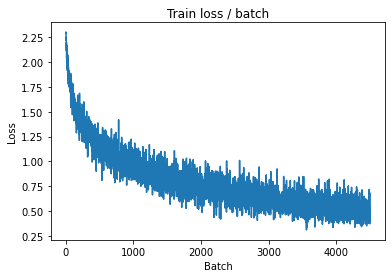


===============> Total time 15s	Avg loss 0.5055	Avg Prec@1 82.40 %	Avg Prec@5 99.23 %

[EVAL Batch 000/079]	Time 0.153s (0.153s)	Loss 0.5290 (0.5290)	Prec@1  85.9 ( 85.9)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6292	Avg Prec@1 78.77 %	Avg Prec@5 98.70 %



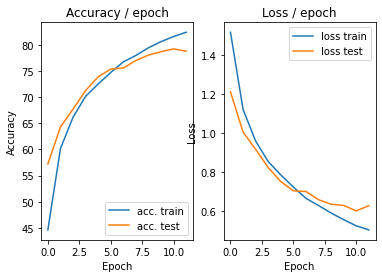

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.181s (0.181s)	Loss 0.4416 (0.4416)	Prec@1  85.2 ( 85.2)	Prec@5  99.2 ( 99.2)


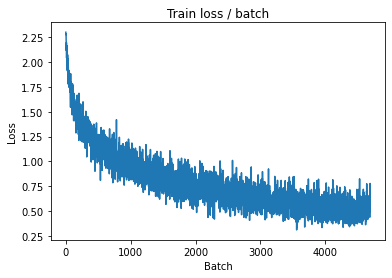

[TRAIN Batch 200/391]	Time 0.069s (0.041s)	Loss 0.3882 (0.4799)	Prec@1  85.9 ( 83.3)	Prec@5  99.2 ( 99.3)


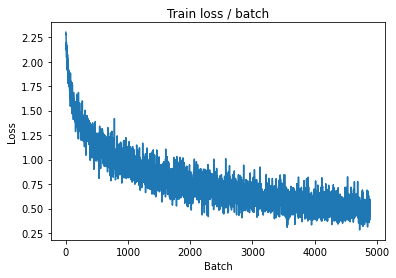


===============> Total time 15s	Avg loss 0.4854	Avg Prec@1 83.11 %	Avg Prec@5 99.34 %

[EVAL Batch 000/079]	Time 0.151s (0.151s)	Loss 0.6008 (0.6008)	Prec@1  83.6 ( 83.6)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.6041	Avg Prec@1 79.77 %	Avg Prec@5 98.74 %



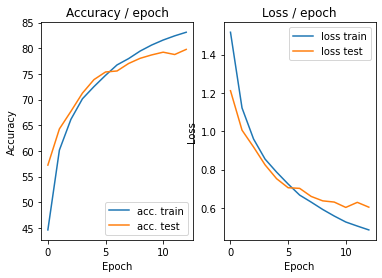

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.190s (0.190s)	Loss 0.4618 (0.4618)	Prec@1  83.6 ( 83.6)	Prec@5 100.0 (100.0)


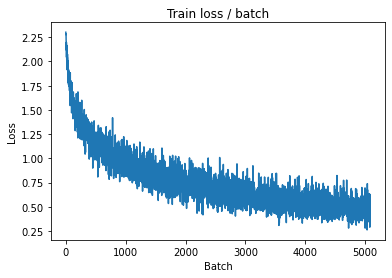

[TRAIN Batch 200/391]	Time 0.058s (0.041s)	Loss 0.5092 (0.4508)	Prec@1  79.7 ( 84.1)	Prec@5 100.0 ( 99.5)


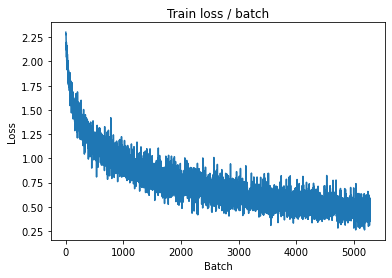


===============> Total time 15s	Avg loss 0.4512	Avg Prec@1 84.18 %	Avg Prec@5 99.44 %

[EVAL Batch 000/079]	Time 0.149s (0.149s)	Loss 0.6286 (0.6286)	Prec@1  82.0 ( 82.0)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.5863	Avg Prec@1 80.46 %	Avg Prec@5 98.86 %



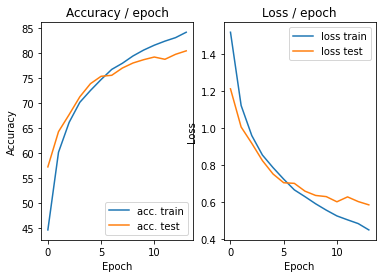

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.182s (0.182s)	Loss 0.4949 (0.4949)	Prec@1  82.8 ( 82.8)	Prec@5  99.2 ( 99.2)


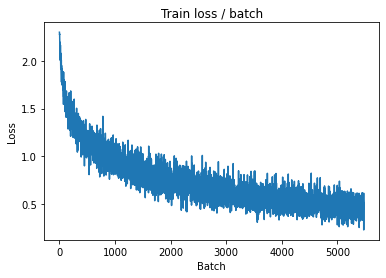

[TRAIN Batch 200/391]	Time 0.051s (0.040s)	Loss 0.4099 (0.4241)	Prec@1  82.0 ( 85.0)	Prec@5 100.0 ( 99.5)


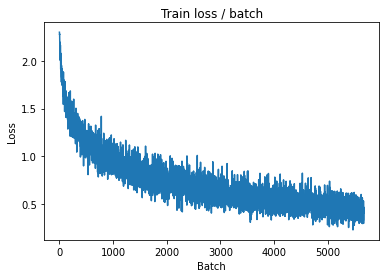


===============> Total time 15s	Avg loss 0.4309	Avg Prec@1 84.69 %	Avg Prec@5 99.51 %

[EVAL Batch 000/079]	Time 0.160s (0.160s)	Loss 0.6086 (0.6086)	Prec@1  84.4 ( 84.4)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.6237	Avg Prec@1 79.39 %	Avg Prec@5 98.83 %



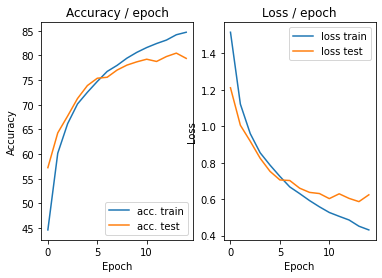

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.187s (0.187s)	Loss 0.3575 (0.3575)	Prec@1  85.2 ( 85.2)	Prec@5 100.0 (100.0)


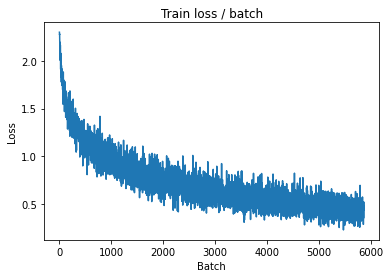

[TRAIN Batch 200/391]	Time 0.069s (0.041s)	Loss 0.4433 (0.4046)	Prec@1  85.2 ( 85.8)	Prec@5  99.2 ( 99.5)


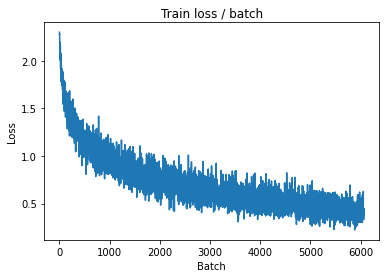


===============> Total time 15s	Avg loss 0.4118	Avg Prec@1 85.47 %	Avg Prec@5 99.56 %

[EVAL Batch 000/079]	Time 0.162s (0.162s)	Loss 0.5609 (0.5609)	Prec@1  83.6 ( 83.6)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.5762	Avg Prec@1 81.23 %	Avg Prec@5 98.82 %



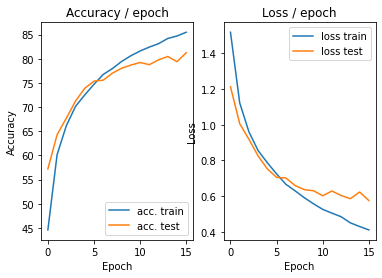

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.182s (0.182s)	Loss 0.4103 (0.4103)	Prec@1  86.7 ( 86.7)	Prec@5 100.0 (100.0)


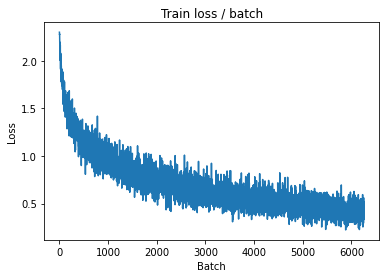

[TRAIN Batch 200/391]	Time 0.018s (0.041s)	Loss 0.3536 (0.3890)	Prec@1  89.1 ( 86.2)	Prec@5  99.2 ( 99.7)


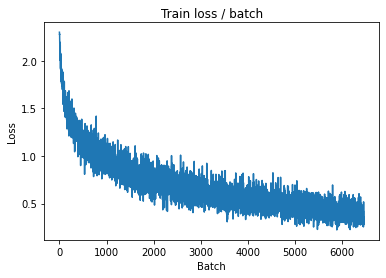


===============> Total time 15s	Avg loss 0.3978	Avg Prec@1 85.94 %	Avg Prec@5 99.63 %

[EVAL Batch 000/079]	Time 0.172s (0.172s)	Loss 0.5692 (0.5692)	Prec@1  83.6 ( 83.6)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.6061	Avg Prec@1 80.10 %	Avg Prec@5 98.81 %



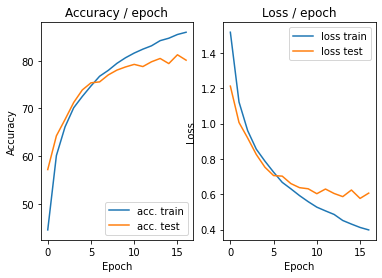

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.173s (0.173s)	Loss 0.2469 (0.2469)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 (100.0)


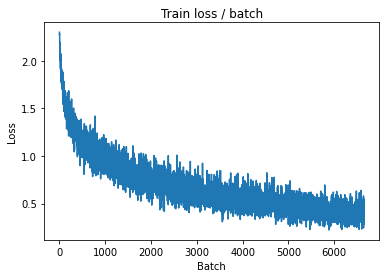

[TRAIN Batch 200/391]	Time 0.071s (0.041s)	Loss 0.4311 (0.3608)	Prec@1  87.5 ( 87.3)	Prec@5  99.2 ( 99.6)


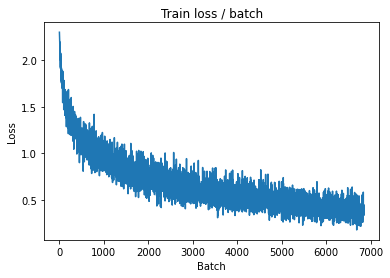


===============> Total time 15s	Avg loss 0.3720	Avg Prec@1 86.84 %	Avg Prec@5 99.61 %

[EVAL Batch 000/079]	Time 0.165s (0.165s)	Loss 0.5554 (0.5554)	Prec@1  83.6 ( 83.6)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.5792	Avg Prec@1 81.50 %	Avg Prec@5 98.92 %



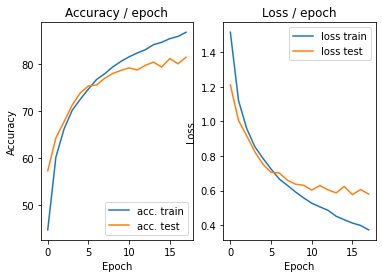

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.185s (0.185s)	Loss 0.3602 (0.3602)	Prec@1  89.1 ( 89.1)	Prec@5 100.0 (100.0)


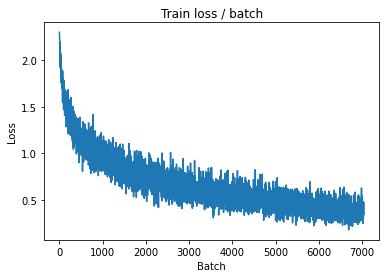

[TRAIN Batch 200/391]	Time 0.058s (0.040s)	Loss 0.3287 (0.3492)	Prec@1  88.3 ( 87.8)	Prec@5 100.0 ( 99.7)


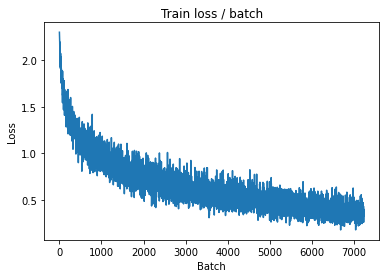


===============> Total time 15s	Avg loss 0.3544	Avg Prec@1 87.55 %	Avg Prec@5 99.70 %

[EVAL Batch 000/079]	Time 0.158s (0.158s)	Loss 0.5700 (0.5700)	Prec@1  85.2 ( 85.2)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.5854	Avg Prec@1 80.86 %	Avg Prec@5 98.96 %



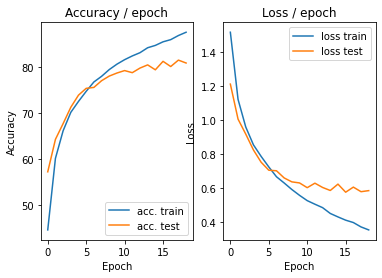

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.177s (0.177s)	Loss 0.3551 (0.3551)	Prec@1  85.9 ( 85.9)	Prec@5 100.0 (100.0)


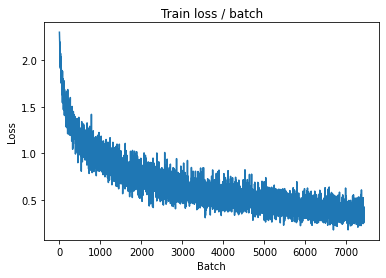

[TRAIN Batch 200/391]	Time 0.067s (0.040s)	Loss 0.3528 (0.3318)	Prec@1  87.5 ( 88.5)	Prec@5 100.0 ( 99.7)


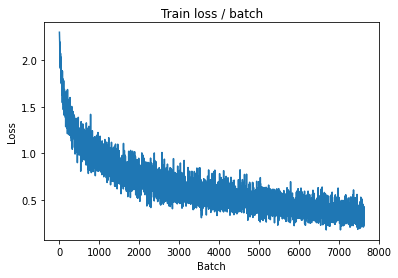


===============> Total time 15s	Avg loss 0.3396	Avg Prec@1 88.14 %	Avg Prec@5 99.72 %

[EVAL Batch 000/079]	Time 0.145s (0.145s)	Loss 0.5929 (0.5929)	Prec@1  85.2 ( 85.2)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.5898	Avg Prec@1 81.20 %	Avg Prec@5 98.90 %



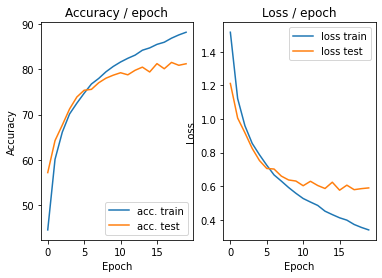

=== EPOCH 21 =====

[TRAIN Batch 000/391]	Time 0.189s (0.189s)	Loss 0.1999 (0.1999)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


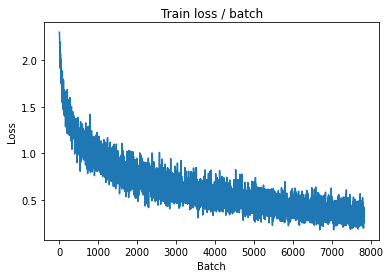

[TRAIN Batch 200/391]	Time 0.067s (0.041s)	Loss 0.2891 (0.3124)	Prec@1  91.4 ( 89.0)	Prec@5 100.0 ( 99.8)


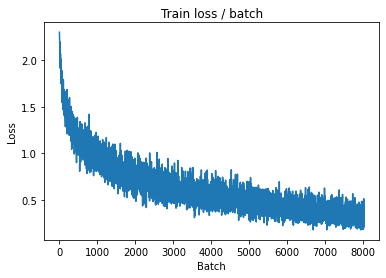


===============> Total time 15s	Avg loss 0.3211	Avg Prec@1 88.73 %	Avg Prec@5 99.76 %

[EVAL Batch 000/079]	Time 0.146s (0.146s)	Loss 0.6528 (0.6528)	Prec@1  85.2 ( 85.2)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.6004	Avg Prec@1 81.05 %	Avg Prec@5 99.02 %



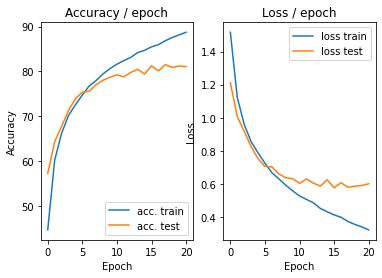

=== EPOCH 22 =====

[TRAIN Batch 000/391]	Time 0.208s (0.208s)	Loss 0.3199 (0.3199)	Prec@1  89.1 ( 89.1)	Prec@5  99.2 ( 99.2)


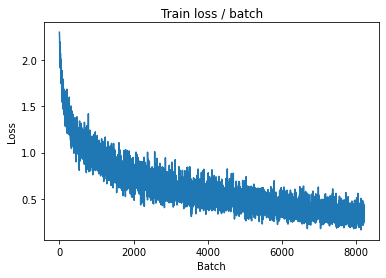

[TRAIN Batch 200/391]	Time 0.009s (0.040s)	Loss 0.2836 (0.2999)	Prec@1  90.6 ( 89.5)	Prec@5 100.0 ( 99.8)


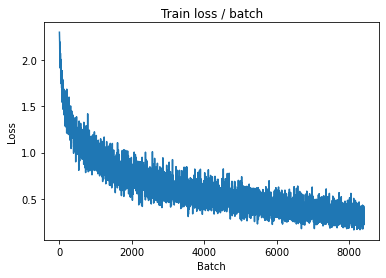


===============> Total time 15s	Avg loss 0.3111	Avg Prec@1 89.06 %	Avg Prec@5 99.78 %

[EVAL Batch 000/079]	Time 0.149s (0.149s)	Loss 0.6861 (0.6861)	Prec@1  81.2 ( 81.2)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.5931	Avg Prec@1 81.03 %	Avg Prec@5 98.89 %



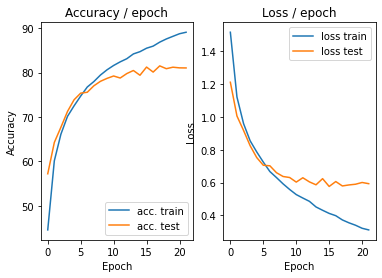

=== EPOCH 23 =====

[TRAIN Batch 000/391]	Time 0.184s (0.184s)	Loss 0.1923 (0.1923)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


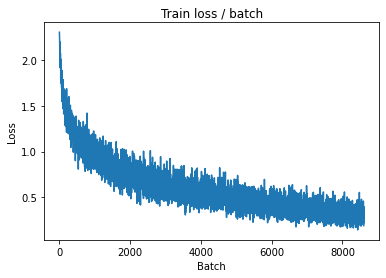

[TRAIN Batch 200/391]	Time 0.015s (0.041s)	Loss 0.2570 (0.2893)	Prec@1  92.2 ( 90.1)	Prec@5 100.0 ( 99.8)


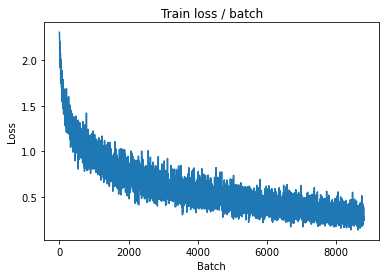


===============> Total time 15s	Avg loss 0.2950	Avg Prec@1 89.67 %	Avg Prec@5 99.82 %

[EVAL Batch 000/079]	Time 0.145s (0.145s)	Loss 0.5629 (0.5629)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.5926	Avg Prec@1 81.30 %	Avg Prec@5 98.79 %



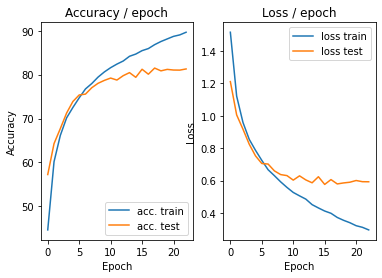

=== EPOCH 24 =====

[TRAIN Batch 000/391]	Time 0.175s (0.175s)	Loss 0.2406 (0.2406)	Prec@1  89.1 ( 89.1)	Prec@5 100.0 (100.0)


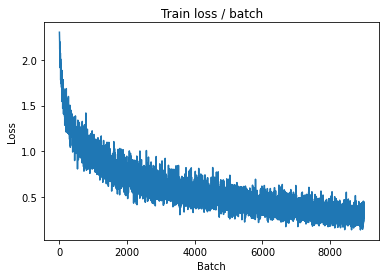

[TRAIN Batch 200/391]	Time 0.016s (0.041s)	Loss 0.1822 (0.2668)	Prec@1  96.1 ( 90.7)	Prec@5 100.0 ( 99.8)


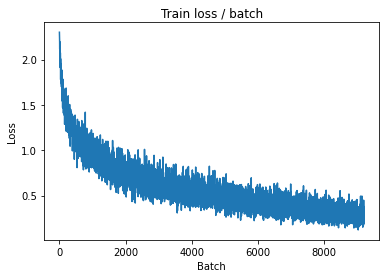


===============> Total time 15s	Avg loss 0.2774	Avg Prec@1 90.17 %	Avg Prec@5 99.82 %

[EVAL Batch 000/079]	Time 0.139s (0.139s)	Loss 0.5985 (0.5985)	Prec@1  84.4 ( 84.4)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6014	Avg Prec@1 81.36 %	Avg Prec@5 98.92 %



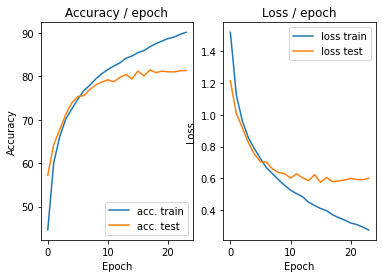

=== EPOCH 25 =====

[TRAIN Batch 000/391]	Time 0.188s (0.188s)	Loss 0.3491 (0.3491)	Prec@1  89.1 ( 89.1)	Prec@5 100.0 (100.0)


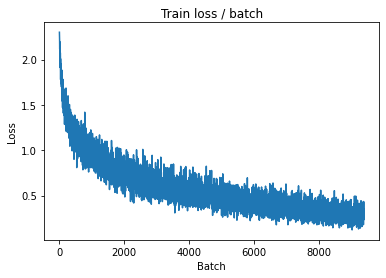

[TRAIN Batch 200/391]	Time 0.017s (0.040s)	Loss 0.2851 (0.2586)	Prec@1  89.8 ( 90.9)	Prec@5 100.0 ( 99.8)


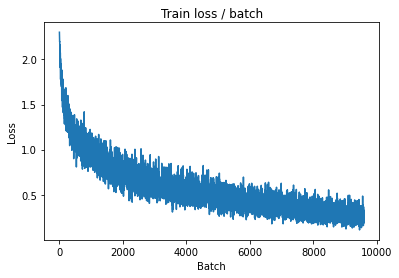


===============> Total time 15s	Avg loss 0.2665	Avg Prec@1 90.50 %	Avg Prec@5 99.86 %

[EVAL Batch 000/079]	Time 0.159s (0.159s)	Loss 0.6290 (0.6290)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6275	Avg Prec@1 81.11 %	Avg Prec@5 98.87 %



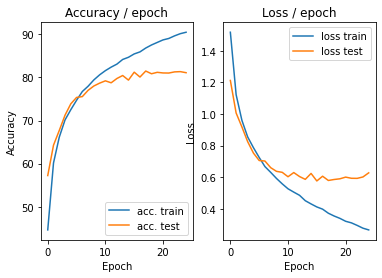

=== EPOCH 26 =====

[TRAIN Batch 000/391]	Time 0.180s (0.180s)	Loss 0.2440 (0.2440)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


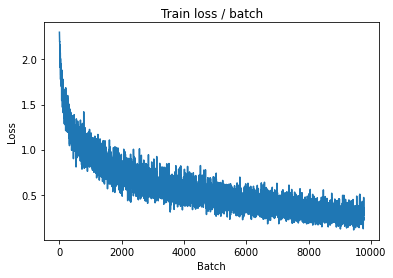

[TRAIN Batch 200/391]	Time 0.056s (0.040s)	Loss 0.2155 (0.2512)	Prec@1  90.6 ( 91.1)	Prec@5 100.0 ( 99.9)


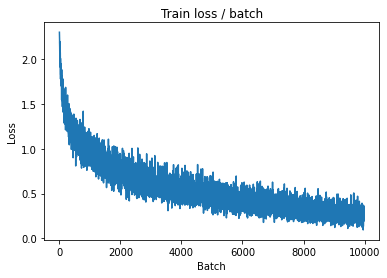


===============> Total time 15s	Avg loss 0.2577	Avg Prec@1 90.99 %	Avg Prec@5 99.86 %

[EVAL Batch 000/079]	Time 0.151s (0.151s)	Loss 0.6600 (0.6600)	Prec@1  83.6 ( 83.6)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.6455	Avg Prec@1 81.00 %	Avg Prec@5 98.93 %



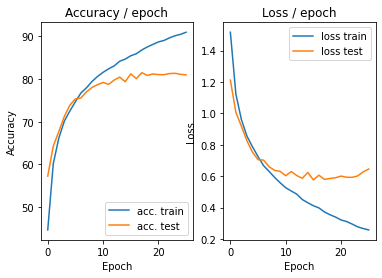

=== EPOCH 27 =====

[TRAIN Batch 000/391]	Time 0.182s (0.182s)	Loss 0.3289 (0.3289)	Prec@1  89.8 ( 89.8)	Prec@5  99.2 ( 99.2)


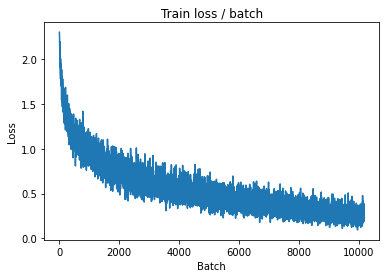

[TRAIN Batch 200/391]	Time 0.016s (0.042s)	Loss 0.1954 (0.2362)	Prec@1  93.8 ( 91.7)	Prec@5 100.0 ( 99.9)


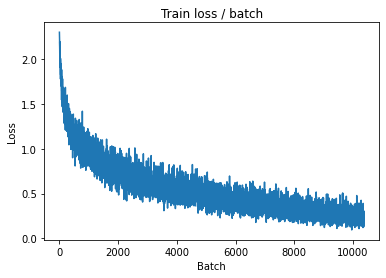


===============> Total time 15s	Avg loss 0.2431	Avg Prec@1 91.40 %	Avg Prec@5 99.89 %

[EVAL Batch 000/079]	Time 0.159s (0.159s)	Loss 0.6103 (0.6103)	Prec@1  85.9 ( 85.9)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.6114	Avg Prec@1 81.72 %	Avg Prec@5 99.00 %



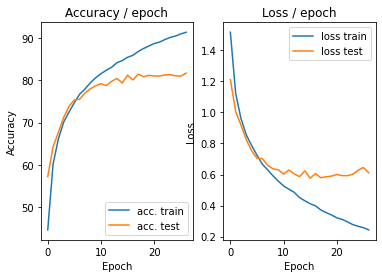

=== EPOCH 28 =====

[TRAIN Batch 000/391]	Time 0.179s (0.179s)	Loss 0.2539 (0.2539)	Prec@1  90.6 ( 90.6)	Prec@5  99.2 ( 99.2)


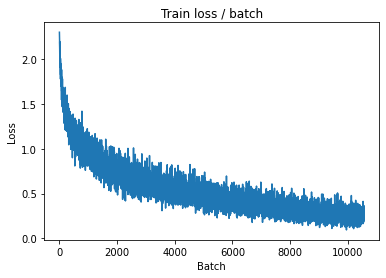

[TRAIN Batch 200/391]	Time 0.015s (0.039s)	Loss 0.2647 (0.2360)	Prec@1  89.8 ( 91.7)	Prec@5 100.0 ( 99.9)


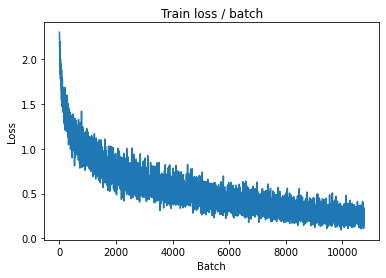


===============> Total time 15s	Avg loss 0.2338	Avg Prec@1 91.75 %	Avg Prec@5 99.89 %

[EVAL Batch 000/079]	Time 0.144s (0.144s)	Loss 0.6371 (0.6371)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6428	Avg Prec@1 80.98 %	Avg Prec@5 98.91 %



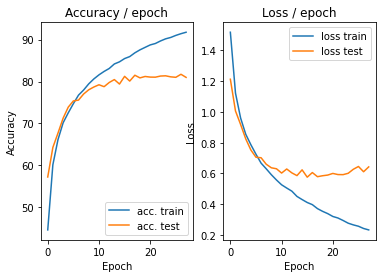

=== EPOCH 29 =====

[TRAIN Batch 000/391]	Time 0.174s (0.174s)	Loss 0.1807 (0.1807)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


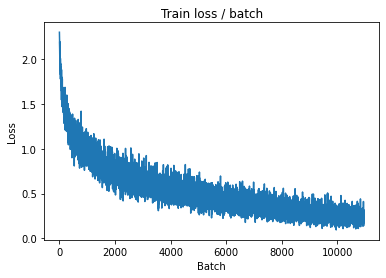

[TRAIN Batch 200/391]	Time 0.070s (0.040s)	Loss 0.2623 (0.2140)	Prec@1  91.4 ( 92.4)	Prec@5  99.2 ( 99.9)


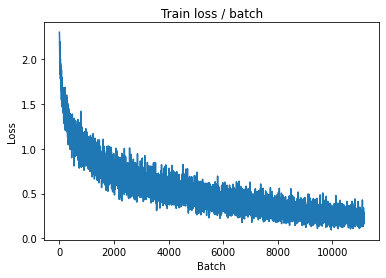


===============> Total time 15s	Avg loss 0.2238	Avg Prec@1 92.02 %	Avg Prec@5 99.90 %

[EVAL Batch 000/079]	Time 0.142s (0.142s)	Loss 0.5242 (0.5242)	Prec@1  84.4 ( 84.4)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6401	Avg Prec@1 80.84 %	Avg Prec@5 98.94 %



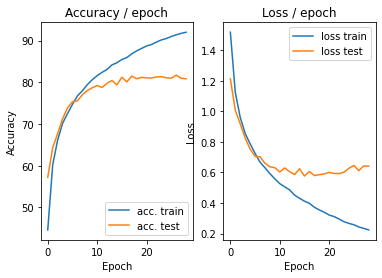

=== EPOCH 30 =====

[TRAIN Batch 000/391]	Time 0.181s (0.181s)	Loss 0.2878 (0.2878)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)


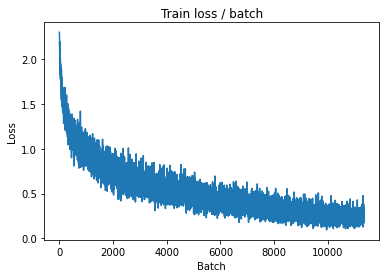

[TRAIN Batch 200/391]	Time 0.070s (0.040s)	Loss 0.1551 (0.2118)	Prec@1  93.0 ( 92.6)	Prec@5 100.0 ( 99.9)


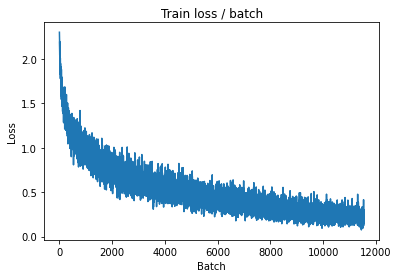


===============> Total time 15s	Avg loss 0.2196	Avg Prec@1 92.36 %	Avg Prec@5 99.92 %

[EVAL Batch 000/079]	Time 0.152s (0.152s)	Loss 0.7648 (0.7648)	Prec@1  82.8 ( 82.8)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.6362	Avg Prec@1 81.71 %	Avg Prec@5 98.85 %



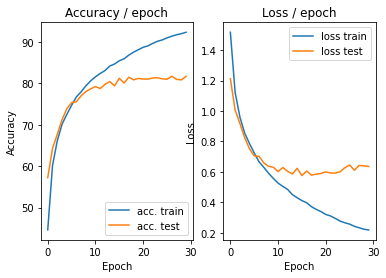

=== EPOCH 31 =====

[TRAIN Batch 000/391]	Time 0.178s (0.178s)	Loss 0.1824 (0.1824)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


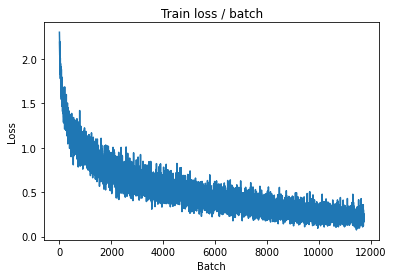

[TRAIN Batch 200/391]	Time 0.017s (0.040s)	Loss 0.1745 (0.1962)	Prec@1  93.8 ( 93.2)	Prec@5 100.0 (100.0)


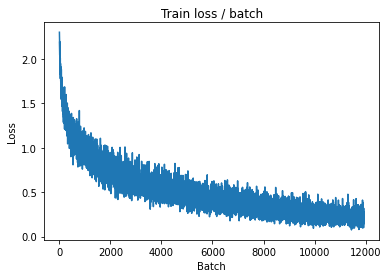


===============> Total time 15s	Avg loss 0.2044	Avg Prec@1 92.77 %	Avg Prec@5 99.94 %

[EVAL Batch 000/079]	Time 0.153s (0.153s)	Loss 0.8219 (0.8219)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6503	Avg Prec@1 81.62 %	Avg Prec@5 98.99 %



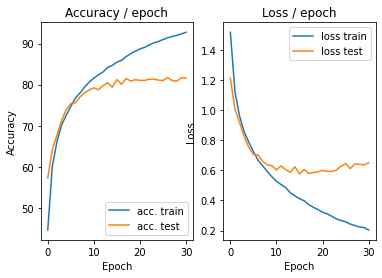

=== EPOCH 32 =====

[TRAIN Batch 000/391]	Time 0.196s (0.196s)	Loss 0.1751 (0.1751)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)


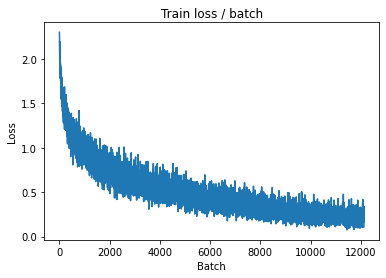

[TRAIN Batch 200/391]	Time 0.017s (0.040s)	Loss 0.1517 (0.1872)	Prec@1  93.8 ( 93.4)	Prec@5 100.0 (100.0)


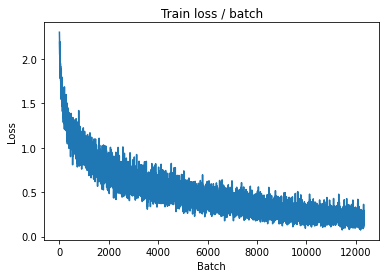


===============> Total time 15s	Avg loss 0.1948	Avg Prec@1 93.12 %	Avg Prec@5 99.96 %

[EVAL Batch 000/079]	Time 0.148s (0.148s)	Loss 0.7478 (0.7478)	Prec@1  81.2 ( 81.2)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6682	Avg Prec@1 81.11 %	Avg Prec@5 99.01 %



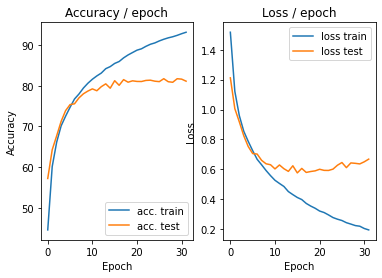

=== EPOCH 33 =====

[TRAIN Batch 000/391]	Time 0.180s (0.180s)	Loss 0.2353 (0.2353)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


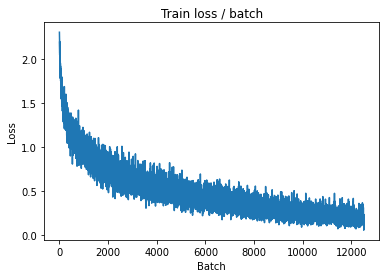

[TRAIN Batch 200/391]	Time 0.052s (0.039s)	Loss 0.2253 (0.1895)	Prec@1  96.1 ( 93.5)	Prec@5  99.2 ( 99.9)


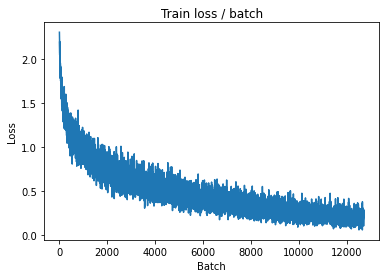


===============> Total time 15s	Avg loss 0.1891	Avg Prec@1 93.42 %	Avg Prec@5 99.94 %

[EVAL Batch 000/079]	Time 0.150s (0.150s)	Loss 0.7873 (0.7873)	Prec@1  82.0 ( 82.0)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.6820	Avg Prec@1 81.06 %	Avg Prec@5 98.93 %



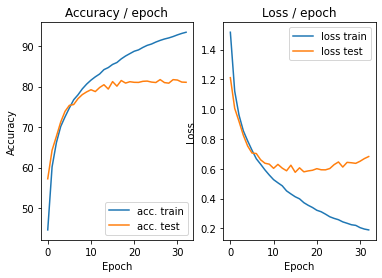

=== EPOCH 34 =====

[TRAIN Batch 000/391]	Time 0.182s (0.182s)	Loss 0.1327 (0.1327)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


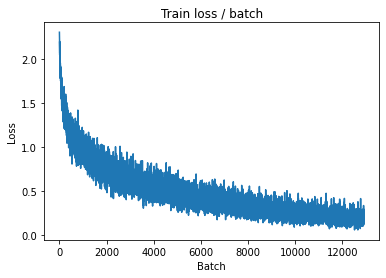

[TRAIN Batch 200/391]	Time 0.053s (0.040s)	Loss 0.1640 (0.1756)	Prec@1  95.3 ( 93.8)	Prec@5 100.0 (100.0)


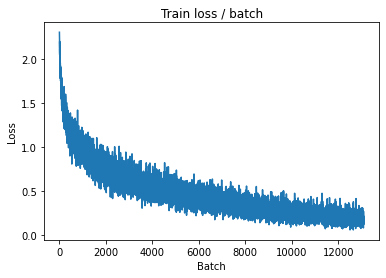


===============> Total time 15s	Avg loss 0.1793	Avg Prec@1 93.67 %	Avg Prec@5 99.95 %

[EVAL Batch 000/079]	Time 0.159s (0.159s)	Loss 0.8275 (0.8275)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6735	Avg Prec@1 81.64 %	Avg Prec@5 98.95 %



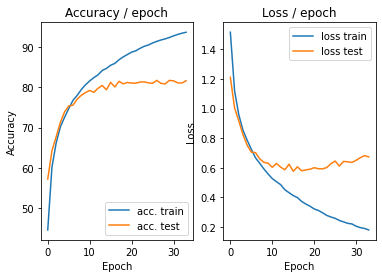

=== EPOCH 35 =====

[TRAIN Batch 000/391]	Time 0.177s (0.177s)	Loss 0.1669 (0.1669)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


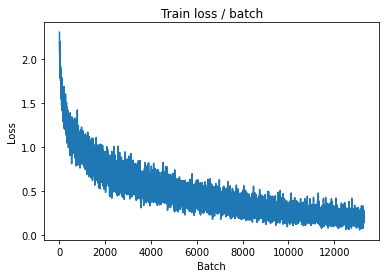

[TRAIN Batch 200/391]	Time 0.060s (0.040s)	Loss 0.1035 (0.1661)	Prec@1  97.7 ( 94.1)	Prec@5 100.0 (100.0)


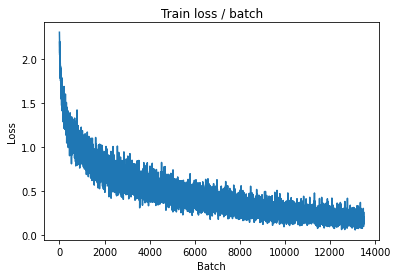


===============> Total time 15s	Avg loss 0.1710	Avg Prec@1 93.98 %	Avg Prec@5 99.96 %

[EVAL Batch 000/079]	Time 0.176s (0.176s)	Loss 0.6994 (0.6994)	Prec@1  85.9 ( 85.9)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.6887	Avg Prec@1 81.70 %	Avg Prec@5 98.95 %



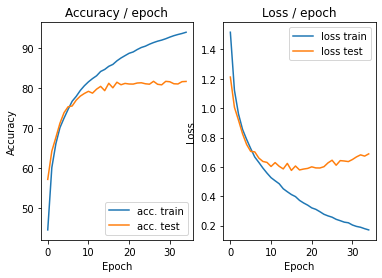

=== EPOCH 36 =====

[TRAIN Batch 000/391]	Time 0.188s (0.188s)	Loss 0.1862 (0.1862)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


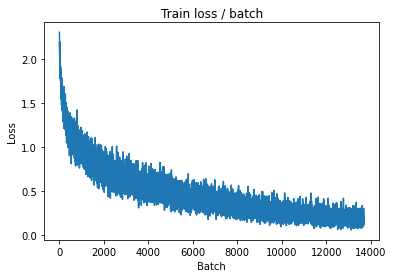

[TRAIN Batch 200/391]	Time 0.016s (0.040s)	Loss 0.0986 (0.1667)	Prec@1  97.7 ( 94.2)	Prec@5 100.0 (100.0)


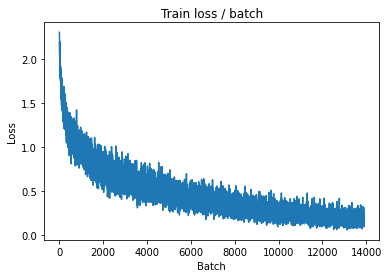


===============> Total time 15s	Avg loss 0.1681	Avg Prec@1 94.15 %	Avg Prec@5 99.95 %

[EVAL Batch 000/079]	Time 0.148s (0.148s)	Loss 0.8585 (0.8585)	Prec@1  82.8 ( 82.8)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.6791	Avg Prec@1 81.89 %	Avg Prec@5 98.88 %



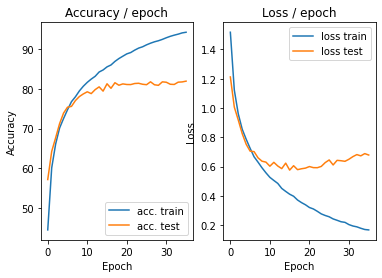

=== EPOCH 37 =====

[TRAIN Batch 000/391]	Time 0.166s (0.166s)	Loss 0.1669 (0.1669)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


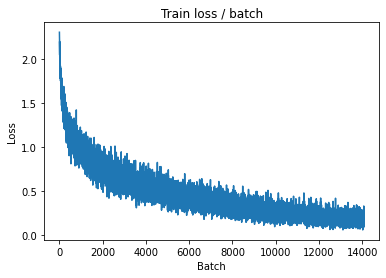

[TRAIN Batch 200/391]	Time 0.016s (0.040s)	Loss 0.0822 (0.1608)	Prec@1  98.4 ( 94.5)	Prec@5 100.0 (100.0)


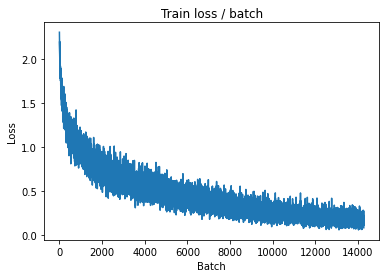


===============> Total time 15s	Avg loss 0.1624	Avg Prec@1 94.39 %	Avg Prec@5 99.96 %

[EVAL Batch 000/079]	Time 0.157s (0.157s)	Loss 0.9358 (0.9358)	Prec@1  82.8 ( 82.8)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.7137	Avg Prec@1 81.70 %	Avg Prec@5 98.81 %



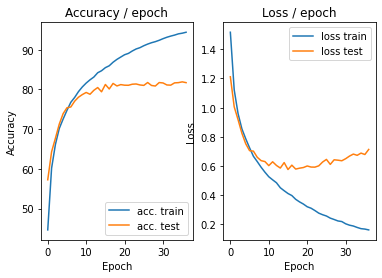

=== EPOCH 38 =====

[TRAIN Batch 000/391]	Time 0.179s (0.179s)	Loss 0.1181 (0.1181)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)


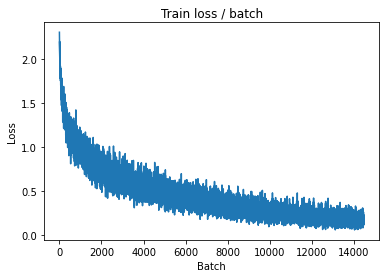

[TRAIN Batch 200/391]	Time 0.048s (0.041s)	Loss 0.0977 (0.1476)	Prec@1  96.9 ( 95.0)	Prec@5 100.0 (100.0)


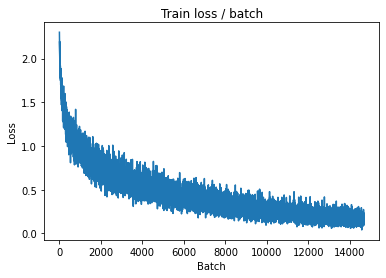


===============> Total time 15s	Avg loss 0.1498	Avg Prec@1 94.90 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.143s (0.143s)	Loss 0.8437 (0.8437)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6948	Avg Prec@1 82.27 %	Avg Prec@5 99.00 %



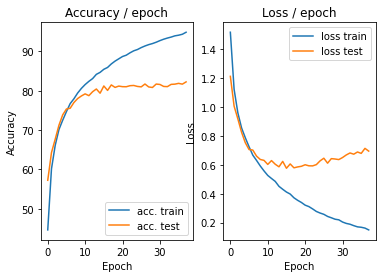

=== EPOCH 39 =====

[TRAIN Batch 000/391]	Time 0.178s (0.178s)	Loss 0.1863 (0.1863)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


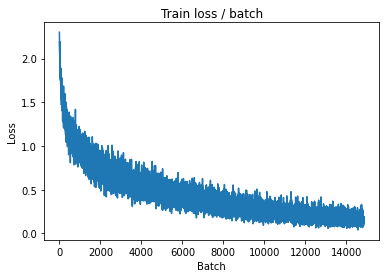

[TRAIN Batch 200/391]	Time 0.013s (0.040s)	Loss 0.1352 (0.1470)	Prec@1  96.1 ( 94.9)	Prec@5 100.0 ( 99.9)


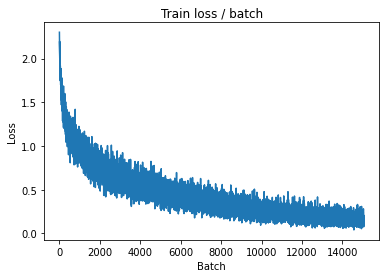


===============> Total time 15s	Avg loss 0.1511	Avg Prec@1 94.83 %	Avg Prec@5 99.96 %

[EVAL Batch 000/079]	Time 0.150s (0.150s)	Loss 0.8733 (0.8733)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.7043	Avg Prec@1 82.18 %	Avg Prec@5 98.96 %



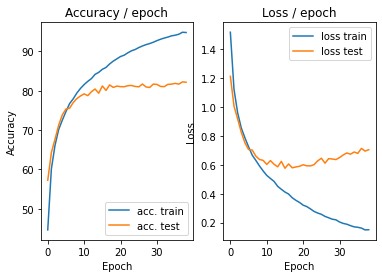

=== EPOCH 40 =====

[TRAIN Batch 000/391]	Time 0.181s (0.181s)	Loss 0.1279 (0.1279)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


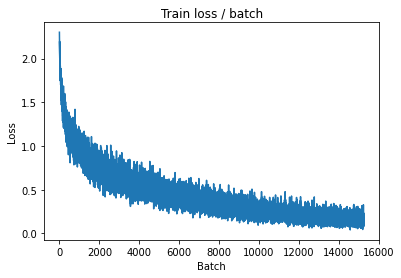

[TRAIN Batch 200/391]	Time 0.073s (0.041s)	Loss 0.1305 (0.1418)	Prec@1  93.8 ( 95.3)	Prec@5 100.0 (100.0)


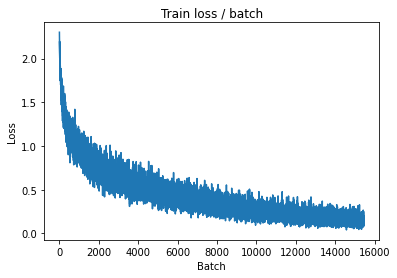


===============> Total time 15s	Avg loss 0.1472	Avg Prec@1 94.99 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.151s (0.151s)	Loss 0.9471 (0.9471)	Prec@1  78.9 ( 78.9)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.7246	Avg Prec@1 82.04 %	Avg Prec@5 99.00 %



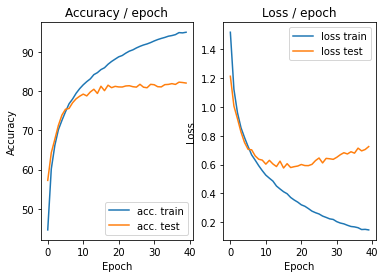

=== EPOCH 41 =====

[TRAIN Batch 000/391]	Time 0.181s (0.181s)	Loss 0.2248 (0.2248)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


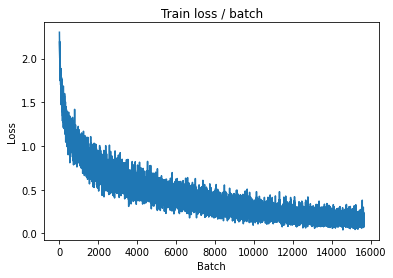

[TRAIN Batch 200/391]	Time 0.012s (0.040s)	Loss 0.1831 (0.1345)	Prec@1  94.5 ( 95.3)	Prec@5 100.0 (100.0)


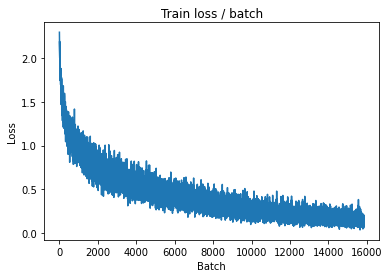


===============> Total time 15s	Avg loss 0.1413	Avg Prec@1 95.05 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.141s (0.141s)	Loss 0.8054 (0.8054)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.7536	Avg Prec@1 81.56 %	Avg Prec@5 98.90 %



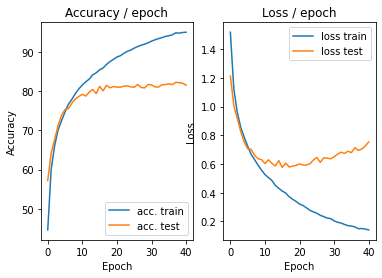

=== EPOCH 42 =====

[TRAIN Batch 000/391]	Time 0.174s (0.174s)	Loss 0.0772 (0.0772)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


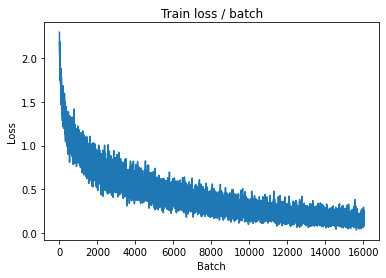

[TRAIN Batch 200/391]	Time 0.048s (0.040s)	Loss 0.1284 (0.1380)	Prec@1  96.1 ( 95.1)	Prec@5 100.0 (100.0)


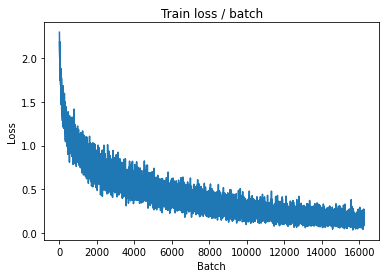


===============> Total time 15s	Avg loss 0.1401	Avg Prec@1 95.03 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.156s (0.156s)	Loss 0.8378 (0.8378)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.7505	Avg Prec@1 82.32 %	Avg Prec@5 98.96 %



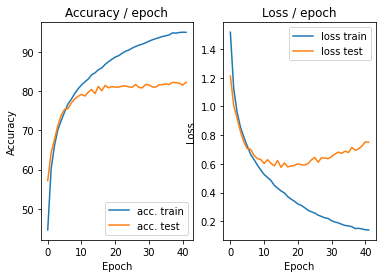

In [ ]:
main(batch_size=128,lr=0.0005,epochs=42,cuda=True)

## Modifications de la structure du réseau

On prend le problème du surapprentissage à l'envers par rapport à la data augmentation : plutôt que d'adapter les données, on corrige le modèle. 

### Régularisation Dropout

Ci-dessous les résultats pour deux paramétrages, p = 0.8 et p = 0.5.

In [ ]:
class ConvNet(nn.Module):
    def __init__(self):
        super(ConvNet, self).__init__()
        self.features = nn.Sequential(
            nn.Conv2d(3, 32, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(32, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(64, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0, ceil_mode=True), # ceil_mode ajouté !
        )
        self.classifier = nn.Sequential(
            nn.Linear(1024, 1000),
            nn.ReLU(),
            nn.Dropout(p=0.8),              # Régularisation par dropout
            nn.Linear(1000, 10)
        )

    # Méthode appelée quand on applique le réseau à un batch d'input
    def forward(self, input):
        bsize = input.size(0) # taille du batch
        output = self.features(input)    # on calcule la sortie des couches cv
        output = output.view(bsize, -1)  # on aplatit les feature map 2D en un
                                         # vecteur 1D pour chaque input
        output = self.classifier(output) # on calcule la sortie des couches fc
        return output

In [ ]:
main(batch_size=128,lr=0.1,epochs=80,cuda=True)

In [ ]:
class ConvNet(nn.Module):
    def __init__(self):
        super(ConvNet, self).__init__()
        self.features = nn.Sequential(
            nn.Conv2d(3, 32, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(32, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(64, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0, ceil_mode=True), # ceil_mode ajouté !
        )
        self.classifier = nn.Sequential(
            nn.Linear(1024, 1000),
            nn.ReLU(),
            nn.Dropout(p=0.5),              # Régularisation par dropout
            nn.Linear(1000, 10)
        )

    # Méthode appelée quand on applique le réseau à un batch d'input
    def forward(self, input):
        bsize = input.size(0) # taille du batch
        output = self.features(input)    # on calcule la sortie des couches cv
        output = output.view(bsize, -1)  # on aplatit les feature map 2D en un
                                         # vecteur 1D pour chaque input
        output = self.classifier(output) # on calcule la sortie des couches fc
        return output

Files already downloaded and verified
Files already downloaded and verified
=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.193s (0.193s)	Loss 2.3071 (2.3071)	Prec@1  10.9 ( 10.9)	Prec@5  44.5 ( 44.5)


<Figure size 432x288 with 0 Axes>

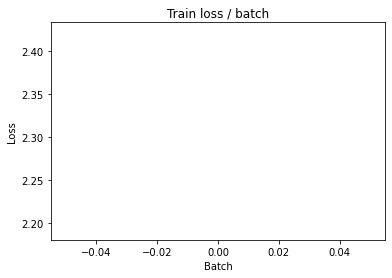

[TRAIN Batch 200/391]	Time 0.070s (0.042s)	Loss 1.3432 (1.8955)	Prec@1  51.6 ( 30.3)	Prec@5  95.3 ( 80.6)


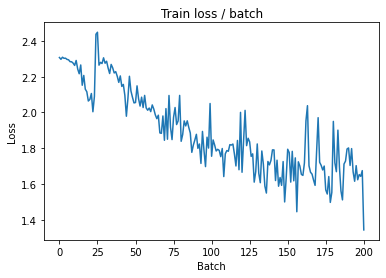


===============> Total time 16s	Avg loss 1.7179	Avg Prec@1 37.41 %	Avg Prec@5 85.83 %

[EVAL Batch 000/079]	Time 0.152s (0.152s)	Loss 1.9633 (1.9633)	Prec@1  38.3 ( 38.3)	Prec@5  85.2 ( 85.2)

===============> Total time 2s	Avg loss 1.8913	Avg Prec@1 39.35 %	Avg Prec@5 84.45 %



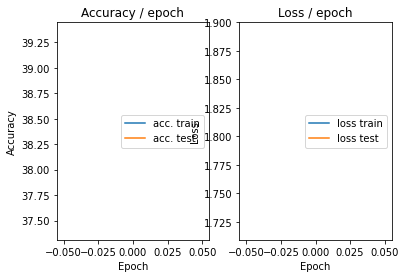

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.189s (0.189s)	Loss 1.8732 (1.8732)	Prec@1  42.2 ( 42.2)	Prec@5  85.9 ( 85.9)


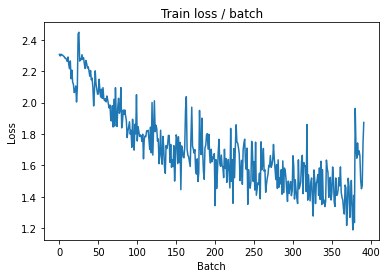

[TRAIN Batch 200/391]	Time 0.052s (0.041s)	Loss 1.1636 (1.3658)	Prec@1  56.2 ( 51.5)	Prec@5  94.5 ( 93.1)


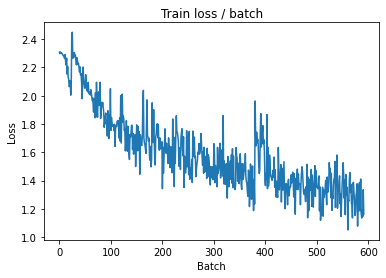


===============> Total time 16s	Avg loss 1.3052	Avg Prec@1 53.92 %	Avg Prec@5 93.71 %

[EVAL Batch 000/079]	Time 0.150s (0.150s)	Loss 1.2226 (1.2226)	Prec@1  59.4 ( 59.4)	Prec@5  95.3 ( 95.3)

===============> Total time 2s	Avg loss 1.1431	Avg Prec@1 60.26 %	Avg Prec@5 94.99 %



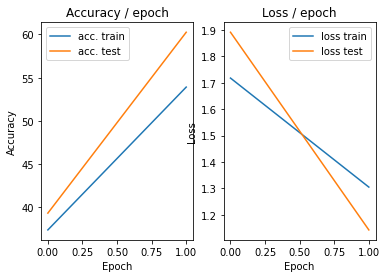

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.181s (0.181s)	Loss 1.0372 (1.0372)	Prec@1  63.3 ( 63.3)	Prec@5  98.4 ( 98.4)


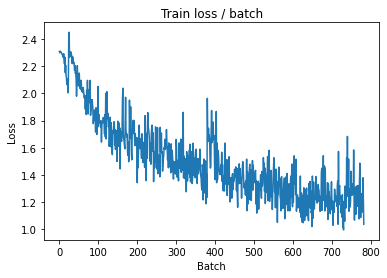

[TRAIN Batch 200/391]	Time 0.072s (0.041s)	Loss 1.1419 (1.1333)	Prec@1  64.1 ( 60.4)	Prec@5  94.5 ( 95.4)


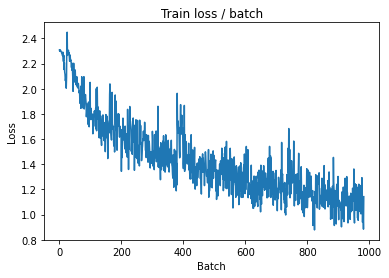


===============> Total time 15s	Avg loss 1.1136	Avg Prec@1 61.38 %	Avg Prec@5 95.56 %

[EVAL Batch 000/079]	Time 0.189s (0.189s)	Loss 1.0794 (1.0794)	Prec@1  63.3 ( 63.3)	Prec@5  94.5 ( 94.5)

===============> Total time 2s	Avg loss 1.1081	Avg Prec@1 62.41 %	Avg Prec@5 95.67 %



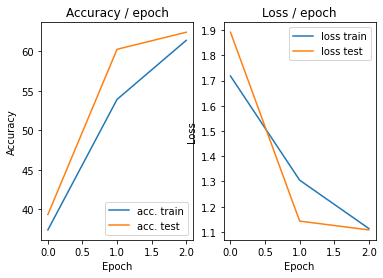

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.185s (0.185s)	Loss 1.2314 (1.2314)	Prec@1  55.5 ( 55.5)	Prec@5  97.7 ( 97.7)


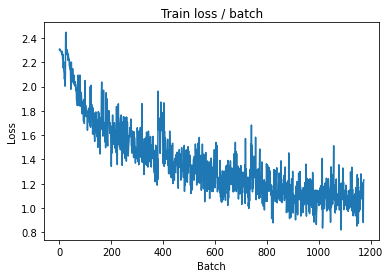

[TRAIN Batch 200/391]	Time 0.050s (0.041s)	Loss 1.1512 (1.0294)	Prec@1  62.5 ( 64.2)	Prec@5  95.3 ( 96.3)


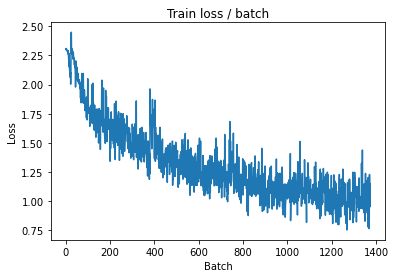


===============> Total time 16s	Avg loss 1.0200	Avg Prec@1 64.72 %	Avg Prec@5 96.37 %

[EVAL Batch 000/079]	Time 0.156s (0.156s)	Loss 0.8840 (0.8840)	Prec@1  73.4 ( 73.4)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.9314	Avg Prec@1 68.56 %	Avg Prec@5 97.19 %



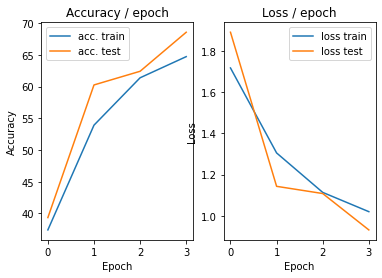

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.181s (0.181s)	Loss 0.8516 (0.8516)	Prec@1  69.5 ( 69.5)	Prec@5  96.9 ( 96.9)


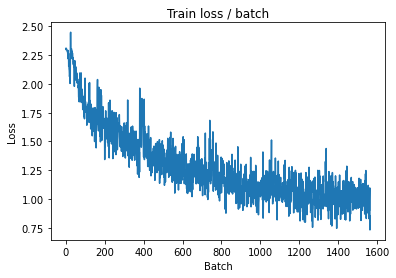

[TRAIN Batch 200/391]	Time 0.063s (0.042s)	Loss 0.9602 (0.9585)	Prec@1  70.3 ( 67.5)	Prec@5  92.2 ( 96.7)


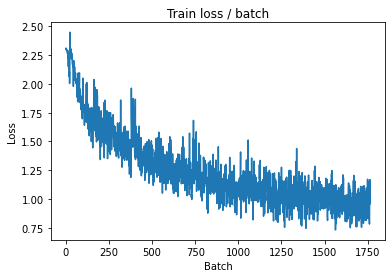


===============> Total time 16s	Avg loss 0.9513	Avg Prec@1 67.63 %	Avg Prec@5 96.72 %

[EVAL Batch 000/079]	Time 0.152s (0.152s)	Loss 0.9422 (0.9422)	Prec@1  67.2 ( 67.2)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.8754	Avg Prec@1 69.95 %	Avg Prec@5 97.23 %



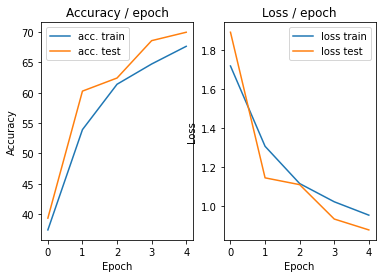

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.195s (0.195s)	Loss 0.7956 (0.7956)	Prec@1  71.9 ( 71.9)	Prec@5  98.4 ( 98.4)


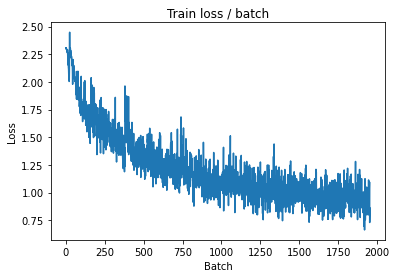

[TRAIN Batch 200/391]	Time 0.014s (0.041s)	Loss 0.9372 (0.8906)	Prec@1  68.0 ( 69.6)	Prec@5  95.3 ( 97.2)


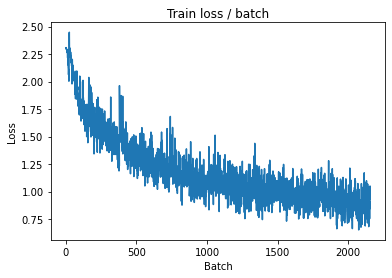


===============> Total time 16s	Avg loss 0.8979	Avg Prec@1 69.42 %	Avg Prec@5 97.09 %

[EVAL Batch 000/079]	Time 0.150s (0.150s)	Loss 0.9150 (0.9150)	Prec@1  66.4 ( 66.4)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.9082	Avg Prec@1 68.30 %	Avg Prec@5 97.08 %



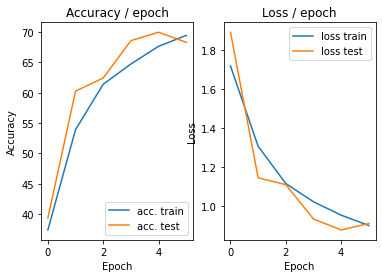

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.188s (0.188s)	Loss 1.0271 (1.0271)	Prec@1  67.2 ( 67.2)	Prec@5  96.1 ( 96.1)


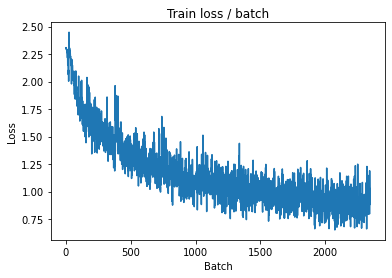

[TRAIN Batch 200/391]	Time 0.021s (0.041s)	Loss 0.6965 (0.8466)	Prec@1  75.8 ( 71.1)	Prec@5  98.4 ( 97.6)


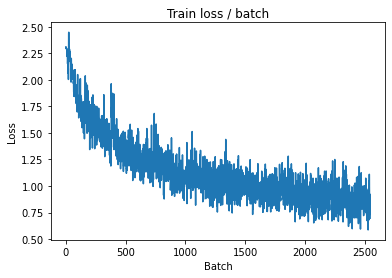


===============> Total time 15s	Avg loss 0.8559	Avg Prec@1 70.82 %	Avg Prec@5 97.41 %

[EVAL Batch 000/079]	Time 0.160s (0.160s)	Loss 0.7958 (0.7958)	Prec@1  71.9 ( 71.9)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.7813	Avg Prec@1 73.49 %	Avg Prec@5 97.93 %



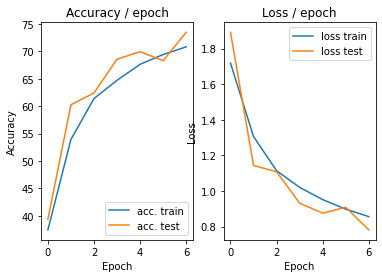

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.180s (0.180s)	Loss 0.7468 (0.7468)	Prec@1  72.7 ( 72.7)	Prec@5  99.2 ( 99.2)


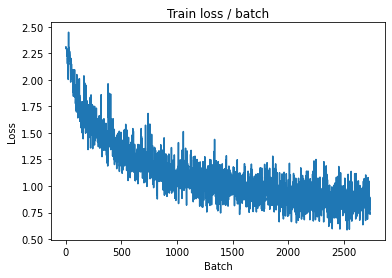

[TRAIN Batch 200/391]	Time 0.018s (0.041s)	Loss 0.7173 (0.8161)	Prec@1  72.7 ( 72.0)	Prec@5  94.5 ( 97.6)


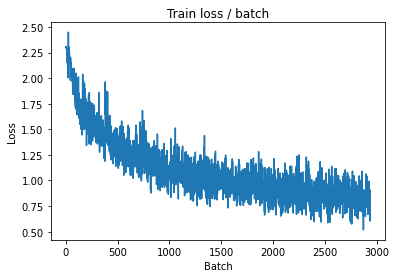


===============> Total time 15s	Avg loss 0.8179	Avg Prec@1 72.12 %	Avg Prec@5 97.56 %

[EVAL Batch 000/079]	Time 0.157s (0.157s)	Loss 0.7876 (0.7876)	Prec@1  74.2 ( 74.2)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.7940	Avg Prec@1 73.26 %	Avg Prec@5 97.74 %



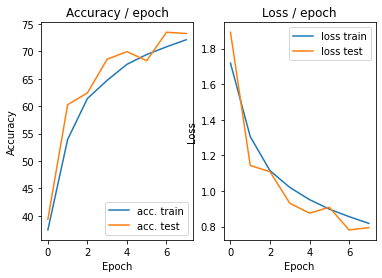

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.187s (0.187s)	Loss 0.7339 (0.7339)	Prec@1  75.8 ( 75.8)	Prec@5  98.4 ( 98.4)


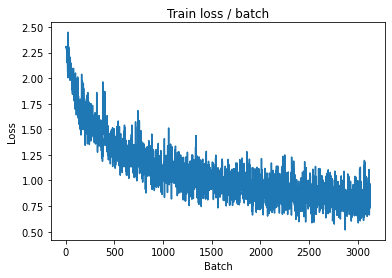

[TRAIN Batch 200/391]	Time 0.047s (0.041s)	Loss 0.8072 (0.7723)	Prec@1  72.7 ( 73.8)	Prec@5  98.4 ( 97.9)


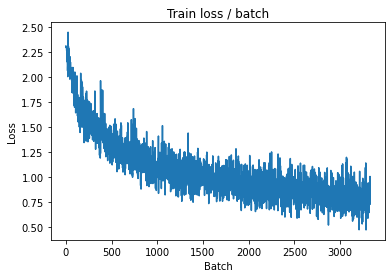


===============> Total time 15s	Avg loss 0.7840	Avg Prec@1 73.16 %	Avg Prec@5 97.78 %

[EVAL Batch 000/079]	Time 0.153s (0.153s)	Loss 0.8551 (0.8551)	Prec@1  72.7 ( 72.7)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 0.7539	Avg Prec@1 74.62 %	Avg Prec@5 97.86 %



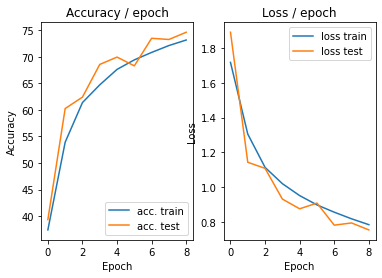

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.187s (0.187s)	Loss 0.7818 (0.7818)	Prec@1  76.6 ( 76.6)	Prec@5  97.7 ( 97.7)


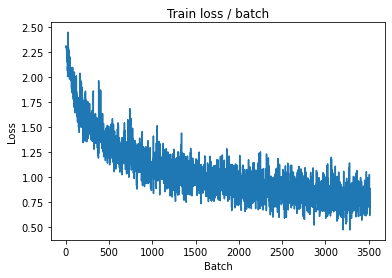

[TRAIN Batch 200/391]	Time 0.056s (0.042s)	Loss 0.6662 (0.7644)	Prec@1  75.0 ( 74.1)	Prec@5  98.4 ( 97.9)


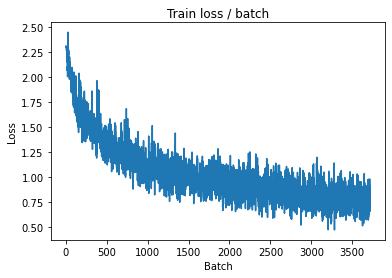


===============> Total time 15s	Avg loss 0.7613	Avg Prec@1 74.18 %	Avg Prec@5 97.92 %

[EVAL Batch 000/079]	Time 0.165s (0.165s)	Loss 0.7763 (0.7763)	Prec@1  78.1 ( 78.1)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.7754	Avg Prec@1 74.53 %	Avg Prec@5 98.04 %



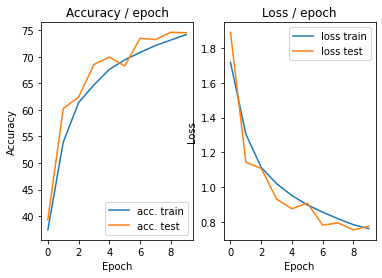

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.174s (0.174s)	Loss 0.8242 (0.8242)	Prec@1  74.2 ( 74.2)	Prec@5  99.2 ( 99.2)


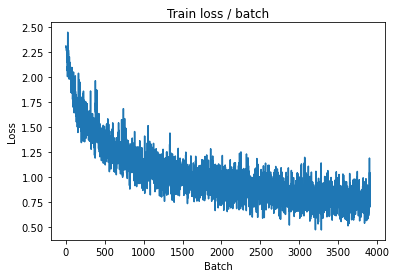

[TRAIN Batch 200/391]	Time 0.066s (0.041s)	Loss 0.6636 (0.7172)	Prec@1  78.1 ( 75.5)	Prec@5  97.7 ( 98.1)


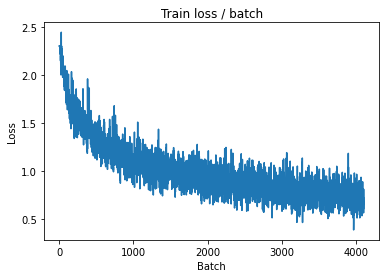


===============> Total time 15s	Avg loss 0.7281	Avg Prec@1 75.19 %	Avg Prec@5 98.07 %

[EVAL Batch 000/079]	Time 0.148s (0.148s)	Loss 0.7227 (0.7227)	Prec@1  75.8 ( 75.8)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.7046	Avg Prec@1 76.40 %	Avg Prec@5 98.02 %



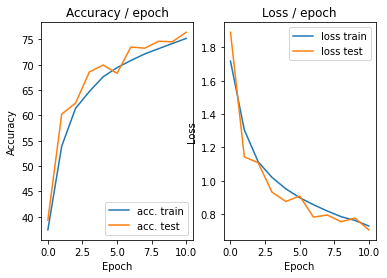

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.189s (0.189s)	Loss 0.8603 (0.8603)	Prec@1  70.3 ( 70.3)	Prec@5  96.9 ( 96.9)


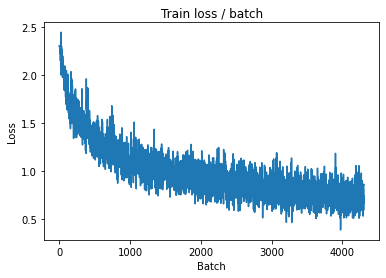

[TRAIN Batch 200/391]	Time 0.014s (0.040s)	Loss 0.7801 (0.6975)	Prec@1  78.9 ( 76.4)	Prec@5  98.4 ( 98.3)


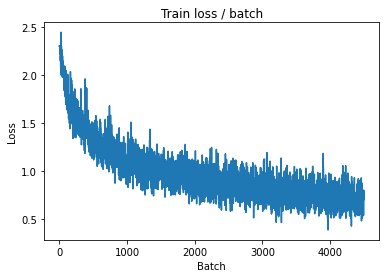


===============> Total time 15s	Avg loss 0.7031	Avg Prec@1 76.17 %	Avg Prec@5 98.14 %

[EVAL Batch 000/079]	Time 0.162s (0.162s)	Loss 0.6516 (0.6516)	Prec@1  79.7 ( 79.7)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.6942	Avg Prec@1 76.77 %	Avg Prec@5 98.23 %



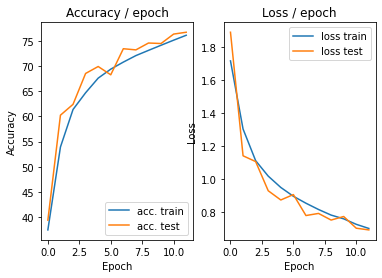

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.188s (0.188s)	Loss 0.7431 (0.7431)	Prec@1  72.7 ( 72.7)	Prec@5  99.2 ( 99.2)


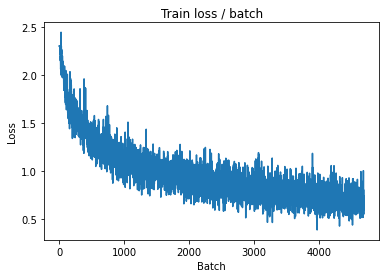

[TRAIN Batch 200/391]	Time 0.055s (0.041s)	Loss 0.7580 (0.6793)	Prec@1  68.8 ( 76.8)	Prec@5  97.7 ( 98.4)


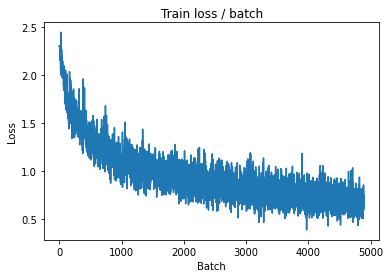


===============> Total time 15s	Avg loss 0.6847	Avg Prec@1 76.65 %	Avg Prec@5 98.38 %

[EVAL Batch 000/079]	Time 0.162s (0.162s)	Loss 0.6303 (0.6303)	Prec@1  80.5 ( 80.5)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.7405	Avg Prec@1 75.44 %	Avg Prec@5 97.87 %



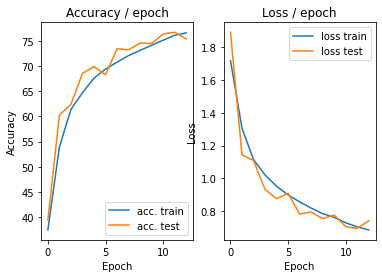

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.182s (0.182s)	Loss 0.7622 (0.7622)	Prec@1  76.6 ( 76.6)	Prec@5  99.2 ( 99.2)


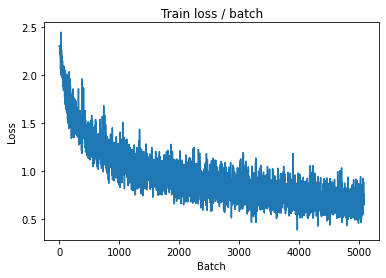

[TRAIN Batch 200/391]	Time 0.061s (0.041s)	Loss 0.5453 (0.6460)	Prec@1  77.3 ( 78.1)	Prec@5  99.2 ( 98.4)


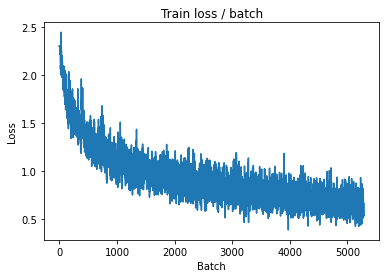


===============> Total time 15s	Avg loss 0.6607	Avg Prec@1 77.58 %	Avg Prec@5 98.41 %

[EVAL Batch 000/079]	Time 0.158s (0.158s)	Loss 0.6821 (0.6821)	Prec@1  77.3 ( 77.3)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.6660	Avg Prec@1 77.96 %	Avg Prec@5 98.37 %



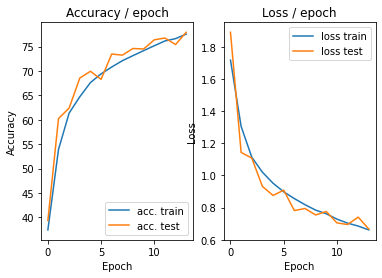

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.185s (0.185s)	Loss 0.6576 (0.6576)	Prec@1  82.0 ( 82.0)	Prec@5  99.2 ( 99.2)


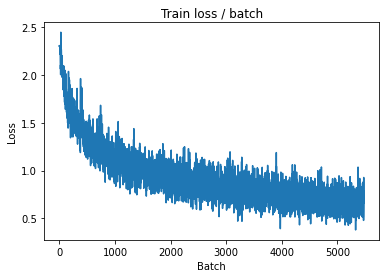

[TRAIN Batch 200/391]	Time 0.054s (0.040s)	Loss 0.6097 (0.6277)	Prec@1  78.9 ( 78.6)	Prec@5  98.4 ( 98.6)


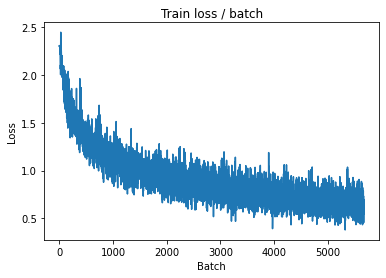


===============> Total time 15s	Avg loss 0.6370	Avg Prec@1 78.30 %	Avg Prec@5 98.57 %

[EVAL Batch 000/079]	Time 0.149s (0.149s)	Loss 0.6465 (0.6465)	Prec@1  75.8 ( 75.8)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6641	Avg Prec@1 78.20 %	Avg Prec@5 98.31 %



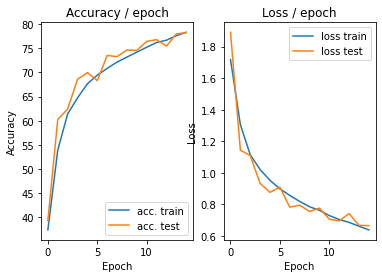

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.191s (0.191s)	Loss 0.6978 (0.6978)	Prec@1  69.5 ( 69.5)	Prec@5 100.0 (100.0)


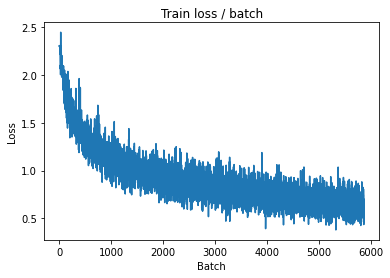

[TRAIN Batch 200/391]	Time 0.070s (0.041s)	Loss 0.6336 (0.6189)	Prec@1  83.6 ( 78.9)	Prec@5  97.7 ( 98.6)


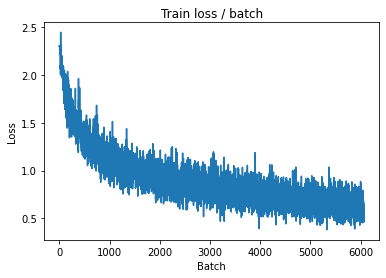


===============> Total time 15s	Avg loss 0.6184	Avg Prec@1 78.92 %	Avg Prec@5 98.63 %

[EVAL Batch 000/079]	Time 0.146s (0.146s)	Loss 0.6968 (0.6968)	Prec@1  78.9 ( 78.9)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6655	Avg Prec@1 77.76 %	Avg Prec@5 98.34 %



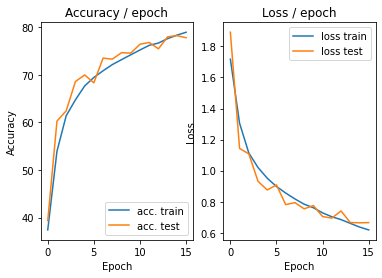

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.189s (0.189s)	Loss 0.4971 (0.4971)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)


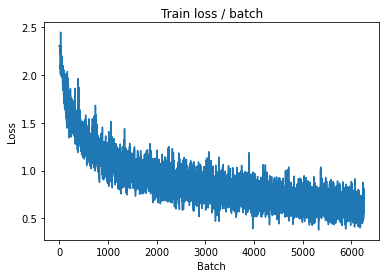

[TRAIN Batch 200/391]	Time 0.067s (0.041s)	Loss 0.4204 (0.5869)	Prec@1  86.7 ( 79.6)	Prec@5 100.0 ( 98.8)


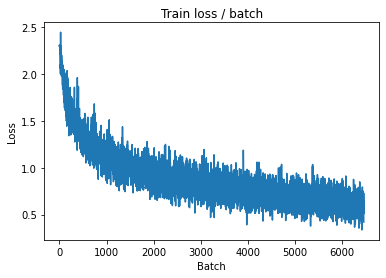


===============> Total time 15s	Avg loss 0.5946	Avg Prec@1 79.58 %	Avg Prec@5 98.76 %

[EVAL Batch 000/079]	Time 0.156s (0.156s)	Loss 0.6955 (0.6955)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6942	Avg Prec@1 77.80 %	Avg Prec@5 98.36 %



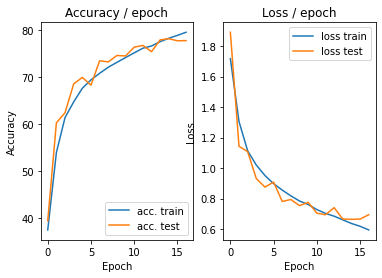

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.182s (0.182s)	Loss 0.5612 (0.5612)	Prec@1  76.6 ( 76.6)	Prec@5  97.7 ( 97.7)


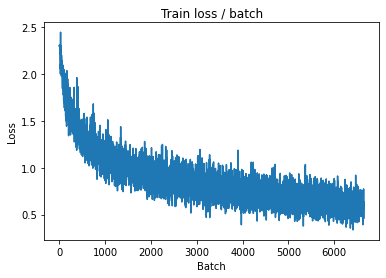

[TRAIN Batch 200/391]	Time 0.066s (0.041s)	Loss 0.6721 (0.5744)	Prec@1  83.6 ( 80.2)	Prec@5  98.4 ( 98.8)


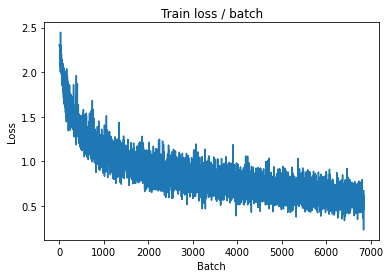


===============> Total time 15s	Avg loss 0.5776	Avg Prec@1 80.13 %	Avg Prec@5 98.79 %

[EVAL Batch 000/079]	Time 0.166s (0.166s)	Loss 0.6035 (0.6035)	Prec@1  82.0 ( 82.0)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6394	Avg Prec@1 78.72 %	Avg Prec@5 98.66 %



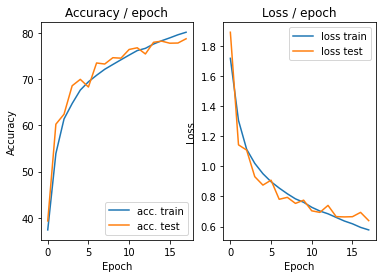

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.177s (0.177s)	Loss 0.5097 (0.5097)	Prec@1  82.8 ( 82.8)	Prec@5 100.0 (100.0)


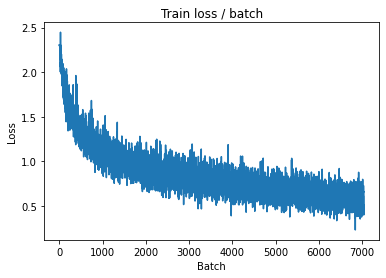

[TRAIN Batch 200/391]	Time 0.065s (0.041s)	Loss 0.7883 (0.5565)	Prec@1  73.4 ( 80.7)	Prec@5  96.1 ( 98.8)


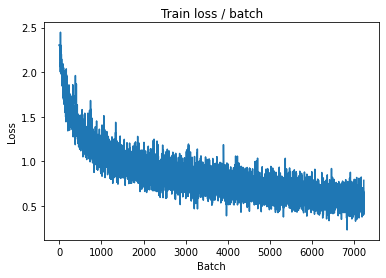


===============> Total time 15s	Avg loss 0.5655	Avg Prec@1 80.50 %	Avg Prec@5 98.81 %

[EVAL Batch 000/079]	Time 0.152s (0.152s)	Loss 0.6828 (0.6828)	Prec@1  77.3 ( 77.3)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6192	Avg Prec@1 79.71 %	Avg Prec@5 98.78 %



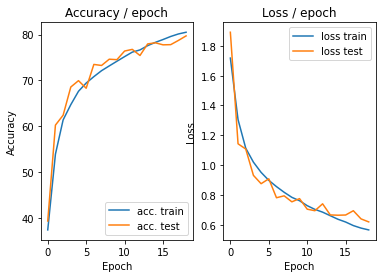

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.187s (0.187s)	Loss 0.4162 (0.4162)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)


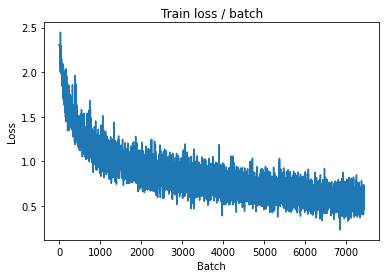

[TRAIN Batch 200/391]	Time 0.042s (0.042s)	Loss 0.4950 (0.5509)	Prec@1  85.9 ( 81.0)	Prec@5  99.2 ( 99.0)


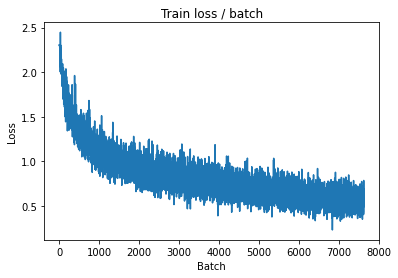


===============> Total time 15s	Avg loss 0.5491	Avg Prec@1 81.05 %	Avg Prec@5 99.01 %

[EVAL Batch 000/079]	Time 0.162s (0.162s)	Loss 0.6608 (0.6608)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6268	Avg Prec@1 79.29 %	Avg Prec@5 98.61 %



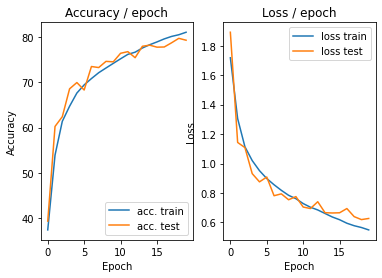

=== EPOCH 21 =====

[TRAIN Batch 000/391]	Time 0.165s (0.165s)	Loss 0.7813 (0.7813)	Prec@1  78.1 ( 78.1)	Prec@5  96.9 ( 96.9)


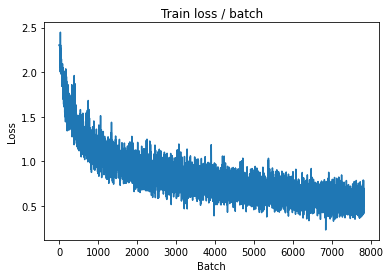

[TRAIN Batch 200/391]	Time 0.014s (0.041s)	Loss 0.5326 (0.5286)	Prec@1  85.2 ( 82.0)	Prec@5  98.4 ( 99.0)


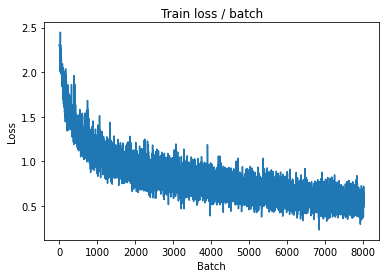


===============> Total time 15s	Avg loss 0.5310	Avg Prec@1 81.79 %	Avg Prec@5 99.05 %

[EVAL Batch 000/079]	Time 0.148s (0.148s)	Loss 0.6213 (0.6213)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6080	Avg Prec@1 79.83 %	Avg Prec@5 98.77 %



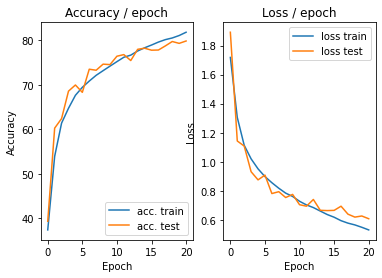

=== EPOCH 22 =====

[TRAIN Batch 000/391]	Time 0.200s (0.200s)	Loss 0.5202 (0.5202)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)


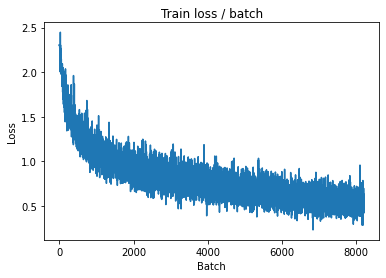

[TRAIN Batch 200/391]	Time 0.015s (0.042s)	Loss 0.5824 (0.4928)	Prec@1  80.5 ( 82.8)	Prec@5  99.2 ( 99.2)


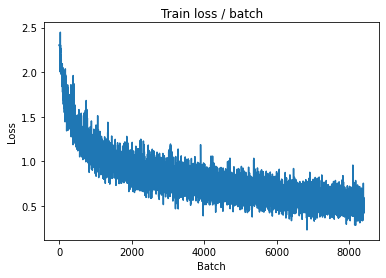


===============> Total time 15s	Avg loss 0.5111	Avg Prec@1 82.42 %	Avg Prec@5 99.08 %

[EVAL Batch 000/079]	Time 0.151s (0.151s)	Loss 0.5262 (0.5262)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.5946	Avg Prec@1 80.69 %	Avg Prec@5 98.63 %



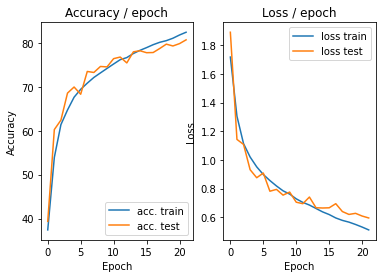

=== EPOCH 23 =====

[TRAIN Batch 000/391]	Time 0.165s (0.165s)	Loss 0.4254 (0.4254)	Prec@1  87.5 ( 87.5)	Prec@5  97.7 ( 97.7)


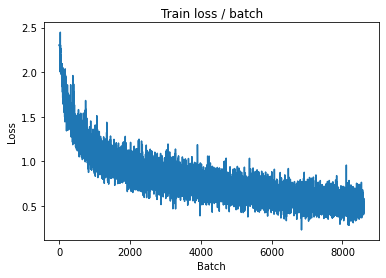

[TRAIN Batch 200/391]	Time 0.053s (0.041s)	Loss 0.4433 (0.4957)	Prec@1  83.6 ( 83.0)	Prec@5  99.2 ( 99.1)


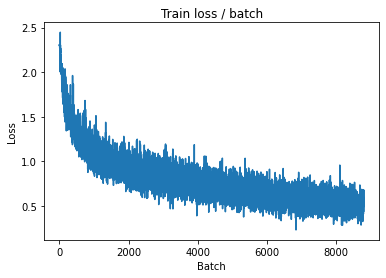


===============> Total time 15s	Avg loss 0.5015	Avg Prec@1 82.81 %	Avg Prec@5 99.10 %

[EVAL Batch 000/079]	Time 0.153s (0.153s)	Loss 0.5718 (0.5718)	Prec@1  82.0 ( 82.0)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.6065	Avg Prec@1 80.07 %	Avg Prec@5 98.80 %



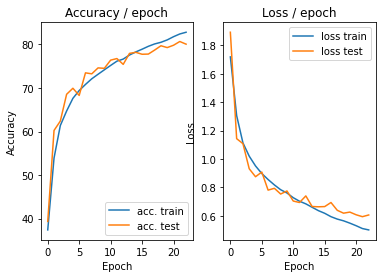

=== EPOCH 24 =====

[TRAIN Batch 000/391]	Time 0.183s (0.183s)	Loss 0.4987 (0.4987)	Prec@1  84.4 ( 84.4)	Prec@5  96.9 ( 96.9)


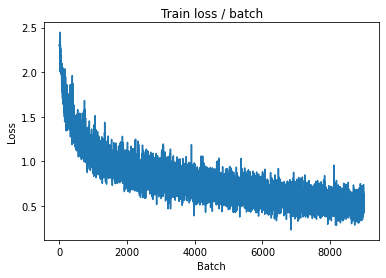

[TRAIN Batch 200/391]	Time 0.069s (0.041s)	Loss 0.4582 (0.4753)	Prec@1  81.2 ( 83.5)	Prec@5 100.0 ( 99.3)


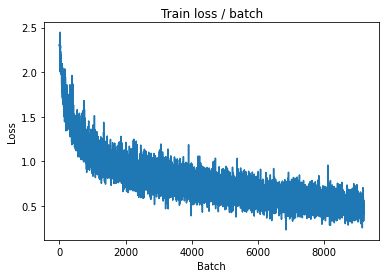


===============> Total time 15s	Avg loss 0.4766	Avg Prec@1 83.46 %	Avg Prec@5 99.22 %

[EVAL Batch 000/079]	Time 0.151s (0.151s)	Loss 0.6097 (0.6097)	Prec@1  81.2 ( 81.2)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.5953	Avg Prec@1 81.28 %	Avg Prec@5 98.79 %



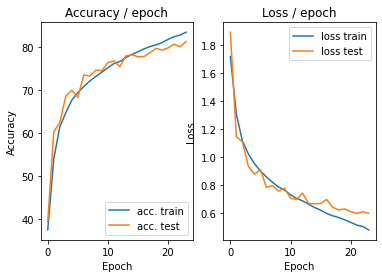

=== EPOCH 25 =====

[TRAIN Batch 000/391]	Time 0.179s (0.179s)	Loss 0.5274 (0.5274)	Prec@1  82.0 ( 82.0)	Prec@5  97.7 ( 97.7)


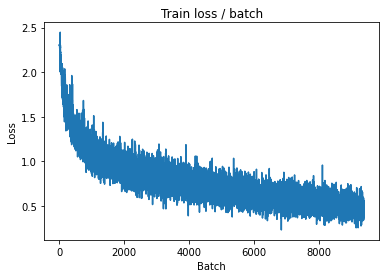

[TRAIN Batch 200/391]	Time 0.014s (0.040s)	Loss 0.3660 (0.4588)	Prec@1  89.1 ( 83.9)	Prec@5 100.0 ( 99.2)


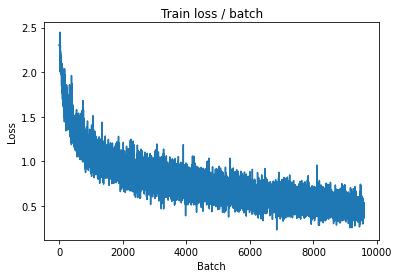


===============> Total time 15s	Avg loss 0.4641	Avg Prec@1 84.01 %	Avg Prec@5 99.28 %

[EVAL Batch 000/079]	Time 0.149s (0.149s)	Loss 0.5626 (0.5626)	Prec@1  82.0 ( 82.0)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.5804	Avg Prec@1 81.55 %	Avg Prec@5 98.66 %



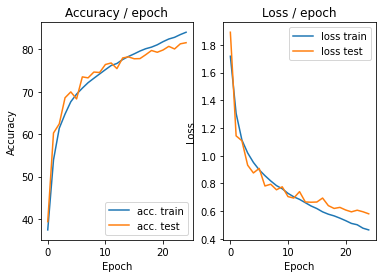

=== EPOCH 26 =====

[TRAIN Batch 000/391]	Time 0.195s (0.195s)	Loss 0.5216 (0.5216)	Prec@1  85.2 ( 85.2)	Prec@5 100.0 (100.0)


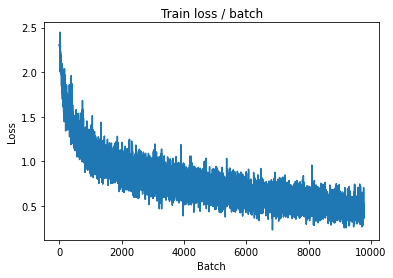

[TRAIN Batch 200/391]	Time 0.018s (0.040s)	Loss 0.4493 (0.4505)	Prec@1  79.7 ( 84.4)	Prec@5 100.0 ( 99.4)


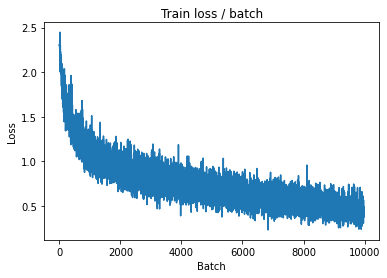


===============> Total time 15s	Avg loss 0.4553	Avg Prec@1 84.16 %	Avg Prec@5 99.29 %

[EVAL Batch 000/079]	Time 0.154s (0.154s)	Loss 0.5130 (0.5130)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6018	Avg Prec@1 80.23 %	Avg Prec@5 98.86 %



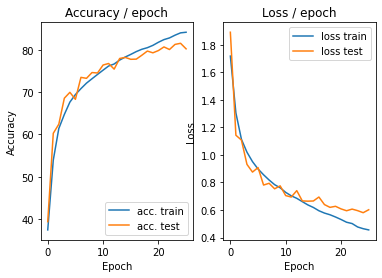

=== EPOCH 27 =====

[TRAIN Batch 000/391]	Time 0.182s (0.182s)	Loss 0.4419 (0.4419)	Prec@1  80.5 ( 80.5)	Prec@5  99.2 ( 99.2)


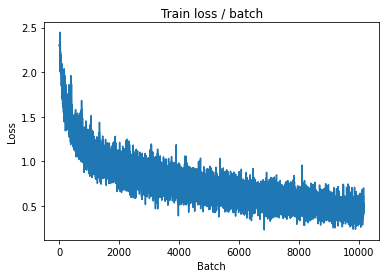

[TRAIN Batch 200/391]	Time 0.047s (0.041s)	Loss 0.2588 (0.4403)	Prec@1  92.2 ( 84.8)	Prec@5 100.0 ( 99.4)


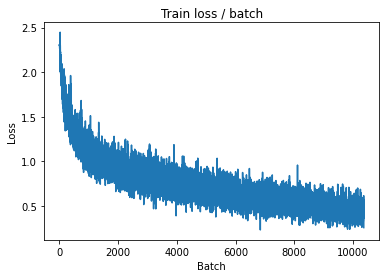


===============> Total time 15s	Avg loss 0.4398	Avg Prec@1 84.73 %	Avg Prec@5 99.38 %

[EVAL Batch 000/079]	Time 0.147s (0.147s)	Loss 0.6023 (0.6023)	Prec@1  80.5 ( 80.5)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.5612	Avg Prec@1 81.67 %	Avg Prec@5 98.75 %



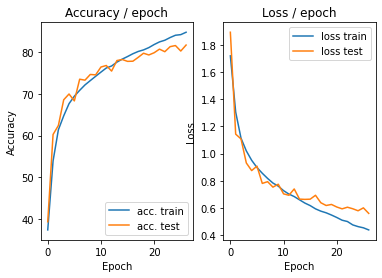

=== EPOCH 28 =====

[TRAIN Batch 000/391]	Time 0.181s (0.181s)	Loss 0.4001 (0.4001)	Prec@1  88.3 ( 88.3)	Prec@5 100.0 (100.0)


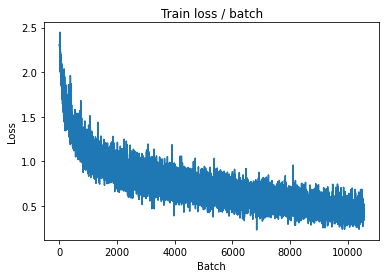

[TRAIN Batch 200/391]	Time 0.050s (0.041s)	Loss 0.3593 (0.4256)	Prec@1  91.4 ( 85.1)	Prec@5 100.0 ( 99.5)


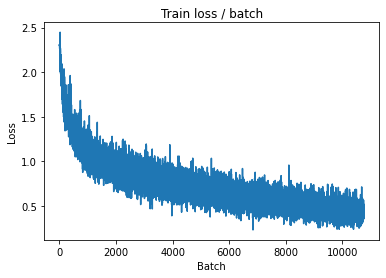


===============> Total time 15s	Avg loss 0.4291	Avg Prec@1 84.91 %	Avg Prec@5 99.42 %

[EVAL Batch 000/079]	Time 0.154s (0.154s)	Loss 0.5294 (0.5294)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.5623	Avg Prec@1 81.71 %	Avg Prec@5 98.93 %



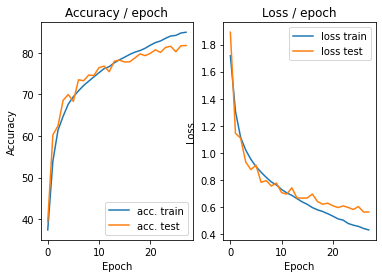

=== EPOCH 29 =====

[TRAIN Batch 000/391]	Time 0.183s (0.183s)	Loss 0.4256 (0.4256)	Prec@1  85.9 ( 85.9)	Prec@5 100.0 (100.0)


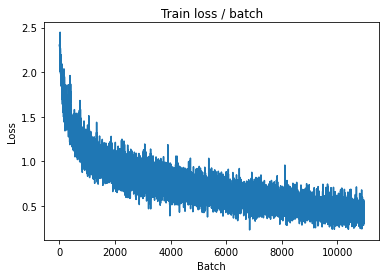

[TRAIN Batch 200/391]	Time 0.031s (0.041s)	Loss 0.4100 (0.4122)	Prec@1  87.5 ( 85.4)	Prec@5 100.0 ( 99.4)


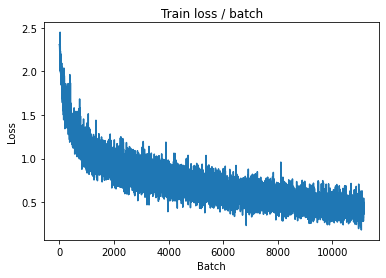


===============> Total time 15s	Avg loss 0.4141	Avg Prec@1 85.36 %	Avg Prec@5 99.43 %

[EVAL Batch 000/079]	Time 0.150s (0.150s)	Loss 0.6462 (0.6462)	Prec@1  80.5 ( 80.5)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.5879	Avg Prec@1 81.59 %	Avg Prec@5 98.84 %



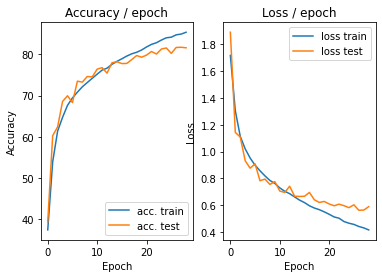

=== EPOCH 30 =====

[TRAIN Batch 000/391]	Time 0.179s (0.179s)	Loss 0.5076 (0.5076)	Prec@1  82.8 ( 82.8)	Prec@5 100.0 (100.0)


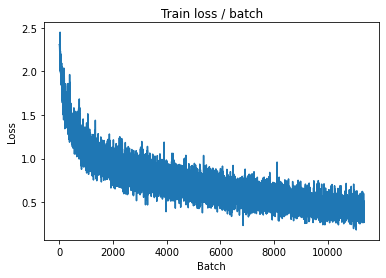

[TRAIN Batch 200/391]	Time 0.066s (0.041s)	Loss 0.5611 (0.4130)	Prec@1  82.0 ( 85.3)	Prec@5  99.2 ( 99.5)


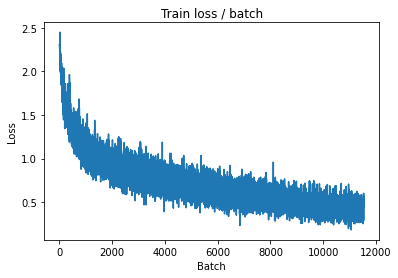


===============> Total time 15s	Avg loss 0.4153	Avg Prec@1 85.52 %	Avg Prec@5 99.45 %

[EVAL Batch 000/079]	Time 0.155s (0.155s)	Loss 0.5996 (0.5996)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.5768	Avg Prec@1 81.91 %	Avg Prec@5 98.86 %



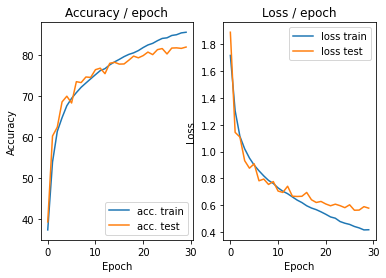

=== EPOCH 31 =====

[TRAIN Batch 000/391]	Time 0.185s (0.185s)	Loss 0.5382 (0.5382)	Prec@1  86.7 ( 86.7)	Prec@5  98.4 ( 98.4)


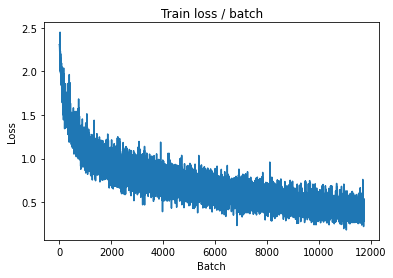

[TRAIN Batch 200/391]	Time 0.069s (0.041s)	Loss 0.4582 (0.3881)	Prec@1  88.3 ( 86.4)	Prec@5  98.4 ( 99.5)


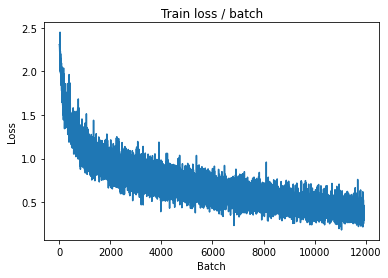


===============> Total time 15s	Avg loss 0.3945	Avg Prec@1 86.10 %	Avg Prec@5 99.51 %

[EVAL Batch 000/079]	Time 0.160s (0.160s)	Loss 0.6170 (0.6170)	Prec@1  82.0 ( 82.0)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.5707	Avg Prec@1 82.51 %	Avg Prec@5 98.88 %



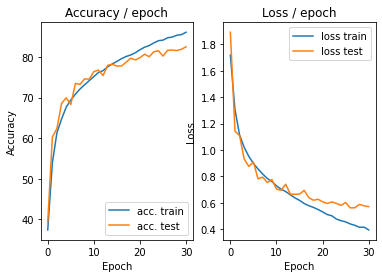

=== EPOCH 32 =====

[TRAIN Batch 000/391]	Time 0.182s (0.182s)	Loss 0.2987 (0.2987)	Prec@1  89.8 ( 89.8)	Prec@5  99.2 ( 99.2)


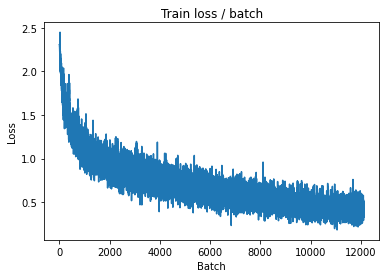

[TRAIN Batch 200/391]	Time 0.017s (0.041s)	Loss 0.3855 (0.3864)	Prec@1  89.1 ( 86.4)	Prec@5  98.4 ( 99.5)


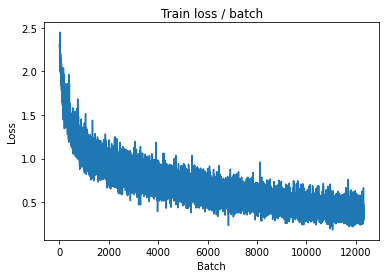


===============> Total time 15s	Avg loss 0.3888	Avg Prec@1 86.37 %	Avg Prec@5 99.52 %

[EVAL Batch 000/079]	Time 0.166s (0.166s)	Loss 0.5412 (0.5412)	Prec@1  82.0 ( 82.0)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.5543	Avg Prec@1 82.38 %	Avg Prec@5 98.91 %



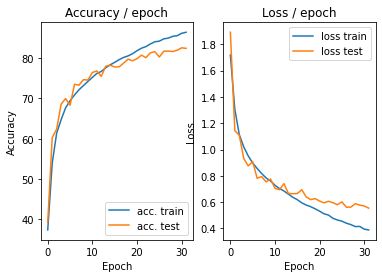

=== EPOCH 33 =====

[TRAIN Batch 000/391]	Time 0.177s (0.177s)	Loss 0.5857 (0.5857)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)


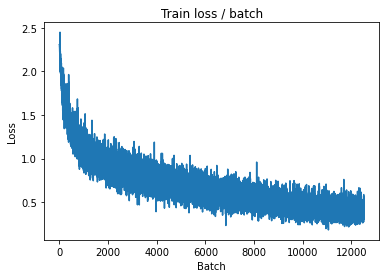

[TRAIN Batch 200/391]	Time 0.017s (0.040s)	Loss 0.3556 (0.3786)	Prec@1  85.9 ( 86.8)	Prec@5  99.2 ( 99.6)


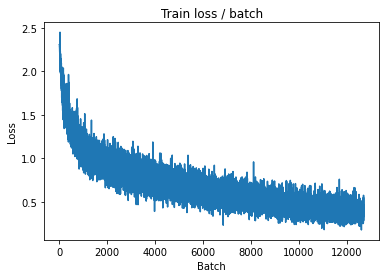


===============> Total time 15s	Avg loss 0.3760	Avg Prec@1 86.83 %	Avg Prec@5 99.55 %

[EVAL Batch 000/079]	Time 0.141s (0.141s)	Loss 0.6190 (0.6190)	Prec@1  80.5 ( 80.5)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.5599	Avg Prec@1 82.48 %	Avg Prec@5 98.83 %



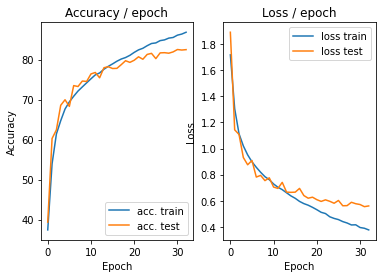

=== EPOCH 34 =====

[TRAIN Batch 000/391]	Time 0.195s (0.195s)	Loss 0.2804 (0.2804)	Prec@1  88.3 ( 88.3)	Prec@5 100.0 (100.0)


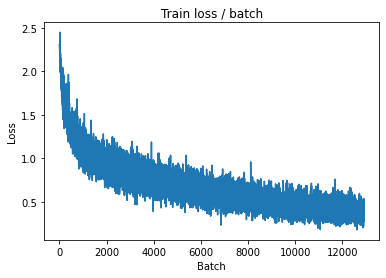

[TRAIN Batch 200/391]	Time 0.068s (0.042s)	Loss 0.3190 (0.3754)	Prec@1  86.7 ( 86.9)	Prec@5  99.2 ( 99.6)


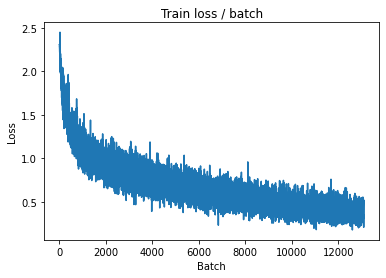


===============> Total time 15s	Avg loss 0.3723	Avg Prec@1 86.96 %	Avg Prec@5 99.60 %

[EVAL Batch 000/079]	Time 0.140s (0.140s)	Loss 0.5787 (0.5787)	Prec@1  81.2 ( 81.2)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.5685	Avg Prec@1 82.55 %	Avg Prec@5 98.90 %



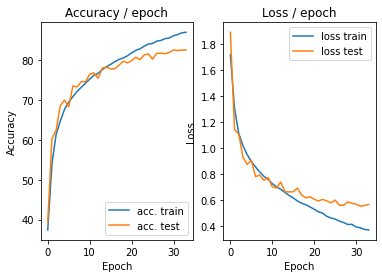

=== EPOCH 35 =====

[TRAIN Batch 000/391]	Time 0.183s (0.183s)	Loss 0.2745 (0.2745)	Prec@1  88.3 ( 88.3)	Prec@5 100.0 (100.0)


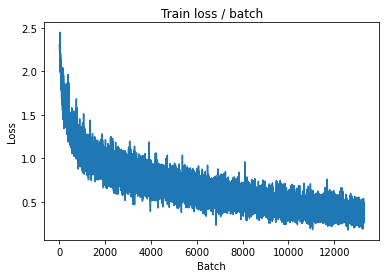

[TRAIN Batch 200/391]	Time 0.029s (0.041s)	Loss 0.3177 (0.3579)	Prec@1  88.3 ( 87.4)	Prec@5 100.0 ( 99.5)


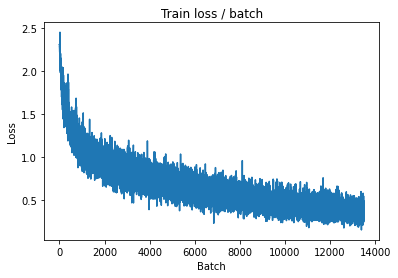


===============> Total time 15s	Avg loss 0.3619	Avg Prec@1 87.17 %	Avg Prec@5 99.59 %

[EVAL Batch 000/079]	Time 0.159s (0.159s)	Loss 0.5935 (0.5935)	Prec@1  81.2 ( 81.2)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.5508	Avg Prec@1 82.64 %	Avg Prec@5 98.88 %



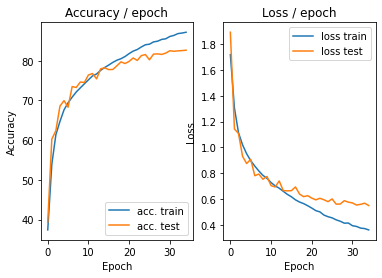

=== EPOCH 36 =====

[TRAIN Batch 000/391]	Time 0.186s (0.186s)	Loss 0.1815 (0.1815)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


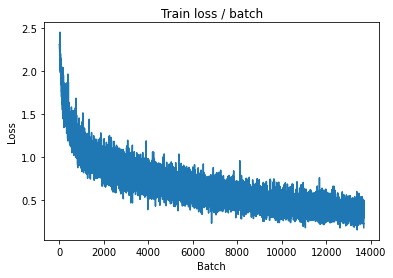

[TRAIN Batch 200/391]	Time 0.057s (0.041s)	Loss 0.3252 (0.3463)	Prec@1  88.3 ( 87.5)	Prec@5  99.2 ( 99.6)


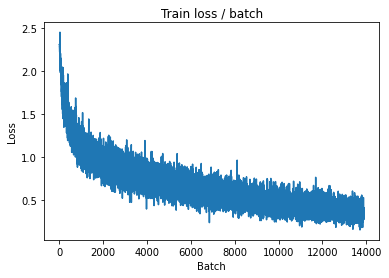


===============> Total time 15s	Avg loss 0.3517	Avg Prec@1 87.47 %	Avg Prec@5 99.59 %

[EVAL Batch 000/079]	Time 0.150s (0.150s)	Loss 0.4889 (0.4889)	Prec@1  82.0 ( 82.0)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.5537	Avg Prec@1 83.09 %	Avg Prec@5 99.05 %



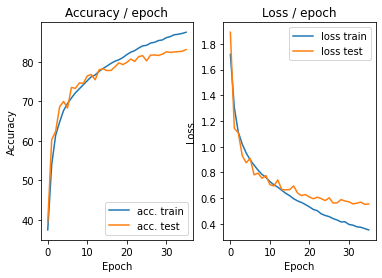

=== EPOCH 37 =====

[TRAIN Batch 000/391]	Time 0.191s (0.191s)	Loss 0.3951 (0.3951)	Prec@1  83.6 ( 83.6)	Prec@5  99.2 ( 99.2)


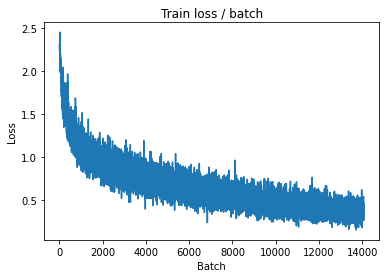

[TRAIN Batch 200/391]	Time 0.063s (0.040s)	Loss 0.2290 (0.3411)	Prec@1  91.4 ( 88.0)	Prec@5 100.0 ( 99.6)


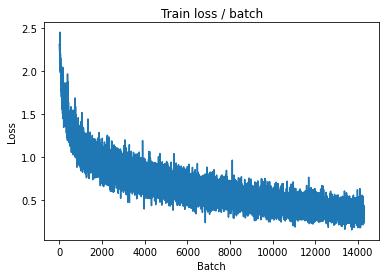


===============> Total time 15s	Avg loss 0.3507	Avg Prec@1 87.72 %	Avg Prec@5 99.63 %

[EVAL Batch 000/079]	Time 0.157s (0.157s)	Loss 0.5736 (0.5736)	Prec@1  83.6 ( 83.6)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.5483	Avg Prec@1 82.62 %	Avg Prec@5 98.97 %



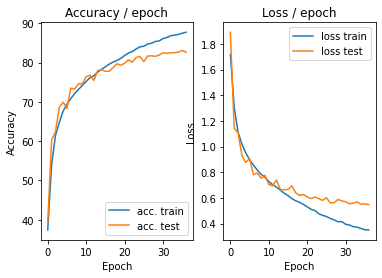

=== EPOCH 38 =====

[TRAIN Batch 000/391]	Time 0.183s (0.183s)	Loss 0.3444 (0.3444)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)


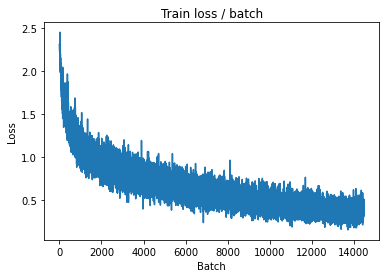

[TRAIN Batch 200/391]	Time 0.047s (0.040s)	Loss 0.3201 (0.3351)	Prec@1  89.1 ( 88.1)	Prec@5  99.2 ( 99.7)


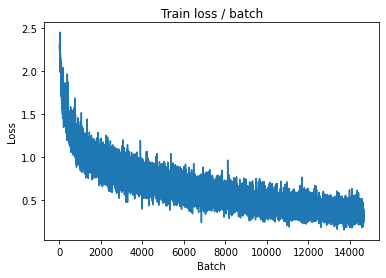


===============> Total time 15s	Avg loss 0.3397	Avg Prec@1 87.96 %	Avg Prec@5 99.64 %

[EVAL Batch 000/079]	Time 0.145s (0.145s)	Loss 0.5854 (0.5854)	Prec@1  82.8 ( 82.8)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.5526	Avg Prec@1 82.97 %	Avg Prec@5 99.11 %



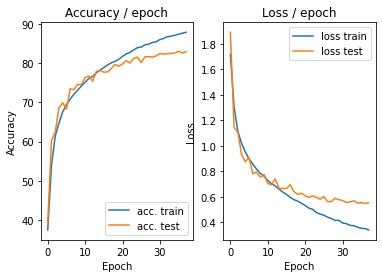

=== EPOCH 39 =====

[TRAIN Batch 000/391]	Time 0.194s (0.194s)	Loss 0.5729 (0.5729)	Prec@1  81.2 ( 81.2)	Prec@5  99.2 ( 99.2)


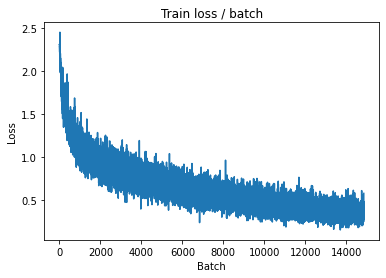

[TRAIN Batch 200/391]	Time 0.059s (0.041s)	Loss 0.1976 (0.3225)	Prec@1  92.2 ( 88.6)	Prec@5 100.0 ( 99.7)


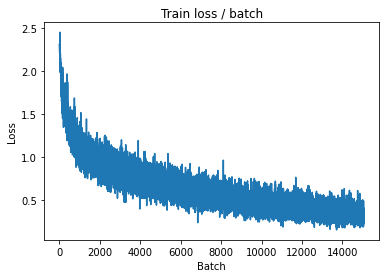


===============> Total time 15s	Avg loss 0.3258	Avg Prec@1 88.55 %	Avg Prec@5 99.69 %

[EVAL Batch 000/079]	Time 0.155s (0.155s)	Loss 0.4902 (0.4902)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.5345	Avg Prec@1 83.58 %	Avg Prec@5 99.04 %



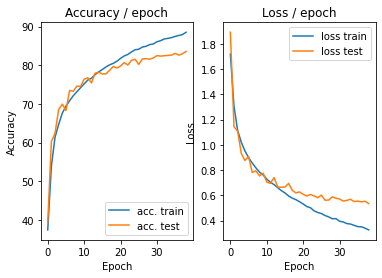

=== EPOCH 40 =====

[TRAIN Batch 000/391]	Time 0.177s (0.177s)	Loss 0.3106 (0.3106)	Prec@1  89.8 ( 89.8)	Prec@5 100.0 (100.0)


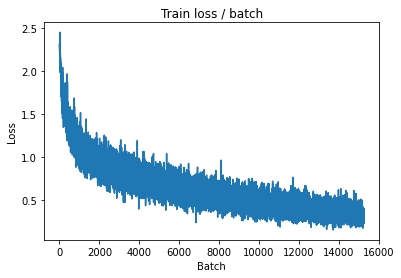

[TRAIN Batch 200/391]	Time 0.019s (0.040s)	Loss 0.2312 (0.3256)	Prec@1  90.6 ( 88.7)	Prec@5 100.0 ( 99.7)


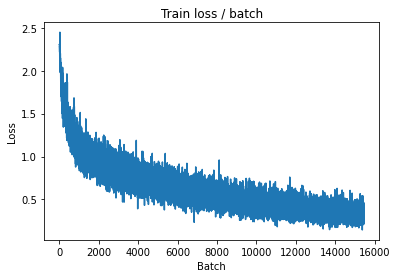


===============> Total time 15s	Avg loss 0.3288	Avg Prec@1 88.45 %	Avg Prec@5 99.65 %

[EVAL Batch 000/079]	Time 0.163s (0.163s)	Loss 0.5461 (0.5461)	Prec@1  85.2 ( 85.2)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.5360	Avg Prec@1 83.72 %	Avg Prec@5 99.02 %



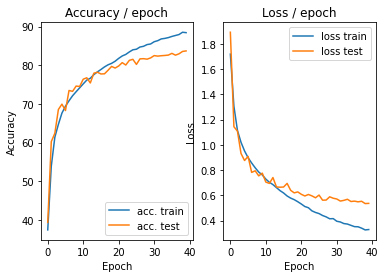

=== EPOCH 41 =====

[TRAIN Batch 000/391]	Time 0.174s (0.174s)	Loss 0.2840 (0.2840)	Prec@1  90.6 ( 90.6)	Prec@5  99.2 ( 99.2)


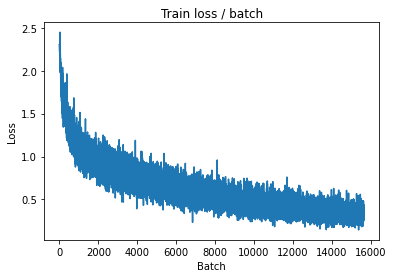

[TRAIN Batch 200/391]	Time 0.060s (0.040s)	Loss 0.3347 (0.3125)	Prec@1  88.3 ( 89.2)	Prec@5 100.0 ( 99.7)


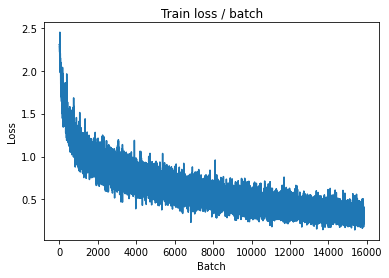


===============> Total time 15s	Avg loss 0.3179	Avg Prec@1 88.89 %	Avg Prec@5 99.73 %

[EVAL Batch 000/079]	Time 0.150s (0.150s)	Loss 0.5362 (0.5362)	Prec@1  84.4 ( 84.4)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.5379	Avg Prec@1 83.69 %	Avg Prec@5 99.04 %



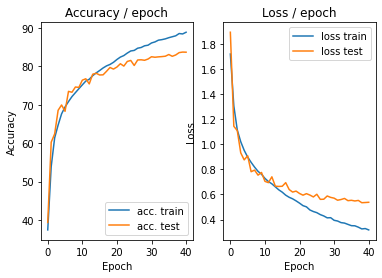

=== EPOCH 42 =====

[TRAIN Batch 000/391]	Time 0.181s (0.181s)	Loss 0.2275 (0.2275)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)


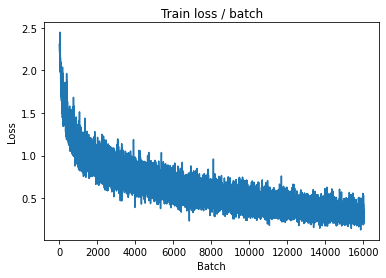

[TRAIN Batch 200/391]	Time 0.051s (0.041s)	Loss 0.2882 (0.3097)	Prec@1  89.1 ( 89.2)	Prec@5 100.0 ( 99.7)


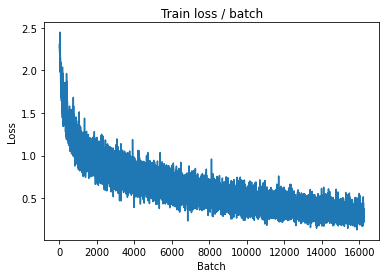


===============> Total time 15s	Avg loss 0.3119	Avg Prec@1 89.03 %	Avg Prec@5 99.68 %

[EVAL Batch 000/079]	Time 0.144s (0.144s)	Loss 0.5059 (0.5059)	Prec@1  83.6 ( 83.6)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.5308	Avg Prec@1 83.95 %	Avg Prec@5 99.10 %



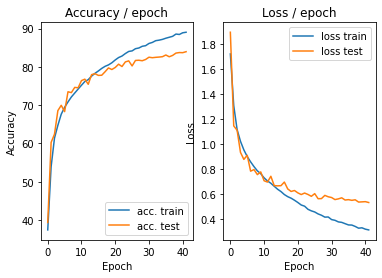

In [ ]:
main(batch_size=128,lr=0.1,epochs=42,cuda=True)

###  Batch normalization

In [15]:
class ConvNet(nn.Module):
    """
    Cette classe contient la structure du réseau de neurones
    """

    def __init__(self):
        super(ConvNet, self).__init__()
        # On définit d'abord les couches de convolution et de pooling comme un
        # groupe de couches `self.features` 
        self.features = nn.Sequential(
            nn.Conv2d(3, 32, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.BatchNorm2d(32),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(32, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.BatchNorm2d(64),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(64, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.BatchNorm2d(64),
            nn.MaxPool2d((2, 2), stride=2, padding=0, ceil_mode=True), # ceil_mode ajouté !
        )

        # On définit les couches fully connected comme un groupe de couches
        # `self.classifier`
        self.classifier = nn.Sequential(
            nn.Linear(1024, 1000),
            nn.ReLU(),
            nn.Dropout(p=0.5),  # Régularisation par dropout
            nn.Linear(1000, 10)
            # Rappel : Le softmax est inclus dans la loss, ne pas le mettre ici
        )

    # Méthode appelée quand on applique le réseau à un batch d'input
    def forward(self, input):
        bsize = input.size(0) # taille du batch
        output = self.features(input)    # on calcule la sortie des couches cv
        output = output.view(bsize, -1)  # on aplatit les feature map 2D en un
                                         # vecteur 1D pour chaque input
        output = self.classifier(output) # on calcule la sortie des couches fc
        return output

Files already downloaded and verified
Files already downloaded and verified
=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.251s (0.251s)	Loss 2.3600 (2.3600)	Prec@1   3.9 (  3.9)	Prec@5  57.0 ( 57.0)


<Figure size 432x288 with 0 Axes>

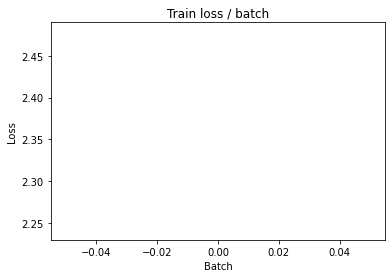

[TRAIN Batch 200/391]	Time 0.023s (0.040s)	Loss 1.6433 (1.6514)	Prec@1  49.2 ( 40.6)	Prec@5  89.8 ( 89.0)


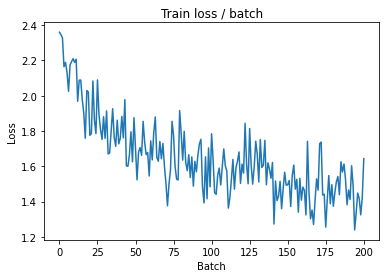


===============> Total time 15s	Avg loss 1.4770	Avg Prec@1 46.99 %	Avg Prec@5 91.54 %

[EVAL Batch 000/079]	Time 0.154s (0.154s)	Loss 1.0730 (1.0730)	Prec@1  65.6 ( 65.6)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 1.1516	Avg Prec@1 60.03 %	Avg Prec@5 95.76 %



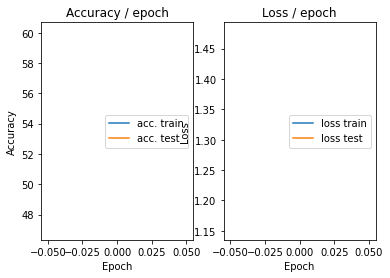

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.205s (0.205s)	Loss 1.3728 (1.3728)	Prec@1  49.2 ( 49.2)	Prec@5  96.1 ( 96.1)


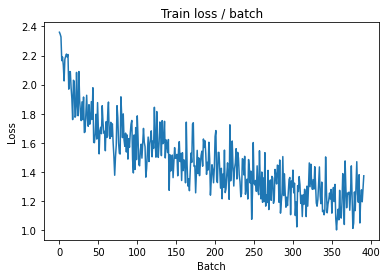

[TRAIN Batch 200/391]	Time 0.018s (0.041s)	Loss 1.0368 (1.0867)	Prec@1  63.3 ( 61.7)	Prec@5  95.3 ( 96.1)


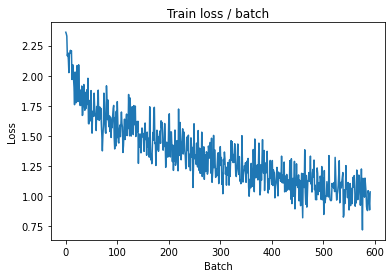


===============> Total time 15s	Avg loss 1.0286	Avg Prec@1 63.78 %	Avg Prec@5 96.54 %

[EVAL Batch 000/079]	Time 0.157s (0.157s)	Loss 0.7716 (0.7716)	Prec@1  73.4 ( 73.4)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.8702	Avg Prec@1 69.14 %	Avg Prec@5 97.56 %



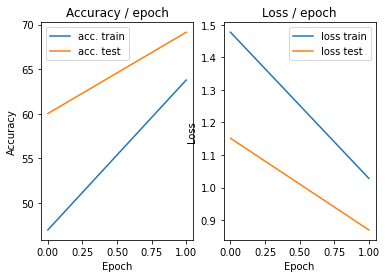

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.195s (0.195s)	Loss 0.9664 (0.9664)	Prec@1  59.4 ( 59.4)	Prec@5  99.2 ( 99.2)


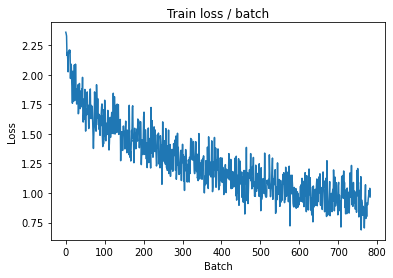

[TRAIN Batch 200/391]	Time 0.018s (0.042s)	Loss 0.8445 (0.8812)	Prec@1  75.0 ( 68.8)	Prec@5  97.7 ( 97.5)


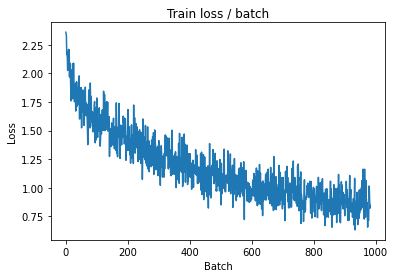


===============> Total time 16s	Avg loss 0.8572	Avg Prec@1 69.94 %	Avg Prec@5 97.63 %

[EVAL Batch 000/079]	Time 0.159s (0.159s)	Loss 0.6143 (0.6143)	Prec@1  82.0 ( 82.0)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.7631	Avg Prec@1 73.30 %	Avg Prec@5 98.21 %



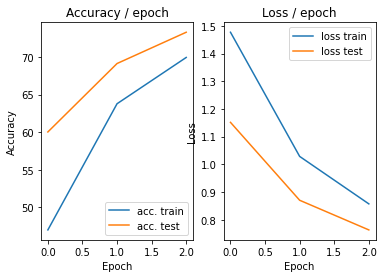

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.175s (0.175s)	Loss 0.8048 (0.8048)	Prec@1  74.2 ( 74.2)	Prec@5  98.4 ( 98.4)


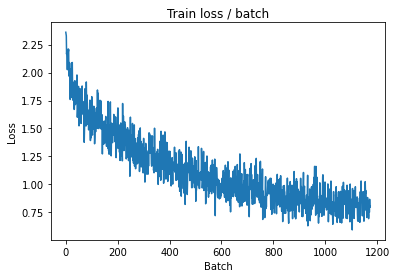

[TRAIN Batch 200/391]	Time 0.063s (0.041s)	Loss 0.8023 (0.7665)	Prec@1  72.7 ( 73.1)	Prec@5  99.2 ( 98.1)


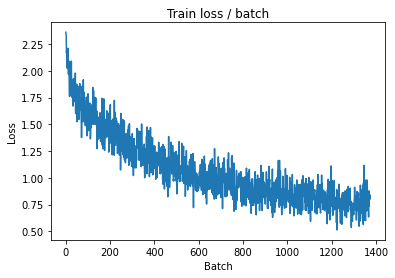


===============> Total time 15s	Avg loss 0.7606	Avg Prec@1 73.44 %	Avg Prec@5 98.09 %

[EVAL Batch 000/079]	Time 0.160s (0.160s)	Loss 0.6531 (0.6531)	Prec@1  77.3 ( 77.3)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6873	Avg Prec@1 76.42 %	Avg Prec@5 98.52 %



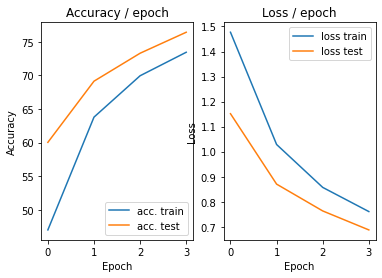

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.191s (0.191s)	Loss 0.8418 (0.8418)	Prec@1  74.2 ( 74.2)	Prec@5  97.7 ( 97.7)


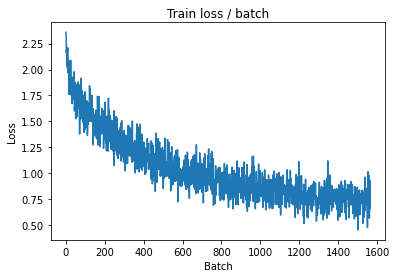

[TRAIN Batch 200/391]	Time 0.052s (0.042s)	Loss 0.8923 (0.6889)	Prec@1  66.4 ( 76.0)	Prec@5  98.4 ( 98.5)


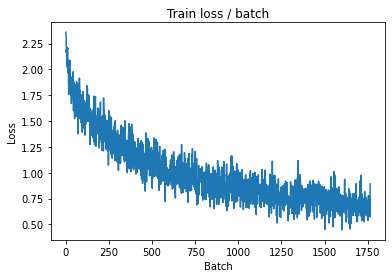


===============> Total time 16s	Avg loss 0.6999	Avg Prec@1 75.54 %	Avg Prec@5 98.46 %

[EVAL Batch 000/079]	Time 0.155s (0.155s)	Loss 0.6063 (0.6063)	Prec@1  78.9 ( 78.9)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.6639	Avg Prec@1 76.80 %	Avg Prec@5 98.73 %



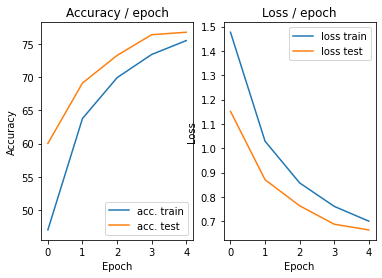

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.180s (0.180s)	Loss 0.5422 (0.5422)	Prec@1  80.5 ( 80.5)	Prec@5 100.0 (100.0)


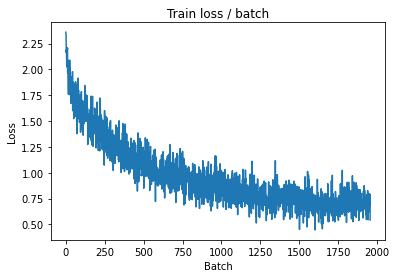

[TRAIN Batch 200/391]	Time 0.010s (0.041s)	Loss 0.6070 (0.6505)	Prec@1  78.1 ( 77.3)	Prec@5  98.4 ( 98.7)


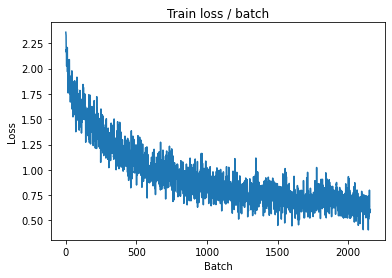


===============> Total time 15s	Avg loss 0.6530	Avg Prec@1 77.31 %	Avg Prec@5 98.65 %

[EVAL Batch 000/079]	Time 0.163s (0.163s)	Loss 0.5741 (0.5741)	Prec@1  86.7 ( 86.7)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 0.6634	Avg Prec@1 77.68 %	Avg Prec@5 98.64 %



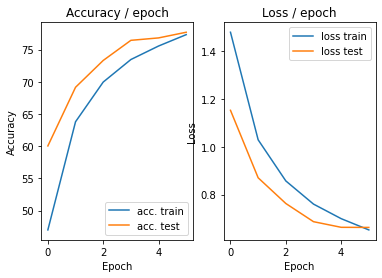

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.191s (0.191s)	Loss 0.8313 (0.8313)	Prec@1  68.8 ( 68.8)	Prec@5 100.0 (100.0)


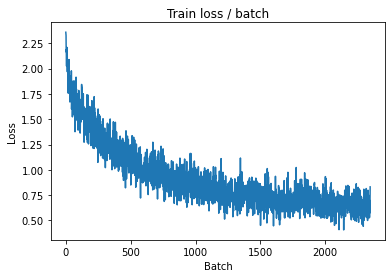

[TRAIN Batch 200/391]	Time 0.052s (0.041s)	Loss 0.6681 (0.6176)	Prec@1  74.2 ( 78.6)	Prec@5  99.2 ( 98.8)


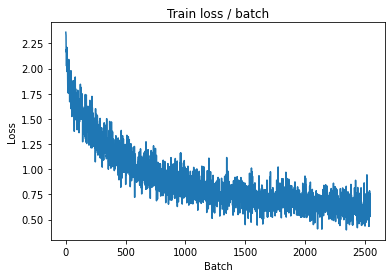


===============> Total time 15s	Avg loss 0.6129	Avg Prec@1 78.84 %	Avg Prec@5 98.86 %

[EVAL Batch 000/079]	Time 0.148s (0.148s)	Loss 0.6131 (0.6131)	Prec@1  81.2 ( 81.2)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.6109	Avg Prec@1 78.88 %	Avg Prec@5 98.67 %



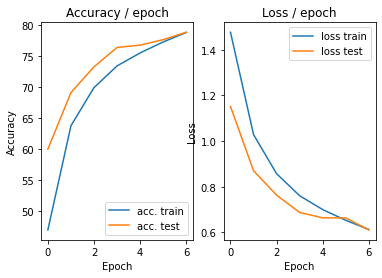

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.183s (0.183s)	Loss 0.6167 (0.6167)	Prec@1  77.3 ( 77.3)	Prec@5  99.2 ( 99.2)


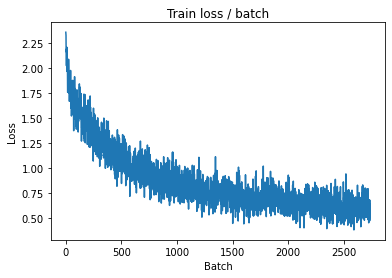

[TRAIN Batch 200/391]	Time 0.054s (0.040s)	Loss 0.5593 (0.5694)	Prec@1  83.6 ( 80.1)	Prec@5  98.4 ( 99.0)


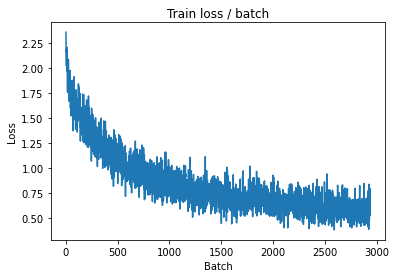


===============> Total time 15s	Avg loss 0.5736	Avg Prec@1 80.05 %	Avg Prec@5 98.91 %

[EVAL Batch 000/079]	Time 0.157s (0.157s)	Loss 0.4985 (0.4985)	Prec@1  85.9 ( 85.9)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.5909	Avg Prec@1 79.84 %	Avg Prec@5 98.81 %



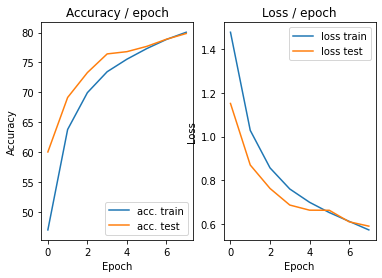

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.194s (0.194s)	Loss 0.4974 (0.4974)	Prec@1  81.2 ( 81.2)	Prec@5  98.4 ( 98.4)


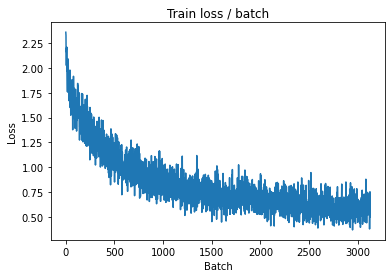

[TRAIN Batch 200/391]	Time 0.068s (0.040s)	Loss 0.3802 (0.5461)	Prec@1  85.2 ( 80.9)	Prec@5 100.0 ( 99.1)


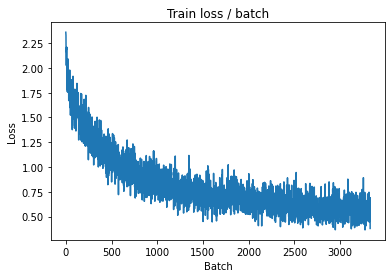


===============> Total time 15s	Avg loss 0.5483	Avg Prec@1 80.88 %	Avg Prec@5 99.03 %

[EVAL Batch 000/079]	Time 0.162s (0.162s)	Loss 0.5172 (0.5172)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.5684	Avg Prec@1 80.65 %	Avg Prec@5 99.00 %



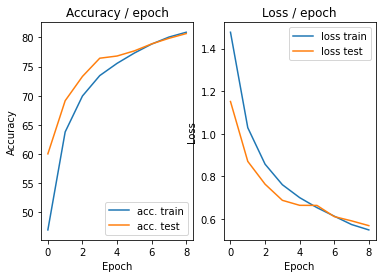

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.182s (0.182s)	Loss 0.4968 (0.4968)	Prec@1  82.0 ( 82.0)	Prec@5  98.4 ( 98.4)


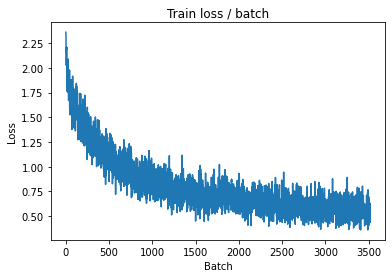

[TRAIN Batch 200/391]	Time 0.048s (0.040s)	Loss 0.5595 (0.5264)	Prec@1  85.2 ( 81.7)	Prec@5  98.4 ( 99.2)


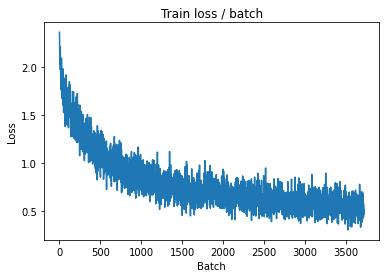


===============> Total time 15s	Avg loss 0.5228	Avg Prec@1 81.67 %	Avg Prec@5 99.15 %

[EVAL Batch 000/079]	Time 0.157s (0.157s)	Loss 0.4444 (0.4444)	Prec@1  85.9 ( 85.9)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.5696	Avg Prec@1 80.90 %	Avg Prec@5 99.04 %



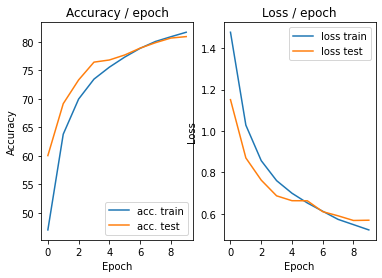

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.193s (0.193s)	Loss 0.4487 (0.4487)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)


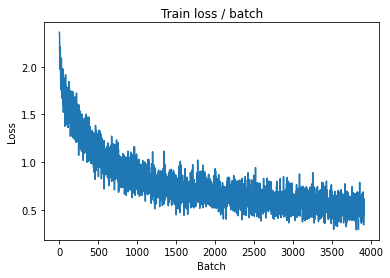

[TRAIN Batch 200/391]	Time 0.051s (0.041s)	Loss 0.5399 (0.4991)	Prec@1  82.0 ( 82.5)	Prec@5  99.2 ( 99.1)


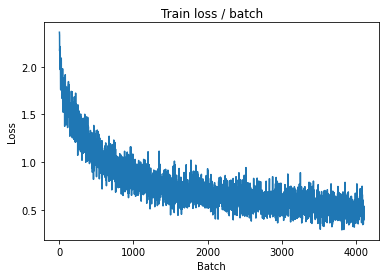


===============> Total time 15s	Avg loss 0.5018	Avg Prec@1 82.42 %	Avg Prec@5 99.15 %

[EVAL Batch 000/079]	Time 0.158s (0.158s)	Loss 0.4713 (0.4713)	Prec@1  85.2 ( 85.2)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.5522	Avg Prec@1 81.33 %	Avg Prec@5 99.07 %



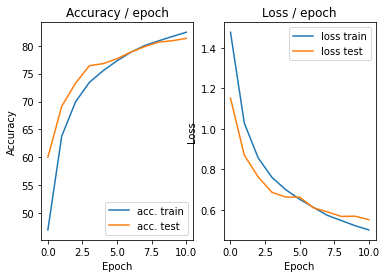

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.181s (0.181s)	Loss 0.5087 (0.5087)	Prec@1  79.7 ( 79.7)	Prec@5  99.2 ( 99.2)


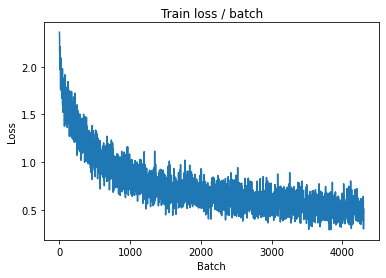

[TRAIN Batch 200/391]	Time 0.025s (0.041s)	Loss 0.3894 (0.4759)	Prec@1  85.2 ( 83.5)	Prec@5  99.2 ( 99.2)


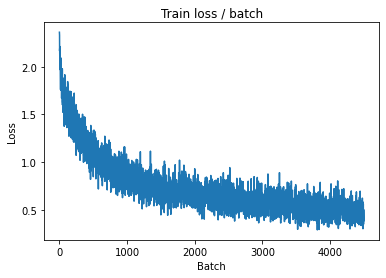


===============> Total time 15s	Avg loss 0.4749	Avg Prec@1 83.62 %	Avg Prec@5 99.27 %

[EVAL Batch 000/079]	Time 0.155s (0.155s)	Loss 0.4664 (0.4664)	Prec@1  87.5 ( 87.5)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.5295	Avg Prec@1 82.07 %	Avg Prec@5 98.98 %



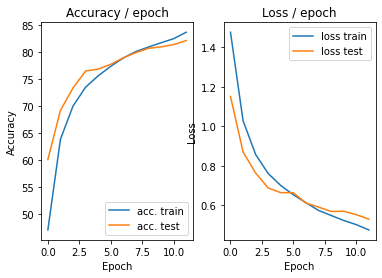

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.176s (0.176s)	Loss 0.3726 (0.3726)	Prec@1  85.2 ( 85.2)	Prec@5 100.0 (100.0)


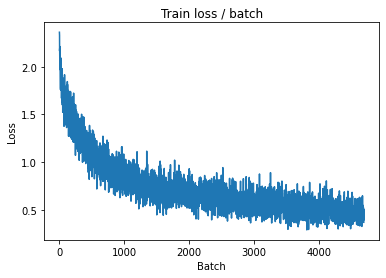

[TRAIN Batch 200/391]	Time 0.055s (0.040s)	Loss 0.5554 (0.4487)	Prec@1  81.2 ( 84.3)	Prec@5  98.4 ( 99.4)


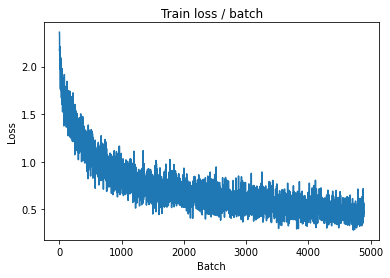


===============> Total time 15s	Avg loss 0.4539	Avg Prec@1 84.05 %	Avg Prec@5 99.39 %

[EVAL Batch 000/079]	Time 0.162s (0.162s)	Loss 0.5181 (0.5181)	Prec@1  82.0 ( 82.0)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.5506	Avg Prec@1 81.27 %	Avg Prec@5 99.05 %



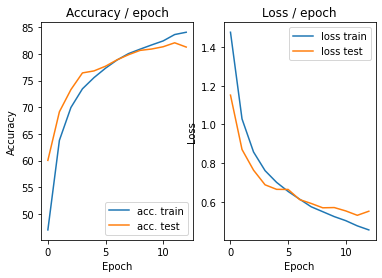

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.172s (0.172s)	Loss 0.4106 (0.4106)	Prec@1  87.5 ( 87.5)	Prec@5 100.0 (100.0)


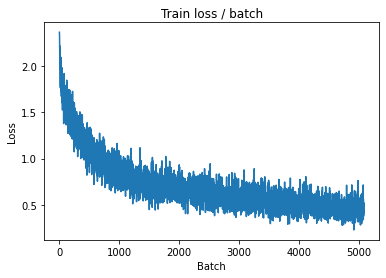

[TRAIN Batch 200/391]	Time 0.017s (0.041s)	Loss 0.4304 (0.4244)	Prec@1  85.9 ( 85.4)	Prec@5  99.2 ( 99.4)


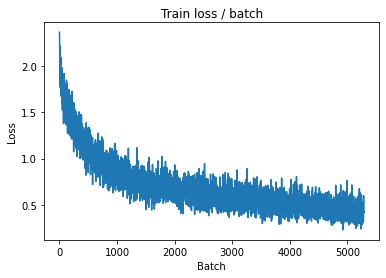


===============> Total time 15s	Avg loss 0.4372	Avg Prec@1 84.82 %	Avg Prec@5 99.35 %

[EVAL Batch 000/079]	Time 0.157s (0.157s)	Loss 0.4511 (0.4511)	Prec@1  86.7 ( 86.7)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.5211	Avg Prec@1 82.37 %	Avg Prec@5 99.06 %



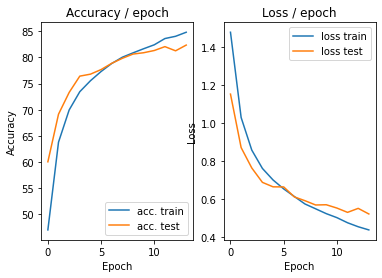

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.189s (0.189s)	Loss 0.2369 (0.2369)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 (100.0)


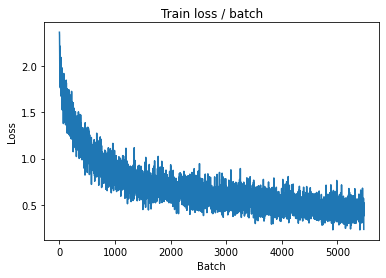

[TRAIN Batch 200/391]	Time 0.017s (0.041s)	Loss 0.3741 (0.4123)	Prec@1  88.3 ( 85.5)	Prec@5  99.2 ( 99.5)


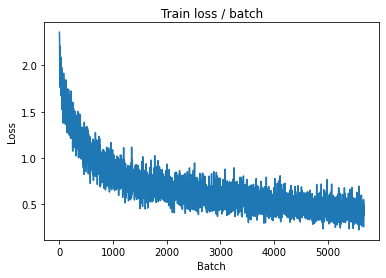


===============> Total time 15s	Avg loss 0.4170	Avg Prec@1 85.38 %	Avg Prec@5 99.50 %

[EVAL Batch 000/079]	Time 0.150s (0.150s)	Loss 0.4714 (0.4714)	Prec@1  85.9 ( 85.9)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.5207	Avg Prec@1 82.52 %	Avg Prec@5 99.18 %



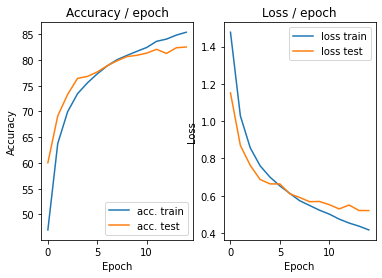

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.193s (0.193s)	Loss 0.3830 (0.3830)	Prec@1  85.2 ( 85.2)	Prec@5  98.4 ( 98.4)


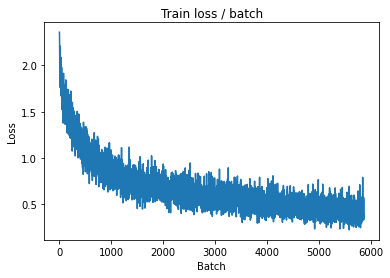

[TRAIN Batch 200/391]	Time 0.017s (0.041s)	Loss 0.5826 (0.3986)	Prec@1  76.6 ( 86.1)	Prec@5  99.2 ( 99.5)


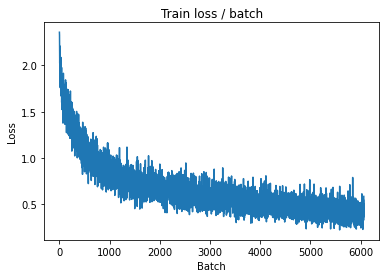


===============> Total time 15s	Avg loss 0.4050	Avg Prec@1 85.89 %	Avg Prec@5 99.50 %

[EVAL Batch 000/079]	Time 0.167s (0.167s)	Loss 0.4573 (0.4573)	Prec@1  86.7 ( 86.7)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.5093	Avg Prec@1 83.15 %	Avg Prec@5 99.17 %



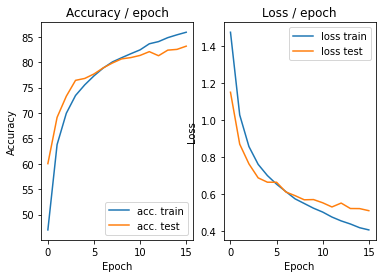

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.193s (0.193s)	Loss 0.4641 (0.4641)	Prec@1  85.9 ( 85.9)	Prec@5  99.2 ( 99.2)


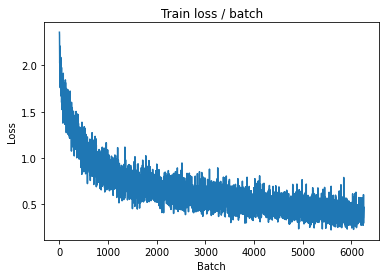

[TRAIN Batch 200/391]	Time 0.018s (0.040s)	Loss 0.3575 (0.3847)	Prec@1  88.3 ( 86.7)	Prec@5  99.2 ( 99.6)


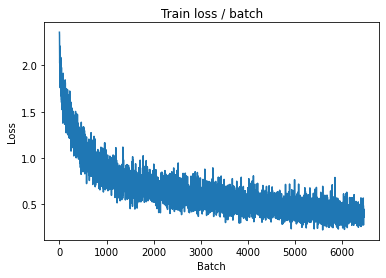


===============> Total time 15s	Avg loss 0.3923	Avg Prec@1 86.29 %	Avg Prec@5 99.58 %

[EVAL Batch 000/079]	Time 0.153s (0.153s)	Loss 0.4404 (0.4404)	Prec@1  85.9 ( 85.9)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.4963	Avg Prec@1 83.62 %	Avg Prec@5 99.15 %



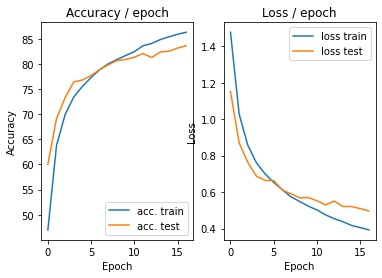

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.198s (0.198s)	Loss 0.3280 (0.3280)	Prec@1  89.1 ( 89.1)	Prec@5 100.0 (100.0)


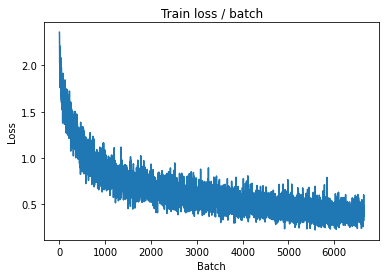

[TRAIN Batch 200/391]	Time 0.073s (0.041s)	Loss 0.3008 (0.3693)	Prec@1  92.2 ( 87.2)	Prec@5  99.2 ( 99.6)


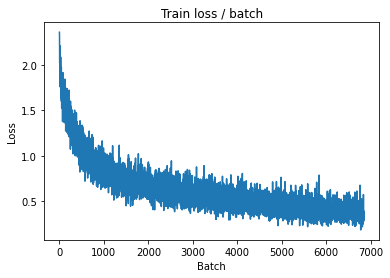


===============> Total time 15s	Avg loss 0.3714	Avg Prec@1 86.97 %	Avg Prec@5 99.60 %

[EVAL Batch 000/079]	Time 0.168s (0.168s)	Loss 0.4095 (0.4095)	Prec@1  89.8 ( 89.8)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.5078	Avg Prec@1 83.13 %	Avg Prec@5 99.23 %



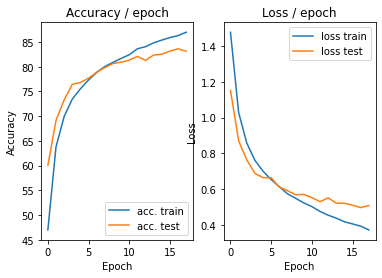

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.184s (0.184s)	Loss 0.4128 (0.4128)	Prec@1  84.4 ( 84.4)	Prec@5 100.0 (100.0)


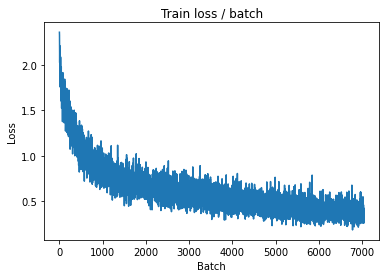

[TRAIN Batch 200/391]	Time 0.018s (0.041s)	Loss 0.3114 (0.3564)	Prec@1  87.5 ( 87.3)	Prec@5  98.4 ( 99.6)


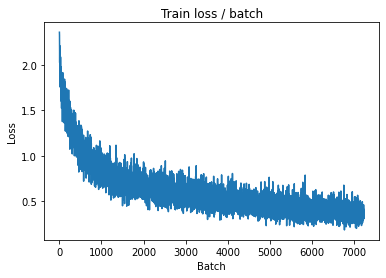


===============> Total time 15s	Avg loss 0.3584	Avg Prec@1 87.26 %	Avg Prec@5 99.64 %

[EVAL Batch 000/079]	Time 0.153s (0.153s)	Loss 0.4239 (0.4239)	Prec@1  88.3 ( 88.3)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.4967	Avg Prec@1 83.71 %	Avg Prec@5 99.15 %



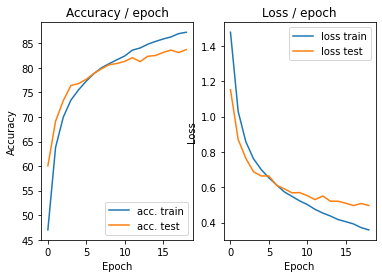

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.181s (0.181s)	Loss 0.2326 (0.2326)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)


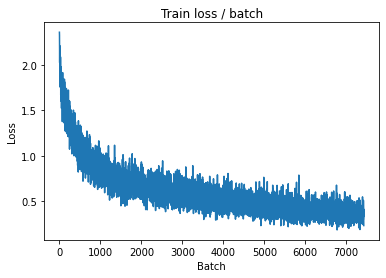

[TRAIN Batch 200/391]	Time 0.039s (0.040s)	Loss 0.3176 (0.3464)	Prec@1  88.3 ( 87.7)	Prec@5 100.0 ( 99.7)


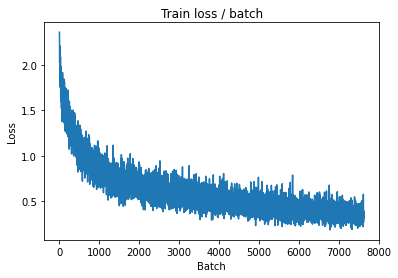


===============> Total time 15s	Avg loss 0.3546	Avg Prec@1 87.52 %	Avg Prec@5 99.64 %

[EVAL Batch 000/079]	Time 0.148s (0.148s)	Loss 0.4204 (0.4204)	Prec@1  89.1 ( 89.1)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.5000	Avg Prec@1 83.51 %	Avg Prec@5 99.18 %



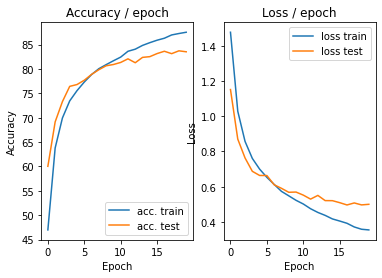

=== EPOCH 21 =====

[TRAIN Batch 000/391]	Time 0.184s (0.184s)	Loss 0.3736 (0.3736)	Prec@1  83.6 ( 83.6)	Prec@5 100.0 (100.0)


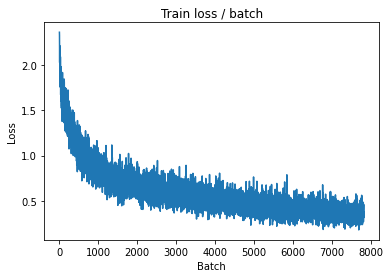

[TRAIN Batch 200/391]	Time 0.065s (0.041s)	Loss 0.3518 (0.3428)	Prec@1  88.3 ( 87.8)	Prec@5  99.2 ( 99.6)


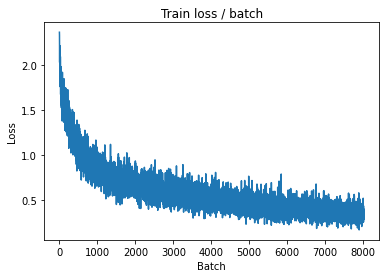


===============> Total time 15s	Avg loss 0.3423	Avg Prec@1 87.92 %	Avg Prec@5 99.68 %

[EVAL Batch 000/079]	Time 0.164s (0.164s)	Loss 0.4118 (0.4118)	Prec@1  87.5 ( 87.5)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.5040	Avg Prec@1 83.75 %	Avg Prec@5 99.23 %



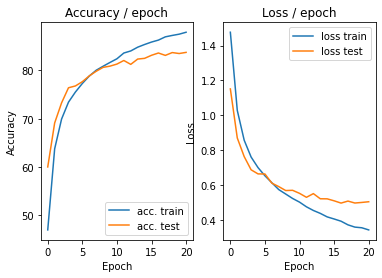

=== EPOCH 22 =====

[TRAIN Batch 000/391]	Time 0.183s (0.183s)	Loss 0.2396 (0.2396)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 (100.0)


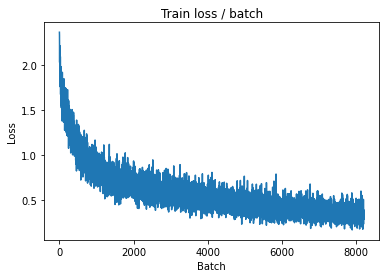

[TRAIN Batch 200/391]	Time 0.039s (0.040s)	Loss 0.2350 (0.3190)	Prec@1  90.6 ( 88.9)	Prec@5 100.0 ( 99.7)


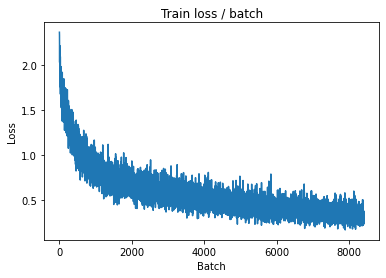


===============> Total time 15s	Avg loss 0.3280	Avg Prec@1 88.55 %	Avg Prec@5 99.67 %

[EVAL Batch 000/079]	Time 0.164s (0.164s)	Loss 0.4226 (0.4226)	Prec@1  86.7 ( 86.7)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.4908	Avg Prec@1 84.01 %	Avg Prec@5 99.27 %



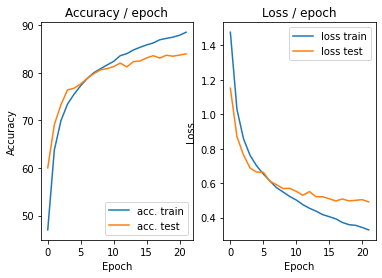

=== EPOCH 23 =====

[TRAIN Batch 000/391]	Time 0.185s (0.185s)	Loss 0.3124 (0.3124)	Prec@1  89.1 ( 89.1)	Prec@5 100.0 (100.0)


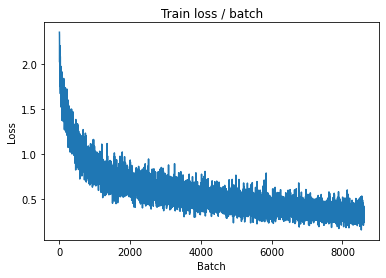

[TRAIN Batch 200/391]	Time 0.021s (0.041s)	Loss 0.1943 (0.3168)	Prec@1  92.2 ( 88.8)	Prec@5 100.0 ( 99.7)


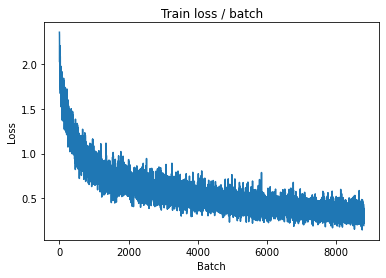


===============> Total time 15s	Avg loss 0.3248	Avg Prec@1 88.58 %	Avg Prec@5 99.68 %

[EVAL Batch 000/079]	Time 0.163s (0.163s)	Loss 0.3948 (0.3948)	Prec@1  88.3 ( 88.3)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.4802	Avg Prec@1 84.74 %	Avg Prec@5 99.37 %



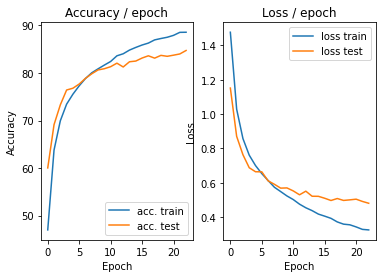

=== EPOCH 24 =====

[TRAIN Batch 000/391]	Time 0.191s (0.191s)	Loss 0.2938 (0.2938)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


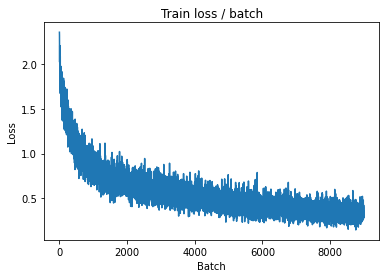

[TRAIN Batch 200/391]	Time 0.066s (0.040s)	Loss 0.3812 (0.3093)	Prec@1  86.7 ( 89.1)	Prec@5  97.7 ( 99.7)


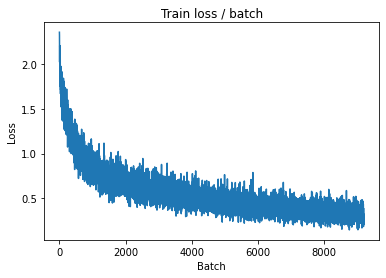


===============> Total time 15s	Avg loss 0.3110	Avg Prec@1 88.99 %	Avg Prec@5 99.72 %

[EVAL Batch 000/079]	Time 0.152s (0.152s)	Loss 0.3753 (0.3753)	Prec@1  89.8 ( 89.8)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.5030	Avg Prec@1 83.98 %	Avg Prec@5 99.13 %



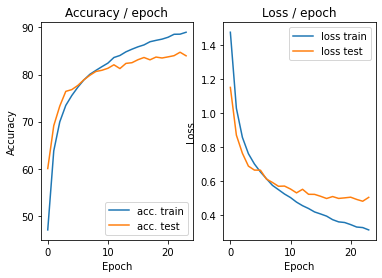

=== EPOCH 25 =====

[TRAIN Batch 000/391]	Time 0.180s (0.180s)	Loss 0.3672 (0.3672)	Prec@1  86.7 ( 86.7)	Prec@5  99.2 ( 99.2)


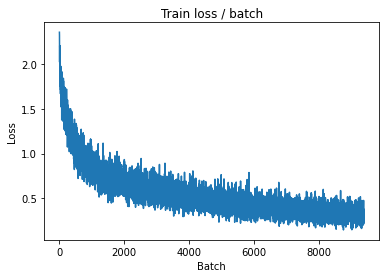

[TRAIN Batch 200/391]	Time 0.016s (0.039s)	Loss 0.3877 (0.2978)	Prec@1  85.2 ( 89.6)	Prec@5 100.0 ( 99.8)


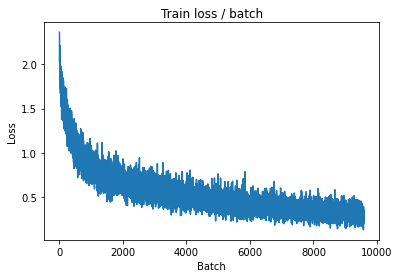


===============> Total time 15s	Avg loss 0.2991	Avg Prec@1 89.59 %	Avg Prec@5 99.76 %

[EVAL Batch 000/079]	Time 0.157s (0.157s)	Loss 0.4238 (0.4238)	Prec@1  88.3 ( 88.3)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.5056	Avg Prec@1 83.67 %	Avg Prec@5 99.27 %



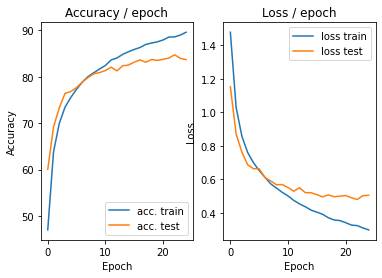

=== EPOCH 26 =====

[TRAIN Batch 000/391]	Time 0.203s (0.203s)	Loss 0.2951 (0.2951)	Prec@1  89.1 ( 89.1)	Prec@5 100.0 (100.0)


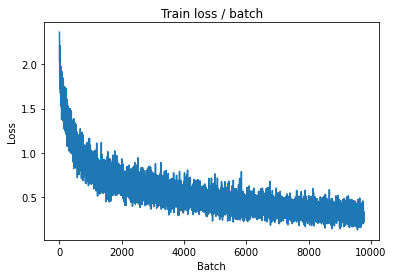

[TRAIN Batch 200/391]	Time 0.076s (0.040s)	Loss 0.1898 (0.2889)	Prec@1  92.2 ( 89.7)	Prec@5 100.0 ( 99.8)


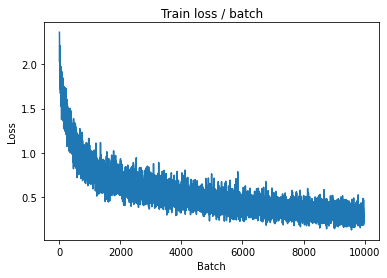


===============> Total time 15s	Avg loss 0.2924	Avg Prec@1 89.58 %	Avg Prec@5 99.79 %

[EVAL Batch 000/079]	Time 0.154s (0.154s)	Loss 0.4050 (0.4050)	Prec@1  89.8 ( 89.8)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.5100	Avg Prec@1 83.97 %	Avg Prec@5 99.33 %



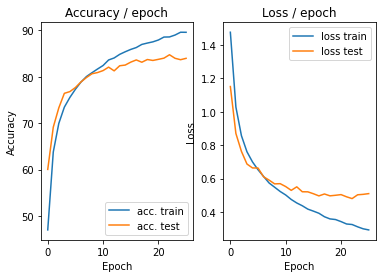

=== EPOCH 27 =====

[TRAIN Batch 000/391]	Time 0.181s (0.181s)	Loss 0.3414 (0.3414)	Prec@1  90.6 ( 90.6)	Prec@5  99.2 ( 99.2)


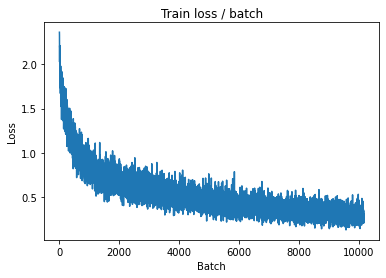

[TRAIN Batch 200/391]	Time 0.015s (0.040s)	Loss 0.2869 (0.2768)	Prec@1  89.8 ( 90.2)	Prec@5 100.0 ( 99.8)


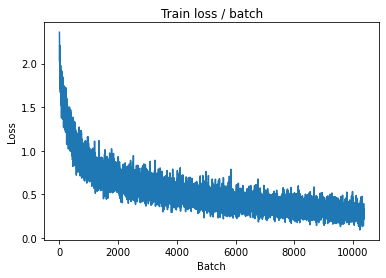


===============> Total time 15s	Avg loss 0.2819	Avg Prec@1 89.98 %	Avg Prec@5 99.80 %

[EVAL Batch 000/079]	Time 0.146s (0.146s)	Loss 0.3781 (0.3781)	Prec@1  88.3 ( 88.3)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.4891	Avg Prec@1 84.47 %	Avg Prec@5 99.34 %



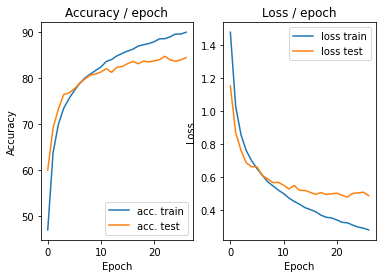

=== EPOCH 28 =====

[TRAIN Batch 000/391]	Time 0.181s (0.181s)	Loss 0.1242 (0.1242)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)


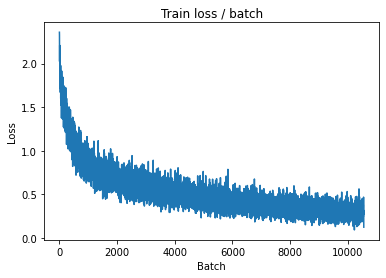

[TRAIN Batch 200/391]	Time 0.069s (0.040s)	Loss 0.2718 (0.2659)	Prec@1  92.2 ( 90.6)	Prec@5  99.2 ( 99.8)


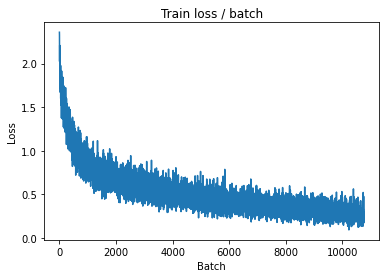


===============> Total time 15s	Avg loss 0.2767	Avg Prec@1 90.28 %	Avg Prec@5 99.78 %

[EVAL Batch 000/079]	Time 0.151s (0.151s)	Loss 0.3685 (0.3685)	Prec@1  87.5 ( 87.5)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.4880	Avg Prec@1 84.77 %	Avg Prec@5 99.36 %



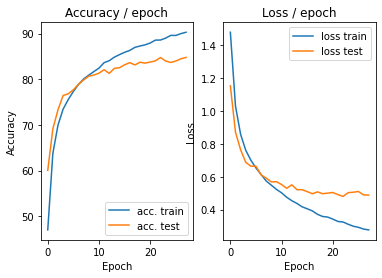

=== EPOCH 29 =====

[TRAIN Batch 000/391]	Time 0.207s (0.207s)	Loss 0.1688 (0.1688)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


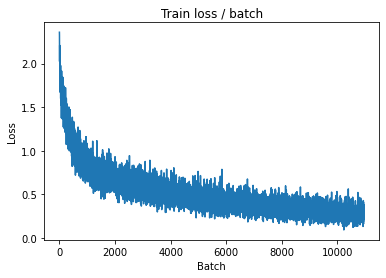

[TRAIN Batch 200/391]	Time 0.014s (0.039s)	Loss 0.3228 (0.2640)	Prec@1  88.3 ( 90.7)	Prec@5  99.2 ( 99.8)


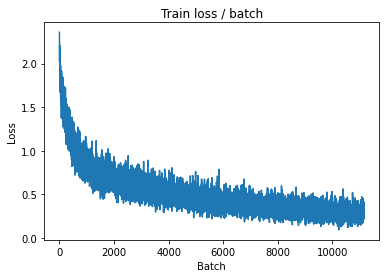


===============> Total time 15s	Avg loss 0.2692	Avg Prec@1 90.43 %	Avg Prec@5 99.84 %

[EVAL Batch 000/079]	Time 0.160s (0.160s)	Loss 0.3655 (0.3655)	Prec@1  89.1 ( 89.1)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.4933	Avg Prec@1 84.66 %	Avg Prec@5 99.38 %



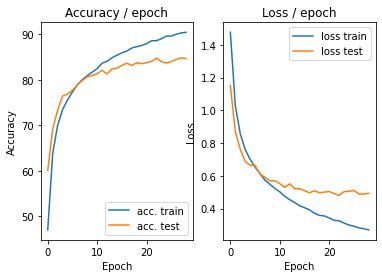

=== EPOCH 30 =====

[TRAIN Batch 000/391]	Time 0.199s (0.199s)	Loss 0.1928 (0.1928)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


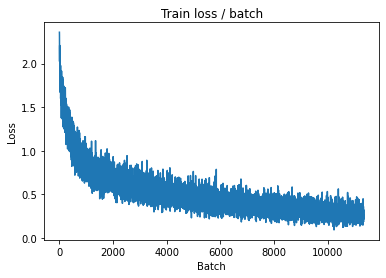

[TRAIN Batch 200/391]	Time 0.022s (0.039s)	Loss 0.2600 (0.2578)	Prec@1  90.6 ( 91.1)	Prec@5  99.2 ( 99.9)


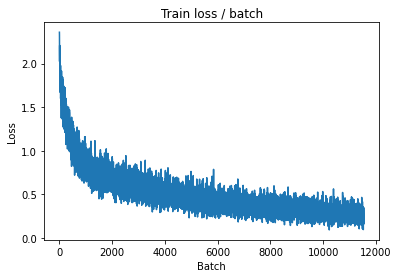


===============> Total time 15s	Avg loss 0.2632	Avg Prec@1 90.75 %	Avg Prec@5 99.80 %

[EVAL Batch 000/079]	Time 0.156s (0.156s)	Loss 0.3755 (0.3755)	Prec@1  87.5 ( 87.5)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.4850	Avg Prec@1 84.71 %	Avg Prec@5 99.30 %



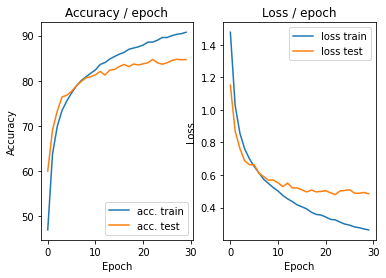

=== EPOCH 31 =====

[TRAIN Batch 000/391]	Time 0.191s (0.191s)	Loss 0.2041 (0.2041)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


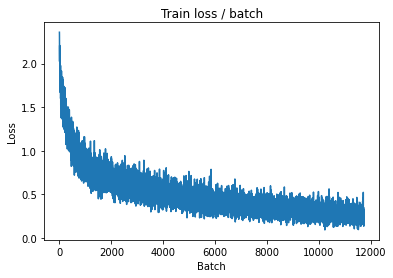

[TRAIN Batch 200/391]	Time 0.050s (0.039s)	Loss 0.2088 (0.2476)	Prec@1  93.8 ( 91.3)	Prec@5 100.0 ( 99.9)


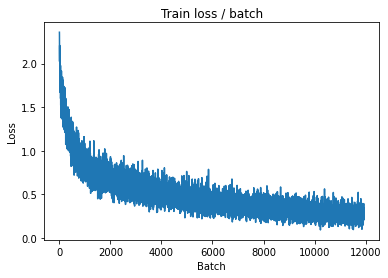


===============> Total time 15s	Avg loss 0.2536	Avg Prec@1 91.02 %	Avg Prec@5 99.84 %

[EVAL Batch 000/079]	Time 0.154s (0.154s)	Loss 0.3556 (0.3556)	Prec@1  89.1 ( 89.1)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.4825	Avg Prec@1 85.01 %	Avg Prec@5 99.41 %



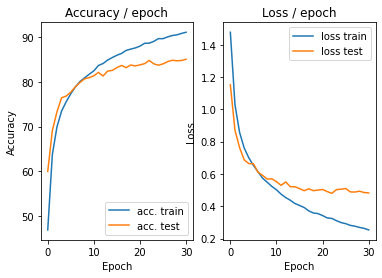

=== EPOCH 32 =====

[TRAIN Batch 000/391]	Time 0.202s (0.202s)	Loss 0.2238 (0.2238)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


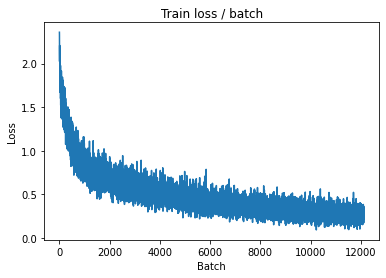

[TRAIN Batch 200/391]	Time 0.018s (0.039s)	Loss 0.2742 (0.2517)	Prec@1  93.8 ( 91.3)	Prec@5  99.2 ( 99.8)


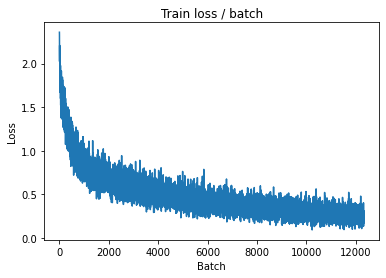


===============> Total time 15s	Avg loss 0.2521	Avg Prec@1 91.26 %	Avg Prec@5 99.82 %

[EVAL Batch 000/079]	Time 0.155s (0.155s)	Loss 0.3462 (0.3462)	Prec@1  89.8 ( 89.8)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.5009	Avg Prec@1 85.19 %	Avg Prec@5 99.28 %



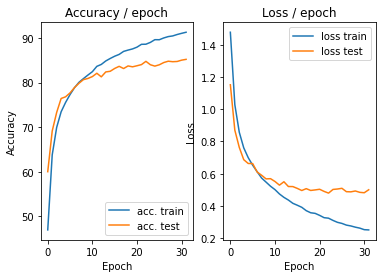

=== EPOCH 33 =====

[TRAIN Batch 000/391]	Time 0.186s (0.186s)	Loss 0.3118 (0.3118)	Prec@1  91.4 ( 91.4)	Prec@5  99.2 ( 99.2)


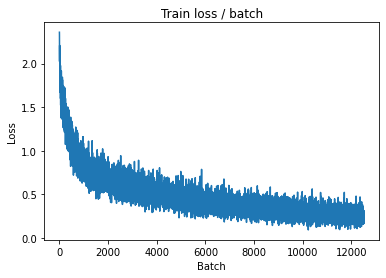

[TRAIN Batch 200/391]	Time 0.047s (0.040s)	Loss 0.2332 (0.2405)	Prec@1  93.0 ( 91.5)	Prec@5  99.2 ( 99.9)


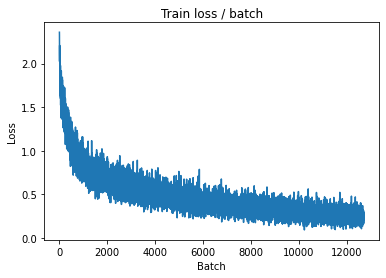


===============> Total time 15s	Avg loss 0.2423	Avg Prec@1 91.43 %	Avg Prec@5 99.89 %

[EVAL Batch 000/079]	Time 0.153s (0.153s)	Loss 0.3419 (0.3419)	Prec@1  90.6 ( 90.6)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.4925	Avg Prec@1 85.09 %	Avg Prec@5 99.31 %



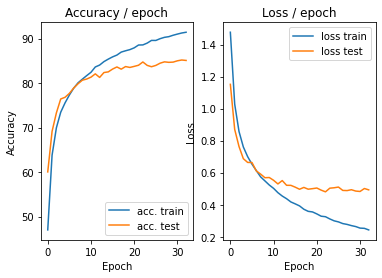

=== EPOCH 34 =====

[TRAIN Batch 000/391]	Time 0.169s (0.169s)	Loss 0.1864 (0.1864)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


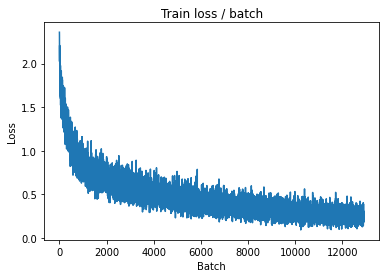

[TRAIN Batch 200/391]	Time 0.056s (0.039s)	Loss 0.2350 (0.2363)	Prec@1  89.8 ( 91.6)	Prec@5 100.0 ( 99.9)


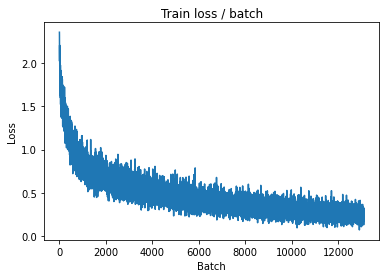


===============> Total time 15s	Avg loss 0.2374	Avg Prec@1 91.54 %	Avg Prec@5 99.84 %

[EVAL Batch 000/079]	Time 0.150s (0.150s)	Loss 0.3377 (0.3377)	Prec@1  90.6 ( 90.6)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.4928	Avg Prec@1 85.44 %	Avg Prec@5 99.44 %



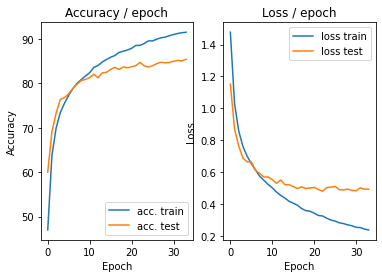

=== EPOCH 35 =====

[TRAIN Batch 000/391]	Time 0.191s (0.191s)	Loss 0.2259 (0.2259)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


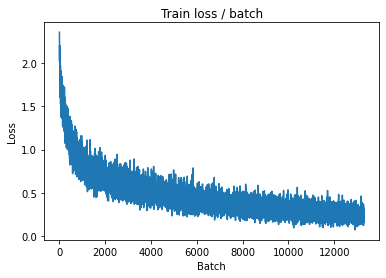

[TRAIN Batch 200/391]	Time 0.054s (0.040s)	Loss 0.2396 (0.2271)	Prec@1  91.4 ( 91.9)	Prec@5 100.0 ( 99.9)


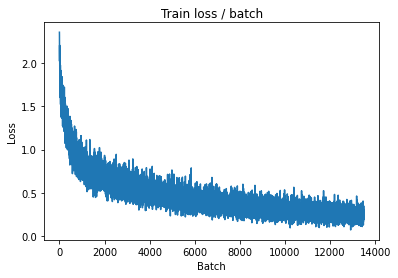


===============> Total time 15s	Avg loss 0.2289	Avg Prec@1 91.96 %	Avg Prec@5 99.88 %

[EVAL Batch 000/079]	Time 0.154s (0.154s)	Loss 0.3710 (0.3710)	Prec@1  89.1 ( 89.1)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.5015	Avg Prec@1 85.19 %	Avg Prec@5 99.35 %



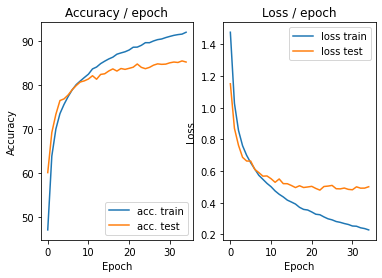

=== EPOCH 36 =====

[TRAIN Batch 000/391]	Time 0.183s (0.183s)	Loss 0.2189 (0.2189)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 (100.0)


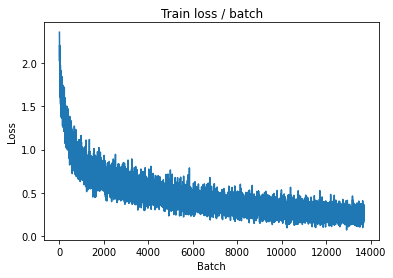

[TRAIN Batch 200/391]	Time 0.059s (0.039s)	Loss 0.1390 (0.2180)	Prec@1  96.1 ( 92.2)	Prec@5 100.0 ( 99.9)


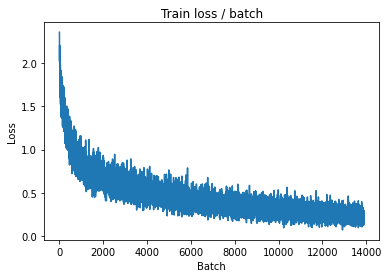


===============> Total time 15s	Avg loss 0.2213	Avg Prec@1 92.07 %	Avg Prec@5 99.90 %

[EVAL Batch 000/079]	Time 0.156s (0.156s)	Loss 0.3690 (0.3690)	Prec@1  89.8 ( 89.8)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.5051	Avg Prec@1 85.17 %	Avg Prec@5 99.34 %



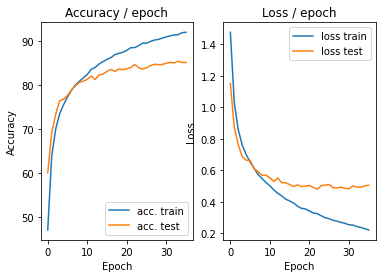

=== EPOCH 37 =====

[TRAIN Batch 000/391]	Time 0.190s (0.190s)	Loss 0.2228 (0.2228)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


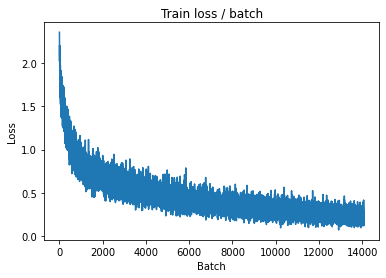

[TRAIN Batch 200/391]	Time 0.021s (0.040s)	Loss 0.1168 (0.2196)	Prec@1  96.1 ( 92.3)	Prec@5 100.0 ( 99.9)


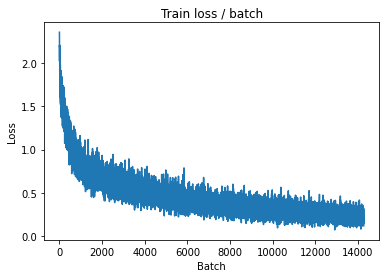


===============> Total time 15s	Avg loss 0.2219	Avg Prec@1 92.12 %	Avg Prec@5 99.90 %

[EVAL Batch 000/079]	Time 0.164s (0.164s)	Loss 0.4145 (0.4145)	Prec@1  89.1 ( 89.1)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.5017	Avg Prec@1 85.23 %	Avg Prec@5 99.39 %



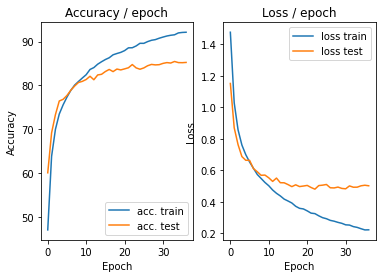

=== EPOCH 38 =====

[TRAIN Batch 000/391]	Time 0.180s (0.180s)	Loss 0.1256 (0.1256)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


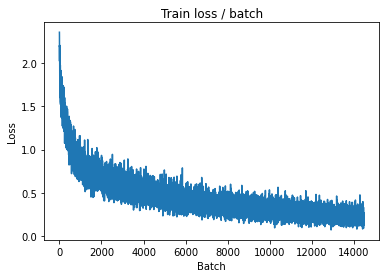

[TRAIN Batch 200/391]	Time 0.065s (0.040s)	Loss 0.1830 (0.2120)	Prec@1  95.3 ( 92.5)	Prec@5  99.2 ( 99.9)


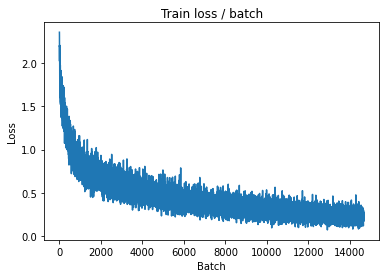


===============> Total time 15s	Avg loss 0.2140	Avg Prec@1 92.39 %	Avg Prec@5 99.90 %

[EVAL Batch 000/079]	Time 0.147s (0.147s)	Loss 0.3916 (0.3916)	Prec@1  88.3 ( 88.3)	Prec@5 100.0 (100.0)

===============> Total time 2s	Avg loss 0.5029	Avg Prec@1 85.25 %	Avg Prec@5 99.33 %



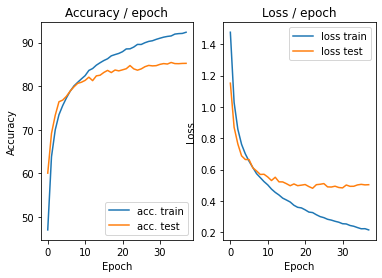

=== EPOCH 39 =====

[TRAIN Batch 000/391]	Time 0.196s (0.196s)	Loss 0.2561 (0.2561)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


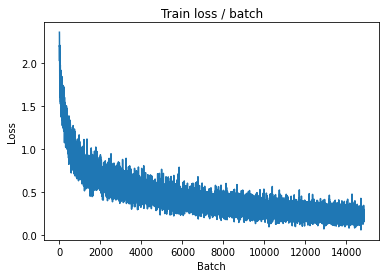

[TRAIN Batch 200/391]	Time 0.059s (0.039s)	Loss 0.2336 (0.2044)	Prec@1  93.0 ( 92.8)	Prec@5 100.0 ( 99.9)


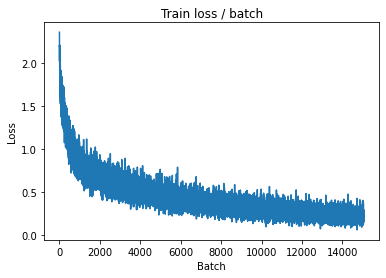


===============> Total time 15s	Avg loss 0.2072	Avg Prec@1 92.68 %	Avg Prec@5 99.92 %

[EVAL Batch 000/079]	Time 0.141s (0.141s)	Loss 0.4000 (0.4000)	Prec@1  89.1 ( 89.1)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.4950	Avg Prec@1 85.18 %	Avg Prec@5 99.41 %



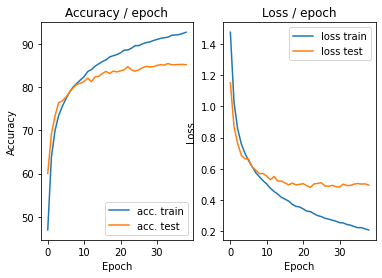

=== EPOCH 40 =====

[TRAIN Batch 000/391]	Time 0.184s (0.184s)	Loss 0.1496 (0.1496)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


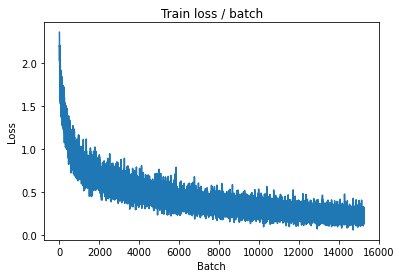

[TRAIN Batch 200/391]	Time 0.067s (0.039s)	Loss 0.1839 (0.2065)	Prec@1  94.5 ( 92.6)	Prec@5 100.0 ( 99.9)


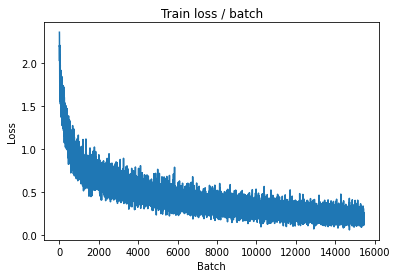


===============> Total time 15s	Avg loss 0.2091	Avg Prec@1 92.51 %	Avg Prec@5 99.92 %

[EVAL Batch 000/079]	Time 0.152s (0.152s)	Loss 0.4121 (0.4121)	Prec@1  89.1 ( 89.1)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.5017	Avg Prec@1 85.40 %	Avg Prec@5 99.32 %



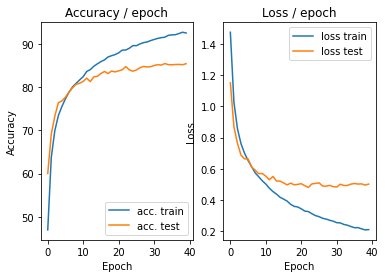

=== EPOCH 41 =====

[TRAIN Batch 000/391]	Time 0.182s (0.182s)	Loss 0.1377 (0.1377)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


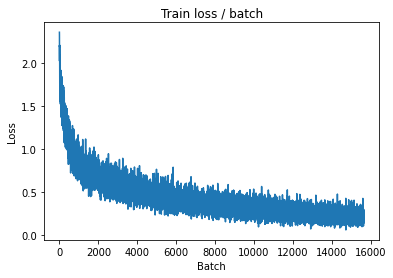

[TRAIN Batch 200/391]	Time 0.017s (0.041s)	Loss 0.2172 (0.2050)	Prec@1  92.2 ( 92.6)	Prec@5 100.0 ( 99.9)


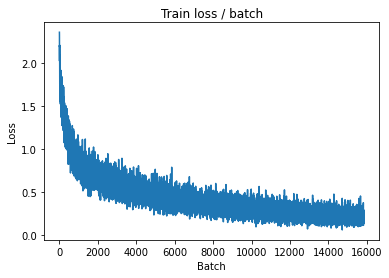


===============> Total time 15s	Avg loss 0.2058	Avg Prec@1 92.70 %	Avg Prec@5 99.87 %

[EVAL Batch 000/079]	Time 0.162s (0.162s)	Loss 0.3769 (0.3769)	Prec@1  90.6 ( 90.6)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.4914	Avg Prec@1 85.32 %	Avg Prec@5 99.35 %



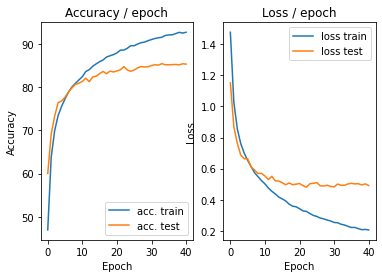

=== EPOCH 42 =====

[TRAIN Batch 000/391]	Time 0.185s (0.185s)	Loss 0.3030 (0.3030)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 (100.0)


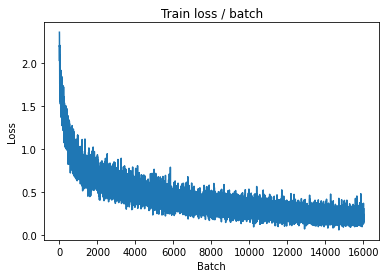

[TRAIN Batch 200/391]	Time 0.060s (0.040s)	Loss 0.1176 (0.1990)	Prec@1  96.9 ( 92.9)	Prec@5 100.0 ( 99.9)


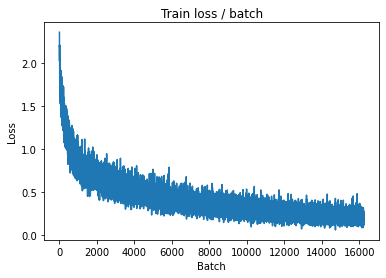


===============> Total time 15s	Avg loss 0.1993	Avg Prec@1 92.96 %	Avg Prec@5 99.91 %

[EVAL Batch 000/079]	Time 0.155s (0.155s)	Loss 0.4065 (0.4065)	Prec@1  89.8 ( 89.8)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.5042	Avg Prec@1 85.47 %	Avg Prec@5 99.41 %



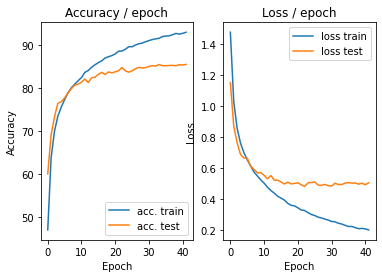

In [16]:
main(batch_size=128,lr=0.1,epochs=42,cuda=True)